# CGAN and Conditional GAN (CGAN) for Image Generation


## Overview

This notebook implements a Conditional GAN (CGAN) using TensorFlow and Keras to generate handwritten character images (A–Z subset). The generator is conditioned on class labels, allowing targeted image generation per character class.

# GAN Training Metrics Guide

## Understanding GAN Training Progress

When training GANs, monitoring the right metrics is crucial for diagnosing training health and catching issues early.

---

## Key Metrics Explained

### **Generator Loss (G Loss)**
- **What it measures:** How well the generator fools the discriminator  
- **Formula:** Binary cross-entropy between discriminator predictions on fake images and label "real"  
- **Interpretation:** Lower = generator is successfully fooling discriminator

### **Discriminator Loss (D Loss)**
- **What it measures:** How well the discriminator separates real from fake images  
- **Formula:** Average of losses on real images + losses on fake images  
- **Interpretation:** Lower = discriminator is successfully identifying real vs fake

### **Discriminator Accuracy (D Accuracy)**
- **What it measures:** (Accuracy on real images + Accuracy on fake images) / 2  
- **Interpretation:** Balance indicator between generator and discriminator strength

---

## Healthy Training Ranges

| Metric             | Healthy Range | Interpretation                                |
|--------------------|----------------|-----------------------------------------------|
| **D Accuracy**     | 60% - 75%       | Discriminator is learning but not dominating  |
| **D Loss**         | 0.3 - 0.7       | Discriminator is confident but not perfect    |
| **G Loss**         | 0.7 - 1.5       | Generator is working hard to fool discriminator |

**Note:**  
D Accuracy of 50% is *not* ideal — that would mean the discriminator is guessing randomly.

# Table of Contents
- [Setup and Configuration](#setup)
- [Exploratory Data Analysis](#eda)
- [Filter Out Unwanted Labels and Reset Index](#filter-reset)
- [Feature Engineering](#fe)
- [Generate Word](#generate-word)
- [Baseline Model - CGAN](#cgan)
- [Baseline Model - CDCGAN (Conditional Deep Convolutional GAN (CDCGAN))](#cdcgan)
- [Model Improvement 1](#imp1)
- [Model Improvement 2](#imp2)
- [Model Improvement 3](#imp3)


<a id="setup"></a>
# Setup and Configuration

In [25]:
import tensorflow as tf
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

In [26]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

import tensorflow as tf
import os
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.layers import LeakyReLU, BatchNormalization, Dropout


In [27]:
df = pd.read_csv('emnist-letters-train.csv')

In [28]:
# Check how many duplicate rows exist
df.duplicated().sum()




9465

In [29]:
df.drop_duplicates(inplace=True)

In [30]:
labels = df.iloc[:, 0]
images = df.iloc[:, 1:].values

<a id="eda"></a>
# Exploratory Data Analysis


In [31]:
df.shape

(55363, 785)

In [32]:
df.describe()

,24,0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,...,0.552,0.553,0.554,0.555,0.556,0.557,0.558,0.559,0.560,0.561
count,55363.000000,55363.000000,55363.000000,55363.000000,55363.000000,55363.000000,55363.000000,55363.000000,55363.00000,55363.000000,...,55363.000000,55363.000000,55363.000000,55363.000000,55363.000000,55363.000000,55363.000000,55363.000000,55363.000000,55363.000000
mean,11.589003,1.787602,1.787602,1.787602,1.787710,1.791991,1.810921,1.819807,1.81009,2.259542,...,1.787602,1.787602,1.787602,1.792479,1.788180,1.787602,1.787602,1.787602,1.787602,1.787602
std,7.467979,17.352303,17.352303,17.352303,17.368913,17.359561,17.449014,17.500948,17.45474,19.855490,...,17.352303,17.352303,17.352303,17.383111,17.352776,17.352303,17.352303,17.352303,17.352303,17.352303
min,-2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,16.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,26.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.00000,255.000000,...,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000


In [33]:
print("Unique labels:", sorted(labels.unique()))

Unique labels: [-2, -1, 1, 2, 4, 5, 6, 7, 9, 10, 12, 14, 15, 16, 17, 20, 24, 26]


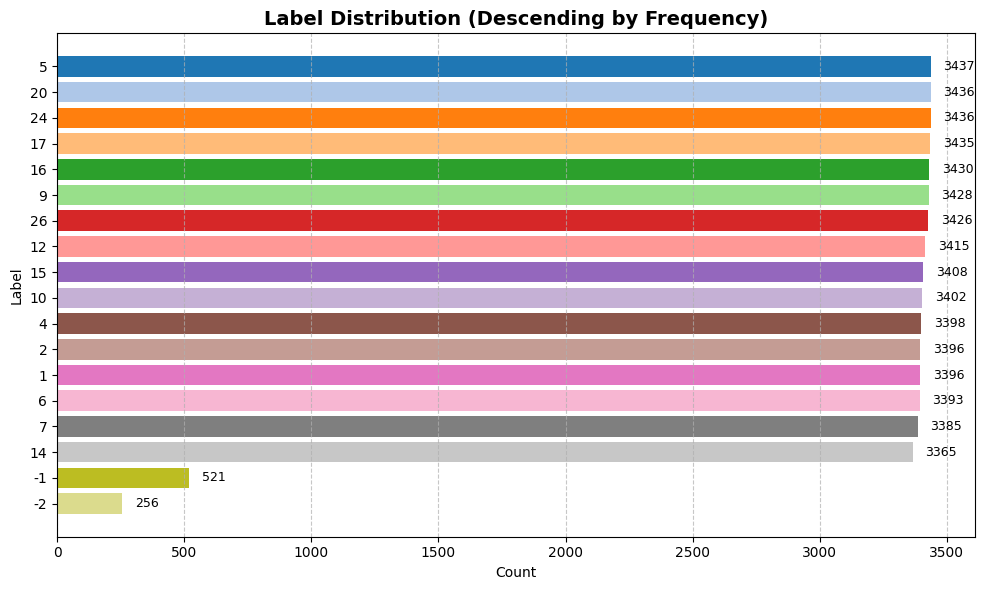

In [34]:
import matplotlib.pyplot as plt

# Count occurrences and sort by frequency (descending)
label_counts = labels.value_counts().sort_values(ascending=False)

# Create horizontal bar chart
plt.figure(figsize=(10, 6))
bars = plt.barh(label_counts.index.astype(str), label_counts.values, color=plt.cm.tab20.colors)

# Add count values next to bars
for bar, value in zip(bars, label_counts.values):
    plt.text(value + 50, bar.get_y() + bar.get_height()/2,
             str(value), va='center', fontsize=9)

plt.title("Label Distribution (Descending by Frequency)", fontsize=14, fontweight='bold')
plt.xlabel("Count")
plt.ylabel("Label")
plt.gca().invert_yaxis()  # Highest count at the top
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [35]:
label_counts = labels.value_counts().sort_index()
print(label_counts)

24
-2      256
-1      521
 1     3396
 2     3396
 4     3398
 5     3437
 6     3393
 7     3385
 9     3428
 10    3402
 12    3415
 14    3365
 15    3408
 16    3430
 17    3435
 20    3436
 24    3436
 26    3426
Name: count, dtype: int64


Two significantly underrepresented labels –
- Label -1: 521 samples
- Label -2: 256 samples

Before we drop them, let us explore what they are first.

------

## Print out sample images by class

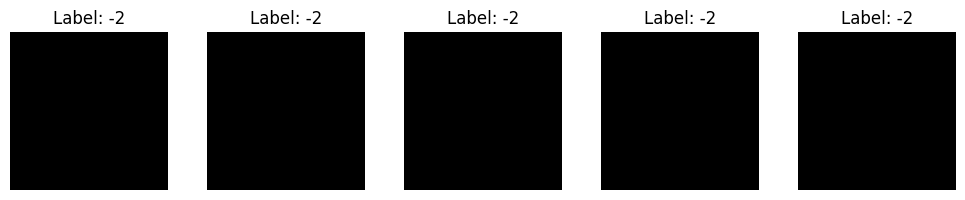

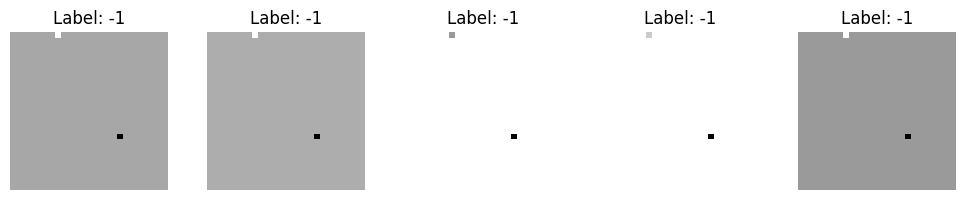

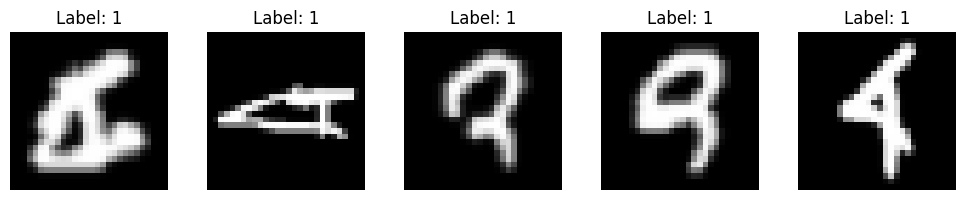

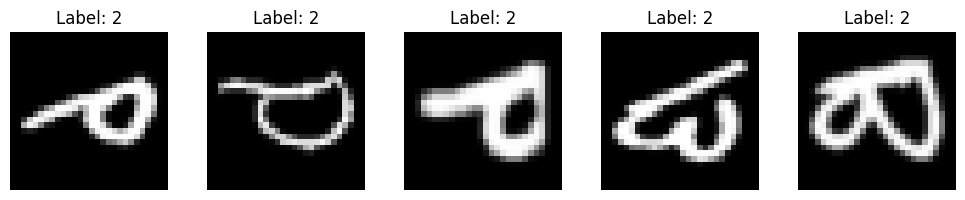

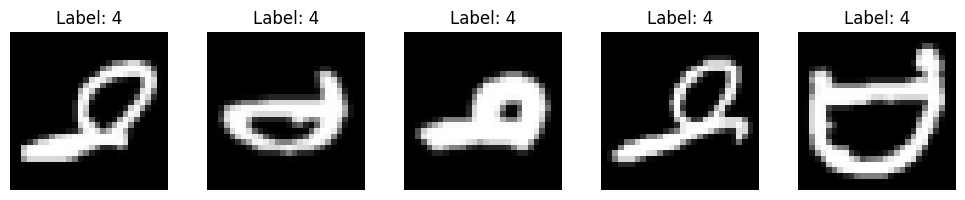

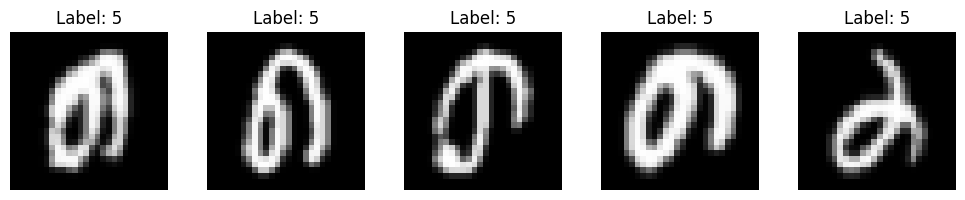

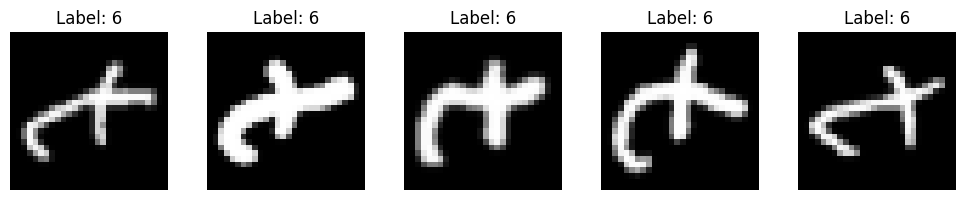

In [36]:
# Helper function to plot images by class
def plot_class_images(class_label, n=5):
    indices = df[df.iloc[:, 0] == class_label].index[:n]
    plt.figure(figsize=(10, 2))
    for i, idx in enumerate(indices):
        img = images[idx].reshape(28, 28)
        plt.subplot(1, n, i + 1)
        plt.imshow(img, cmap='gray')
        plt.title(f"Label: {class_label}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

plot_class_images(-2)
plot_class_images(-1)
plot_class_images(1)
plot_class_images(2)
plot_class_images(4)
plot_class_images(5)
plot_class_images(6)

Observations:
- Each label corresponds to a letter in the EMNIST dataset (currently shown as numeric IDs).
- Labels -2 and -1 appear to be mostly blank or minimal marks
- Other labels (e.g., 1, 2, 4, 5, 6) show handwritten letter variations.
- Variation in handwriting style and stroke thickness may affect GAN training quality.
- Letters have both uppercase and lowercase in the same class

------

<a id="filter-reset"></a>
# Filter Out Unwanted Labels and Reset Index

### Filter Out Unwanted Labels and Reset Index

To ensure clean input data, we removed samples with invalid or unused labels (`-1`, `-2`) and reset the index of the dataset. This step helps eliminate noise and outliers that could destabilize the GAN training process.



In [37]:
df = df[~labels.isin([-1, -2])].copy()
df.reset_index(drop=True, inplace=True)

In [38]:
labels = df.iloc[:, 0]
images = df.iloc[:, 1:].values

In [39]:
print("Unique labels after cleaning:", sorted(labels.unique()))

Unique labels after cleaning: [1, 2, 4, 5, 6, 7, 9, 10, 12, 14, 15, 16, 17, 20, 24, 26]


----


### Map Original Labels to a 0–15 Range

The EMNIST dataset contains various character labels, but for this GAN training task, we selected only 16 specific character classes. To make them compatible with Conditional GAN training, we mapped these original labels to a range of 0 to 15 using the following approach:

In [40]:
# Map original labels to 0–15
unique_labels = sorted(labels.unique())
label_map = {original: new for new, original in enumerate(unique_labels)}
df['mapped_label'] = df.iloc[:, 0].map(label_map)
mapped_labels = df['mapped_label'].values

In [41]:
print("Unique labels after mapping:", sorted(np.unique(mapped_labels)))

Unique labels after mapping: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


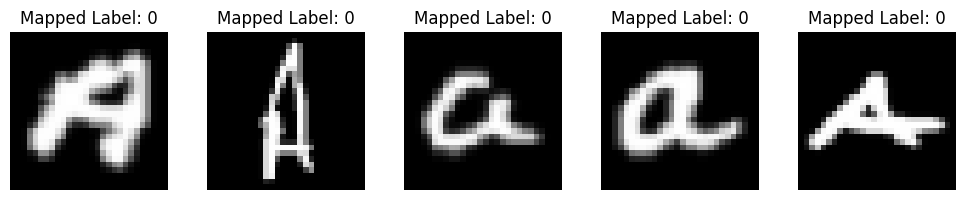

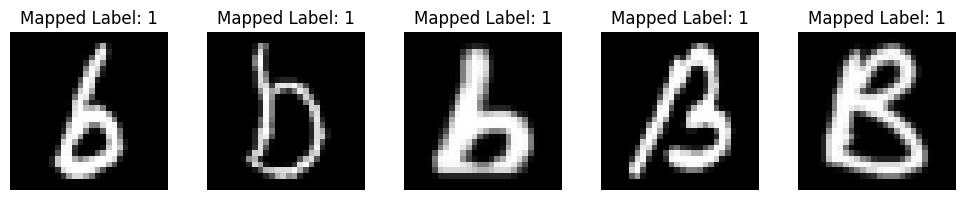

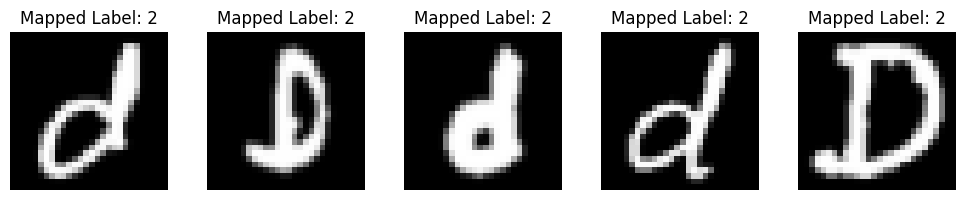

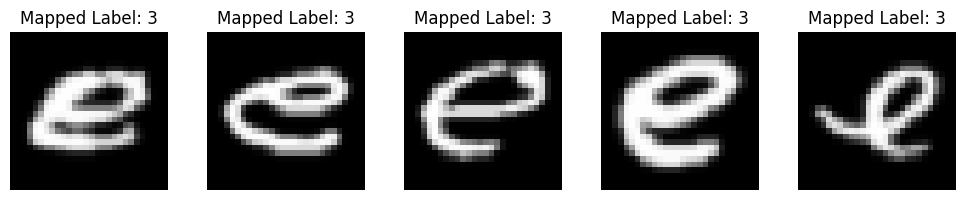

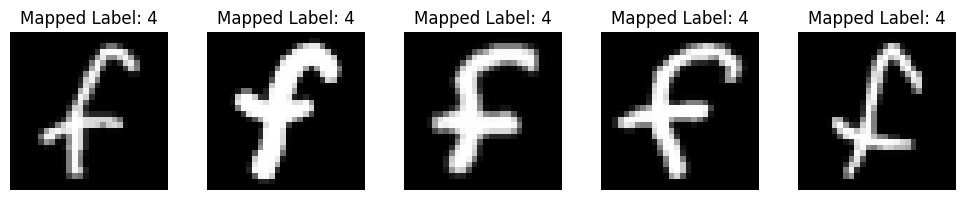

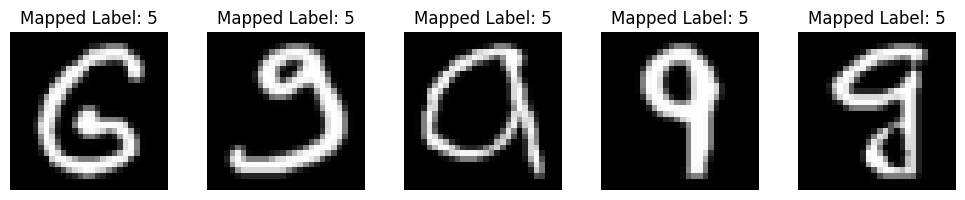

In [42]:
# Map original labels to 0–15
unique_labels = sorted(labels.unique())
label_map = {original: new for new, original in enumerate(unique_labels)}
df['mapped_label'] = df.iloc[:, 0].map(label_map)
mapped_labels = df['mapped_label'].values

# Helper function to plot images using re-mapped label (0–15)
def plot_mapped_class_images(mapped_class_label, n=5):
    indices = df[df['mapped_label'] == mapped_class_label].index[:n]
    plt.figure(figsize=(10, 2))
    for i, idx in enumerate(indices):
        img = images[idx].reshape(28, 28)
        plt.subplot(1, n, i + 1)
        plt.imshow(img.T, cmap='gray')  # Transpose to fix orientation
        plt.title(f"Mapped Label: {mapped_class_label}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Plot samples from re-mapped labels 0 to 5 (i.e., A to F)
for i in range(6):
    plot_mapped_class_images(i)


Unique labels after mapping: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]


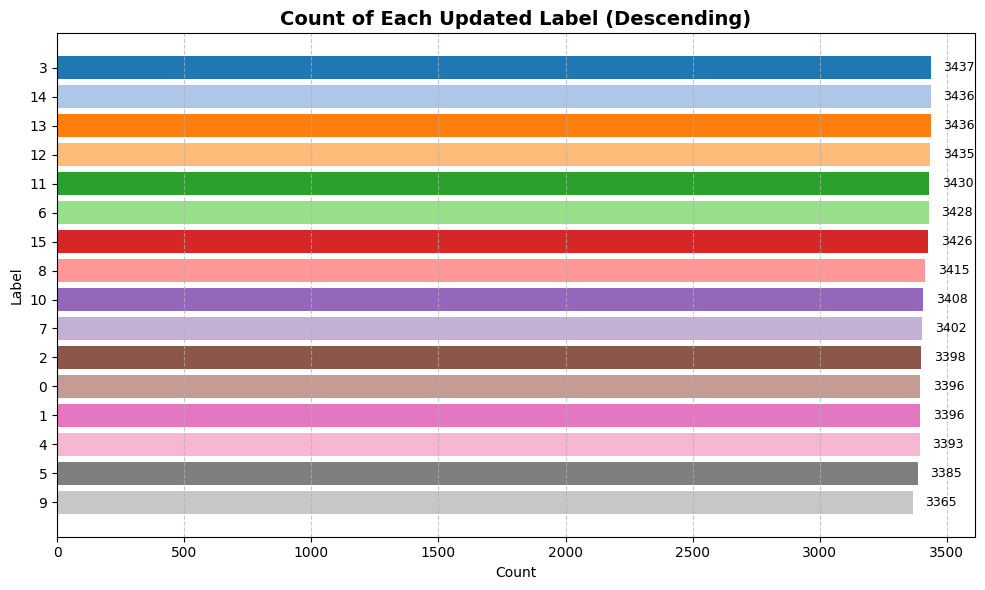

In [43]:
print("Unique labels after mapping:", sorted(np.unique(mapped_labels))) 

# Count occurrences using the updated labels
label_counts = pd.Series(mapped_labels).value_counts().sort_values(ascending=False)

# Plot as horizontal bar chart
plt.figure(figsize=(10, 6))
bars = plt.barh(label_counts.index.astype(str), label_counts.values, color=plt.cm.tab20.colors)

# Add count values next to bars
for bar, value in zip(bars, label_counts.values):
    plt.text(value + 50, bar.get_y() + bar.get_height()/2,
             str(value), va='center', fontsize=9)

plt.title("Count of Each Updated Label (Descending)", fontsize=14, fontweight='bold')
plt.xlabel("Count")
plt.ylabel("Label")
plt.gca().invert_yaxis()  # So highest count is at the top
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


-------

## Image Average

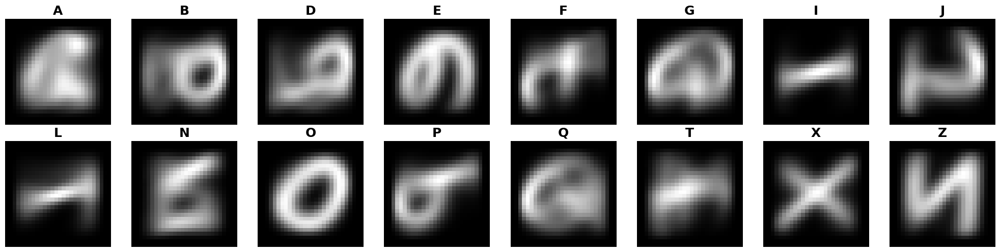

In [22]:
import numpy as np
import matplotlib.pyplot as plt


images = images.reshape(-1, 28, 28)
labels = np.asarray(labels).astype(int)

chosen = list("ABDEFGIJLNOPQTXZ")   # 16 letters
rows, cols = 2, 8
fig, ax = plt.subplots(rows, cols, figsize=(20, 5))
ax = ax.ravel()

for i, ch in enumerate(chosen):
    lab = ord(ch.lower()) - 96       # 'a'->1, ..., 'z'->26
    class_imgs = images[labels == lab]

    avg_img = np.mean(class_imgs, axis=0) if len(class_imgs) else np.zeros((28, 28))
    ax[i].imshow(avg_img, cmap='gray')
    ax[i].set_title(ch, fontsize=18, fontweight='bold')
    ax[i].axis('off')

# hide any leftover axes (shouldn't be any, but just in case)
for j in range(len(chosen), rows*cols):
    ax[j].axis('off')

plt.tight_layout()
plt.show()


- These are the per-letter average images for the 16 target classes, and they appear blurry due to variations in handwriting styles across samples.
- Hard to distinguish the features
----

<a id="fe"></a>
# Feature Engineering

### Image Preprocessing Summary

To prepare the EMNIST images for Conditional GAN training, the following preprocessing steps were applied:

1. **Reshape**  
   The flat image arrays were reshaped into 28×28 pixel format to match the original image dimensions.

2. **Rotate and Flip**  
   The EMNIST dataset stores images in a transposed and inverted format. We corrected this by rotating each image 90 degrees counter-clockwise and flipping it horizontally to restore proper orientation.

3. **Expand Dimensions**  
   A channel dimension was added to represent grayscale format, resulting in image shapes of (28, 28, 1) — required for convolutional neural networks.

4. **Normalize**  
   Pixel values were scaled from the original [0, 255] range to [-1, 1], which is important for stabilizing GAN training and matching the output activation (`tanh`) of the generator.


In [20]:
# Reshape to (28, 28)
images = images.reshape(-1, 28, 28)

# Rotate 90° clockwise, then flip horizontally (fix EMNIST format)
images = np.array([np.fliplr(np.rot90(img, k=-1)) for img in images])

# Reshape to (N, 28, 28, 1)
images = images.reshape(-1, 28, 28, 1)

# Normalize AFTER fixing orientation
images = (images - 127.5) / 127.5

# Final check
print("Final image shape:", images.shape)

Final image shape: (54588, 28, 28, 1)


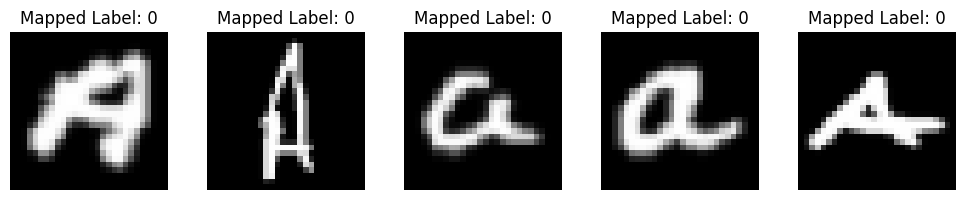

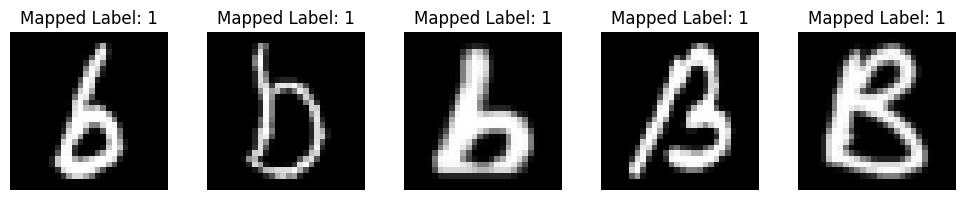

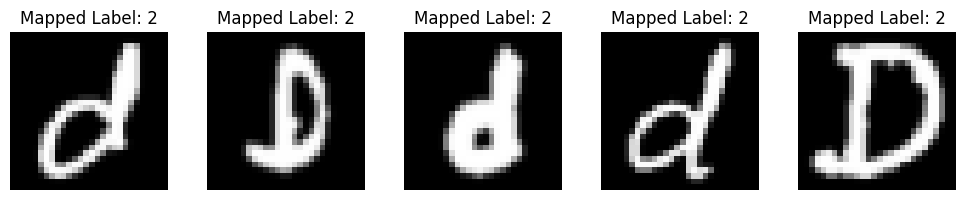

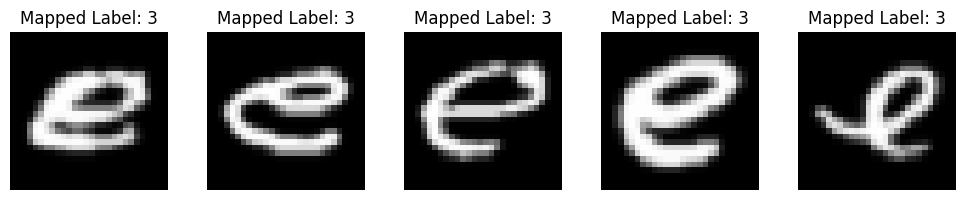

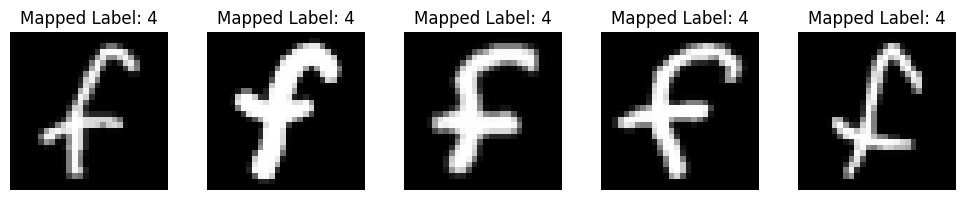

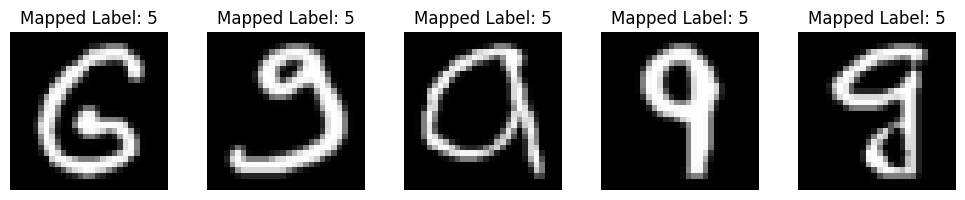

In [142]:
def plot_mapped_class_images(mapped_class_label, n=5):
    indices = df[df['mapped_label'] == mapped_class_label].index[:n]
    plt.figure(figsize=(10, 2))
    for i, idx in enumerate(indices):
        img = images[idx].reshape(28, 28)
        plt.subplot(1, n, i + 1)
        plt.imshow(img, cmap='gray') 
        plt.title(f"Mapped Label: {mapped_class_label}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()


for i in range(6):
    plot_mapped_class_images(i)


<a id="generate-word"></a>
# Generate Word

## Word Generation using Trained CGAN

This function allows to generate and visualize images of letters from a trained Conditional GAN (CGAN) model. The model supports **16 uppercase letters**:

**A, B, D, E, F, G, I, J, L, N, O, P, Q, T, X, Z**

### How It Works:
- Filters valid letters from input (e.g., "Hello" → "E", "L", "L", "O")
- Converts letters to label indices based on `label_to_char`
- Generates noise and uses the trained generator to produce letter images
- Displays them using matplotlib


In [143]:
# === Word generation function ===
label_to_char = {
    0: 'A', 1: 'B', 2: 'D', 3: 'E',
    4: 'F', 5: 'G', 6: 'I', 7: 'J',
    8: 'L', 9: 'N', 10: 'O', 11: 'P',
    12: 'Q', 13: 'T', 14: 'X', 15: 'Z'
}
inv_map = {v: k for k, v in label_to_char.items()}

def generate_word(model, word):
    valid_chars = [c.upper() for c in word if c.upper() in inv_map]
    char_indices = [inv_map[c] for c in valid_chars]
    if not char_indices:
        print("No valid letters to generate.")
        return
    noise = tf.random.normal((len(char_indices), latent_dim))
    labels = tf.constant([[i] for i in char_indices], dtype=tf.int32)
    gen_imgs = model([noise, labels], training=False)
    gen_imgs = 0.5 * gen_imgs + 0.5  # scale to [0,1]
    fig, axs = plt.subplots(1, len(valid_chars), figsize=(len(valid_chars)*1.5, 2))
    for i, char in enumerate(valid_chars):
        axs[i].imshow(gen_imgs[i, :, :, 0], cmap='gray')
        axs[i].axis('off')
        axs[i].set_title(char)
    plt.tight_layout()
    plt.show()


<a id="cgan"></a>
# Baseline Model - CGAN

### Baseline Conditional GAN Architecture

We implemented a simple baseline Conditional GAN using fully connected (dense) layers for both the generator and discriminator. This architecture serves as a starting point before experimenting with deeper or convolutional designs.

#### Generator Overview
- **Inputs:**  
  - Noise vector (`latent_dim`-dimensional)  
  - Class label (integer from 0 to 15)

- **Label Conditioning:**  
  The label is embedded into a vector of the same size as the noise vector, and then element-wise multiplied with the noise to combine label and latent information.

- **Network Structure:**  
  - Dense (256 units) → BatchNorm → LeakyReLU  
  - Dense (512 units) → BatchNorm → LeakyReLU  
  - Dense (flattened image size) → Reshape to image shape  
  - Output activation: `tanh` (to match [-1, 1] normalization)

#### Discriminator Overview
- **Inputs:**  
  - Image (28×28×1)  
  - Class label (integer from 0 to 15)

- **Label Conditioning:**  
  The label is embedded and flattened, then concatenated with the flattened image.

- **Network Structure:**  
  - Dense (256 units) → LeakyReLU  
  - Dense (1 unit) with `sigmoid` activation for real/fake classification

This architecture is kept intentionally simple to establish a baseline for performance and output quality, and is especially suitable for flattened grayscale image datasets like EMNIST.


In [343]:
def build_baseline_generator():
    noise = tf.keras.Input(shape=(latent_dim,))
    label = tf.keras.Input(shape=(1,), dtype='int32')

    label_embedding = tf.keras.layers.Embedding(num_classes, latent_dim)(label)
    label_embedding = tf.keras.layers.Flatten()(label_embedding)

    combined = tf.keras.layers.Multiply()([noise, label_embedding])

    x = tf.keras.layers.Dense(256)(combined)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)

    x = tf.keras.layers.Dense(512)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)

    x = tf.keras.layers.Dense(np.prod(image_shape), activation='tanh')(x)
    output_img = tf.keras.layers.Reshape(image_shape)(x)

    return tf.keras.Model([noise, label], output_img)



def build_baseline_discriminator():
    img = tf.keras.Input(shape=image_shape)
    label = tf.keras.Input(shape=(1,), dtype='int32')

    label_embedding = tf.keras.layers.Embedding(num_classes, np.prod(image_shape))(label)
    label_embedding = tf.keras.layers.Flatten()(label_embedding)

    flat_img = tf.keras.layers.Flatten()(img)
    combined = tf.keras.layers.Concatenate()([flat_img, label_embedding])

    x = tf.keras.layers.Dense(256)(combined)
    x = LeakyReLU(0.2)(x)
    output = tf.keras.layers.Dense(1, activation='sigmoid')(x)

    return tf.keras.Model([img, label], output)




##  Prepare Dataset and Instantiate Models

### Dataset and Model Initialization Summary

We begin by preparing our dataset and initializing the components of a Conditional GAN (CGAN) designed for image generation.

---

#### Generator

- Learns to generate realistic images conditioned on class labels.
- Trained to fool the discriminator into classifying generated images as real.

---

#### Discriminator

- Learns to distinguish real images from generated (fake) ones.
- Takes both the image and the corresponding label as input.
- Trained to output:
  - 1 for real images
  - 0 for fake images

---

#### Loss Function: Binary Crossentropy

- Used for both generator and discriminator training.
- Encourages:
  - The discriminator to correctly identify real vs. fake images.
  - The generator to fool the discriminator.

---

#### Optimizers: Adam

- Optimizer: `Adam(learning_rate=0.0002, beta_1=0.5)`
- A low learning rate and `beta_1=0.5` help to stabilize GAN training.
- Separate optimizers are used for the generator and discriminator to allow independent updates.

---


In [ ]:
# === Preparing the dataset ===
dataset = tf.data.Dataset.from_tensor_slices((images, mapped_labels))
dataset = dataset.shuffle(10000).batch(batch_size, drop_remainder=True)

# === Instantiate models and optimizers ===
generator = build_baseline_generator()
discriminator = build_baseline_discriminator()

bce = tf.keras.losses.BinaryCrossentropy()
g_opt = tf.keras.optimizers.Adam(0.0002, 0.5)
d_opt = tf.keras.optimizers.Adam(0.0002, 0.5)

In [344]:
generator.summary()
discriminator.summary()

Model: "model_51"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_106 (InputLayer)         [(None, 1)]          0           []                               
                                                                                                  
 embedding_52 (Embedding)       (None, 1, 150)       2400        ['input_106[0][0]']              
                                                                                                  
 input_105 (InputLayer)         [(None, 150)]        0           []                               
                                                                                                  
 flatten_78 (Flatten)           (None, 150)          0           ['embedding_52[0][0]']           
                                                                                           

### Training Step Function

This function performs one training step for both the discriminator and generator in a Conditional GAN (CGAN).

#### Workflow:

1. **Prepare Targets**
   - `valid`: Tensor of ones for real images (label = 1).
   - `fake`: Tensor of zeros for generated images (label = 0).

2. **Generate Fake Images**
   - Sample random noise and random labels.
   - Pass through the generator to produce fake images.

3. **Train Discriminator**
   - Predict on real and fake images.
   - Compute loss using Binary Crossentropy:
     - Real images should output 1.
     - Fake images should output 0.
   - Update discriminator weights using gradients.

4. **Train Generator**
   - Generate new fake images with fresh noise and labels.
   - Compute loss: generator wants the discriminator to predict 1 for fake images.
   - Update generator weights using gradients.

5. **Discriminator Accuracy**
   - `real_acc`: Percentage of real images classified as real.
   - `fake_acc`: Percentage of fake images classified as fake.
   - `d_acc`: Average of real and fake accuracy.

---

In [345]:

# === Training step ===
@tf.function
def train_step(real_imgs, real_labels):
    batch_size = tf.shape(real_imgs)[0]
    valid = tf.ones((batch_size, 1))
    fake = tf.zeros((batch_size, 1))
    
    noise = tf.random.normal((batch_size, latent_dim))
    gen_labels = tf.random.uniform((batch_size, 1), 0, num_classes, dtype=tf.int32)
    fake_imgs = generator([noise, gen_labels], training=True)
    
    with tf.GradientTape() as tape:
        d_real = discriminator([real_imgs, tf.expand_dims(real_labels, 1)], training=True)
        d_fake = discriminator([fake_imgs, gen_labels], training=True)
        d_loss = 0.5 * (bce(valid, d_real) + bce(fake, d_fake))
    d_grads = tape.gradient(d_loss, discriminator.trainable_variables)
    d_opt.apply_gradients(zip(d_grads, discriminator.trainable_variables))
    
    noise = tf.random.normal((batch_size, latent_dim))
    gen_labels = tf.random.uniform((batch_size, 1), 0, num_classes, dtype=tf.int32)
    with tf.GradientTape() as tape:
        gen_imgs = generator([noise, gen_labels], training=True)
        validity = discriminator([gen_imgs, gen_labels], training=True)
        g_loss = bce(valid, validity)
    g_grads = tape.gradient(g_loss, generator.trainable_variables)
    g_opt.apply_gradients(zip(g_grads, generator.trainable_variables))

    # Calculate accuracy
    real_acc = tf.reduce_mean(tf.cast(d_real > 0.5, tf.float32))
    fake_acc = tf.reduce_mean(tf.cast(d_fake < 0.5, tf.float32))
    d_acc = 0.5 * (real_acc + fake_acc)

    
    return d_loss, g_loss, d_acc




### Image Preview Function

This utility function generates a grid of sample images from the generator for visual inspection.

#### Workflow:

1. **Generate Images**
   - For each class label (0 to `num_classes - 1`), generate `num_per_class` images using random noise.

2. **Postprocessing**
   - Rescale pixel values from [-1, 1] to [0, 1] for visualization.

3. **Display**
   - Arrange images in a grid.
   - Each row corresponds to a class label (A–Z).
   - Hide axes for cleaner visualization.

In [ ]:
# === Image preview function ===
def generate_and_show_images(model, num_per_class=10):
    all_images = []
    for label in range(num_classes):
        noise = tf.random.normal((num_per_class, latent_dim))
        labels = tf.constant([label]*num_per_class, shape=(num_per_class, 1), dtype=tf.int32)
        gen_imgs = model([noise, labels], training=False)
        gen_imgs = 0.5 * gen_imgs + 0.5  # scale to [0,1]
        all_images.append(gen_imgs.numpy())
    all_images = np.concatenate(all_images, axis=0)
    
    fig, axes = plt.subplots(num_classes, num_per_class, figsize=(num_per_class*1.5, num_classes*1.5))
    for i in range(num_classes*num_per_class):
        row = i // num_per_class
        col = i % num_per_class
        ax = axes[row, col] if num_classes > 1 else axes[col]
        ax.imshow(all_images[i, :, :, 0], cmap='gray')
        ax.axis('off')
        if col == 0:
            ax.set_ylabel(chr(ord('A') + row), fontsize=12)
    plt.tight_layout()
    plt.show()

### Training Loop

This is the main loop for training the Conditional GAN (CGAN).

#### Overview:

- Runs for a specified number of epochs.
- In each epoch, it iterates over batches from the training dataset and:
  1. Trains the discriminator and generator via `train_step()`.
  2. Logs and stores the loss and discriminator accuracy.
  3. Saves the generator weights if the generator achieves the best loss so far.
  4. Displays generated images every 10 epochs to visually inspect progress.


#### Key Variables:

- `d_losses`: List to store discriminator loss over epochs.
- `g_losses`: List to store generator loss over epochs.
- `d_accuracies`: List to store discriminator accuracy over epochs.
- `best_g_loss`: Tracks the lowest generator loss to save the best weights.


#### Checkpoints:

- **Best Weights**:
  - Saved to `"best_generator.h5"` when a new best generator loss is found.
- **Final Weights**:
  - Saved to `"1final_generator.h5"` and `"1final_discriminator.h5"` at the end of training.



#### Image Previews:

- Every 10 epochs, the function `generate_and_show_images()` is called to visualize sample outputs from the generator.


Epoch 1 | D Loss: 0.5211 | G Loss: 1.1160 | D Acc: 0.7812
Best generator saved at epoch 1
Epoch 2 | D Loss: 0.6072 | G Loss: 1.5938 | D Acc: 0.6172
Epoch 3 | D Loss: 0.5631 | G Loss: 0.7762 | D Acc: 0.7422
Best generator saved at epoch 3
Epoch 4 | D Loss: 0.5009 | G Loss: 1.0723 | D Acc: 0.7812
Epoch 5 | D Loss: 0.6044 | G Loss: 1.1920 | D Acc: 0.6562
Epoch 6 | D Loss: 0.6973 | G Loss: 1.2605 | D Acc: 0.5469
Epoch 7 | D Loss: 0.6536 | G Loss: 1.0217 | D Acc: 0.6172
Epoch 8 | D Loss: 0.6374 | G Loss: 0.9616 | D Acc: 0.6484
Epoch 9 | D Loss: 0.6335 | G Loss: 1.0850 | D Acc: 0.6719
Epoch 10 | D Loss: 0.6669 | G Loss: 0.6719 | D Acc: 0.5625
Best generator saved at epoch 10
Preview images at epoch 10:


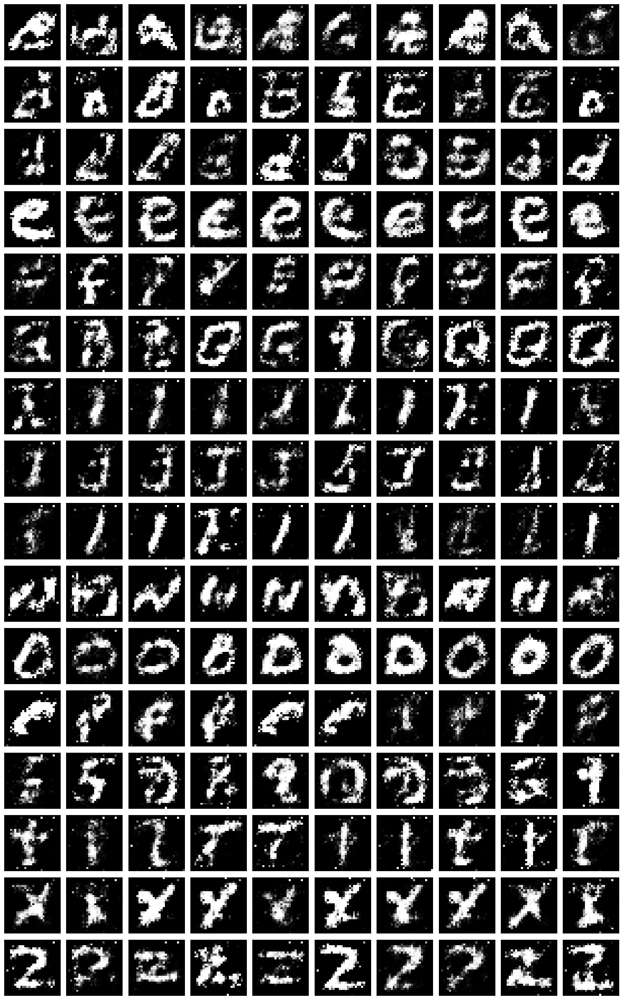

Epoch 11 | D Loss: 0.7387 | G Loss: 0.7370 | D Acc: 0.5312
Epoch 12 | D Loss: 0.7042 | G Loss: 0.6324 | D Acc: 0.6016
Best generator saved at epoch 12
Epoch 13 | D Loss: 0.6461 | G Loss: 0.7721 | D Acc: 0.6016
Epoch 14 | D Loss: 0.6448 | G Loss: 0.6898 | D Acc: 0.6562
Epoch 15 | D Loss: 0.7017 | G Loss: 0.6039 | D Acc: 0.5234
Best generator saved at epoch 15
Epoch 16 | D Loss: 0.6888 | G Loss: 0.9629 | D Acc: 0.5547
Epoch 17 | D Loss: 0.6808 | G Loss: 0.8218 | D Acc: 0.5938
Epoch 18 | D Loss: 0.6889 | G Loss: 0.6265 | D Acc: 0.5781
Epoch 19 | D Loss: 0.6736 | G Loss: 1.1060 | D Acc: 0.6094
Epoch 20 | D Loss: 0.6788 | G Loss: 0.8654 | D Acc: 0.5469
Preview images at epoch 20:


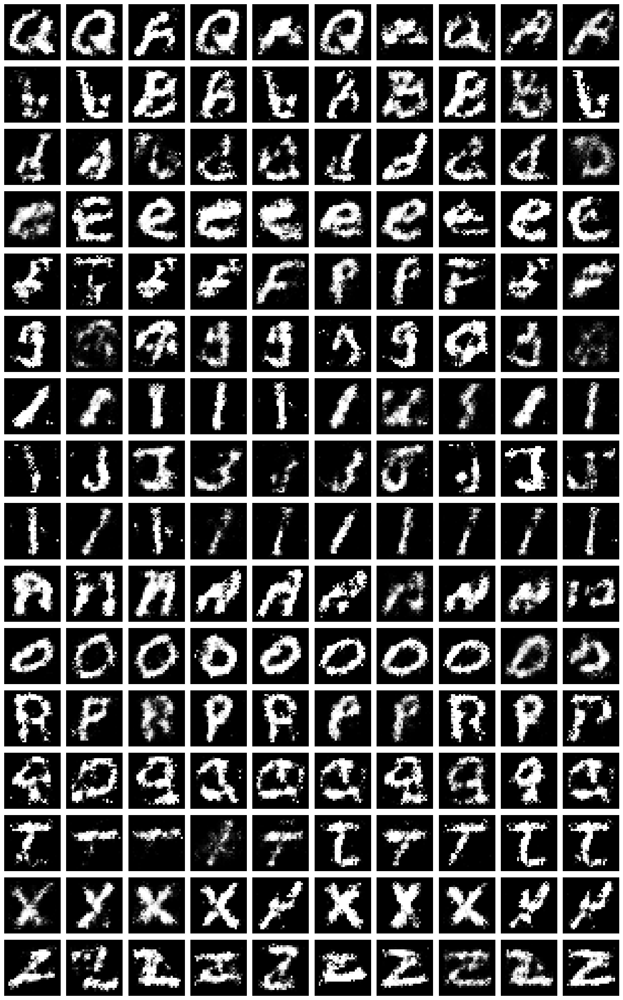

Epoch 21 | D Loss: 0.6377 | G Loss: 0.8462 | D Acc: 0.6562
Epoch 22 | D Loss: 0.6369 | G Loss: 0.7820 | D Acc: 0.6484
Epoch 23 | D Loss: 0.6330 | G Loss: 0.7761 | D Acc: 0.6797
Epoch 24 | D Loss: 0.6754 | G Loss: 0.9023 | D Acc: 0.5547
Epoch 25 | D Loss: 0.6933 | G Loss: 0.9166 | D Acc: 0.5234
Epoch 26 | D Loss: 0.6733 | G Loss: 0.5644 | D Acc: 0.6094
Best generator saved at epoch 26
Epoch 27 | D Loss: 0.6618 | G Loss: 1.0726 | D Acc: 0.5547
Epoch 28 | D Loss: 0.6293 | G Loss: 1.1321 | D Acc: 0.6406
Epoch 29 | D Loss: 0.6400 | G Loss: 1.0355 | D Acc: 0.6328
Epoch 30 | D Loss: 0.6236 | G Loss: 0.7766 | D Acc: 0.6719
Preview images at epoch 30:


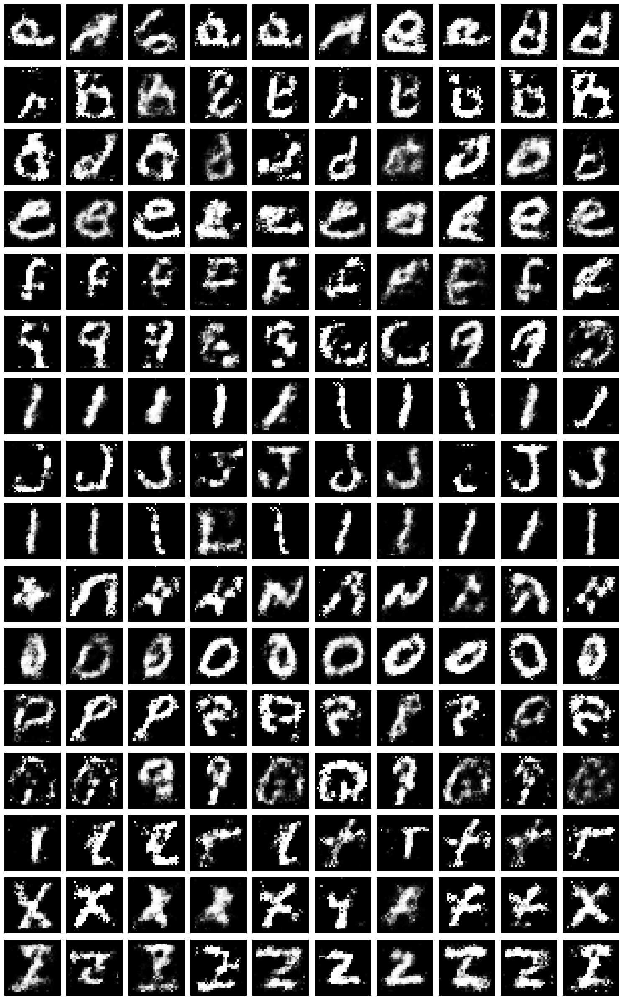

Epoch 31 | D Loss: 0.5874 | G Loss: 1.1690 | D Acc: 0.6641
Epoch 32 | D Loss: 0.6063 | G Loss: 0.8035 | D Acc: 0.6562
Epoch 33 | D Loss: 0.6105 | G Loss: 0.6489 | D Acc: 0.6484
Epoch 34 | D Loss: 0.5763 | G Loss: 1.0869 | D Acc: 0.6797
Epoch 35 | D Loss: 0.5970 | G Loss: 0.9413 | D Acc: 0.7266
Epoch 36 | D Loss: 0.6126 | G Loss: 0.8262 | D Acc: 0.6484
Epoch 37 | D Loss: 0.5876 | G Loss: 0.9279 | D Acc: 0.6875
Epoch 38 | D Loss: 0.5954 | G Loss: 0.6075 | D Acc: 0.6562
Epoch 39 | D Loss: 0.5834 | G Loss: 1.2220 | D Acc: 0.6562
Epoch 40 | D Loss: 0.5565 | G Loss: 0.9445 | D Acc: 0.7188
Preview images at epoch 40:


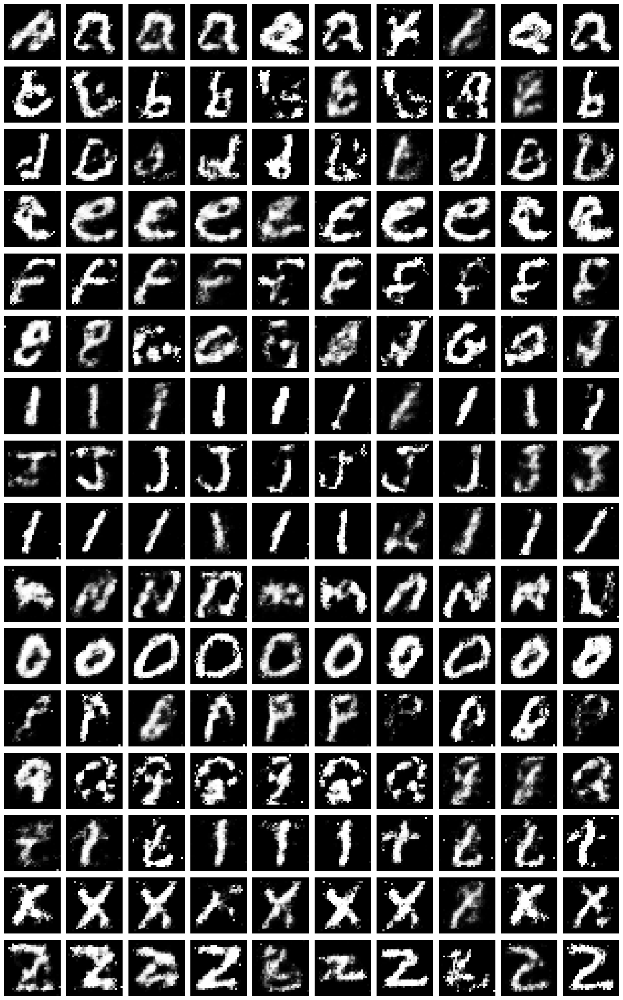

Epoch 41 | D Loss: 0.5782 | G Loss: 1.2021 | D Acc: 0.7031
Epoch 42 | D Loss: 0.6302 | G Loss: 0.8778 | D Acc: 0.6562
Epoch 43 | D Loss: 0.5552 | G Loss: 1.0344 | D Acc: 0.7109
Epoch 44 | D Loss: 0.5509 | G Loss: 0.7239 | D Acc: 0.7344
Epoch 45 | D Loss: 0.6031 | G Loss: 0.9050 | D Acc: 0.6562
Epoch 46 | D Loss: 0.6515 | G Loss: 0.9030 | D Acc: 0.6016
Epoch 47 | D Loss: 0.5796 | G Loss: 0.9174 | D Acc: 0.6953
Epoch 48 | D Loss: 0.5726 | G Loss: 0.8024 | D Acc: 0.7734
Epoch 49 | D Loss: 0.6431 | G Loss: 1.0353 | D Acc: 0.6406
Epoch 50 | D Loss: 0.6136 | G Loss: 1.1520 | D Acc: 0.6562
Preview images at epoch 50:


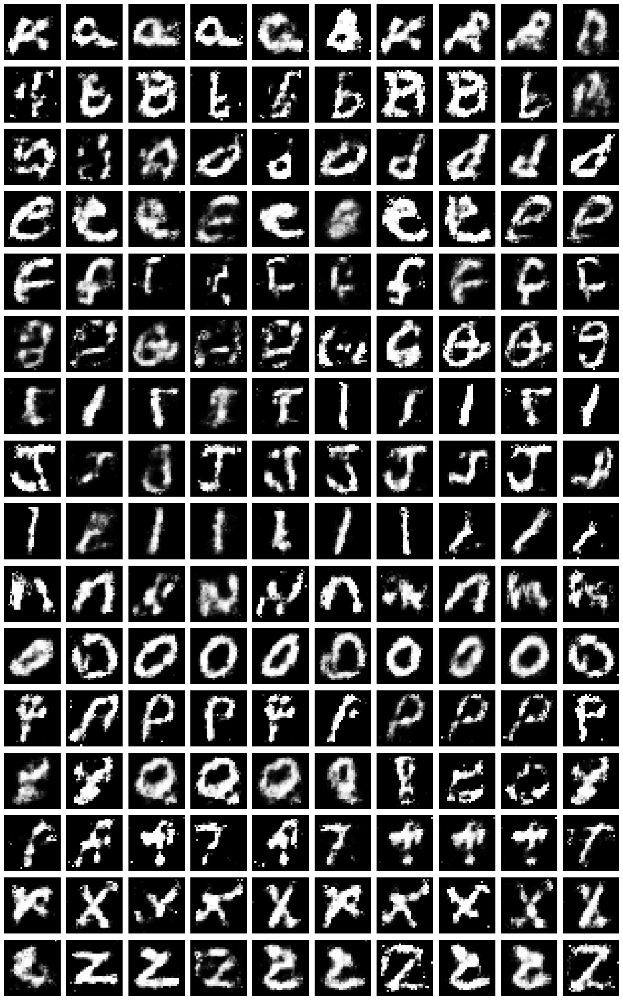

Final weights saved.


In [346]:
# === Training loop ===
best_g_loss = float('inf')
d_losses = []
g_losses = []
d_accuracies = []

for epoch in range(1, epochs + 1):
    for real_imgs, real_labels in dataset:
        d_loss, g_loss, d_acc = train_step(real_imgs, real_labels)

    d_losses.append(d_loss.numpy())
    g_losses.append(g_loss.numpy())
    d_accuracies.append(d_acc.numpy())  # Store accuracy

    print(f"Epoch {epoch} | D Loss: {d_loss:.4f} | G Loss: {g_loss:.4f} | D Acc: {d_acc:.4f}")

    if g_loss < best_g_loss:
        best_g_loss = g_loss
        generator.save_weights("best_generator.h5")
        print(f"Best generator saved at epoch {epoch}")

    if epoch % 10 == 0:
        print(f"Preview images at epoch {epoch}:")
        generate_and_show_images(generator)

# Save final weights after training
generator.save_weights("1final_generator.h5")
discriminator.save_weights("1final_discriminator.h5")
print("Final weights saved.")


### Discriminator Accuracy over Epochs

This plot tracks the discriminator’s classification performance during training.

- **X-axis**: Training epoch.
- **Y-axis**: Discriminator accuracy, averaged over real and fake predictions.
- Higher values indicate the discriminator is correctly identifying real vs. fake images.
- A consistently high accuracy may suggest the discriminator is overpowering the generator.
- A low accuracy might indicate the generator is producing realistic images or the discriminator is underperforming.



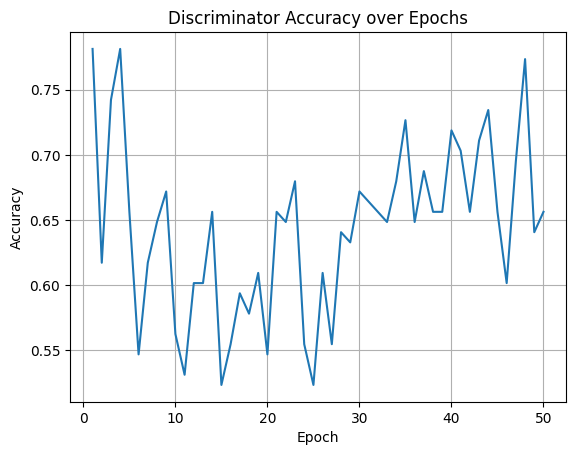

In [347]:
plt.plot(range(1, epochs+1), d_accuracies, label="Discriminator Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.title("Discriminator Accuracy over Epochs")
plt.grid(True)
plt.show()


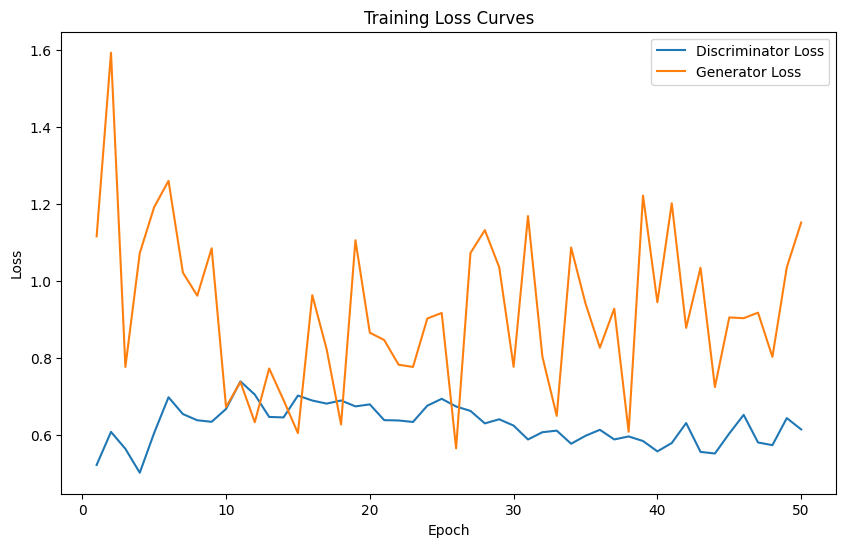

In [348]:
# Plot losses
plt.figure(figsize=(10,6))
plt.plot(range(1, epochs+1), d_losses, label='Discriminator Loss')
plt.plot(range(1, epochs+1), g_losses, label='Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Curves')
plt.legend()
plt.show()

In [349]:

generator.save_weights("1final_generator.h5")
discriminator.save_weights("1final_discriminator.h5")
print("Final weights saved.")

Final weights saved.


Preview from best weights:


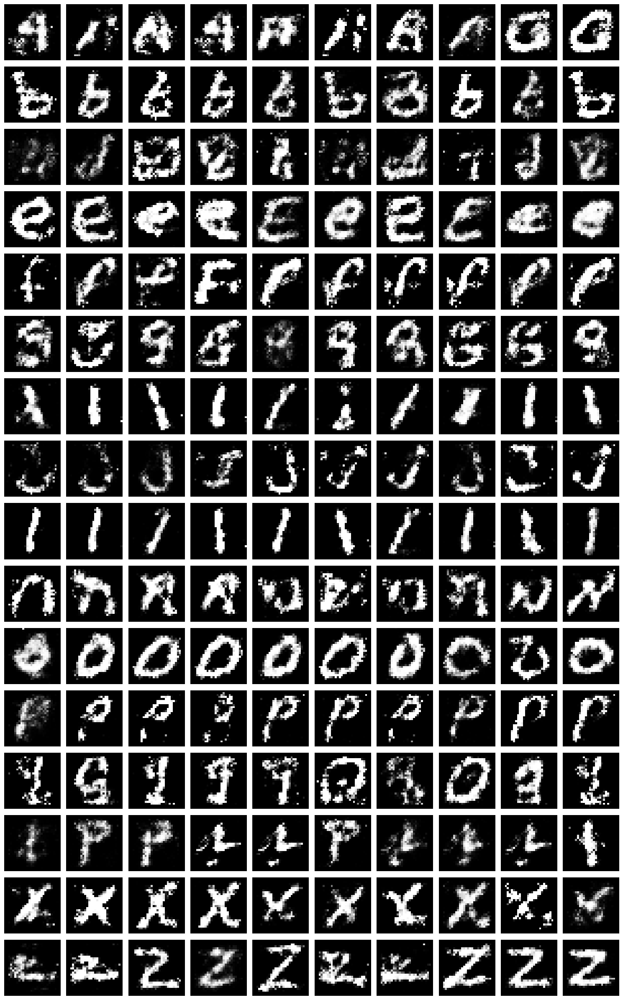

In [351]:

print("Preview from best weights:")
generator.load_weights("best_generator.h5")
generate_and_show_images(generator)


Word 'DEEP LEANING' from best weights:


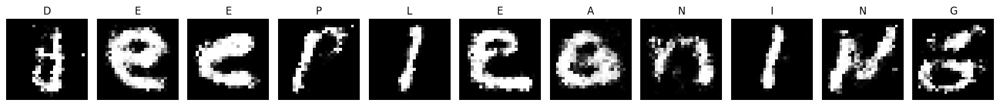

In [352]:

print("Word 'DEEP LEANING' from best weights:")
generate_word(generator, "DEEP LEANING")


Preview from final weights:


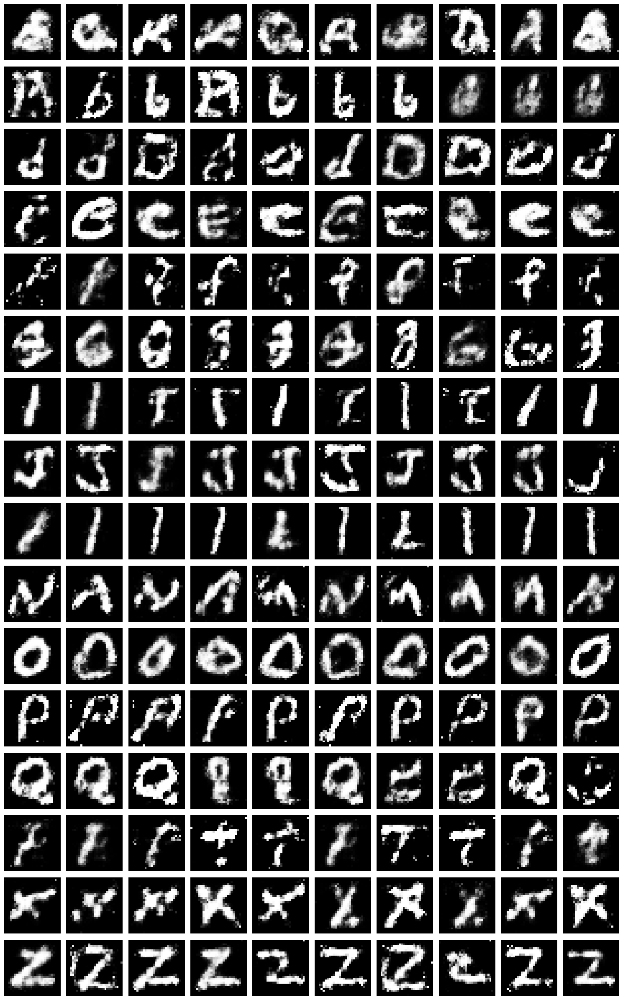

In [353]:

print("Preview from final weights:")
generator.load_weights("1final_generator.h5")
generate_and_show_images(generator)


Word 'DEEP LEANING' from final weights:


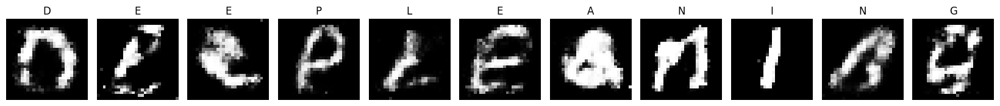

In [354]:

print("Word 'DEEP LEANING' from final weights:")
generate_word(generator, "DEEP LEANING")


<a id="cd cgan"></a>
# Baseline Model - CDCGAN (Conditional Deep Convolutional GAN (CDCGAN))

### Generator and Discriminator Architecture (cDCGAN)

This Conditional DCGAN (cDCGAN) architecture allows the model to generate and evaluate images conditioned on class labels.

---

#### Generator (`build_cdcgan_generator`)

- **Inputs**:
  - `noise`: Random latent vector of shape `(latent_dim,)`.
  - `label`: Integer label from 0 to `num_classes - 1`.

- **Process**:
  1. Embed label and multiply with noise vector.
  2. Fully connected layer reshaped into 7×7 feature maps.
  3. Use transposed convolution layers to upsample to 28×28.
  4. Apply `BatchNormalization` and `LeakyReLU` after each layer.
  5. Output uses `tanh` activation to scale image values to [-1, 1].

- **Output**:
  - A single-channel (grayscale) image of shape `(28, 28, 1)`.

---

#### Discriminator (`build_cdcgan_discriminator`)

- **Inputs**:
  - `img`: Input image of shape `(28, 28, 1)`.
  - `label`: Integer label corresponding to the image.

- **Process**:
  1. Embed label and reshape to match image size.
  2. Concatenate embedded label with image along the channel axis.
  3. Apply convolutional layers to extract features.
  4. Use `LeakyReLU` activations and dropout for regularization.
  5. Output a single value with `sigmoid`, indicating real or fake.

- **Output**:
  - A scalar probability that the image is real (1) or fake (0).

---

### Dataset Preparation

- The dataset is created using `tf.data.Dataset.from_tensor_slices()`:
  - `images`: Real EMNIST images.
  - `mapped_labels`: Corresponding integer class labels (0–15).
- Shuffled and batched for training:
  - `batch_size = 64`
  - `drop_remainder=True` ensures consistent batch size.


In [359]:

latent_dim = 150
num_classes = 16
image_shape = (28, 28, 1)
batch_size = 64
epochs = 50

def build_cdcgan_generator():
    noise = tf.keras.Input(shape=(latent_dim,))
    label = tf.keras.Input(shape=(1,), dtype='int32')
    label_embedding = tf.keras.layers.Embedding(num_classes, latent_dim)(label)
    label_embedding = tf.keras.layers.Flatten()(label_embedding)
    combined = tf.keras.layers.Multiply()([noise, label_embedding])
    x = tf.keras.layers.Dense(7*7*256, use_bias=False)(combined)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)
    x = tf.keras.layers.Reshape((7, 7, 256))(x)
    x = tf.keras.layers.Conv2DTranspose(128, 4, strides=2, padding='same', use_bias=False)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)
    x = tf.keras.layers.Conv2DTranspose(64, 4, strides=2, padding='same', use_bias=False)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)
    output_img = tf.keras.layers.Conv2D(1, 7, padding='same', activation='tanh')(x)
    return tf.keras.Model([noise, label], output_img)

def build_cdcgan_discriminator():
    img = tf.keras.Input(shape=image_shape)
    label = tf.keras.Input(shape=(1,), dtype='int32')
    label_embedding = tf.keras.layers.Embedding(num_classes, np.prod(image_shape))(label)
    label_embedding = tf.keras.layers.Flatten()(label_embedding)
    label_embedding = tf.keras.layers.Reshape(image_shape)(label_embedding)
    combined = tf.keras.layers.Concatenate(axis=-1)([img, label_embedding])
    x = tf.keras.layers.Conv2D(64, 4, strides=2, padding='same')(combined)
    x = LeakyReLU(0.2)(x)
    x = Dropout(0.3)(x)
    x = tf.keras.layers.Conv2D(128, 4, strides=2, padding='same')(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)
    x = Dropout(0.3)(x)
    x = tf.keras.layers.Flatten()(x)
    output = tf.keras.layers.Dense(1, activation='sigmoid')(x)
    return tf.keras.Model([img, label], output)

dataset = tf.data.Dataset.from_tensor_slices((images, mapped_labels))
dataset = dataset.shuffle(10000).batch(batch_size, drop_remainder=True)



In [360]:
generator = build_cdcgan_generator()
discriminator = build_cdcgan_discriminator()
bce = tf.keras.losses.BinaryCrossentropy()
g_opt = tf.keras.optimizers.Adam(0.0002, 0.5)
d_opt = tf.keras.optimizers.Adam(0.0002, 0.5)

generator.summary()
discriminator.summary()

Model: "model_55"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_114 (InputLayer)         [(None, 1)]          0           []                               
                                                                                                  
 embedding_56 (Embedding)       (None, 1, 150)       2400        ['input_114[0][0]']              
                                                                                                  
 input_113 (InputLayer)         [(None, 150)]        0           []                               
                                                                                                  
 flatten_84 (Flatten)           (None, 150)          0           ['embedding_56[0][0]']           
                                                                                           

Epoch 1 | D Loss: 0.2230 | G Loss: 2.6124 | D Acc: 0.9688
Best generator saved at epoch 1
Epoch 2 | D Loss: 0.6321 | G Loss: 1.1065 | D Acc: 0.6328
Best generator saved at epoch 2
Epoch 3 | D Loss: 0.6939 | G Loss: 0.8254 | D Acc: 0.5547
Best generator saved at epoch 3
Epoch 4 | D Loss: 0.6656 | G Loss: 0.6929 | D Acc: 0.6250
Best generator saved at epoch 4
Epoch 5 | D Loss: 0.6952 | G Loss: 0.8405 | D Acc: 0.5781
Epoch 6 | D Loss: 0.6741 | G Loss: 0.8074 | D Acc: 0.5469
Epoch 7 | D Loss: 0.6424 | G Loss: 0.7701 | D Acc: 0.6484
Epoch 8 | D Loss: 0.6338 | G Loss: 0.8239 | D Acc: 0.5703
Epoch 9 | D Loss: 0.6984 | G Loss: 0.6996 | D Acc: 0.5859
Epoch 10 | D Loss: 0.7315 | G Loss: 0.7486 | D Acc: 0.4766
Preview images at epoch 10:


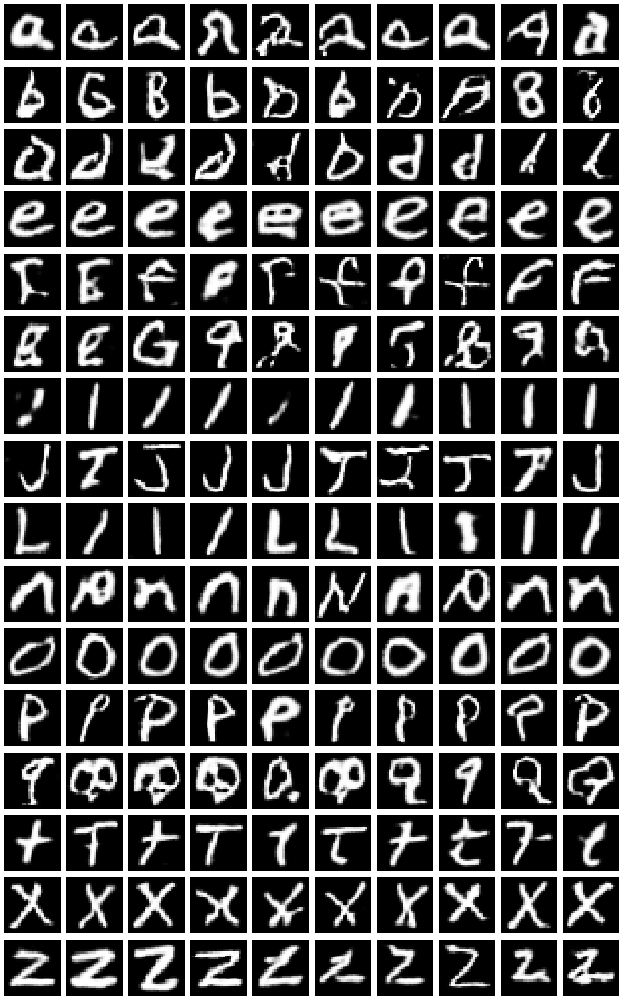

Epoch 11 | D Loss: 0.6988 | G Loss: 0.7633 | D Acc: 0.5391
Epoch 12 | D Loss: 0.7024 | G Loss: 0.7237 | D Acc: 0.5156
Epoch 13 | D Loss: 0.6812 | G Loss: 0.7513 | D Acc: 0.6250
Epoch 14 | D Loss: 0.7015 | G Loss: 0.7161 | D Acc: 0.5000
Epoch 15 | D Loss: 0.6879 | G Loss: 0.7688 | D Acc: 0.5234
Epoch 16 | D Loss: 0.6677 | G Loss: 0.7395 | D Acc: 0.5703
Epoch 17 | D Loss: 0.7019 | G Loss: 0.7258 | D Acc: 0.5000
Epoch 18 | D Loss: 0.6838 | G Loss: 0.6765 | D Acc: 0.5469
Best generator saved at epoch 18
Epoch 19 | D Loss: 0.6648 | G Loss: 0.7855 | D Acc: 0.6016
Epoch 20 | D Loss: 0.6792 | G Loss: 0.6783 | D Acc: 0.5703
Preview images at epoch 20:


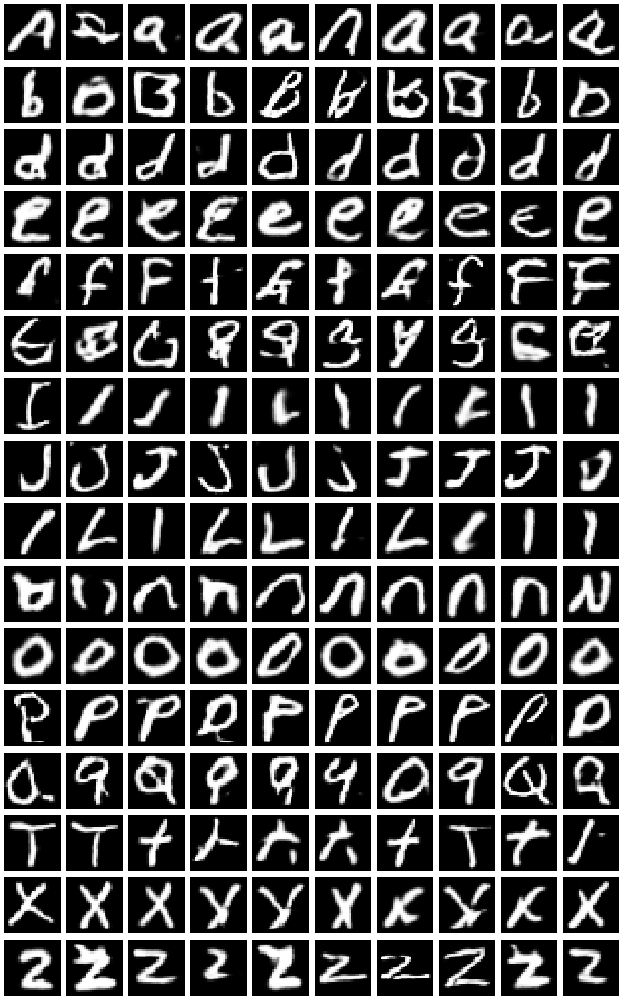

Epoch 21 | D Loss: 0.6845 | G Loss: 0.6939 | D Acc: 0.5547
Epoch 22 | D Loss: 0.6721 | G Loss: 0.6973 | D Acc: 0.5938
Epoch 23 | D Loss: 0.7086 | G Loss: 0.7141 | D Acc: 0.5000
Epoch 24 | D Loss: 0.6908 | G Loss: 0.7269 | D Acc: 0.5312
Epoch 25 | D Loss: 0.7022 | G Loss: 0.7121 | D Acc: 0.5078
Epoch 26 | D Loss: 0.6993 | G Loss: 0.7540 | D Acc: 0.5625
Epoch 27 | D Loss: 0.6793 | G Loss: 0.7388 | D Acc: 0.5391
Epoch 28 | D Loss: 0.7243 | G Loss: 0.7708 | D Acc: 0.4297
Epoch 29 | D Loss: 0.6873 | G Loss: 0.7040 | D Acc: 0.5312
Epoch 30 | D Loss: 0.6786 | G Loss: 0.6918 | D Acc: 0.5625
Preview images at epoch 30:


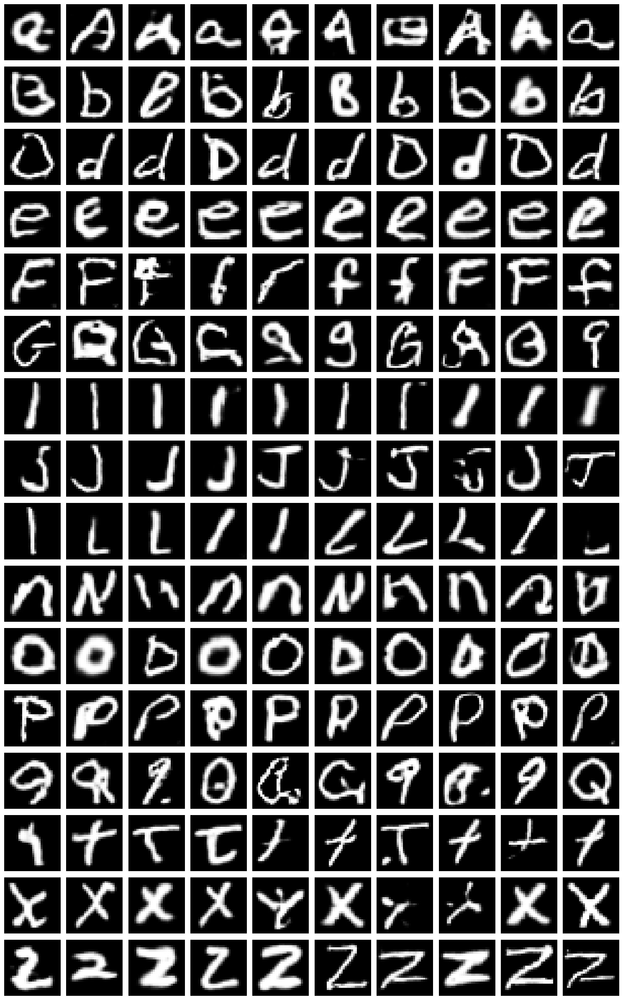

Epoch 31 | D Loss: 0.7326 | G Loss: 0.7072 | D Acc: 0.4453
Epoch 32 | D Loss: 0.7011 | G Loss: 0.7472 | D Acc: 0.5234
Epoch 33 | D Loss: 0.6846 | G Loss: 0.7501 | D Acc: 0.5391
Epoch 34 | D Loss: 0.6915 | G Loss: 0.6761 | D Acc: 0.5703
Best generator saved at epoch 34
Epoch 35 | D Loss: 0.6753 | G Loss: 0.7229 | D Acc: 0.6016
Epoch 36 | D Loss: 0.6865 | G Loss: 0.7257 | D Acc: 0.5391
Epoch 37 | D Loss: 0.6947 | G Loss: 0.6521 | D Acc: 0.5078
Best generator saved at epoch 37
Epoch 38 | D Loss: 0.7050 | G Loss: 0.7146 | D Acc: 0.4531
Epoch 39 | D Loss: 0.7040 | G Loss: 0.7063 | D Acc: 0.4766
Epoch 40 | D Loss: 0.6782 | G Loss: 0.7100 | D Acc: 0.5781
Preview images at epoch 40:


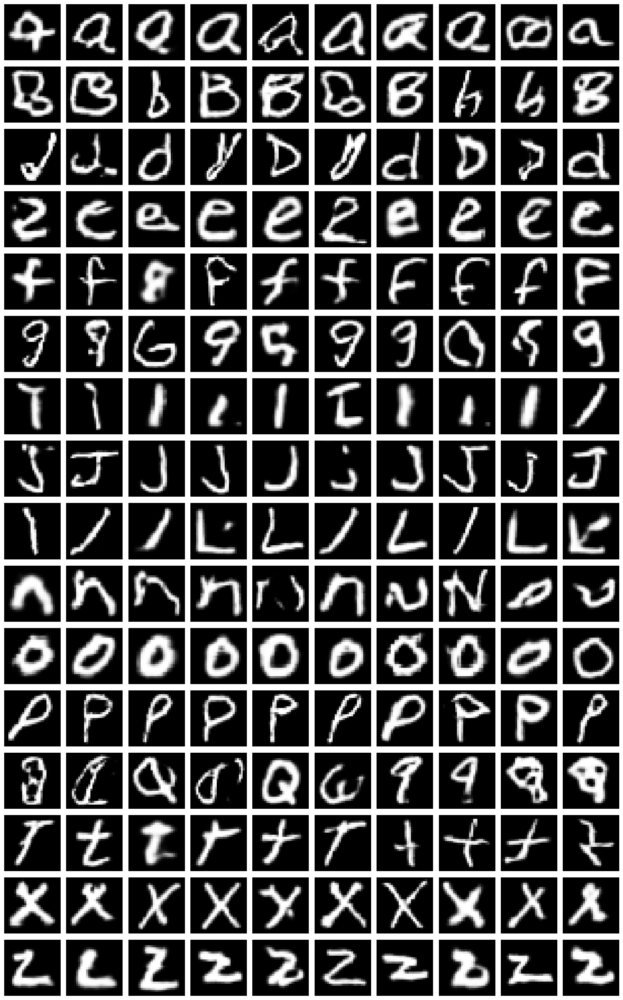

Epoch 41 | D Loss: 0.6887 | G Loss: 0.6508 | D Acc: 0.5547
Best generator saved at epoch 41
Epoch 42 | D Loss: 0.6793 | G Loss: 0.7068 | D Acc: 0.5938
Epoch 43 | D Loss: 0.7087 | G Loss: 0.7394 | D Acc: 0.5234
Epoch 44 | D Loss: 0.6730 | G Loss: 0.7027 | D Acc: 0.5469
Epoch 45 | D Loss: 0.6791 | G Loss: 0.7333 | D Acc: 0.5469
Epoch 46 | D Loss: 0.7139 | G Loss: 0.7354 | D Acc: 0.4375
Epoch 47 | D Loss: 0.7126 | G Loss: 0.7064 | D Acc: 0.4766
Epoch 48 | D Loss: 0.7120 | G Loss: 0.7248 | D Acc: 0.4844
Epoch 49 | D Loss: 0.6866 | G Loss: 0.7087 | D Acc: 0.5781
Epoch 50 | D Loss: 0.6891 | G Loss: 0.6802 | D Acc: 0.5781
Preview images at epoch 50:


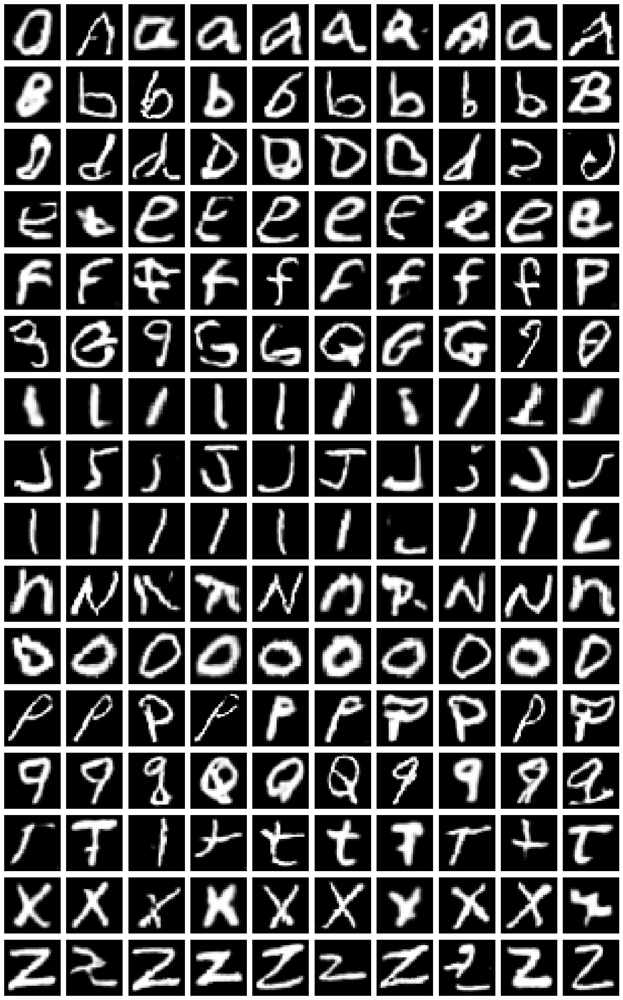

Final weights saved.


In [361]:
# === Training step ===
@tf.function
def train_step(real_imgs, real_labels):
    """
    Performs one training step for both discriminator and generator.
    """
    batch_size = tf.shape(real_imgs)[0]

    # Create labels for real and fake samples
    valid = tf.ones((batch_size, 1))  # Label for real images
    fake = tf.zeros((batch_size, 1))  # Label for fake images
    
    # ===== Train Discriminator =====
    # Generate random noise and random class labels for fake images
    noise = tf.random.normal((batch_size, latent_dim))
    gen_labels = tf.random.uniform((batch_size, 1), 0, num_classes, dtype=tf.int32)
    
    # Generate fake images from noise and labels
    fake_imgs = generator([noise, gen_labels], training=True)
    
    with tf.GradientTape() as tape:
        # Discriminator prediction on real images
        d_real = discriminator([real_imgs, tf.expand_dims(real_labels, 1)], training=True)
        # Discriminator prediction on fake images
        d_fake = discriminator([fake_imgs, gen_labels], training=True)
        
        # Discriminator loss: average of real and fake losses
        d_loss = 0.5 * (bce(valid, d_real) + bce(fake, d_fake))
    
    # Compute and apply discriminator gradients
    d_grads = tape.gradient(d_loss, discriminator.trainable_variables)
    d_opt.apply_gradients(zip(d_grads, discriminator.trainable_variables))
    
    # ===== Train Generator =====
    # Generate new noise and labels for generator training
    noise = tf.random.normal((batch_size, latent_dim))
    gen_labels = tf.random.uniform((batch_size, 1), 0, num_classes, dtype=tf.int32)
    
    with tf.GradientTape() as tape:
        # Generate images
        gen_imgs = generator([noise, gen_labels], training=True)
        # Discriminator evaluates these generated images
        validity = discriminator([gen_imgs, gen_labels], training=True)
        # Generator tries to make the discriminator output "real" for fake images
        g_loss = bce(valid, validity)
    
    # Compute and apply generator gradients
    g_grads = tape.gradient(g_loss, generator.trainable_variables)
    g_opt.apply_gradients(zip(g_grads, generator.trainable_variables))

    # ===== Calculate Discriminator Accuracy =====
    real_acc = tf.reduce_mean(tf.cast(d_real > 0.5, tf.float32))  # Real images correctly identified
    fake_acc = tf.reduce_mean(tf.cast(d_fake < 0.5, tf.float32))  # Fake images correctly identified
    d_acc = 0.5 * (real_acc + fake_acc)  # Average accuracy

    return d_loss, g_loss, d_acc


# === Function to Generate and Display Images ===
def generate_and_show_images(model, num_per_class=10):
    """
    Generates and displays a grid of images for each class label.
    """
    all_images = []
    for label in range(num_classes):
        # Generate noise and labels for the current class
        noise = tf.random.normal((num_per_class, latent_dim))
        labels = tf.constant([label] * num_per_class, shape=(num_per_class, 1), dtype=tf.int32)
        
        # Generate images for this class
        gen_imgs = model([noise, labels], training=False)
        gen_imgs = 0.5 * gen_imgs + 0.5  # Rescale to [0, 1]
        all_images.append(gen_imgs.numpy())
    
    # Combine all generated images into one array
    all_images = np.concatenate(all_images, axis=0)
    
    # Create a grid of images: rows = classes, columns = images per class
    fig, axes = plt.subplots(num_classes, num_per_class, figsize=(num_per_class * 1.5, num_classes * 1.5))
    for i in range(num_classes * num_per_class):
        row = i // num_per_class
        col = i % num_per_class
        ax = axes[row, col] if num_classes > 1 else axes[col]
        ax.imshow(all_images[i, :, :, 0], cmap='gray')
        ax.axis('off')
        if col == 0:  # Label the first image in each row
            ax.set_ylabel(chr(ord('A') + row), fontsize=12)
    plt.tight_layout()
    plt.show()


# === Training loop ===
best_g_loss = float('inf')  # Track the best generator loss
d_losses = []               # Store discriminator loss per epoch
g_losses = []               # Store generator loss per epoch
d_accuracies = []           # Store discriminator accuracy per epoch

for epoch in range(1, epochs + 1):
    # Loop through all batches in the dataset
    for real_imgs, real_labels in dataset:
        d_loss, g_loss, d_acc = train_step(real_imgs, real_labels)

    # Store metrics for plotting later
    d_losses.append(d_loss.numpy())
    g_losses.append(g_loss.numpy())
    d_accuracies.append(d_acc.numpy())

    # Print metrics for the current epoch
    print(f"Epoch {epoch} | D Loss: {d_loss:.4f} | G Loss: {g_loss:.4f} | D Acc: {d_acc:.4f}")

    # Save best generator weights if generator loss improves
    if g_loss < best_g_loss:
        best_g_loss = g_loss
        generator.save_weights("best_generator.h5")
        print(f"Best generator saved at epoch {epoch}")

    # Every 10 epochs, preview generated images
    if epoch % 10 == 0:
        print(f"Preview images at epoch {epoch}:")
        generate_and_show_images(generator)

# Save final weights after training
generator.save_weights("final_generator.h5")
discriminator.save_weights("final_discriminator.h5")
print("Final weights saved.")


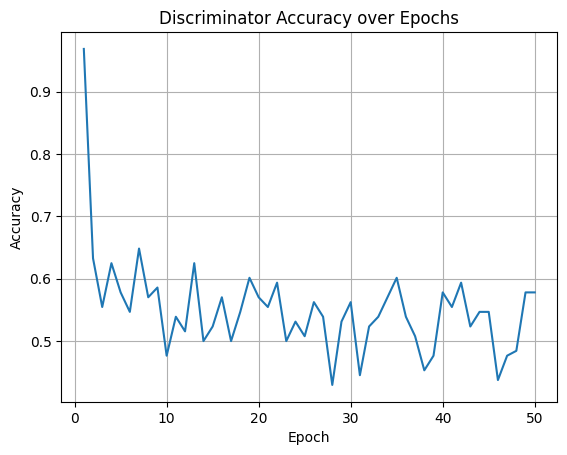

In [368]:
plt.plot(range(1, epochs+1), d_accuracies, label="Discriminator Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.title("Discriminator Accuracy over Epochs")
plt.grid(True)
plt.show()


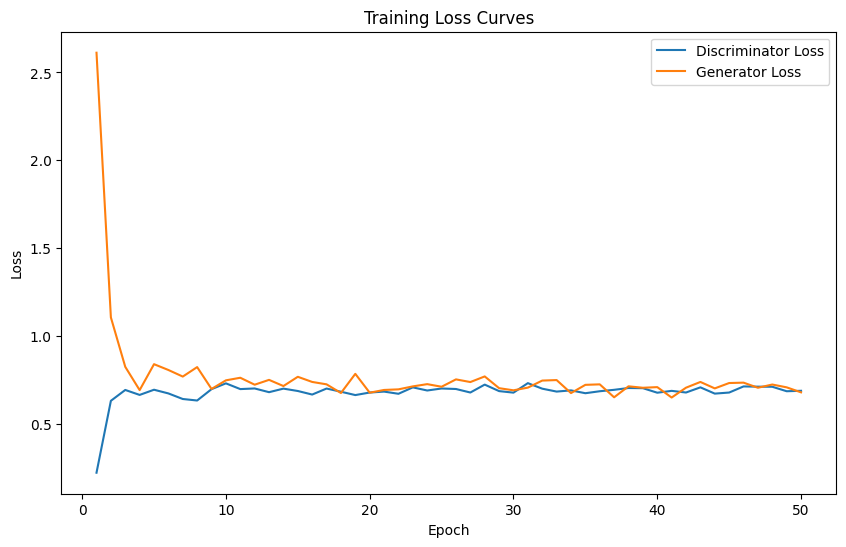

In [363]:

# Plot losses
plt.figure(figsize=(10,6))
plt.plot(range(1, epochs+1), d_losses, label='Discriminator Loss')
plt.plot(range(1, epochs+1), g_losses, label='Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Curves')
plt.legend()
plt.show()



Preview from best weights:


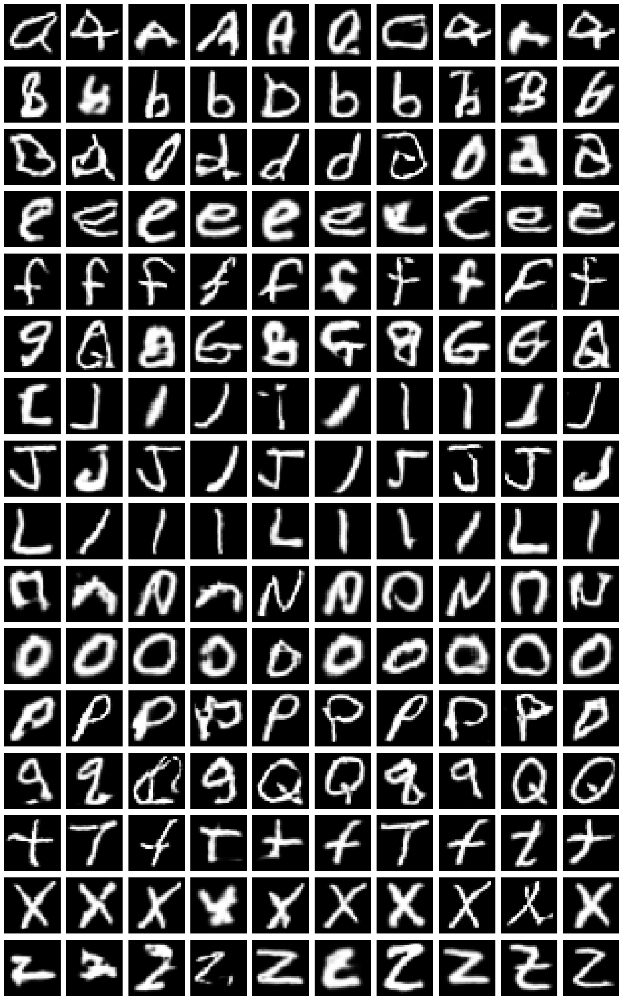

In [364]:

# Preview from best weights
print("Preview from best weights:")
generator.load_weights("best_generator.h5")
generate_and_show_images(generator)


Word 'DEEP LEANING' from best weights:


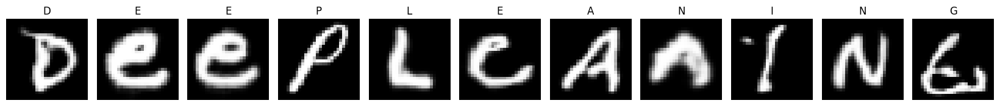

In [365]:

print("Word 'DEEP LEANING' from best weights:")
generate_word(generator, "DEEP LEANING")



Preview from final weights:


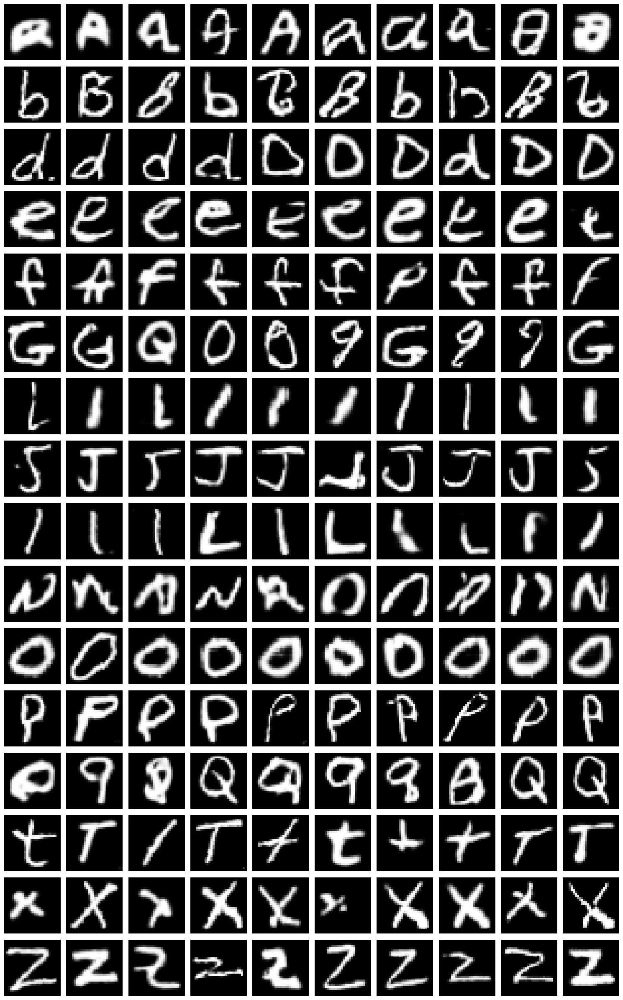

In [366]:
# Preview from final weights
print("Preview from final weights:")
generator.load_weights("final_generator.h5")
generate_and_show_images(generator)


Word 'DEEP LEANING' from final weights:


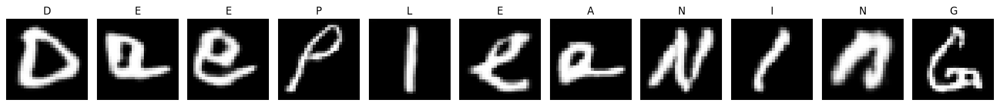

In [367]:

print("Word 'DEEP LEANING' from final weights:")
generate_word(generator, "DEEP LEANING")


<a id="imp1"></a>
# Model Improvement 1


### Improved Convolutional Conditional GAN (cDCGAN) Architecture

To further enhance generation quality and class conditioning, we implemented an improved version of the Convolutional Conditional GAN (cDCGAN). This architecture builds upon our previous model by increasing its depth and expressiveness through an additional convolutional block in the discriminator and refined architectural choices.

---

#### Generator: `improv_build_cdcgan_generator()`

- **Inputs:**
  - Noise vector (`latent_dim = 150`)
  - Class label (`0–15`)

- **Label Conditioning:**
  - The label is embedded and multiplied with the noise vector to fuse class information into the latent space.

- **Architecture:**
  - Dense projection to `7×7×256`, followed by `BatchNormalization` and `LeakyReLU`
  - Two upsampling blocks using `Conv2DTranspose` to scale up to `14×14` and `28×28`
  - Final convolutional layer with `tanh` activation to produce a grayscale image in the range [-1, 1]

---

#### Discriminator: `improv_build_cdcgan_discriminator()`

- **Inputs:**
  - Image of shape `(28, 28, 1)`
  - Class label (`0–15`)

- **Label Conditioning:**
  - The label is embedded, reshaped to match the image shape, and concatenated along the channel axis, resulting in a two-channel input `(28, 28, 2)`

- **Architecture:**
  - **Conv Block 1:** 64 filters, stride 2, LeakyReLU, Dropout  
  - **Conv Block 2:** 128 filters, stride 2, BatchNormalization, LeakyReLU, Dropout  
  - **Conv Block 3 (New):** 256 filters, stride 1, BatchNormalization, LeakyReLU, Dropout  
  - Flatten and Dense layer with `sigmoid` activation for binary classification (real or fake)

---

This improved cDCGAN model enhances the discriminator’s capacity to differentiate real from fake images, especially across 16 class conditions. It also improves the generator’s ability to upscale noise into clearer, class-consistent 28×28 grayscale images. The overall design is better suited for structured image datasets like EMNIST.


- Same base idea: noise × label embedding → Dense → reshape
- Clearer structure with consistent use of BatchNorm and LeakyReLU
- Uses smaller kernel_size=3 in the final Conv2D for finer details

In [272]:
def improv_build_cdcgan_generator():
    noise = tf.keras.Input(shape=(latent_dim,))
    label = tf.keras.Input(shape=(1,), dtype='int32')

    # Embed and combine label with noise
    label_embedding = tf.keras.layers.Embedding(num_classes, latent_dim)(label)
    label_embedding = tf.keras.layers.Flatten()(label_embedding)
    combined = tf.keras.layers.Multiply()([noise, label_embedding])

    # Project and reshape
    x = tf.keras.layers.Dense(7 * 7 * 256, use_bias=False)(combined)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Reshape((7, 7, 256))(x)

    # Upsample to 14x14
    x = tf.keras.layers.Conv2DTranspose(128, 4, strides=2, padding='same', use_bias=False)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)

    # Upsample to 28x28
    x = tf.keras.layers.Conv2DTranspose(64, 4, strides=2, padding='same', use_bias=False)(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)

    # Output layer
    output_img = tf.keras.layers.Conv2D(1, kernel_size=3, padding='same', activation='tanh')(x)

    return tf.keras.Model([noise, label], output_img)



def improv_build_cdcgan_discriminator():
    img = tf.keras.Input(shape=image_shape)
    label = tf.keras.Input(shape=(1,), dtype='int32')

    # Embed and reshape label
    label_embedding = tf.keras.layers.Embedding(num_classes, np.prod(image_shape))(label)
    label_embedding = tf.keras.layers.Flatten()(label_embedding)
    label_embedding = tf.keras.layers.Reshape(image_shape)(label_embedding)

    # Concatenate image and label
    combined = tf.keras.layers.Concatenate(axis=-1)([img, label_embedding])  # (28, 28, 2)

    # Conv block 1
    x = tf.keras.layers.Conv2D(64, 4, strides=2, padding='same')(combined)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    # Conv block 2
    x = tf.keras.layers.Conv2D(128, 4, strides=2, padding='same')(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    # Conv block 3 — NEW
    x = tf.keras.layers.Conv2D(256, 3, strides=1, padding='same')(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    # Final classification
    x = tf.keras.layers.Flatten()(x)
    output = tf.keras.layers.Dense(1, activation='sigmoid')(x)

    return tf.keras.Model([img, label], output)


In [273]:

generator = improv_build_cdcgan_generator()
discriminator = improv_build_cdcgan_discriminator()
bce = tf.keras.losses.BinaryCrossentropy()
g_opt = tf.keras.optimizers.Adam(0.0002, 0.5)
d_opt = tf.keras.optimizers.Adam(0.0002, 0.5)

generator.summary()
discriminator.summary()


Model: "model_39"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_82 (InputLayer)          [(None, 1)]          0           []                               
                                                                                                  
 embedding_40 (Embedding)       (None, 1, 150)       2400        ['input_82[0][0]']               
                                                                                                  
 input_81 (InputLayer)          [(None, 150)]        0           []                               
                                                                                                  
 flatten_60 (Flatten)           (None, 150)          0           ['embedding_40[0][0]']           
                                                                                           

Epoch 1 | D Loss: 0.4179 | G Loss: 0.6146 | D Acc: 0.8047
Best generator saved at epoch 1
Epoch 2 | D Loss: 0.6964 | G Loss: 1.0801 | D Acc: 0.5859
Epoch 3 | D Loss: 0.6885 | G Loss: 1.0946 | D Acc: 0.5938
Epoch 4 | D Loss: 0.5233 | G Loss: 1.0784 | D Acc: 0.7656
Epoch 5 | D Loss: 0.6399 | G Loss: 0.8711 | D Acc: 0.6172
Epoch 6 | D Loss: 0.7460 | G Loss: 0.6814 | D Acc: 0.5234
Epoch 7 | D Loss: 0.6934 | G Loss: 0.9152 | D Acc: 0.5625
Epoch 8 | D Loss: 0.6648 | G Loss: 1.0810 | D Acc: 0.6406
Epoch 9 | D Loss: 0.7113 | G Loss: 0.8796 | D Acc: 0.5781
Epoch 10 | D Loss: 0.7220 | G Loss: 1.0891 | D Acc: 0.5625
Preview images at epoch 10:


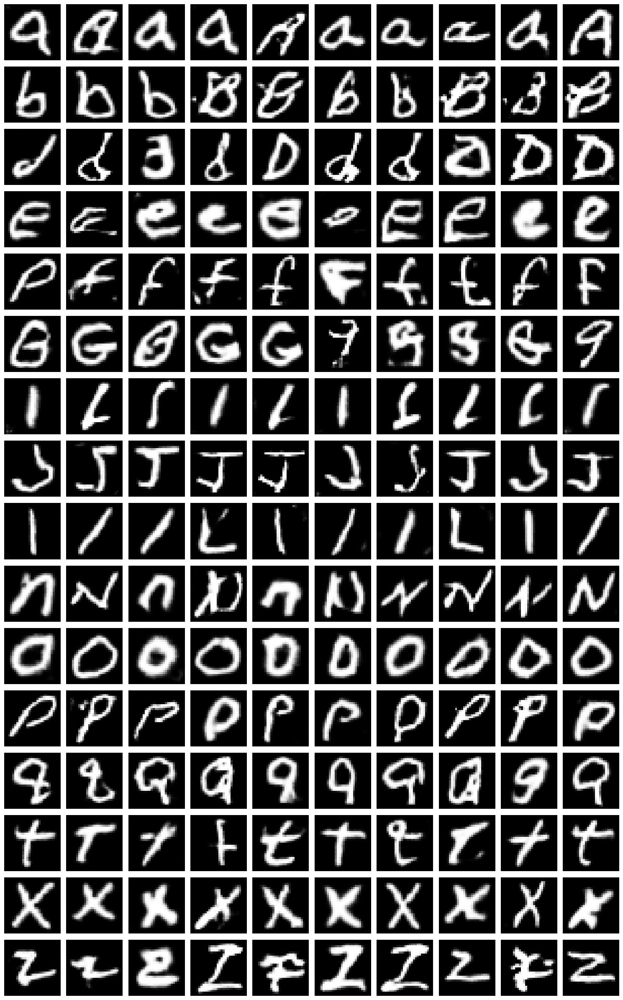

Epoch 11 | D Loss: 0.6124 | G Loss: 0.7448 | D Acc: 0.6719
Epoch 12 | D Loss: 0.7338 | G Loss: 0.7723 | D Acc: 0.4844
Epoch 13 | D Loss: 0.7015 | G Loss: 0.6405 | D Acc: 0.5391
Epoch 14 | D Loss: 0.6795 | G Loss: 0.6698 | D Acc: 0.5781
Epoch 15 | D Loss: 0.5713 | G Loss: 1.0147 | D Acc: 0.7656
Epoch 16 | D Loss: 0.6884 | G Loss: 0.8177 | D Acc: 0.5625
Epoch 17 | D Loss: 0.6704 | G Loss: 0.7276 | D Acc: 0.5703
Epoch 18 | D Loss: 0.6493 | G Loss: 0.8420 | D Acc: 0.6641
Epoch 19 | D Loss: 0.6255 | G Loss: 0.9102 | D Acc: 0.6797
Epoch 20 | D Loss: 0.6315 | G Loss: 0.7735 | D Acc: 0.6875
Preview images at epoch 20:


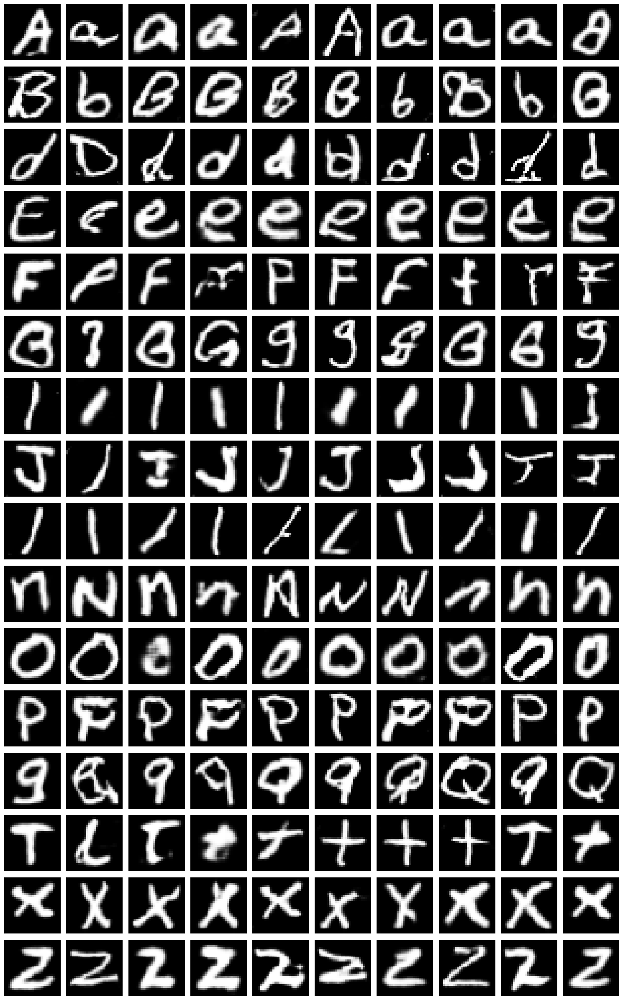

Epoch 21 | D Loss: 0.6853 | G Loss: 0.7844 | D Acc: 0.5781
Epoch 22 | D Loss: 0.7071 | G Loss: 0.6628 | D Acc: 0.5234
Epoch 23 | D Loss: 0.6909 | G Loss: 0.7645 | D Acc: 0.5625
Epoch 24 | D Loss: 0.6453 | G Loss: 0.6396 | D Acc: 0.5938
Epoch 25 | D Loss: 0.6264 | G Loss: 0.8408 | D Acc: 0.6562
Epoch 26 | D Loss: 0.6552 | G Loss: 0.9420 | D Acc: 0.5703
Epoch 27 | D Loss: 0.5933 | G Loss: 0.6502 | D Acc: 0.6719
Epoch 28 | D Loss: 0.5924 | G Loss: 0.8599 | D Acc: 0.6719
Epoch 29 | D Loss: 0.7253 | G Loss: 1.1382 | D Acc: 0.5312
Epoch 30 | D Loss: 0.5995 | G Loss: 0.7817 | D Acc: 0.6797
Preview images at epoch 30:


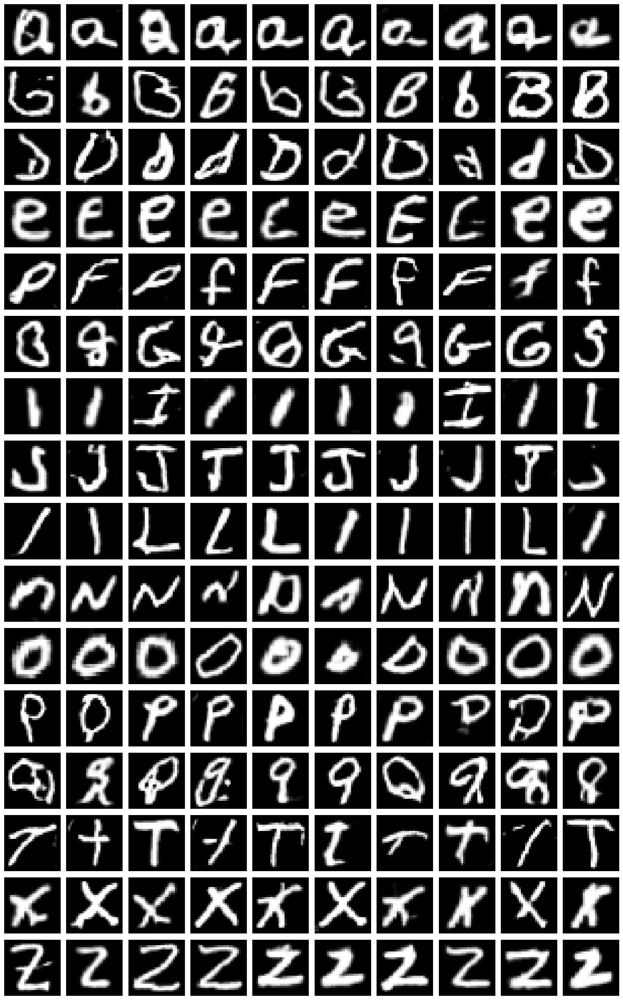

Epoch 31 | D Loss: 0.6087 | G Loss: 0.8541 | D Acc: 0.6562
Epoch 32 | D Loss: 0.6007 | G Loss: 0.6411 | D Acc: 0.6641
Epoch 33 | D Loss: 0.6740 | G Loss: 0.5728 | D Acc: 0.5781
Best generator saved at epoch 33
Epoch 34 | D Loss: 0.6773 | G Loss: 0.8357 | D Acc: 0.5938
Epoch 35 | D Loss: 0.6816 | G Loss: 1.0823 | D Acc: 0.5703
Epoch 36 | D Loss: 0.6657 | G Loss: 1.0374 | D Acc: 0.5625
Epoch 37 | D Loss: 0.5878 | G Loss: 0.8153 | D Acc: 0.7031
Epoch 38 | D Loss: 0.7392 | G Loss: 0.7093 | D Acc: 0.5391
Epoch 39 | D Loss: 0.6065 | G Loss: 0.9531 | D Acc: 0.6641
Epoch 40 | D Loss: 0.6350 | G Loss: 0.9322 | D Acc: 0.6094
Preview images at epoch 40:


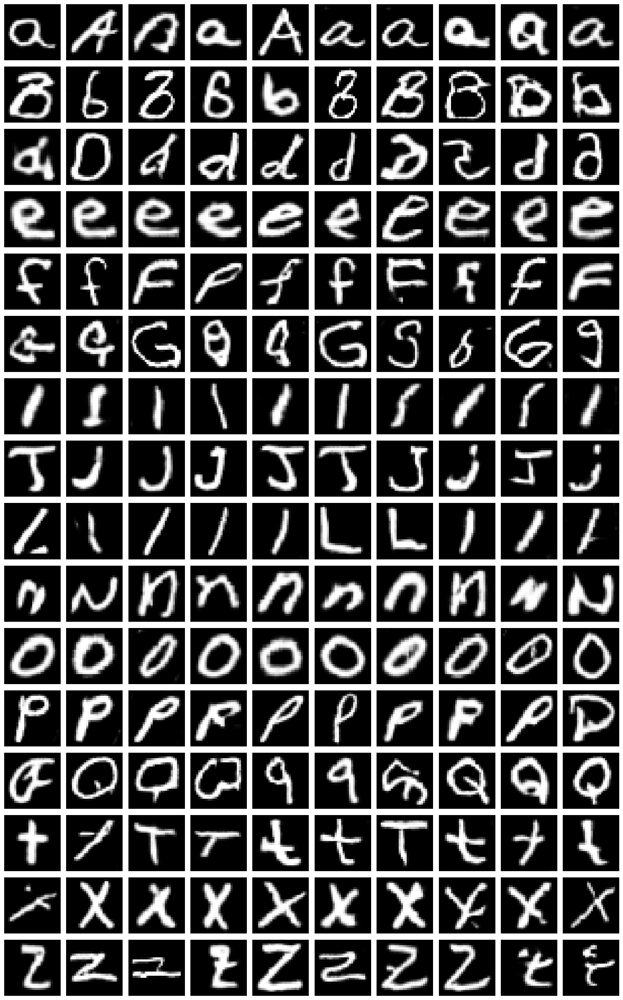

Epoch 41 | D Loss: 0.5050 | G Loss: 0.7336 | D Acc: 0.7734
Epoch 42 | D Loss: 0.5699 | G Loss: 0.7119 | D Acc: 0.7188
Epoch 43 | D Loss: 0.7117 | G Loss: 0.9198 | D Acc: 0.5156
Epoch 44 | D Loss: 0.5786 | G Loss: 1.1770 | D Acc: 0.7188
Epoch 45 | D Loss: 0.7310 | G Loss: 0.9339 | D Acc: 0.5156
Epoch 46 | D Loss: 0.6418 | G Loss: 0.9187 | D Acc: 0.6484
Epoch 47 | D Loss: 0.6519 | G Loss: 1.1472 | D Acc: 0.6094
Epoch 48 | D Loss: 0.5964 | G Loss: 0.9066 | D Acc: 0.6484
Epoch 49 | D Loss: 0.5807 | G Loss: 0.6586 | D Acc: 0.7109
Epoch 50 | D Loss: 0.5471 | G Loss: 1.5272 | D Acc: 0.7422
Preview images at epoch 50:


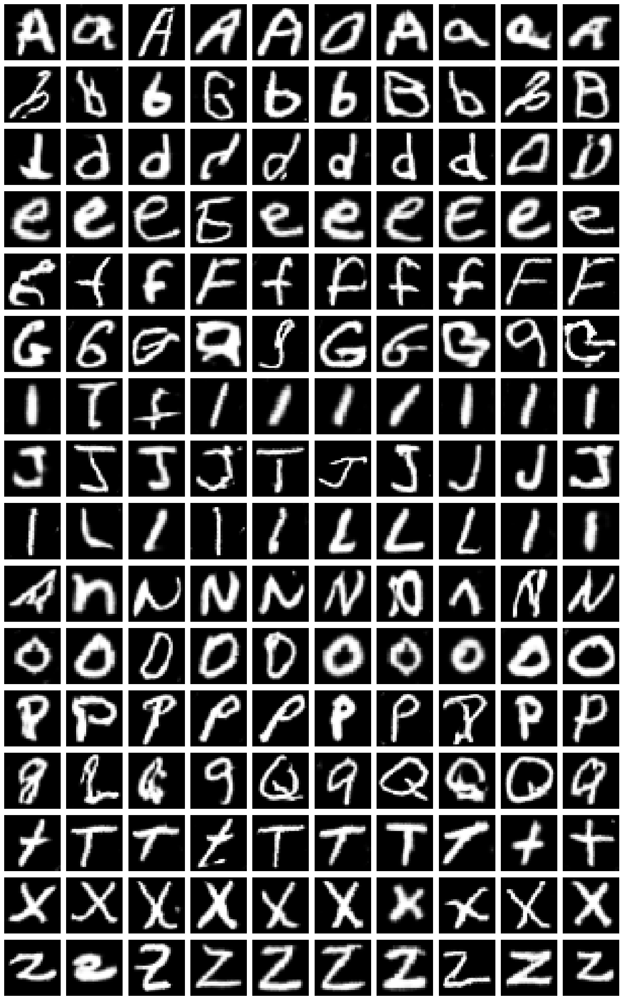

Epoch 51 | D Loss: 0.6842 | G Loss: 1.3735 | D Acc: 0.6172
Epoch 52 | D Loss: 0.5675 | G Loss: 1.3266 | D Acc: 0.6797
Epoch 53 | D Loss: 0.6572 | G Loss: 0.7265 | D Acc: 0.5781
Epoch 54 | D Loss: 0.5383 | G Loss: 0.9779 | D Acc: 0.7891
Epoch 55 | D Loss: 0.6849 | G Loss: 0.8724 | D Acc: 0.5625
Epoch 56 | D Loss: 0.7338 | G Loss: 1.0712 | D Acc: 0.5078
Epoch 57 | D Loss: 0.6150 | G Loss: 0.6894 | D Acc: 0.6641
Epoch 58 | D Loss: 0.7217 | G Loss: 0.4772 | D Acc: 0.6250
Best generator saved at epoch 58
Epoch 59 | D Loss: 0.5661 | G Loss: 0.8440 | D Acc: 0.7188
Epoch 60 | D Loss: 0.5406 | G Loss: 0.9314 | D Acc: 0.7344
Preview images at epoch 60:


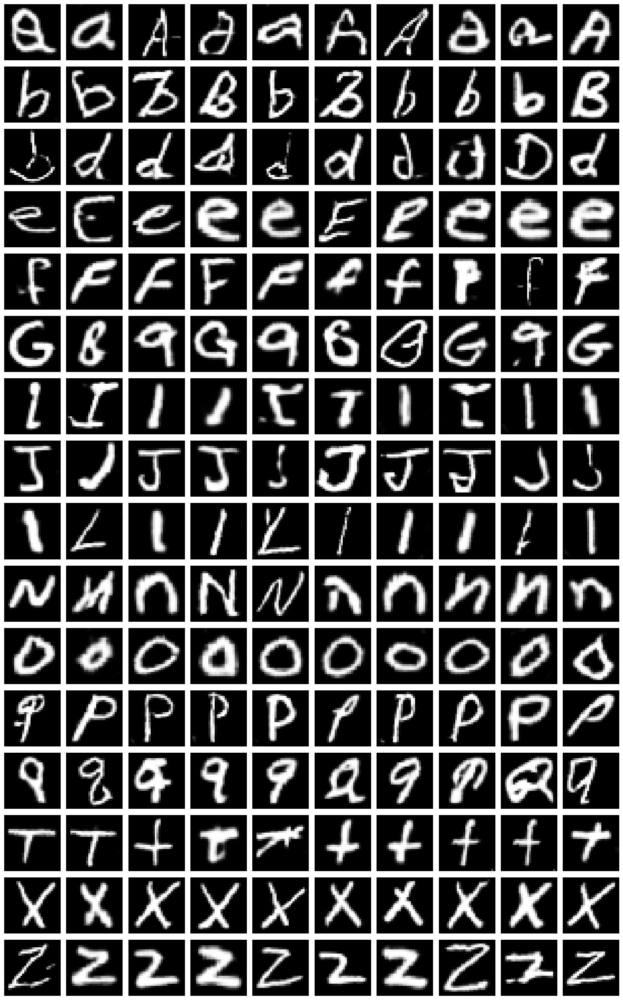

Epoch 61 | D Loss: 0.7045 | G Loss: 0.8671 | D Acc: 0.5781
Epoch 62 | D Loss: 0.7600 | G Loss: 1.0435 | D Acc: 0.5156
Epoch 63 | D Loss: 0.7153 | G Loss: 1.1712 | D Acc: 0.5625
Epoch 64 | D Loss: 0.6336 | G Loss: 0.5095 | D Acc: 0.6094
Epoch 65 | D Loss: 0.6008 | G Loss: 1.0148 | D Acc: 0.6641
Epoch 66 | D Loss: 0.7992 | G Loss: 0.9055 | D Acc: 0.4766
Epoch 67 | D Loss: 0.6483 | G Loss: 0.8112 | D Acc: 0.6250
Epoch 68 | D Loss: 0.4294 | G Loss: 1.1803 | D Acc: 0.8516
Epoch 69 | D Loss: 0.6867 | G Loss: 0.9342 | D Acc: 0.6406
Epoch 70 | D Loss: 0.6092 | G Loss: 0.7226 | D Acc: 0.6172
Preview images at epoch 70:


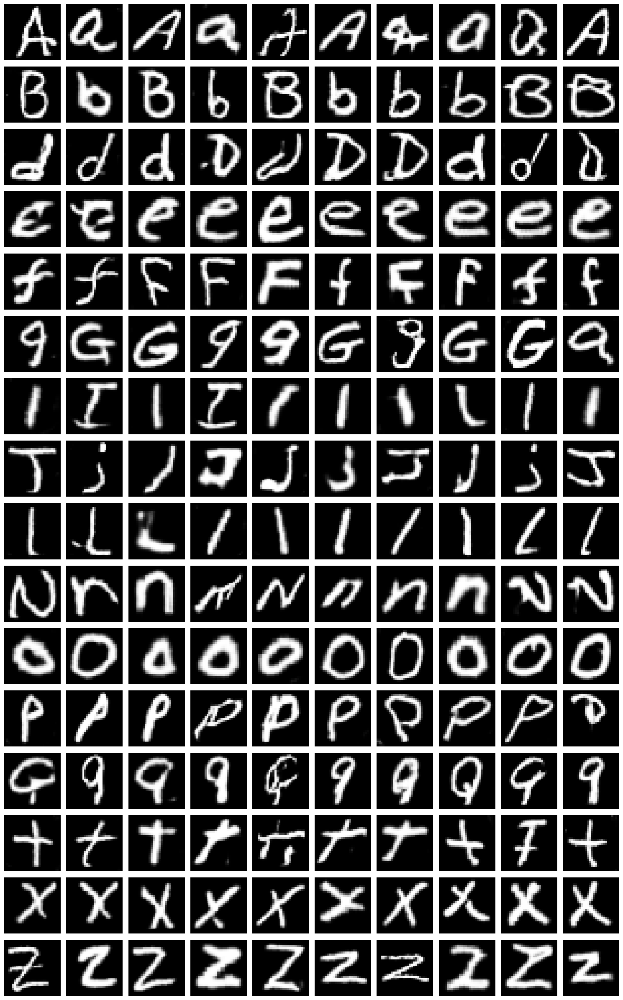

Epoch 71 | D Loss: 0.4587 | G Loss: 0.9044 | D Acc: 0.8438
Epoch 72 | D Loss: 0.6397 | G Loss: 1.1661 | D Acc: 0.6016
Epoch 73 | D Loss: 0.6155 | G Loss: 1.0210 | D Acc: 0.6719
Epoch 74 | D Loss: 0.5033 | G Loss: 1.2245 | D Acc: 0.7734
Epoch 75 | D Loss: 0.3982 | G Loss: 0.6985 | D Acc: 0.8906
Epoch 76 | D Loss: 0.7597 | G Loss: 1.3293 | D Acc: 0.5391
Epoch 77 | D Loss: 0.5223 | G Loss: 0.8051 | D Acc: 0.7344
Epoch 78 | D Loss: 0.6154 | G Loss: 0.8618 | D Acc: 0.6094
Epoch 79 | D Loss: 0.5358 | G Loss: 0.8490 | D Acc: 0.7109
Epoch 80 | D Loss: 0.5113 | G Loss: 1.0551 | D Acc: 0.7812
Preview images at epoch 80:


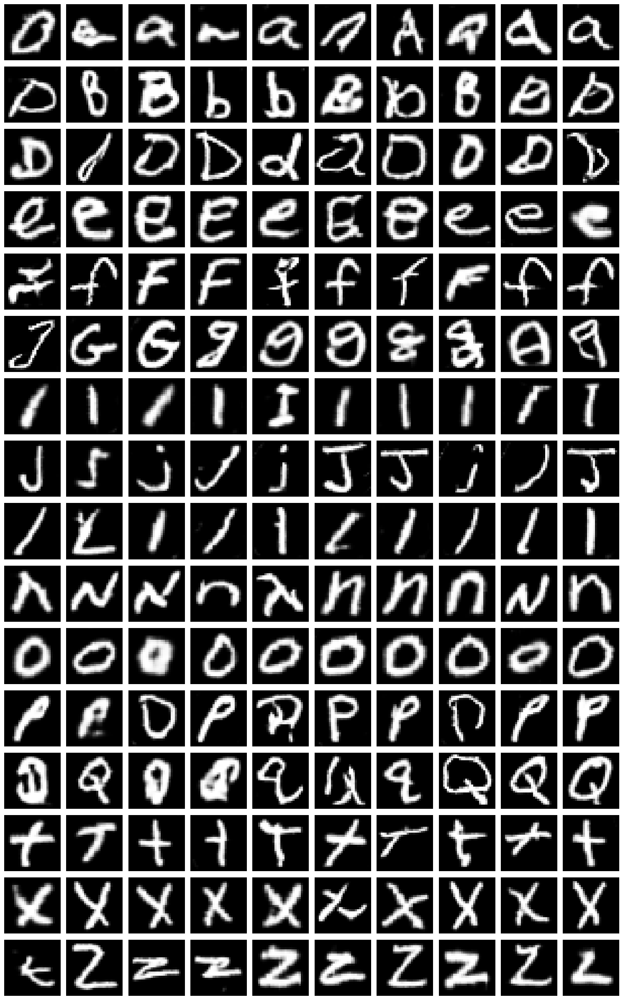

Epoch 81 | D Loss: 0.7406 | G Loss: 1.2520 | D Acc: 0.5312
Epoch 82 | D Loss: 0.6071 | G Loss: 0.6829 | D Acc: 0.6484
Epoch 83 | D Loss: 0.6016 | G Loss: 1.2538 | D Acc: 0.6719
Epoch 84 | D Loss: 0.5382 | G Loss: 1.0171 | D Acc: 0.7344
Epoch 85 | D Loss: 0.7167 | G Loss: 1.0499 | D Acc: 0.6016
Epoch 86 | D Loss: 0.5454 | G Loss: 0.8568 | D Acc: 0.7266
Epoch 87 | D Loss: 0.7793 | G Loss: 0.6846 | D Acc: 0.5625
Epoch 88 | D Loss: 0.5164 | G Loss: 0.8050 | D Acc: 0.7656
Epoch 89 | D Loss: 0.6575 | G Loss: 1.3665 | D Acc: 0.6641
Epoch 90 | D Loss: 0.6665 | G Loss: 0.8857 | D Acc: 0.6250
Preview images at epoch 90:


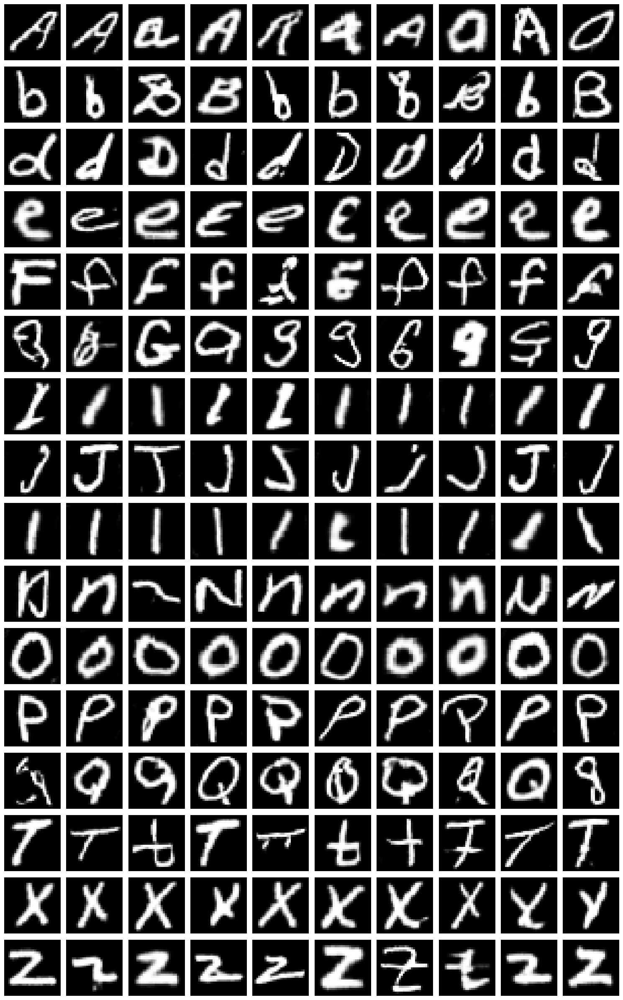

Epoch 91 | D Loss: 0.6352 | G Loss: 1.2580 | D Acc: 0.6406
Epoch 92 | D Loss: 0.8844 | G Loss: 1.0042 | D Acc: 0.5156
Epoch 93 | D Loss: 0.5917 | G Loss: 0.8193 | D Acc: 0.6719
Epoch 94 | D Loss: 0.5388 | G Loss: 0.9717 | D Acc: 0.7266
Epoch 95 | D Loss: 0.5556 | G Loss: 1.2296 | D Acc: 0.7422
Epoch 96 | D Loss: 0.7400 | G Loss: 1.5988 | D Acc: 0.5391
Epoch 97 | D Loss: 0.7172 | G Loss: 1.8252 | D Acc: 0.5312
Epoch 98 | D Loss: 0.4289 | G Loss: 1.4849 | D Acc: 0.8672
Epoch 99 | D Loss: 0.6576 | G Loss: 0.6964 | D Acc: 0.5859
Epoch 100 | D Loss: 0.5513 | G Loss: 1.0924 | D Acc: 0.7266
Preview images at epoch 100:


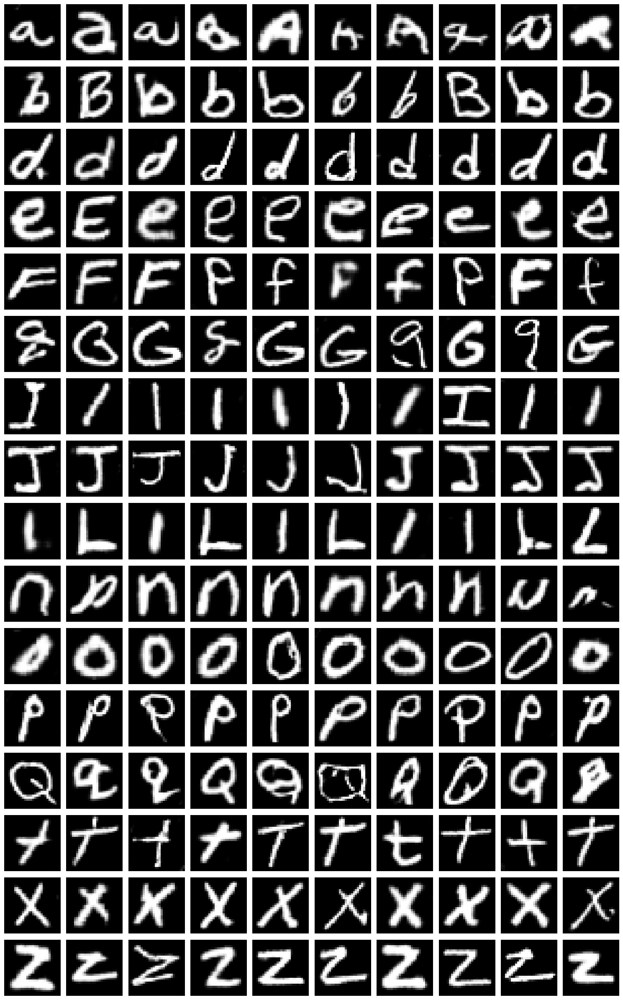

Epoch 101 | D Loss: 0.8443 | G Loss: 1.3647 | D Acc: 0.4688
Epoch 102 | D Loss: 0.6080 | G Loss: 1.3536 | D Acc: 0.6250
Epoch 103 | D Loss: 0.5942 | G Loss: 1.6973 | D Acc: 0.6719
Epoch 104 | D Loss: 0.5450 | G Loss: 0.9193 | D Acc: 0.7188
Epoch 105 | D Loss: 0.5487 | G Loss: 0.9551 | D Acc: 0.7188
Epoch 106 | D Loss: 0.6743 | G Loss: 1.2860 | D Acc: 0.5938
Epoch 107 | D Loss: 0.6219 | G Loss: 0.7751 | D Acc: 0.6016
Epoch 108 | D Loss: 0.5532 | G Loss: 0.8666 | D Acc: 0.7344
Epoch 109 | D Loss: 0.5452 | G Loss: 1.3508 | D Acc: 0.7188
Epoch 110 | D Loss: 0.6008 | G Loss: 0.9425 | D Acc: 0.6641
Preview images at epoch 110:


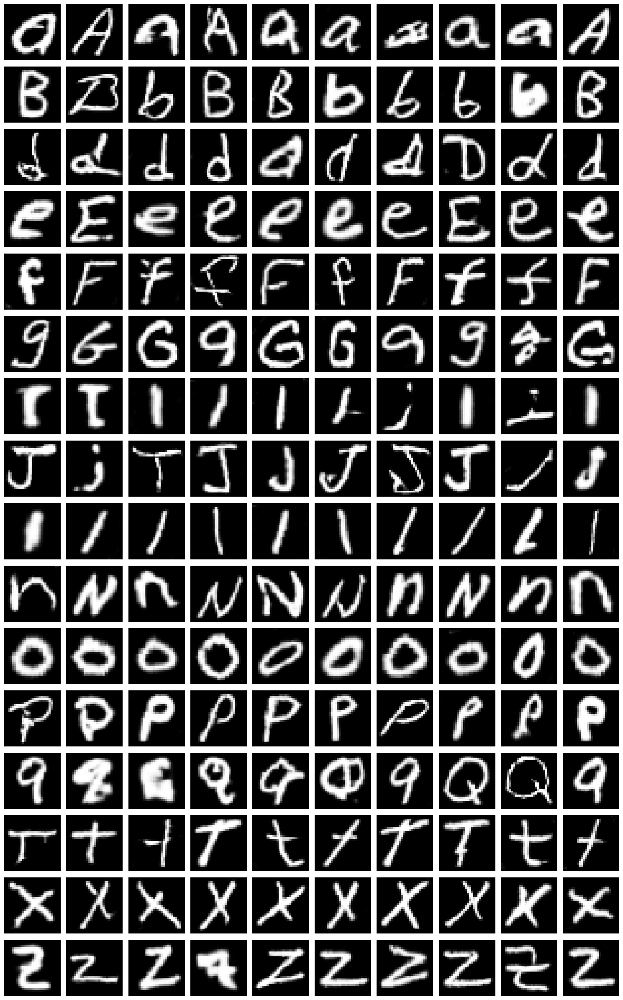

Epoch 111 | D Loss: 0.6574 | G Loss: 1.3839 | D Acc: 0.5938
Epoch 112 | D Loss: 0.4854 | G Loss: 0.6049 | D Acc: 0.7812
Epoch 113 | D Loss: 0.6533 | G Loss: 1.4141 | D Acc: 0.7031
Epoch 114 | D Loss: 0.7785 | G Loss: 0.6204 | D Acc: 0.4922
Epoch 115 | D Loss: 0.6789 | G Loss: 0.9065 | D Acc: 0.6094
Epoch 116 | D Loss: 0.5854 | G Loss: 1.1647 | D Acc: 0.6562
Epoch 117 | D Loss: 0.6666 | G Loss: 0.6493 | D Acc: 0.6172
Epoch 118 | D Loss: 0.7548 | G Loss: 0.7662 | D Acc: 0.5156
Epoch 119 | D Loss: 0.5327 | G Loss: 1.6134 | D Acc: 0.6797
Epoch 120 | D Loss: 0.6985 | G Loss: 0.6110 | D Acc: 0.5781
Preview images at epoch 120:


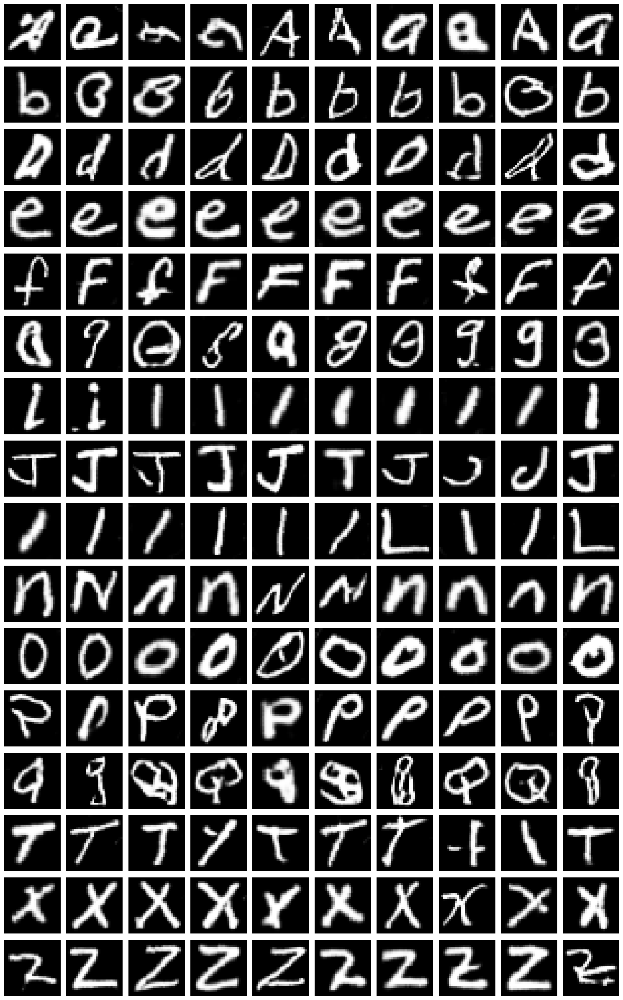

Epoch 121 | D Loss: 0.6855 | G Loss: 0.6856 | D Acc: 0.6016
Epoch 122 | D Loss: 0.4255 | G Loss: 1.5102 | D Acc: 0.8203
Epoch 123 | D Loss: 0.5438 | G Loss: 0.9655 | D Acc: 0.7188
Epoch 124 | D Loss: 0.7371 | G Loss: 1.2247 | D Acc: 0.5547
Epoch 125 | D Loss: 0.6124 | G Loss: 1.6152 | D Acc: 0.6328
Epoch 126 | D Loss: 0.7127 | G Loss: 0.8336 | D Acc: 0.5312
Epoch 127 | D Loss: 0.5167 | G Loss: 1.0023 | D Acc: 0.7500
Epoch 128 | D Loss: 0.5612 | G Loss: 1.2074 | D Acc: 0.7188
Epoch 129 | D Loss: 0.4582 | G Loss: 1.0378 | D Acc: 0.7734
Epoch 130 | D Loss: 0.6219 | G Loss: 0.9568 | D Acc: 0.6641
Preview images at epoch 130:


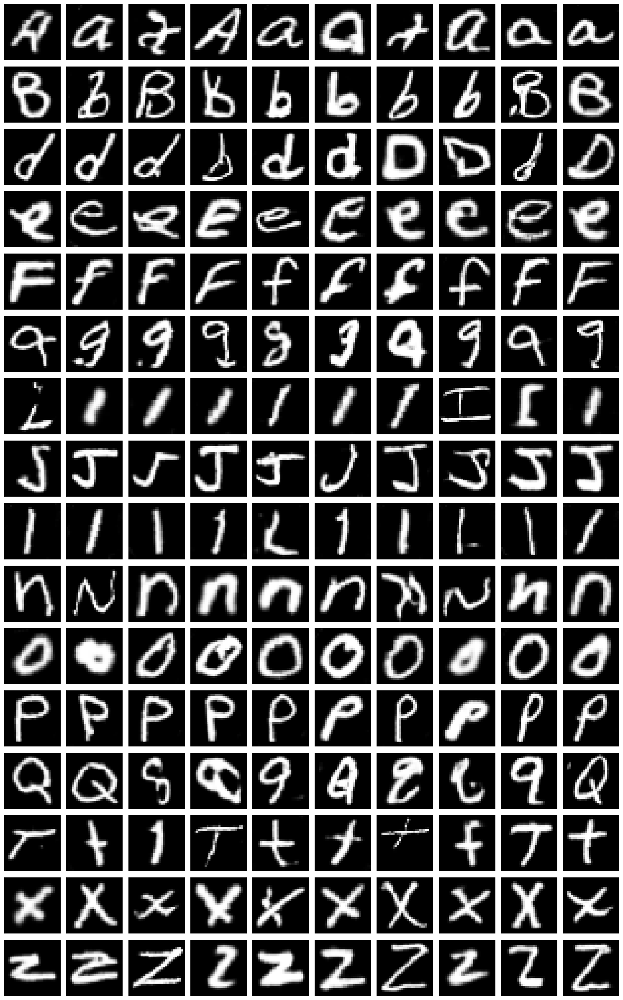

Epoch 131 | D Loss: 0.6243 | G Loss: 1.9342 | D Acc: 0.6484
Epoch 132 | D Loss: 0.5250 | G Loss: 1.2972 | D Acc: 0.7500
Epoch 133 | D Loss: 0.3991 | G Loss: 1.6852 | D Acc: 0.8516
Epoch 134 | D Loss: 0.5011 | G Loss: 1.4967 | D Acc: 0.7656
Epoch 135 | D Loss: 0.5487 | G Loss: 0.9941 | D Acc: 0.7109
Epoch 136 | D Loss: 0.5838 | G Loss: 0.6349 | D Acc: 0.6641
Epoch 137 | D Loss: 0.5656 | G Loss: 0.9781 | D Acc: 0.6797
Epoch 138 | D Loss: 0.7339 | G Loss: 0.9100 | D Acc: 0.6016
Epoch 139 | D Loss: 0.6259 | G Loss: 1.0981 | D Acc: 0.6562
Epoch 140 | D Loss: 0.3624 | G Loss: 1.2318 | D Acc: 0.9141
Preview images at epoch 140:


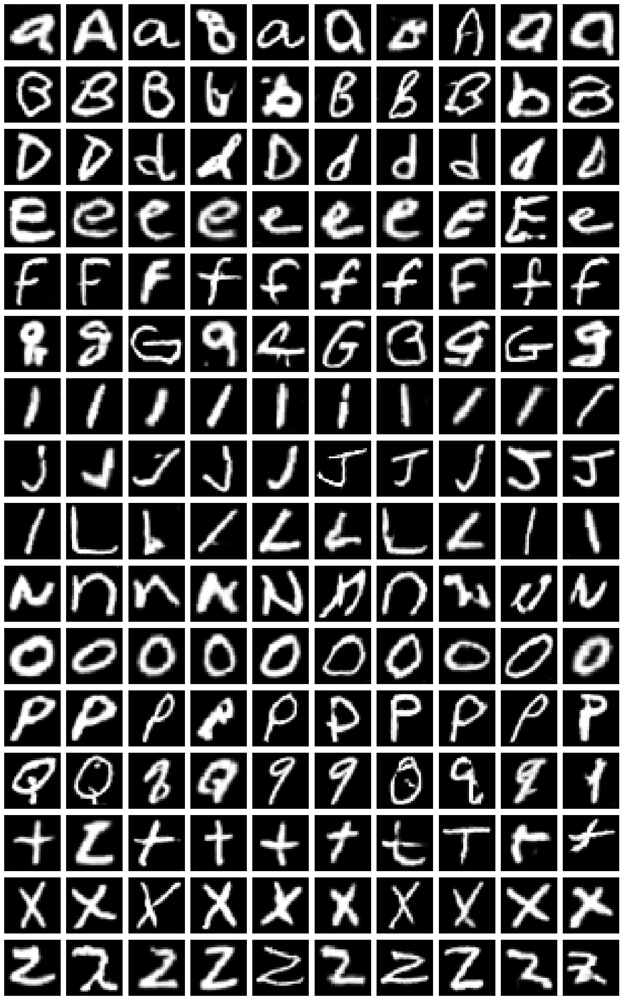

Epoch 141 | D Loss: 0.8362 | G Loss: 1.0593 | D Acc: 0.4062
Epoch 142 | D Loss: 0.6950 | G Loss: 1.3053 | D Acc: 0.6250
Epoch 143 | D Loss: 0.5337 | G Loss: 1.1716 | D Acc: 0.7109
Epoch 144 | D Loss: 0.8145 | G Loss: 1.0494 | D Acc: 0.4531
Epoch 145 | D Loss: 0.4174 | G Loss: 0.8228 | D Acc: 0.8359
Epoch 146 | D Loss: 0.7057 | G Loss: 0.7098 | D Acc: 0.5859
Epoch 147 | D Loss: 0.5209 | G Loss: 0.9003 | D Acc: 0.8047
Epoch 148 | D Loss: 0.7115 | G Loss: 0.9890 | D Acc: 0.5547
Epoch 149 | D Loss: 0.5608 | G Loss: 1.4225 | D Acc: 0.6641
Epoch 150 | D Loss: 0.4175 | G Loss: 1.3399 | D Acc: 0.8047
Preview images at epoch 150:


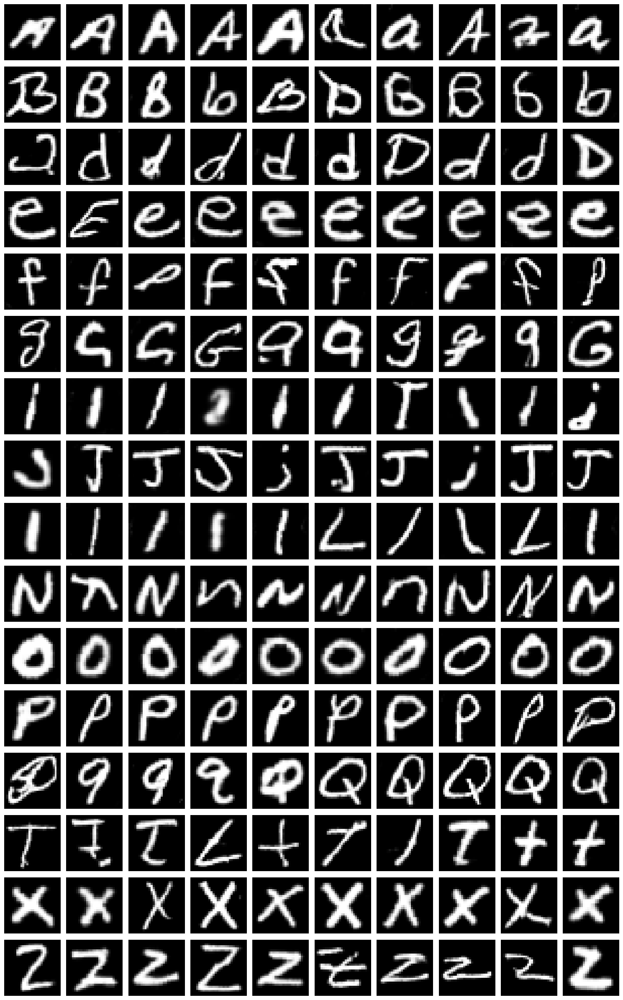

Epoch 151 | D Loss: 0.4789 | G Loss: 1.2087 | D Acc: 0.8047
Epoch 152 | D Loss: 0.6317 | G Loss: 0.6222 | D Acc: 0.6562
Epoch 153 | D Loss: 0.9257 | G Loss: 0.4856 | D Acc: 0.4609
Epoch 154 | D Loss: 0.3616 | G Loss: 1.5188 | D Acc: 0.9062
Epoch 155 | D Loss: 0.5108 | G Loss: 1.6671 | D Acc: 0.7891
Epoch 156 | D Loss: 0.6354 | G Loss: 1.5133 | D Acc: 0.6562
Epoch 157 | D Loss: 0.6460 | G Loss: 2.5885 | D Acc: 0.6250
Epoch 158 | D Loss: 0.5949 | G Loss: 0.8168 | D Acc: 0.6875
Epoch 159 | D Loss: 0.5361 | G Loss: 1.2501 | D Acc: 0.7188
Epoch 160 | D Loss: 0.4839 | G Loss: 0.9351 | D Acc: 0.7578
Preview images at epoch 160:


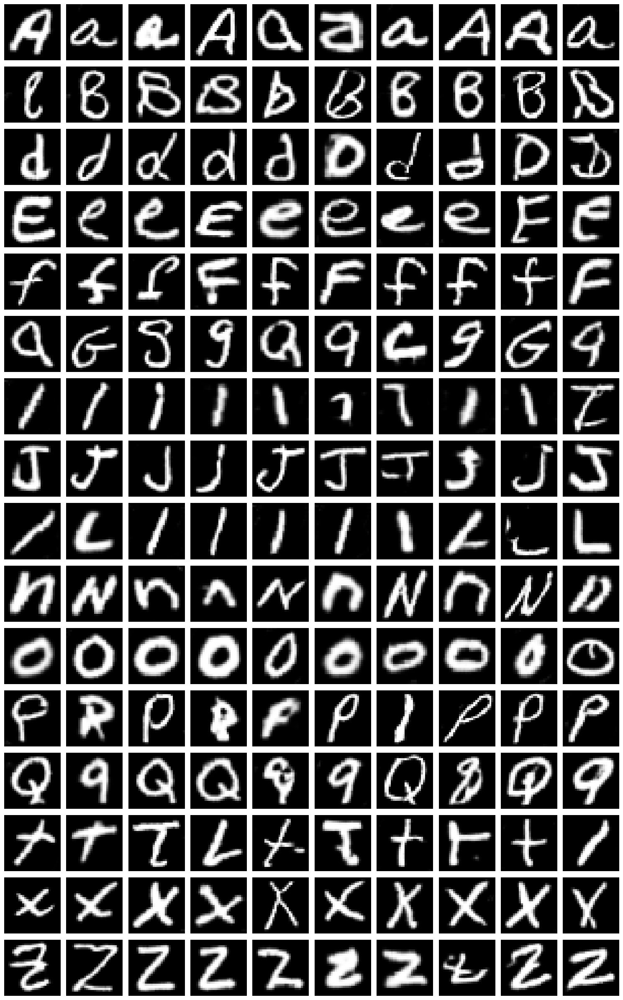

Epoch 161 | D Loss: 0.4844 | G Loss: 1.1808 | D Acc: 0.7734
Epoch 162 | D Loss: 0.5032 | G Loss: 1.0389 | D Acc: 0.7734
Epoch 163 | D Loss: 0.3460 | G Loss: 0.7588 | D Acc: 0.8828
Epoch 164 | D Loss: 0.5346 | G Loss: 1.8160 | D Acc: 0.6719
Epoch 165 | D Loss: 0.8749 | G Loss: 1.0783 | D Acc: 0.4219
Epoch 166 | D Loss: 0.5783 | G Loss: 1.1624 | D Acc: 0.7109
Epoch 167 | D Loss: 0.3947 | G Loss: 3.0616 | D Acc: 0.8594
Epoch 168 | D Loss: 0.4033 | G Loss: 1.2110 | D Acc: 0.8750
Epoch 169 | D Loss: 0.4246 | G Loss: 1.2068 | D Acc: 0.8203
Epoch 170 | D Loss: 0.4984 | G Loss: 0.6812 | D Acc: 0.7812
Preview images at epoch 170:


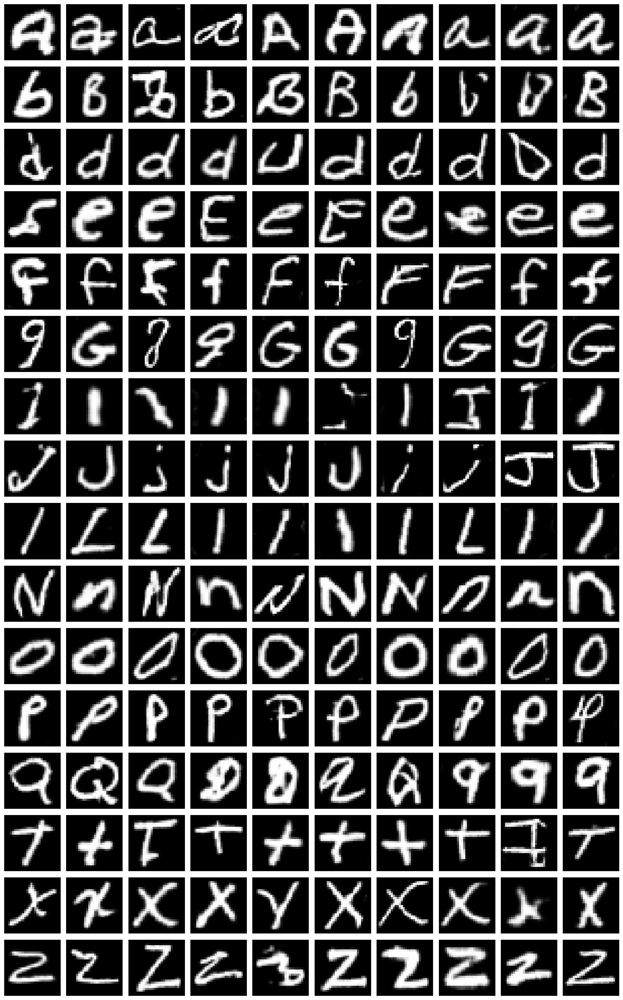

Epoch 171 | D Loss: 0.5102 | G Loss: 1.0534 | D Acc: 0.7578
Epoch 172 | D Loss: 0.6254 | G Loss: 0.4937 | D Acc: 0.6406
Epoch 173 | D Loss: 0.6552 | G Loss: 1.2801 | D Acc: 0.6094
Epoch 174 | D Loss: 0.5199 | G Loss: 1.4206 | D Acc: 0.7188
Epoch 175 | D Loss: 0.4456 | G Loss: 0.9152 | D Acc: 0.7969
Epoch 176 | D Loss: 0.5072 | G Loss: 0.1944 | D Acc: 0.7656
Best generator saved at epoch 176
Epoch 177 | D Loss: 0.5287 | G Loss: 0.5486 | D Acc: 0.7344
Epoch 178 | D Loss: 0.5109 | G Loss: 0.9500 | D Acc: 0.7734
Epoch 179 | D Loss: 0.7766 | G Loss: 0.9903 | D Acc: 0.5391
Epoch 180 | D Loss: 0.8193 | G Loss: 0.6207 | D Acc: 0.5078
Preview images at epoch 180:


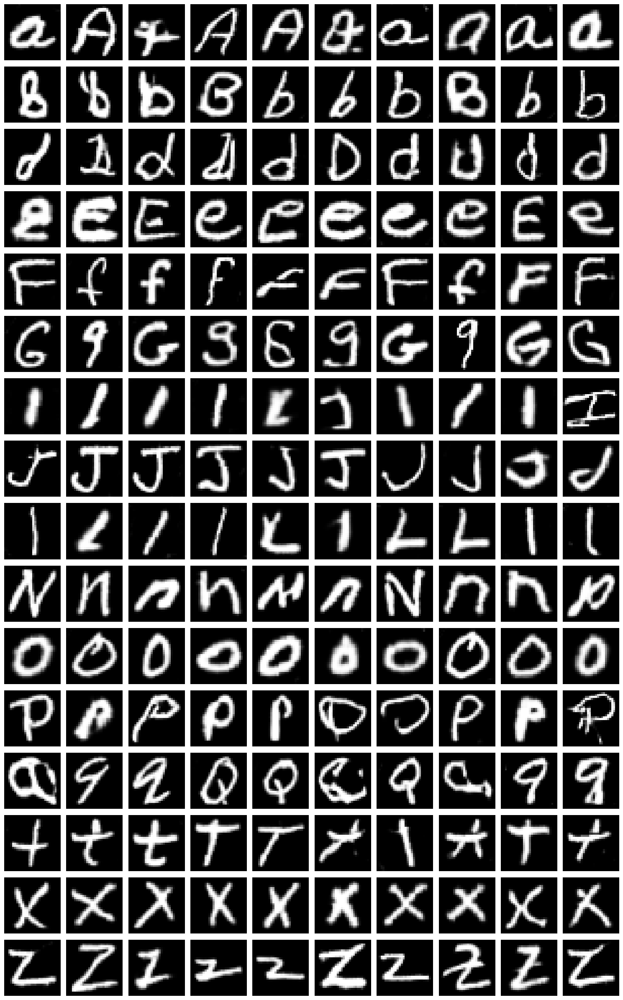

Epoch 181 | D Loss: 0.5781 | G Loss: 0.7257 | D Acc: 0.6875
Epoch 182 | D Loss: 0.4489 | G Loss: 1.2142 | D Acc: 0.8750
Epoch 183 | D Loss: 0.5147 | G Loss: 1.2555 | D Acc: 0.7578
Epoch 184 | D Loss: 0.4774 | G Loss: 1.0404 | D Acc: 0.7500
Epoch 185 | D Loss: 0.3283 | G Loss: 2.1266 | D Acc: 0.9141
Epoch 186 | D Loss: 0.6617 | G Loss: 1.3507 | D Acc: 0.6094
Epoch 187 | D Loss: 0.4904 | G Loss: 1.3077 | D Acc: 0.7031
Epoch 188 | D Loss: 0.6854 | G Loss: 1.0531 | D Acc: 0.6172
Epoch 189 | D Loss: 0.3347 | G Loss: 1.4712 | D Acc: 0.9297
Epoch 190 | D Loss: 0.5592 | G Loss: 1.1110 | D Acc: 0.6875
Preview images at epoch 190:


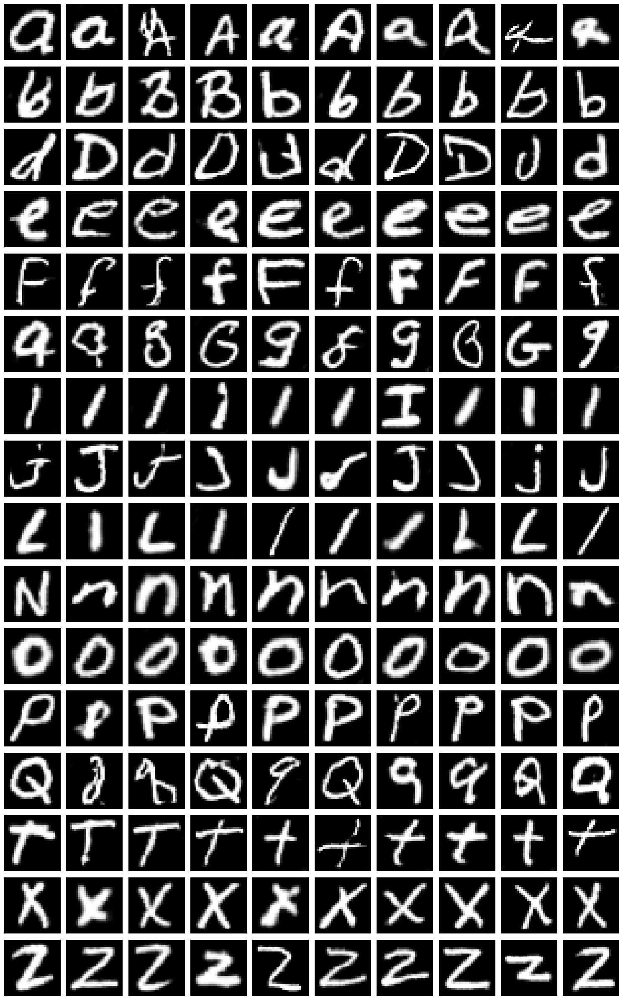

Epoch 191 | D Loss: 0.5970 | G Loss: 1.5252 | D Acc: 0.6953
Epoch 192 | D Loss: 0.6707 | G Loss: 0.8801 | D Acc: 0.6016
Epoch 193 | D Loss: 0.5725 | G Loss: 1.6484 | D Acc: 0.6953
Epoch 194 | D Loss: 0.6572 | G Loss: 1.0503 | D Acc: 0.6328
Epoch 195 | D Loss: 0.4997 | G Loss: 1.5846 | D Acc: 0.7578
Epoch 196 | D Loss: 0.8383 | G Loss: 1.0785 | D Acc: 0.4844
Epoch 197 | D Loss: 0.3506 | G Loss: 1.4136 | D Acc: 0.8516
Epoch 198 | D Loss: 0.6056 | G Loss: 0.8321 | D Acc: 0.6562
Epoch 199 | D Loss: 0.6599 | G Loss: 0.5603 | D Acc: 0.6484
Epoch 200 | D Loss: 0.5627 | G Loss: 0.8521 | D Acc: 0.6875
Preview images at epoch 200:


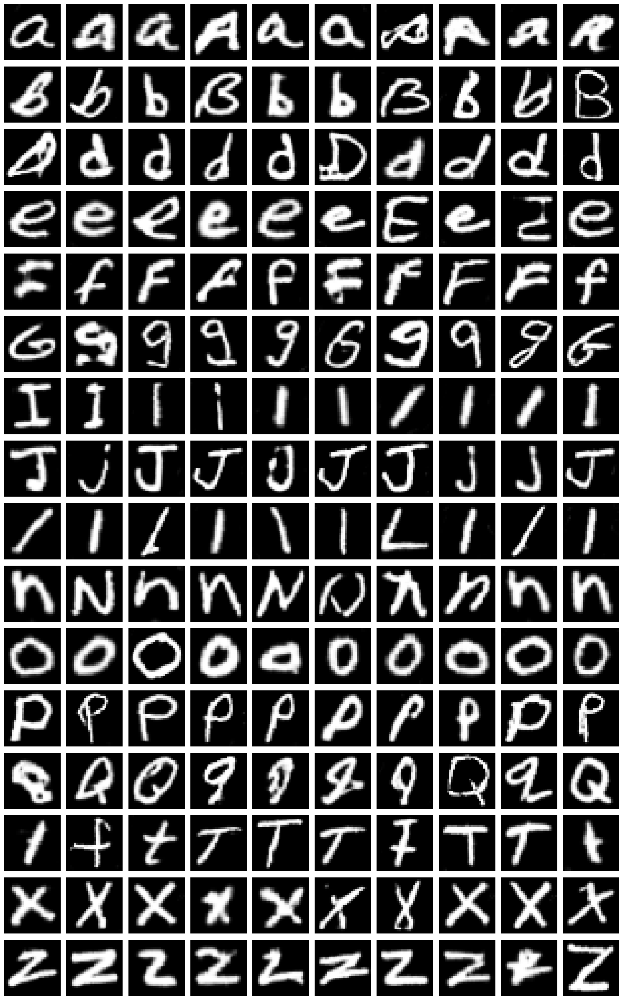

Epoch 201 | D Loss: 0.5188 | G Loss: 0.8858 | D Acc: 0.7578
Epoch 202 | D Loss: 0.4938 | G Loss: 1.1588 | D Acc: 0.7969
Epoch 203 | D Loss: 0.5578 | G Loss: 0.5283 | D Acc: 0.7109
Epoch 204 | D Loss: 0.2933 | G Loss: 0.8445 | D Acc: 0.9219
Epoch 205 | D Loss: 0.4916 | G Loss: 1.1926 | D Acc: 0.8047
Epoch 206 | D Loss: 0.3893 | G Loss: 1.9374 | D Acc: 0.8438
Epoch 207 | D Loss: 0.5857 | G Loss: 0.7523 | D Acc: 0.6719
Epoch 208 | D Loss: 0.5633 | G Loss: 1.0653 | D Acc: 0.6641
Epoch 209 | D Loss: 0.5152 | G Loss: 0.5757 | D Acc: 0.7734
Epoch 210 | D Loss: 0.7923 | G Loss: 1.3041 | D Acc: 0.5391
Preview images at epoch 210:


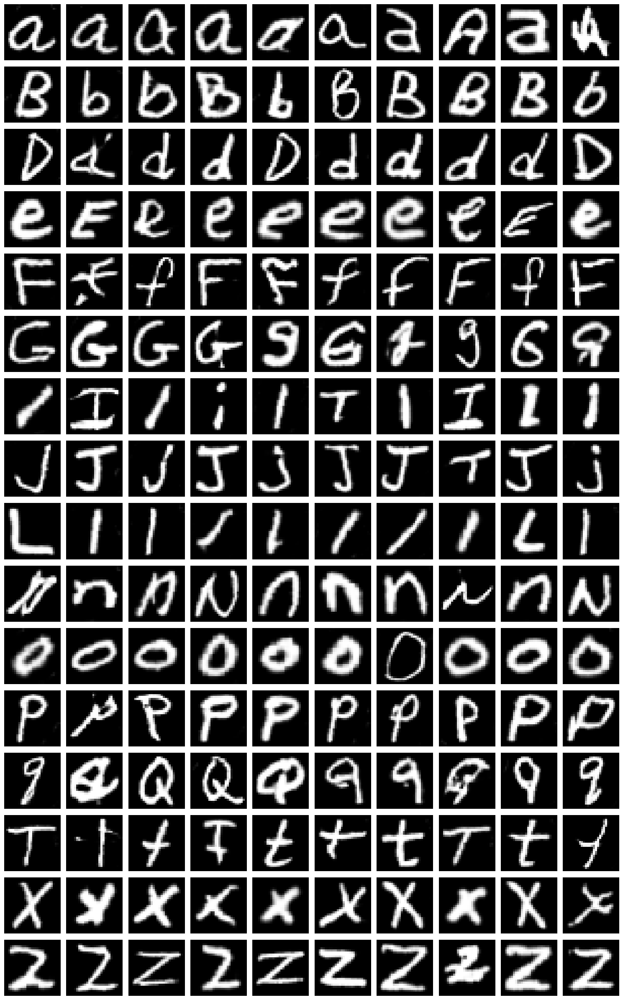

Epoch 211 | D Loss: 0.5546 | G Loss: 1.2254 | D Acc: 0.6484
Epoch 212 | D Loss: 0.7863 | G Loss: 1.7852 | D Acc: 0.5391
Epoch 213 | D Loss: 0.3977 | G Loss: 1.0759 | D Acc: 0.8203
Epoch 214 | D Loss: 0.2616 | G Loss: 0.9795 | D Acc: 0.9297
Epoch 215 | D Loss: 0.6854 | G Loss: 1.2359 | D Acc: 0.6172
Epoch 216 | D Loss: 0.8325 | G Loss: 1.2129 | D Acc: 0.4531
Epoch 217 | D Loss: 0.6117 | G Loss: 1.0321 | D Acc: 0.6719
Epoch 218 | D Loss: 0.4927 | G Loss: 1.3981 | D Acc: 0.7969
Epoch 219 | D Loss: 0.5285 | G Loss: 0.5801 | D Acc: 0.7188
Epoch 220 | D Loss: 0.6191 | G Loss: 1.3283 | D Acc: 0.6719
Preview images at epoch 220:


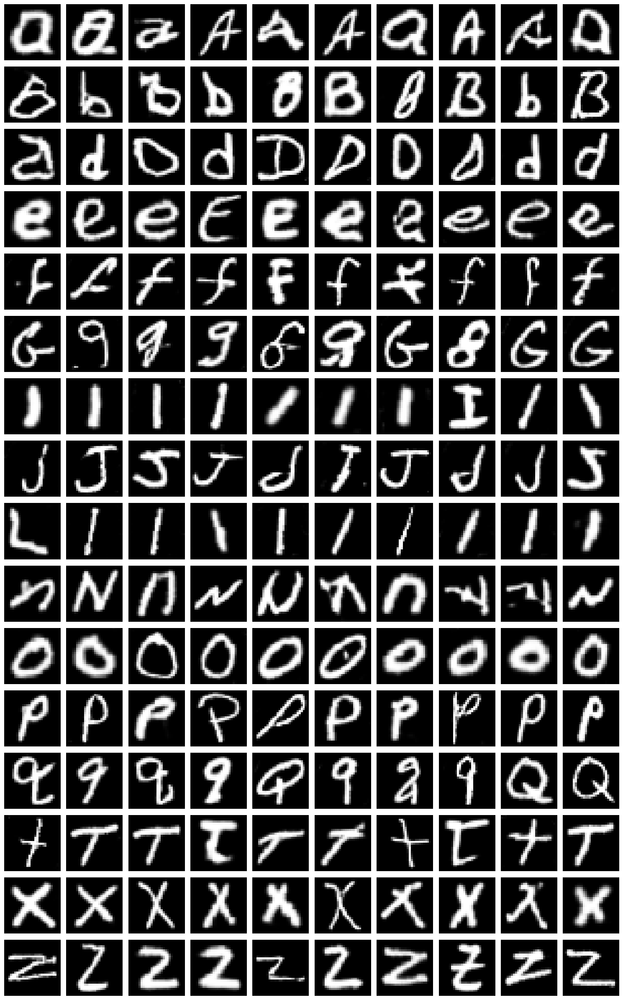

Epoch 221 | D Loss: 0.6424 | G Loss: 1.8693 | D Acc: 0.6562
Epoch 222 | D Loss: 0.4318 | G Loss: 1.6142 | D Acc: 0.8438
Epoch 223 | D Loss: 0.6452 | G Loss: 2.5719 | D Acc: 0.6328
Epoch 224 | D Loss: 0.8547 | G Loss: 1.8465 | D Acc: 0.5156
Epoch 225 | D Loss: 0.4595 | G Loss: 2.0658 | D Acc: 0.8359
Epoch 226 | D Loss: 0.9572 | G Loss: 2.4841 | D Acc: 0.3984
Epoch 227 | D Loss: 0.5601 | G Loss: 1.4750 | D Acc: 0.7031
Epoch 228 | D Loss: 0.3156 | G Loss: 1.2565 | D Acc: 0.9141
Epoch 229 | D Loss: 0.6173 | G Loss: 1.6932 | D Acc: 0.6797
Epoch 230 | D Loss: 0.2769 | G Loss: 1.4722 | D Acc: 0.9531
Preview images at epoch 230:


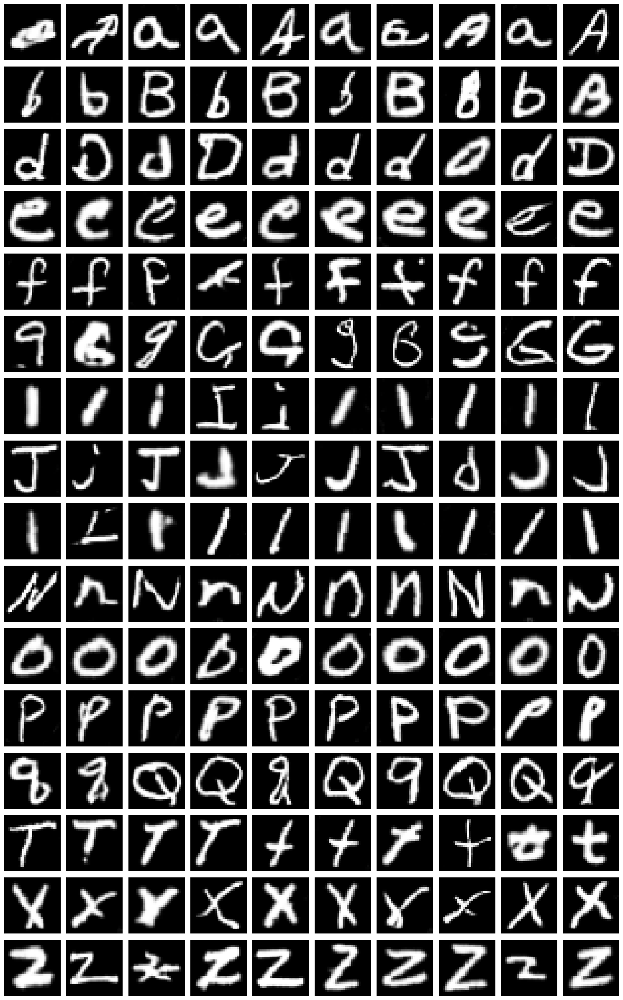

Epoch 231 | D Loss: 0.8827 | G Loss: 0.4263 | D Acc: 0.5000
Epoch 232 | D Loss: 0.4494 | G Loss: 1.6135 | D Acc: 0.8203
Epoch 233 | D Loss: 0.6559 | G Loss: 1.3512 | D Acc: 0.6328
Epoch 234 | D Loss: 0.5897 | G Loss: 1.3998 | D Acc: 0.6953
Epoch 235 | D Loss: 0.4474 | G Loss: 1.0103 | D Acc: 0.8203
Epoch 236 | D Loss: 0.5846 | G Loss: 0.8898 | D Acc: 0.6797
Epoch 237 | D Loss: 0.5255 | G Loss: 0.8874 | D Acc: 0.6953
Epoch 238 | D Loss: 0.8448 | G Loss: 0.8704 | D Acc: 0.5234
Epoch 239 | D Loss: 0.7032 | G Loss: 1.1365 | D Acc: 0.6250
Epoch 240 | D Loss: 0.3901 | G Loss: 1.2417 | D Acc: 0.8672
Preview images at epoch 240:


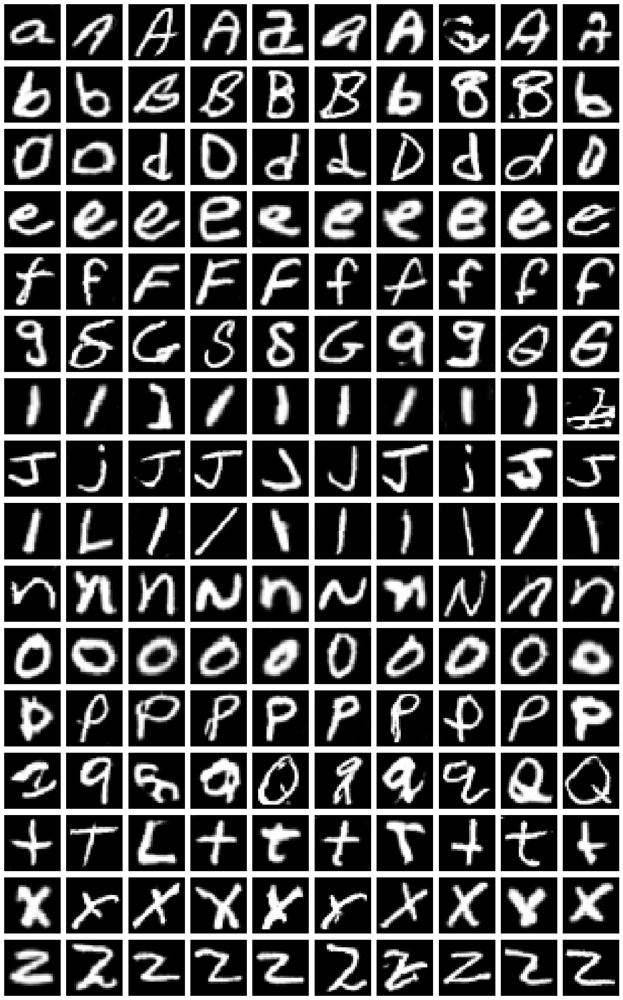

Epoch 241 | D Loss: 0.5843 | G Loss: 0.9944 | D Acc: 0.7266
Epoch 242 | D Loss: 0.6947 | G Loss: 0.7881 | D Acc: 0.5938
Epoch 243 | D Loss: 0.5649 | G Loss: 1.1688 | D Acc: 0.6797
Epoch 244 | D Loss: 0.4233 | G Loss: 0.5617 | D Acc: 0.8438
Epoch 245 | D Loss: 0.2984 | G Loss: 2.1629 | D Acc: 0.9453
Epoch 246 | D Loss: 0.4830 | G Loss: 2.0544 | D Acc: 0.6875
Epoch 247 | D Loss: 0.8538 | G Loss: 1.0492 | D Acc: 0.5234
Epoch 248 | D Loss: 0.4595 | G Loss: 0.9900 | D Acc: 0.8125
Epoch 249 | D Loss: 0.4281 | G Loss: 1.9878 | D Acc: 0.7891
Epoch 250 | D Loss: 0.3728 | G Loss: 2.7659 | D Acc: 0.8359
Preview images at epoch 250:


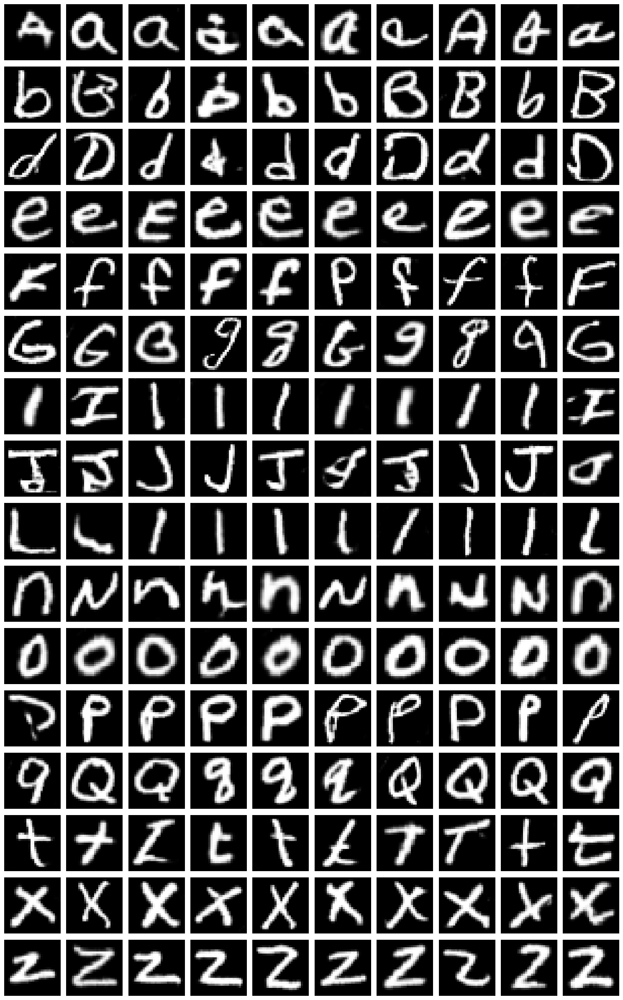

Epoch 251 | D Loss: 0.6469 | G Loss: 1.7327 | D Acc: 0.6250
Epoch 252 | D Loss: 0.8597 | G Loss: 2.1765 | D Acc: 0.4688
Epoch 253 | D Loss: 0.3645 | G Loss: 1.3723 | D Acc: 0.8594
Epoch 254 | D Loss: 0.5605 | G Loss: 0.9720 | D Acc: 0.6875
Epoch 255 | D Loss: 0.3844 | G Loss: 0.9069 | D Acc: 0.8203
Epoch 256 | D Loss: 0.6273 | G Loss: 0.9451 | D Acc: 0.5938
Epoch 257 | D Loss: 0.8605 | G Loss: 0.6327 | D Acc: 0.4062
Epoch 258 | D Loss: 0.3579 | G Loss: 2.7911 | D Acc: 0.8594
Epoch 259 | D Loss: 0.5508 | G Loss: 0.6413 | D Acc: 0.7109
Epoch 260 | D Loss: 0.6946 | G Loss: 1.8018 | D Acc: 0.5703
Preview images at epoch 260:


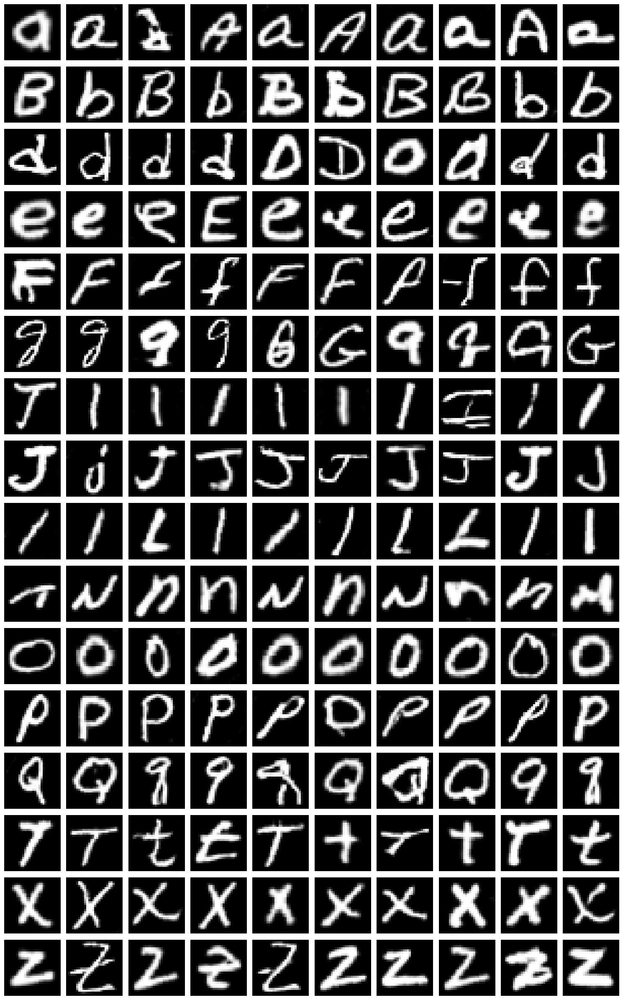

Epoch 261 | D Loss: 0.4549 | G Loss: 3.2790 | D Acc: 0.7422
Epoch 262 | D Loss: 0.5647 | G Loss: 2.4534 | D Acc: 0.6719
Epoch 263 | D Loss: 0.8578 | G Loss: 0.9504 | D Acc: 0.5156
Epoch 264 | D Loss: 0.5635 | G Loss: 1.6872 | D Acc: 0.6797
Epoch 265 | D Loss: 0.3974 | G Loss: 1.6124 | D Acc: 0.7969
Epoch 266 | D Loss: 0.3746 | G Loss: 0.6996 | D Acc: 0.8828
Epoch 267 | D Loss: 0.5587 | G Loss: 1.5564 | D Acc: 0.7266
Epoch 268 | D Loss: 0.7344 | G Loss: 1.8796 | D Acc: 0.5547
Epoch 269 | D Loss: 0.3344 | G Loss: 1.4981 | D Acc: 0.8906
Epoch 270 | D Loss: 0.2916 | G Loss: 1.6229 | D Acc: 0.9062
Preview images at epoch 270:


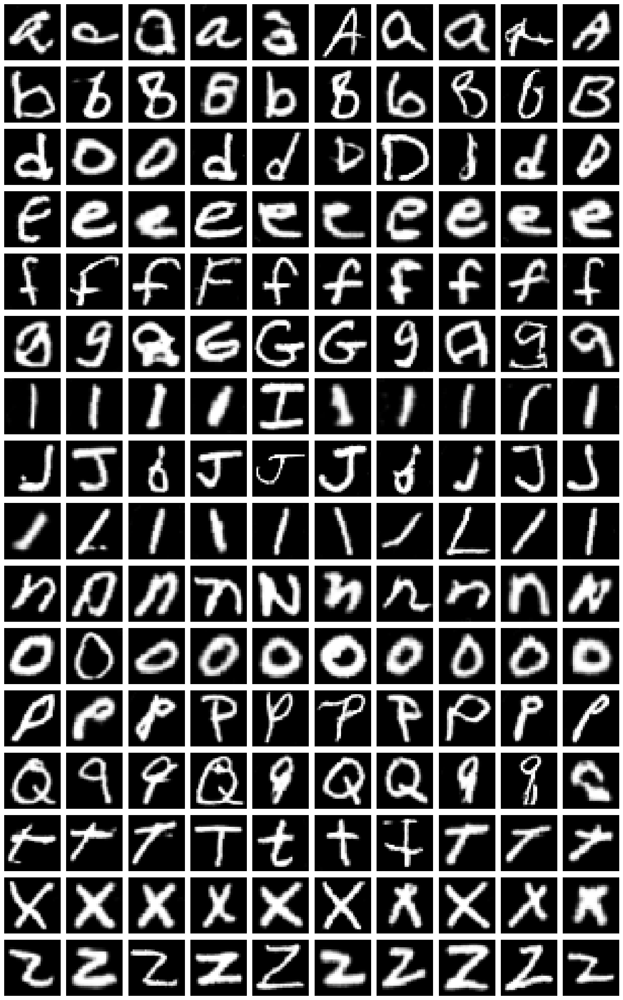

Epoch 271 | D Loss: 0.4068 | G Loss: 0.5981 | D Acc: 0.8438
Epoch 272 | D Loss: 0.6150 | G Loss: 1.2692 | D Acc: 0.6484
Epoch 273 | D Loss: 0.7850 | G Loss: 0.9927 | D Acc: 0.5703
Epoch 274 | D Loss: 0.5102 | G Loss: 1.3384 | D Acc: 0.7812
Epoch 275 | D Loss: 0.5032 | G Loss: 1.4529 | D Acc: 0.7344
Epoch 276 | D Loss: 0.5868 | G Loss: 1.9692 | D Acc: 0.6484
Epoch 277 | D Loss: 0.8716 | G Loss: 0.5957 | D Acc: 0.5078
Epoch 278 | D Loss: 0.5594 | G Loss: 1.7064 | D Acc: 0.6953
Epoch 279 | D Loss: 0.4216 | G Loss: 1.0573 | D Acc: 0.8672
Epoch 280 | D Loss: 0.2904 | G Loss: 0.7054 | D Acc: 0.9297
Preview images at epoch 280:


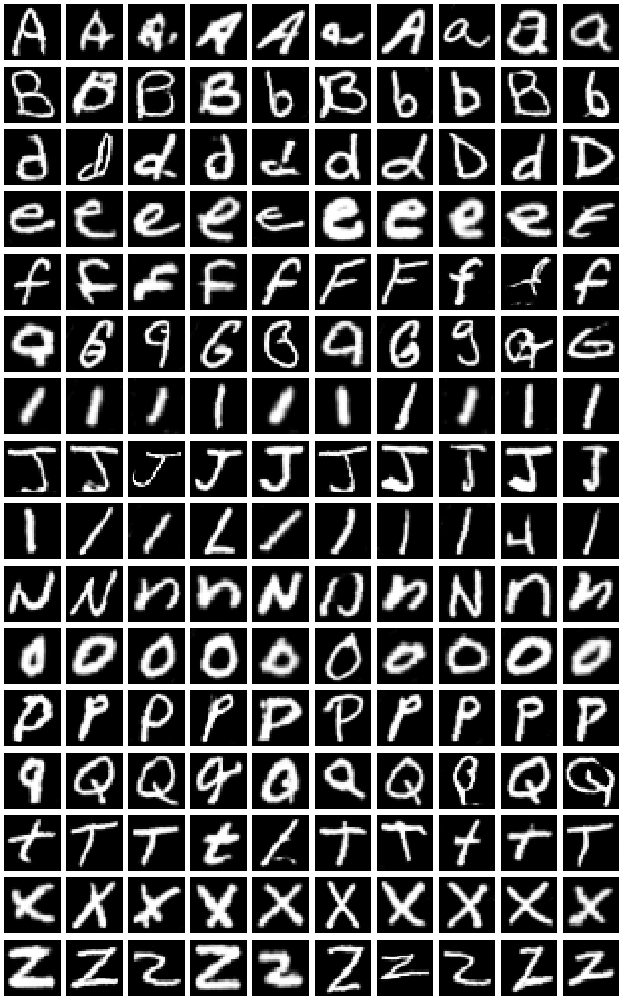

Epoch 281 | D Loss: 0.6568 | G Loss: 1.2472 | D Acc: 0.6094
Epoch 282 | D Loss: 0.4625 | G Loss: 1.3180 | D Acc: 0.7500
Epoch 283 | D Loss: 0.5810 | G Loss: 0.6691 | D Acc: 0.6875
Epoch 284 | D Loss: 0.5736 | G Loss: 0.8623 | D Acc: 0.7031
Epoch 285 | D Loss: 0.3725 | G Loss: 0.8997 | D Acc: 0.8047
Epoch 286 | D Loss: 0.9304 | G Loss: 0.3763 | D Acc: 0.5234
Epoch 287 | D Loss: 0.7203 | G Loss: 1.4917 | D Acc: 0.5859
Epoch 288 | D Loss: 0.2048 | G Loss: 1.0438 | D Acc: 0.9609
Epoch 289 | D Loss: 0.6094 | G Loss: 1.3853 | D Acc: 0.6562
Epoch 290 | D Loss: 0.6821 | G Loss: 1.4020 | D Acc: 0.5859
Preview images at epoch 290:


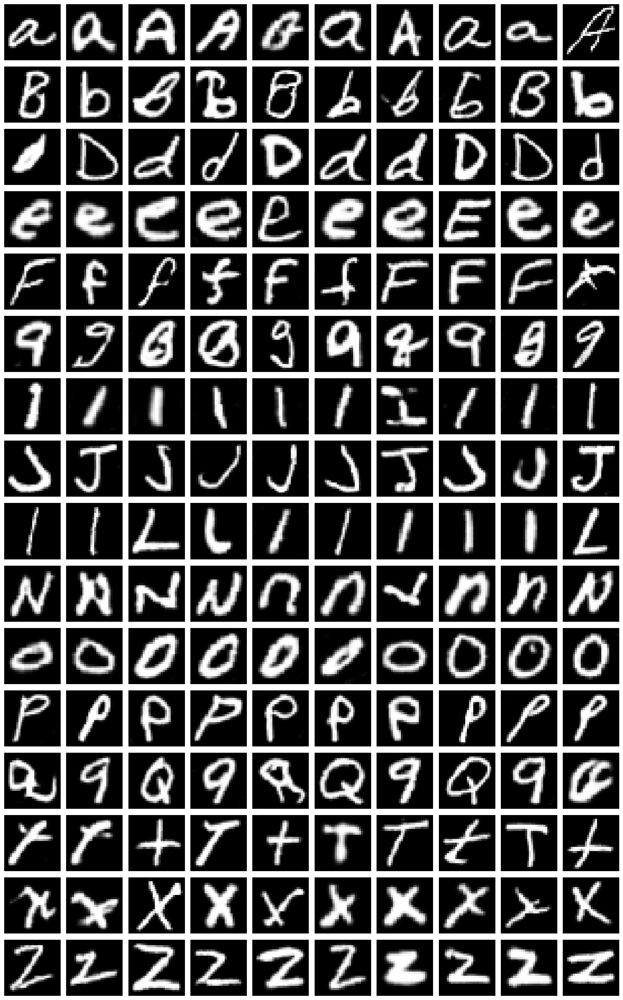

Epoch 291 | D Loss: 0.5581 | G Loss: 1.5663 | D Acc: 0.7266
Epoch 292 | D Loss: 0.6692 | G Loss: 1.9965 | D Acc: 0.6016
Epoch 293 | D Loss: 0.2898 | G Loss: 1.6797 | D Acc: 0.9297
Epoch 294 | D Loss: 0.3150 | G Loss: 0.6609 | D Acc: 0.8984
Epoch 295 | D Loss: 0.6140 | G Loss: 1.3052 | D Acc: 0.6406
Epoch 296 | D Loss: 0.8450 | G Loss: 2.3454 | D Acc: 0.5391
Epoch 297 | D Loss: 0.6631 | G Loss: 0.9490 | D Acc: 0.6719
Epoch 298 | D Loss: 1.0205 | G Loss: 1.0336 | D Acc: 0.5234
Epoch 299 | D Loss: 0.5767 | G Loss: 1.4663 | D Acc: 0.6953
Epoch 300 | D Loss: 0.9038 | G Loss: 1.6814 | D Acc: 0.3984
Preview images at epoch 300:


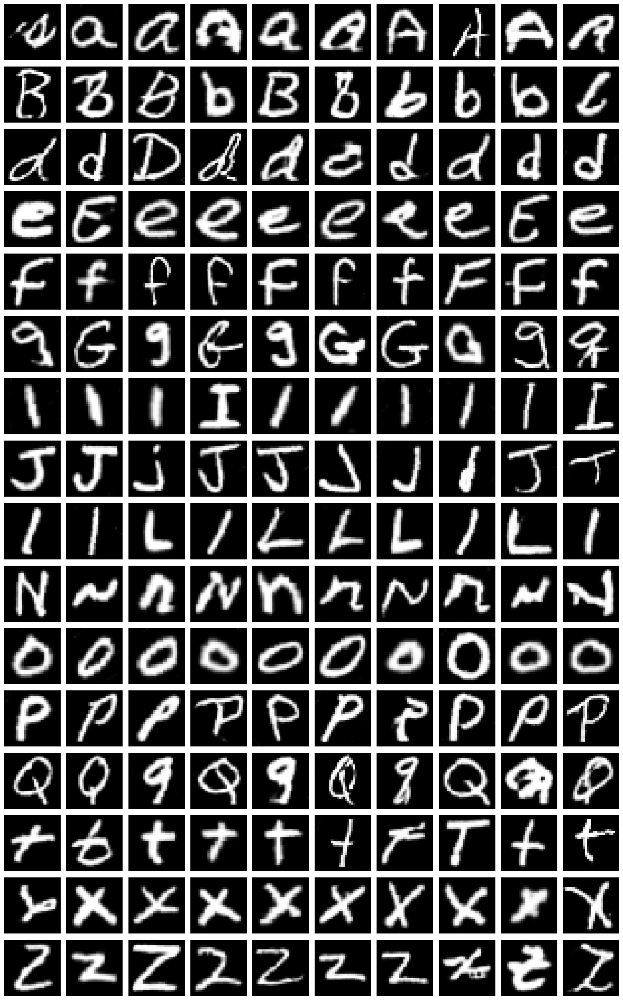

Epoch 301 | D Loss: 0.8165 | G Loss: 1.9707 | D Acc: 0.4688
Epoch 302 | D Loss: 0.6318 | G Loss: 0.8769 | D Acc: 0.6719
Epoch 303 | D Loss: 0.1927 | G Loss: 1.8409 | D Acc: 0.9609
Epoch 304 | D Loss: 0.3634 | G Loss: 1.2573 | D Acc: 0.8438
Epoch 305 | D Loss: 0.5775 | G Loss: 1.9421 | D Acc: 0.7031
Epoch 306 | D Loss: 0.8550 | G Loss: 2.6311 | D Acc: 0.5625
Epoch 307 | D Loss: 0.6048 | G Loss: 1.5677 | D Acc: 0.6406
Epoch 308 | D Loss: 0.6936 | G Loss: 0.7672 | D Acc: 0.5703
Epoch 309 | D Loss: 0.5662 | G Loss: 0.9058 | D Acc: 0.6875
Epoch 310 | D Loss: 0.2260 | G Loss: 1.0152 | D Acc: 0.9453
Preview images at epoch 310:


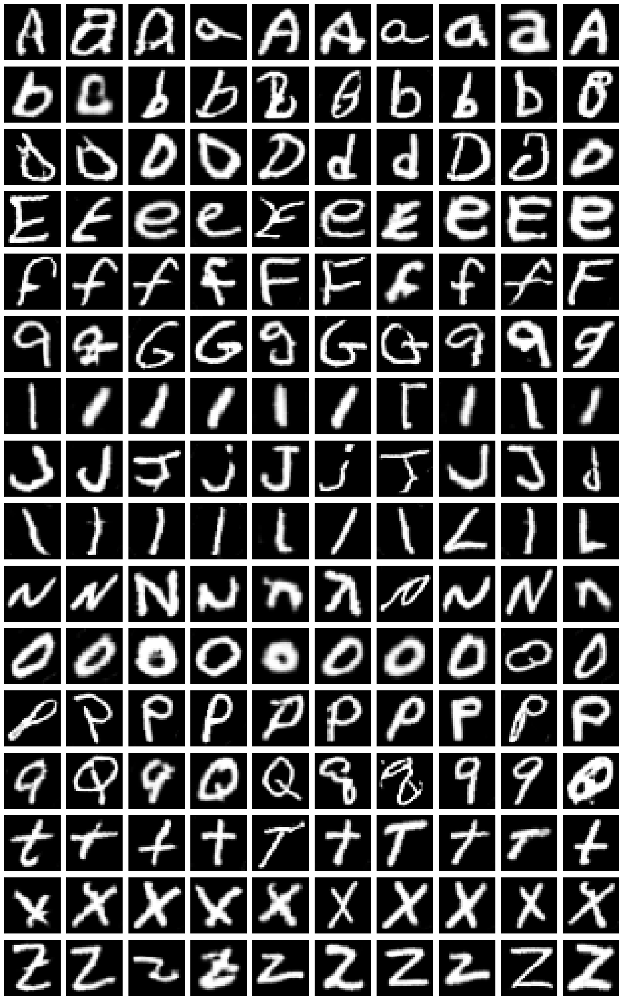

Epoch 311 | D Loss: 0.2397 | G Loss: 1.5929 | D Acc: 0.9297
Epoch 312 | D Loss: 0.4018 | G Loss: 0.9215 | D Acc: 0.8750
Epoch 313 | D Loss: 0.4410 | G Loss: 1.7842 | D Acc: 0.8203
Epoch 314 | D Loss: 0.4752 | G Loss: 1.9874 | D Acc: 0.7500
Epoch 315 | D Loss: 0.4273 | G Loss: 1.6930 | D Acc: 0.7891
Epoch 316 | D Loss: 0.3406 | G Loss: 1.0850 | D Acc: 0.8984
Epoch 317 | D Loss: 1.0631 | G Loss: 0.6969 | D Acc: 0.4531
Epoch 318 | D Loss: 0.6535 | G Loss: 1.6808 | D Acc: 0.5938
Epoch 319 | D Loss: 0.6469 | G Loss: 1.6603 | D Acc: 0.6719
Epoch 320 | D Loss: 0.6235 | G Loss: 1.3107 | D Acc: 0.6328
Preview images at epoch 320:


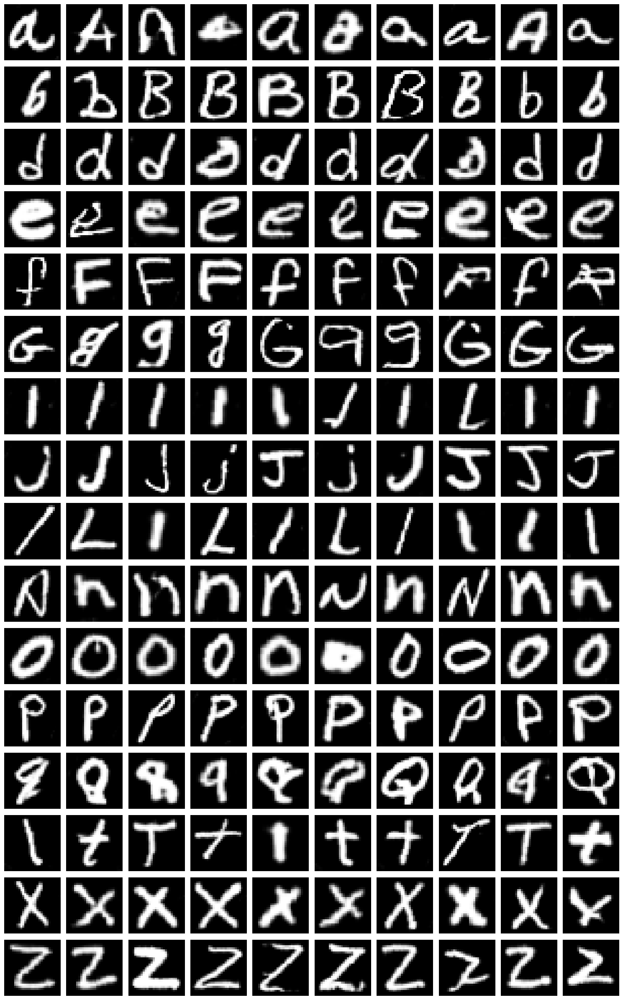

Epoch 321 | D Loss: 0.5661 | G Loss: 0.9212 | D Acc: 0.6797
Epoch 322 | D Loss: 0.8039 | G Loss: 0.8382 | D Acc: 0.5234
Epoch 323 | D Loss: 0.2613 | G Loss: 0.5721 | D Acc: 0.8906
Epoch 324 | D Loss: 0.9842 | G Loss: 2.2126 | D Acc: 0.4531
Epoch 325 | D Loss: 0.4760 | G Loss: 2.7573 | D Acc: 0.8203
Epoch 326 | D Loss: 0.5454 | G Loss: 1.0114 | D Acc: 0.7031
Epoch 327 | D Loss: 0.5832 | G Loss: 0.6310 | D Acc: 0.6719
Epoch 328 | D Loss: 0.5244 | G Loss: 0.4546 | D Acc: 0.7109
Epoch 329 | D Loss: 0.4034 | G Loss: 1.1134 | D Acc: 0.8203
Epoch 330 | D Loss: 0.6848 | G Loss: 2.3107 | D Acc: 0.5859
Preview images at epoch 330:


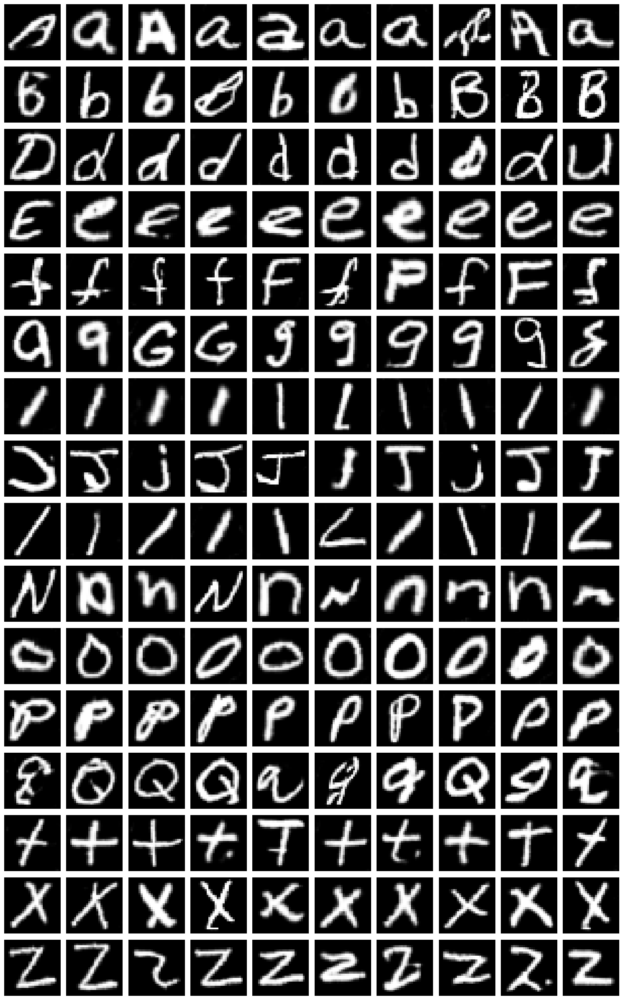

Epoch 331 | D Loss: 0.4686 | G Loss: 0.9452 | D Acc: 0.7969
Epoch 332 | D Loss: 0.3389 | G Loss: 1.6234 | D Acc: 0.8438
Epoch 333 | D Loss: 0.6797 | G Loss: 0.5662 | D Acc: 0.6328
Epoch 334 | D Loss: 0.4886 | G Loss: 2.7741 | D Acc: 0.7109
Epoch 335 | D Loss: 0.8702 | G Loss: 2.1084 | D Acc: 0.5625
Epoch 336 | D Loss: 0.3284 | G Loss: 1.4747 | D Acc: 0.8906
Epoch 337 | D Loss: 0.7137 | G Loss: 0.8089 | D Acc: 0.5859
Epoch 338 | D Loss: 0.4403 | G Loss: 1.6090 | D Acc: 0.7812
Epoch 339 | D Loss: 0.4520 | G Loss: 0.8292 | D Acc: 0.8203
Epoch 340 | D Loss: 0.3561 | G Loss: 3.0711 | D Acc: 0.8906
Preview images at epoch 340:


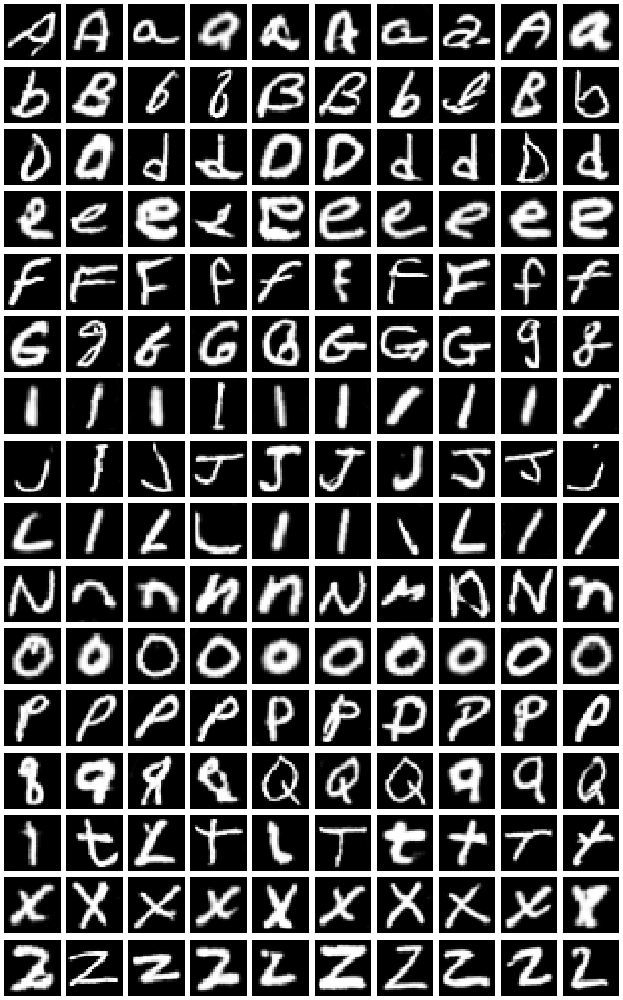

Epoch 341 | D Loss: 0.5270 | G Loss: 1.5847 | D Acc: 0.7578
Epoch 342 | D Loss: 0.6182 | G Loss: 1.3601 | D Acc: 0.6719
Epoch 343 | D Loss: 0.3715 | G Loss: 1.8277 | D Acc: 0.8281
Epoch 344 | D Loss: 0.3276 | G Loss: 1.5701 | D Acc: 0.8984
Epoch 345 | D Loss: 0.5738 | G Loss: 1.6481 | D Acc: 0.6797
Epoch 346 | D Loss: 0.5117 | G Loss: 0.5208 | D Acc: 0.7656
Epoch 347 | D Loss: 0.6341 | G Loss: 2.4578 | D Acc: 0.6250
Epoch 348 | D Loss: 0.9196 | G Loss: 0.4367 | D Acc: 0.5469
Epoch 349 | D Loss: 0.7649 | G Loss: 2.2140 | D Acc: 0.5703
Epoch 350 | D Loss: 0.3760 | G Loss: 1.4333 | D Acc: 0.8828
Preview images at epoch 350:


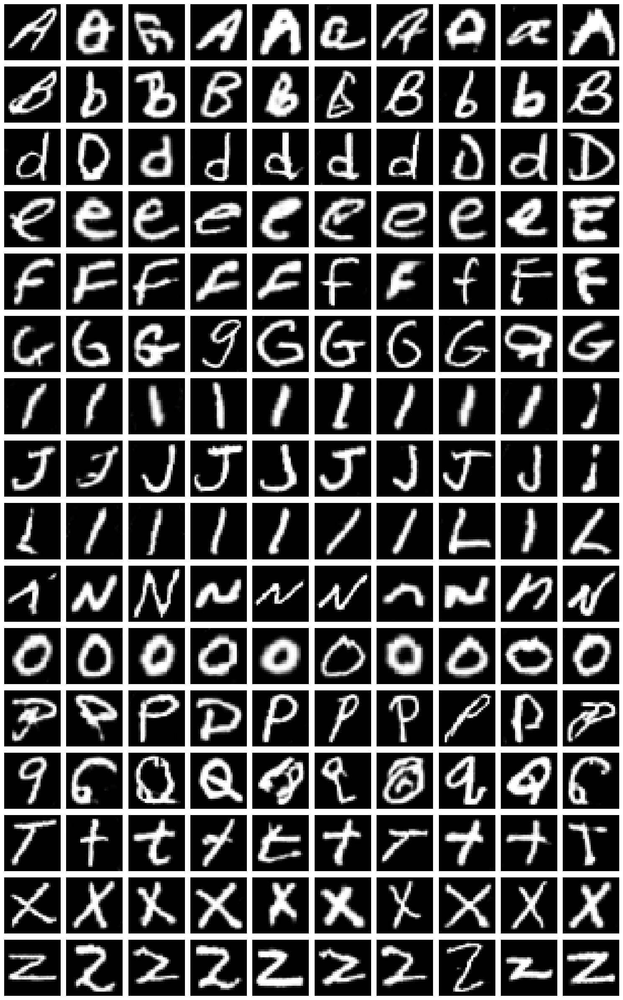

Epoch 351 | D Loss: 0.6693 | G Loss: 1.6170 | D Acc: 0.6250
Epoch 352 | D Loss: 0.5064 | G Loss: 1.1547 | D Acc: 0.7812
Epoch 353 | D Loss: 0.2540 | G Loss: 0.7860 | D Acc: 0.9375
Epoch 354 | D Loss: 0.6508 | G Loss: 1.4949 | D Acc: 0.6328
Epoch 355 | D Loss: 0.3458 | G Loss: 1.3138 | D Acc: 0.8750
Epoch 356 | D Loss: 0.4865 | G Loss: 1.0570 | D Acc: 0.6641
Epoch 357 | D Loss: 0.3905 | G Loss: 2.9676 | D Acc: 0.8281
Epoch 358 | D Loss: 0.3456 | G Loss: 1.6889 | D Acc: 0.8438
Epoch 359 | D Loss: 1.0309 | G Loss: 2.5282 | D Acc: 0.5391
Epoch 360 | D Loss: 0.5398 | G Loss: 0.4554 | D Acc: 0.6875
Preview images at epoch 360:


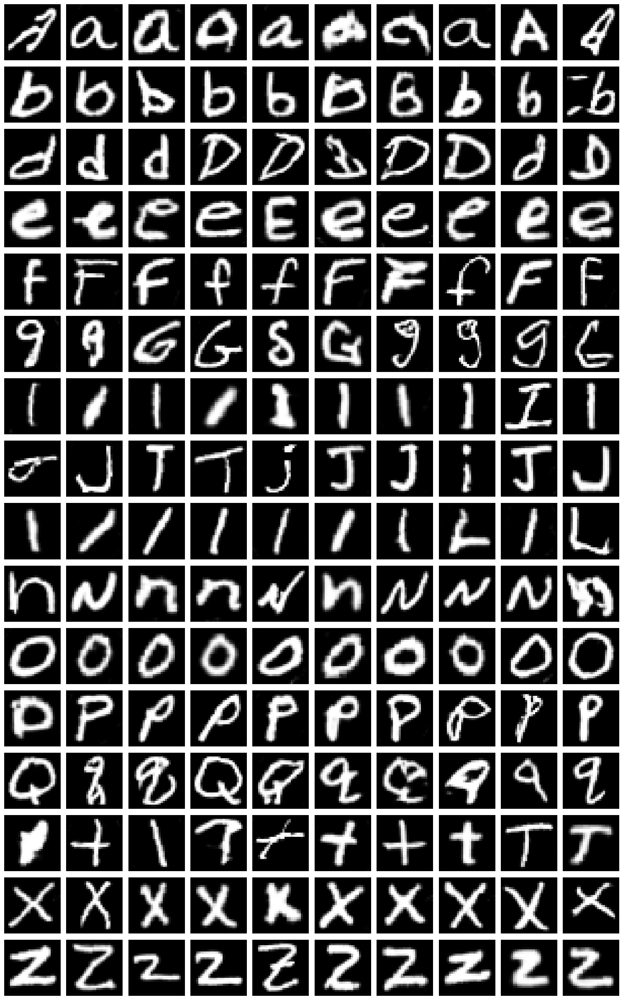

Epoch 361 | D Loss: 0.3142 | G Loss: 2.3118 | D Acc: 0.8281
Epoch 362 | D Loss: 0.6451 | G Loss: 2.3810 | D Acc: 0.5938
Epoch 363 | D Loss: 0.6292 | G Loss: 1.8861 | D Acc: 0.6250
Epoch 364 | D Loss: 0.5156 | G Loss: 1.6903 | D Acc: 0.6719
Epoch 365 | D Loss: 0.5385 | G Loss: 2.4350 | D Acc: 0.7109
Epoch 366 | D Loss: 0.4836 | G Loss: 1.8113 | D Acc: 0.7188
Epoch 367 | D Loss: 0.8965 | G Loss: 1.4146 | D Acc: 0.5234
Epoch 368 | D Loss: 0.1802 | G Loss: 0.4479 | D Acc: 0.9844
Epoch 369 | D Loss: 0.4568 | G Loss: 1.4465 | D Acc: 0.7734
Epoch 370 | D Loss: 0.3396 | G Loss: 2.7039 | D Acc: 0.8750
Preview images at epoch 370:


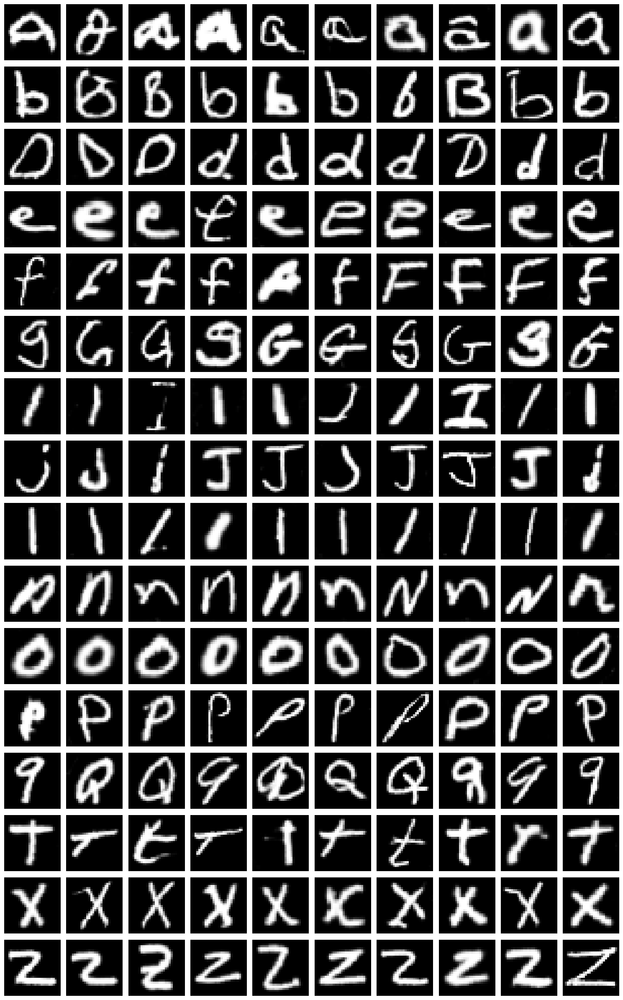

Epoch 371 | D Loss: 0.4532 | G Loss: 1.9468 | D Acc: 0.7891
Epoch 372 | D Loss: 0.7746 | G Loss: 0.6442 | D Acc: 0.5391
Epoch 373 | D Loss: 1.0254 | G Loss: 1.6839 | D Acc: 0.5078
Epoch 374 | D Loss: 0.7934 | G Loss: 0.8621 | D Acc: 0.5391
Epoch 375 | D Loss: 0.2586 | G Loss: 2.7980 | D Acc: 0.9375
Epoch 376 | D Loss: 0.5490 | G Loss: 1.1972 | D Acc: 0.6875
Epoch 377 | D Loss: 0.2652 | G Loss: 1.2689 | D Acc: 0.8750
Epoch 378 | D Loss: 0.4257 | G Loss: 0.7297 | D Acc: 0.7812
Epoch 379 | D Loss: 0.3225 | G Loss: 2.5811 | D Acc: 0.8516
Epoch 380 | D Loss: 0.8039 | G Loss: 0.3654 | D Acc: 0.5625
Preview images at epoch 380:


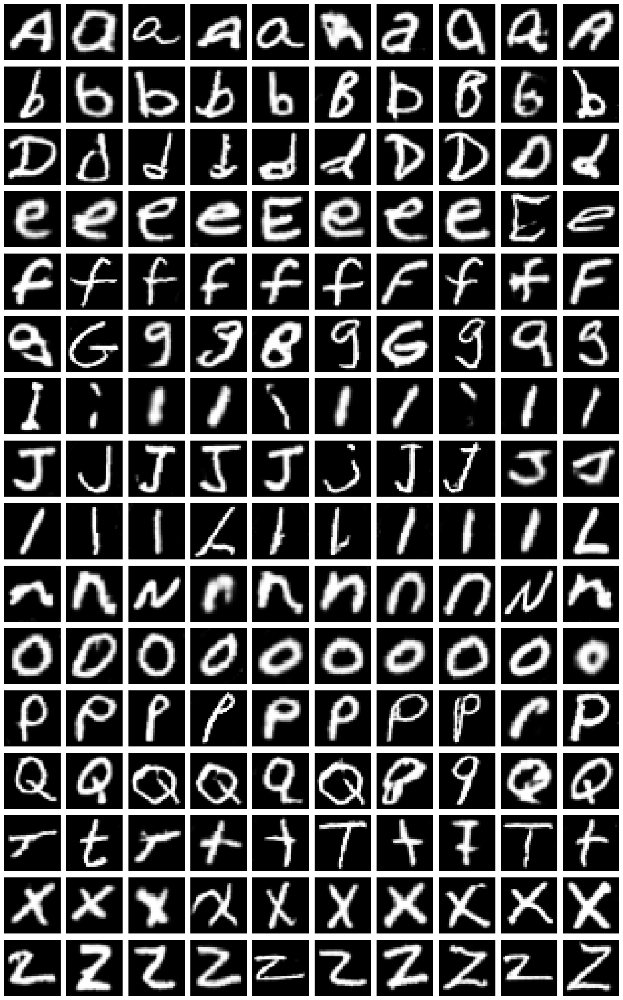

Epoch 381 | D Loss: 0.1875 | G Loss: 2.1867 | D Acc: 0.9531
Epoch 382 | D Loss: 0.6430 | G Loss: 1.8585 | D Acc: 0.6328
Epoch 383 | D Loss: 0.4085 | G Loss: 0.9149 | D Acc: 0.8594
Epoch 384 | D Loss: 0.3260 | G Loss: 1.7729 | D Acc: 0.9062
Epoch 385 | D Loss: 0.1828 | G Loss: 2.5938 | D Acc: 0.9609
Epoch 386 | D Loss: 0.3444 | G Loss: 2.5137 | D Acc: 0.8672
Epoch 387 | D Loss: 0.4444 | G Loss: 1.1049 | D Acc: 0.7969
Epoch 388 | D Loss: 0.2540 | G Loss: 1.5412 | D Acc: 0.9688
Epoch 389 | D Loss: 0.3832 | G Loss: 1.9019 | D Acc: 0.8672
Epoch 390 | D Loss: 0.4041 | G Loss: 3.1312 | D Acc: 0.8203
Preview images at epoch 390:


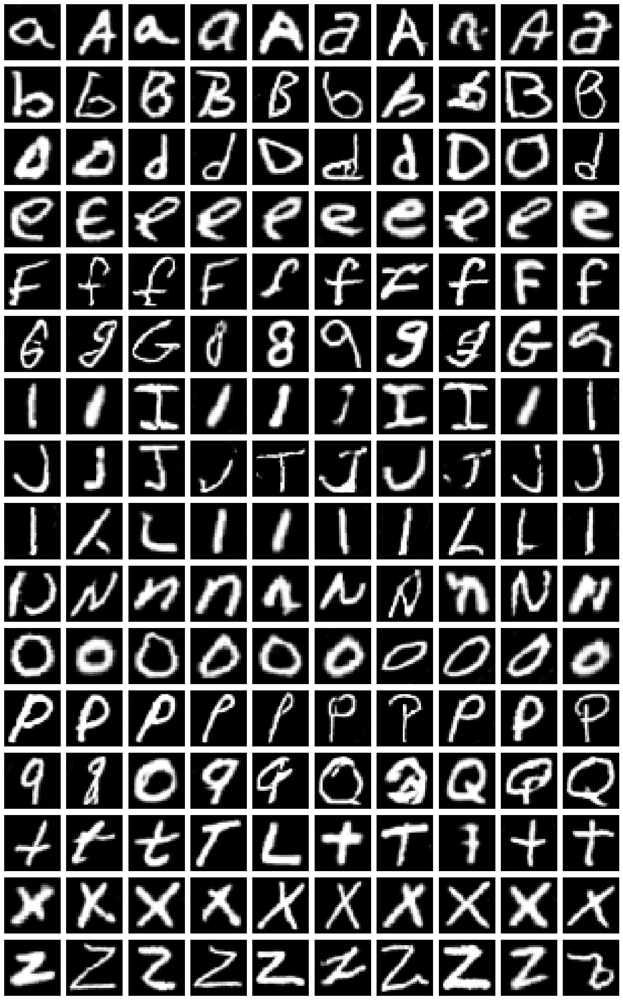

Epoch 391 | D Loss: 0.3957 | G Loss: 1.3841 | D Acc: 0.8359
Epoch 392 | D Loss: 0.3956 | G Loss: 0.2794 | D Acc: 0.8516
Epoch 393 | D Loss: 0.1760 | G Loss: 1.1683 | D Acc: 0.9844
Epoch 394 | D Loss: 0.7595 | G Loss: 0.5153 | D Acc: 0.5703
Epoch 395 | D Loss: 0.0560 | G Loss: 1.9495 | D Acc: 1.0000
Epoch 396 | D Loss: 0.4964 | G Loss: 2.4793 | D Acc: 0.7578
Epoch 397 | D Loss: 0.5129 | G Loss: 0.9440 | D Acc: 0.7578
Epoch 398 | D Loss: 0.7700 | G Loss: 1.8420 | D Acc: 0.5625
Epoch 399 | D Loss: 0.7032 | G Loss: 0.5983 | D Acc: 0.6172
Epoch 400 | D Loss: 0.7444 | G Loss: 1.8046 | D Acc: 0.5625
Preview images at epoch 400:


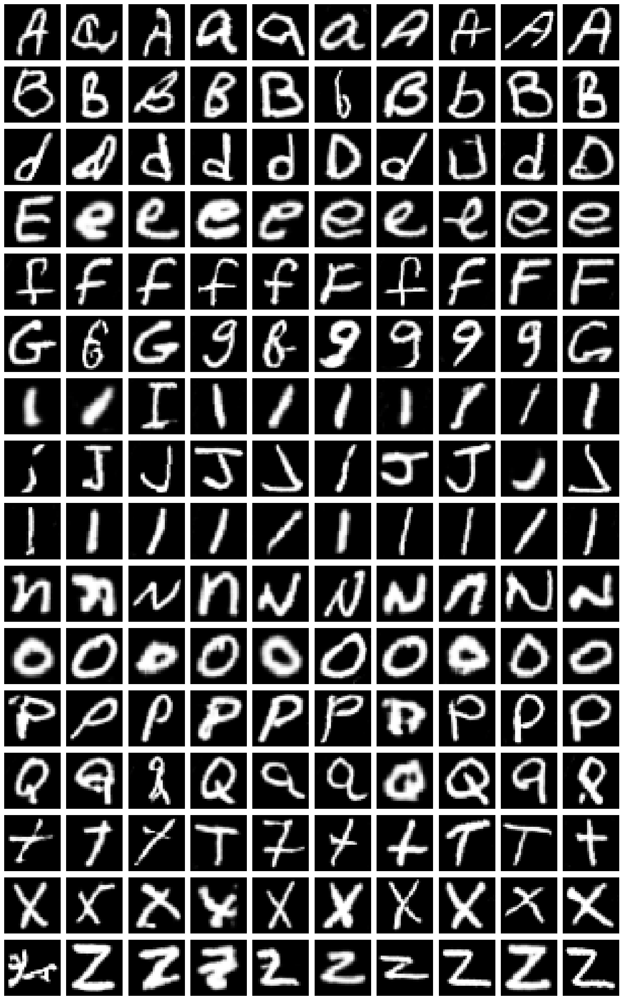

Epoch 401 | D Loss: 0.6097 | G Loss: 1.2469 | D Acc: 0.6719
Epoch 402 | D Loss: 1.1224 | G Loss: 0.3730 | D Acc: 0.5312
Epoch 403 | D Loss: 0.2534 | G Loss: 0.6557 | D Acc: 0.9531
Epoch 404 | D Loss: 0.2345 | G Loss: 1.6884 | D Acc: 0.9141
Epoch 405 | D Loss: 0.1576 | G Loss: 0.6059 | D Acc: 0.9844
Epoch 406 | D Loss: 0.3059 | G Loss: 1.9061 | D Acc: 0.8672
Epoch 407 | D Loss: 0.6402 | G Loss: 2.7269 | D Acc: 0.6875
Epoch 408 | D Loss: 0.3104 | G Loss: 0.9055 | D Acc: 0.8828
Epoch 409 | D Loss: 0.4433 | G Loss: 2.1502 | D Acc: 0.8047
Epoch 410 | D Loss: 0.3994 | G Loss: 0.6822 | D Acc: 0.7812
Preview images at epoch 410:


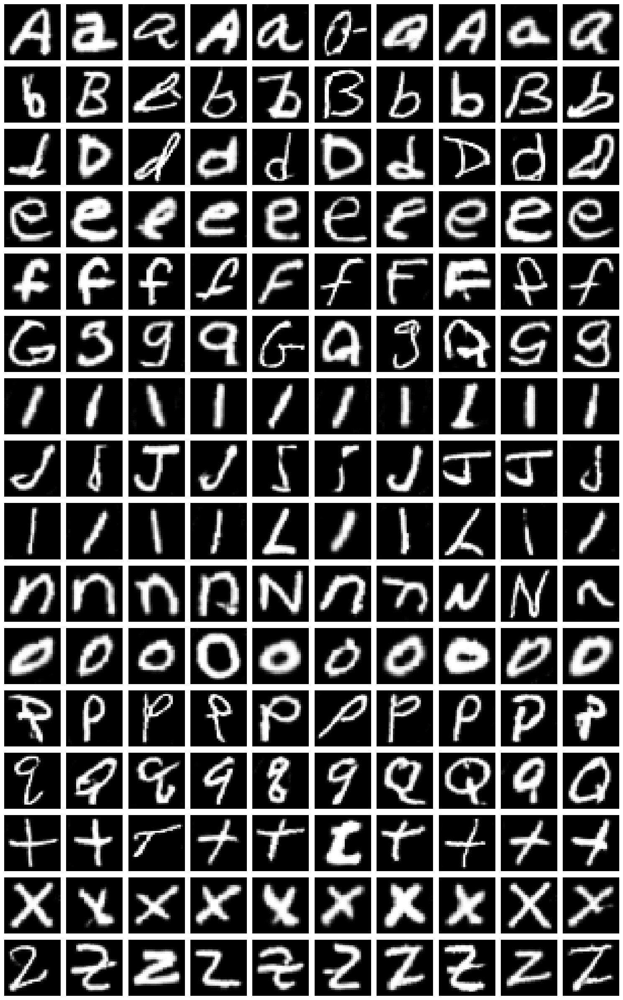

Epoch 411 | D Loss: 0.4199 | G Loss: 1.8990 | D Acc: 0.7812
Epoch 412 | D Loss: 0.4690 | G Loss: 1.1571 | D Acc: 0.7891
Epoch 413 | D Loss: 0.4450 | G Loss: 1.5457 | D Acc: 0.7656
Epoch 414 | D Loss: 0.1686 | G Loss: 1.4458 | D Acc: 0.9531
Epoch 415 | D Loss: 0.5069 | G Loss: 1.5338 | D Acc: 0.7188
Epoch 416 | D Loss: 0.6384 | G Loss: 1.4688 | D Acc: 0.6484
Epoch 417 | D Loss: 0.3097 | G Loss: 2.3514 | D Acc: 0.9141
Epoch 418 | D Loss: 0.3971 | G Loss: 1.0084 | D Acc: 0.8047
Epoch 419 | D Loss: 0.5211 | G Loss: 1.4366 | D Acc: 0.7344
Epoch 420 | D Loss: 0.8824 | G Loss: 1.3723 | D Acc: 0.5312
Preview images at epoch 420:


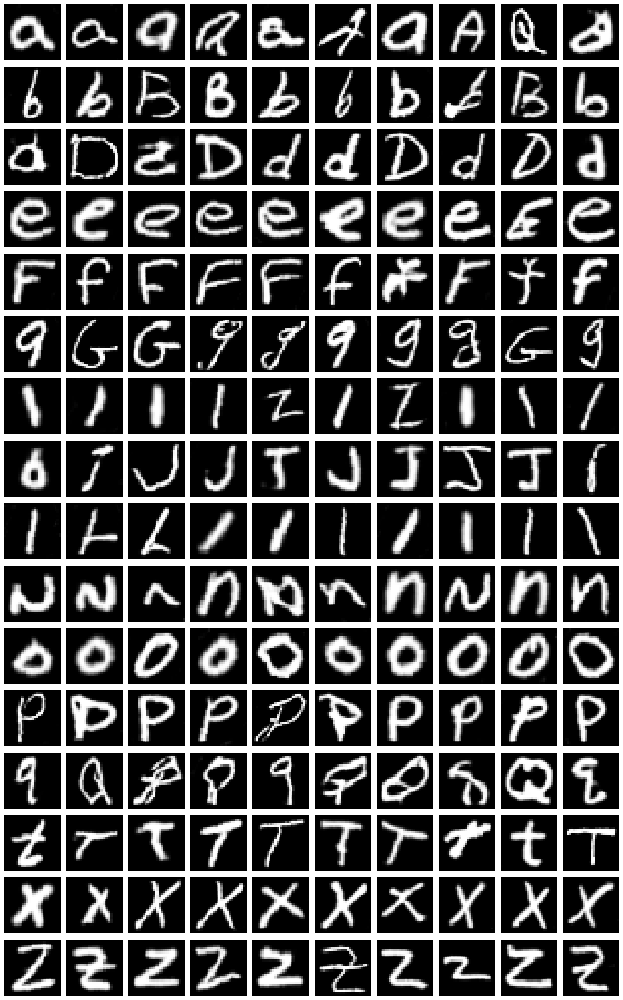

Epoch 421 | D Loss: 0.4141 | G Loss: 2.2332 | D Acc: 0.8359
Epoch 422 | D Loss: 0.2539 | G Loss: 1.4018 | D Acc: 0.9375
Epoch 423 | D Loss: 0.7428 | G Loss: 0.3245 | D Acc: 0.6250
Epoch 424 | D Loss: 0.3338 | G Loss: 1.3054 | D Acc: 0.8984
Epoch 425 | D Loss: 0.1821 | G Loss: 1.9898 | D Acc: 0.9688
Epoch 426 | D Loss: 0.2376 | G Loss: 0.7666 | D Acc: 0.9531
Epoch 427 | D Loss: 0.5619 | G Loss: 2.5862 | D Acc: 0.7031
Epoch 428 | D Loss: 0.2507 | G Loss: 2.3008 | D Acc: 0.9141
Epoch 429 | D Loss: 0.4197 | G Loss: 0.8582 | D Acc: 0.8125
Epoch 430 | D Loss: 0.5791 | G Loss: 1.1531 | D Acc: 0.7109
Preview images at epoch 430:


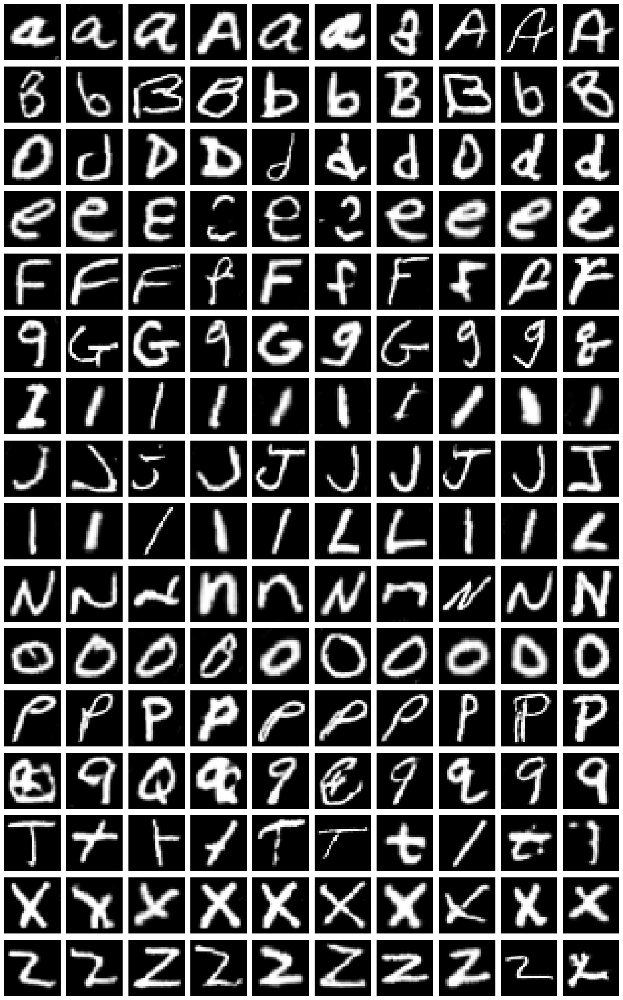

Epoch 431 | D Loss: 0.4892 | G Loss: 2.7785 | D Acc: 0.7422
Epoch 432 | D Loss: 0.3419 | G Loss: 2.4111 | D Acc: 0.8359
Epoch 433 | D Loss: 0.4337 | G Loss: 2.5687 | D Acc: 0.7734
Epoch 434 | D Loss: 0.4779 | G Loss: 1.5155 | D Acc: 0.7578
Epoch 435 | D Loss: 0.2778 | G Loss: 1.2200 | D Acc: 0.8828
Epoch 436 | D Loss: 0.2581 | G Loss: 3.0339 | D Acc: 0.9219
Epoch 437 | D Loss: 0.4709 | G Loss: 0.8044 | D Acc: 0.7734
Epoch 438 | D Loss: 0.2018 | G Loss: 1.7165 | D Acc: 0.9688
Epoch 439 | D Loss: 0.1369 | G Loss: 1.3390 | D Acc: 0.9609
Epoch 440 | D Loss: 0.4270 | G Loss: 0.7638 | D Acc: 0.7891
Preview images at epoch 440:


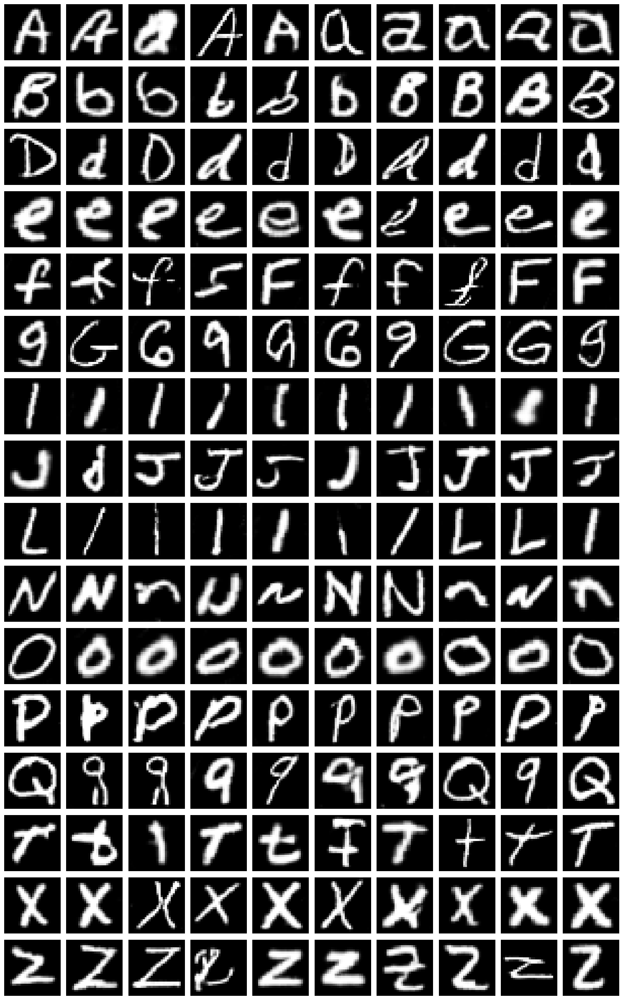

Epoch 441 | D Loss: 0.4058 | G Loss: 2.5740 | D Acc: 0.8281
Epoch 442 | D Loss: 0.4260 | G Loss: 2.0306 | D Acc: 0.7812
Epoch 443 | D Loss: 0.4298 | G Loss: 1.9032 | D Acc: 0.7891
Epoch 444 | D Loss: 0.2723 | G Loss: 1.9107 | D Acc: 0.9141
Epoch 445 | D Loss: 0.3049 | G Loss: 1.7161 | D Acc: 0.9219
Epoch 446 | D Loss: 0.5565 | G Loss: 1.5893 | D Acc: 0.7344
Epoch 447 | D Loss: 0.3645 | G Loss: 0.9384 | D Acc: 0.8359
Epoch 448 | D Loss: 0.7397 | G Loss: 1.1438 | D Acc: 0.5781
Epoch 449 | D Loss: 0.5260 | G Loss: 0.9556 | D Acc: 0.7031
Epoch 450 | D Loss: 0.3116 | G Loss: 0.8098 | D Acc: 0.9375
Preview images at epoch 450:


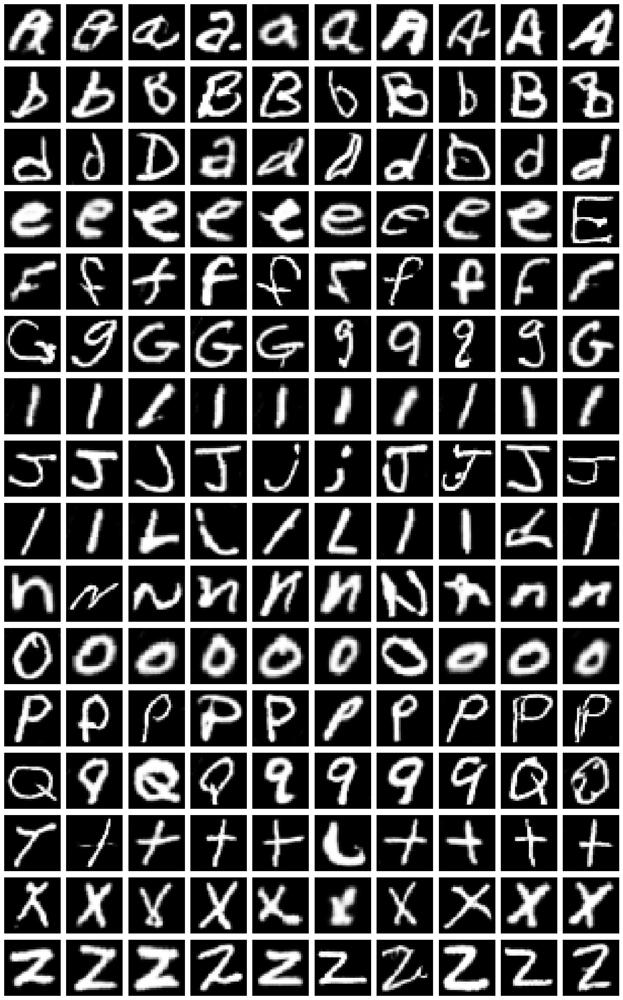

Epoch 451 | D Loss: 0.1498 | G Loss: 2.1983 | D Acc: 0.9844
Epoch 452 | D Loss: 0.6847 | G Loss: 1.1929 | D Acc: 0.6641
Epoch 453 | D Loss: 0.8766 | G Loss: 1.4516 | D Acc: 0.5391
Epoch 454 | D Loss: 0.3523 | G Loss: 2.6579 | D Acc: 0.7969
Epoch 455 | D Loss: 0.9183 | G Loss: 1.4455 | D Acc: 0.5859
Epoch 456 | D Loss: 0.3409 | G Loss: 1.9595 | D Acc: 0.8672
Epoch 457 | D Loss: 0.4372 | G Loss: 3.9195 | D Acc: 0.7578
Epoch 458 | D Loss: 0.6052 | G Loss: 1.3653 | D Acc: 0.7031
Epoch 459 | D Loss: 0.0733 | G Loss: 1.5947 | D Acc: 1.0000
Epoch 460 | D Loss: 0.2218 | G Loss: 3.2662 | D Acc: 0.9688
Preview images at epoch 460:


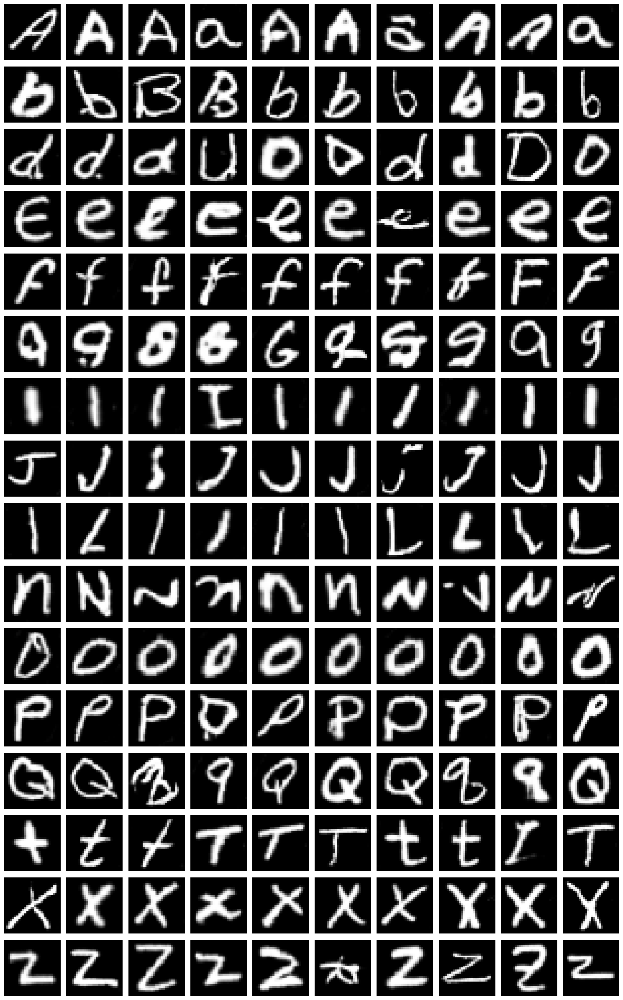

Epoch 461 | D Loss: 0.5353 | G Loss: 2.1904 | D Acc: 0.7109
Epoch 462 | D Loss: 0.1460 | G Loss: 3.7032 | D Acc: 0.9609
Epoch 463 | D Loss: 0.2749 | G Loss: 1.8476 | D Acc: 0.9453
Epoch 464 | D Loss: 0.6015 | G Loss: 2.6593 | D Acc: 0.6406
Epoch 465 | D Loss: 0.1037 | G Loss: 1.6883 | D Acc: 0.9766
Epoch 466 | D Loss: 0.1197 | G Loss: 0.9681 | D Acc: 0.9844
Epoch 467 | D Loss: 0.2472 | G Loss: 1.4843 | D Acc: 0.9141
Epoch 468 | D Loss: 0.2712 | G Loss: 1.0440 | D Acc: 0.9219
Epoch 469 | D Loss: 1.1723 | G Loss: 3.3614 | D Acc: 0.4688
Epoch 470 | D Loss: 0.6327 | G Loss: 0.4648 | D Acc: 0.6719
Preview images at epoch 470:


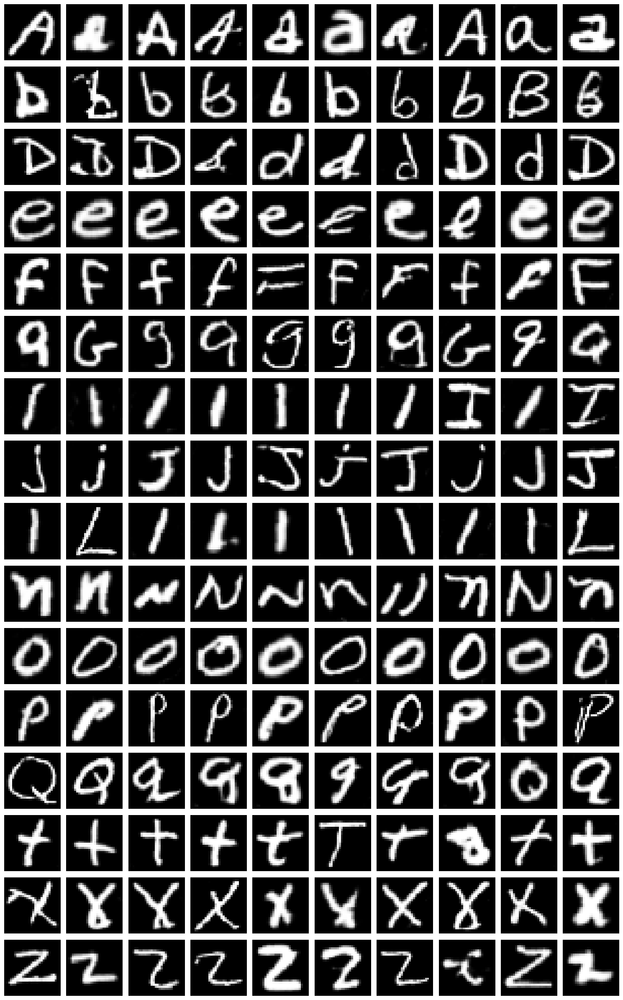

Epoch 471 | D Loss: 0.2152 | G Loss: 0.2658 | D Acc: 0.9609
Epoch 472 | D Loss: 0.3325 | G Loss: 1.5930 | D Acc: 0.8281
Epoch 473 | D Loss: 0.2083 | G Loss: 1.8494 | D Acc: 0.9766
Epoch 474 | D Loss: 0.7754 | G Loss: 1.9690 | D Acc: 0.5938
Epoch 475 | D Loss: 0.6515 | G Loss: 0.7466 | D Acc: 0.6484
Epoch 476 | D Loss: 0.9268 | G Loss: 1.3701 | D Acc: 0.5469
Epoch 477 | D Loss: 0.8258 | G Loss: 1.3562 | D Acc: 0.5625
Epoch 478 | D Loss: 0.4325 | G Loss: 0.7002 | D Acc: 0.7891
Epoch 479 | D Loss: 0.3256 | G Loss: 2.2991 | D Acc: 0.8359
Epoch 480 | D Loss: 0.2614 | G Loss: 1.9411 | D Acc: 0.9062
Preview images at epoch 480:


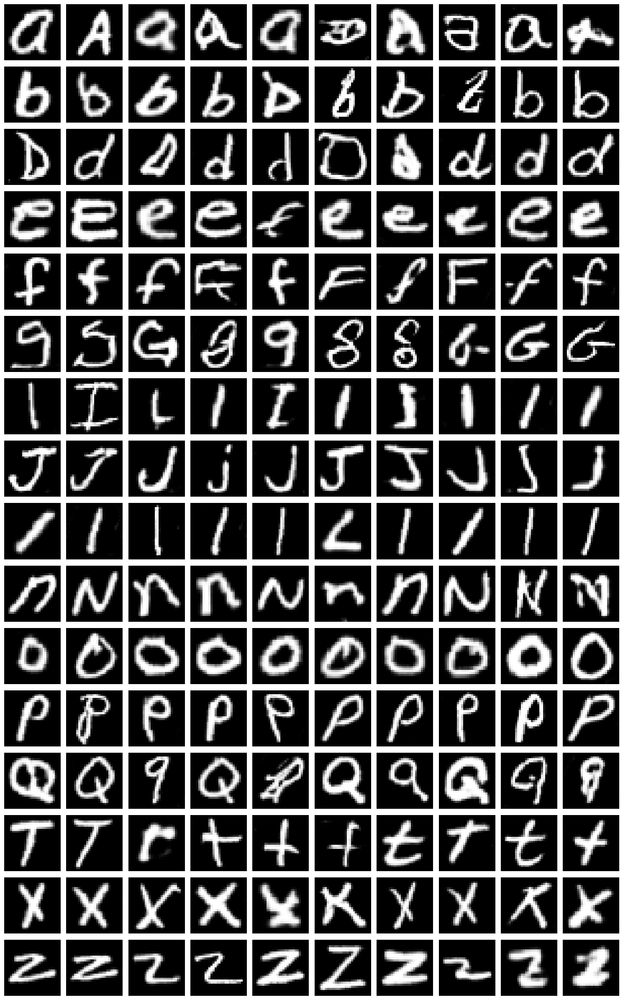

Epoch 481 | D Loss: 0.3798 | G Loss: 1.1352 | D Acc: 0.7891
Epoch 482 | D Loss: 0.2112 | G Loss: 0.9319 | D Acc: 0.9531
Epoch 483 | D Loss: 0.3839 | G Loss: 1.8846 | D Acc: 0.8281
Epoch 484 | D Loss: 0.5331 | G Loss: 2.3579 | D Acc: 0.7344
Epoch 485 | D Loss: 0.3352 | G Loss: 2.2976 | D Acc: 0.8594
Epoch 486 | D Loss: 0.1646 | G Loss: 1.8866 | D Acc: 0.9688
Epoch 487 | D Loss: 0.2246 | G Loss: 1.0036 | D Acc: 0.9219
Epoch 488 | D Loss: 0.2646 | G Loss: 2.9824 | D Acc: 0.9219
Epoch 489 | D Loss: 0.4721 | G Loss: 1.2751 | D Acc: 0.7344
Epoch 490 | D Loss: 0.6215 | G Loss: 2.3802 | D Acc: 0.6406
Preview images at epoch 490:


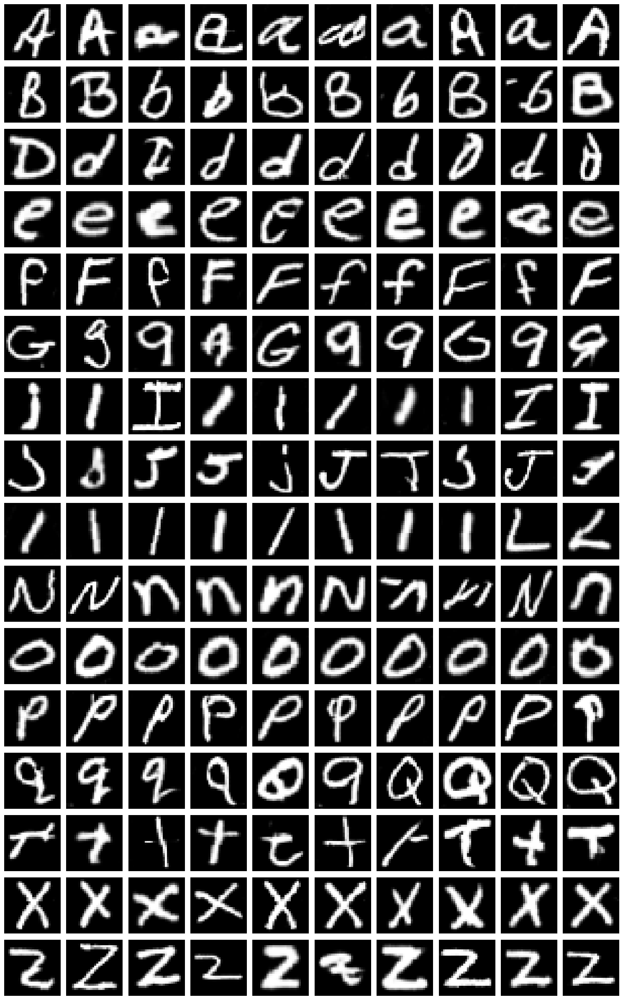

Epoch 491 | D Loss: 0.5615 | G Loss: 1.0038 | D Acc: 0.7109
Epoch 492 | D Loss: 0.7911 | G Loss: 4.5443 | D Acc: 0.5234
Epoch 493 | D Loss: 0.8377 | G Loss: 0.4971 | D Acc: 0.5703
Epoch 494 | D Loss: 0.3684 | G Loss: 2.5342 | D Acc: 0.8438
Epoch 495 | D Loss: 0.5352 | G Loss: 2.3724 | D Acc: 0.6797
Epoch 496 | D Loss: 0.1629 | G Loss: 1.3356 | D Acc: 0.9766
Epoch 497 | D Loss: 0.5729 | G Loss: 1.0282 | D Acc: 0.7109
Epoch 498 | D Loss: 0.4165 | G Loss: 1.7447 | D Acc: 0.8047
Epoch 499 | D Loss: 0.2974 | G Loss: 2.3700 | D Acc: 0.8828
Epoch 500 | D Loss: 0.5451 | G Loss: 1.1491 | D Acc: 0.7500
Preview images at epoch 500:


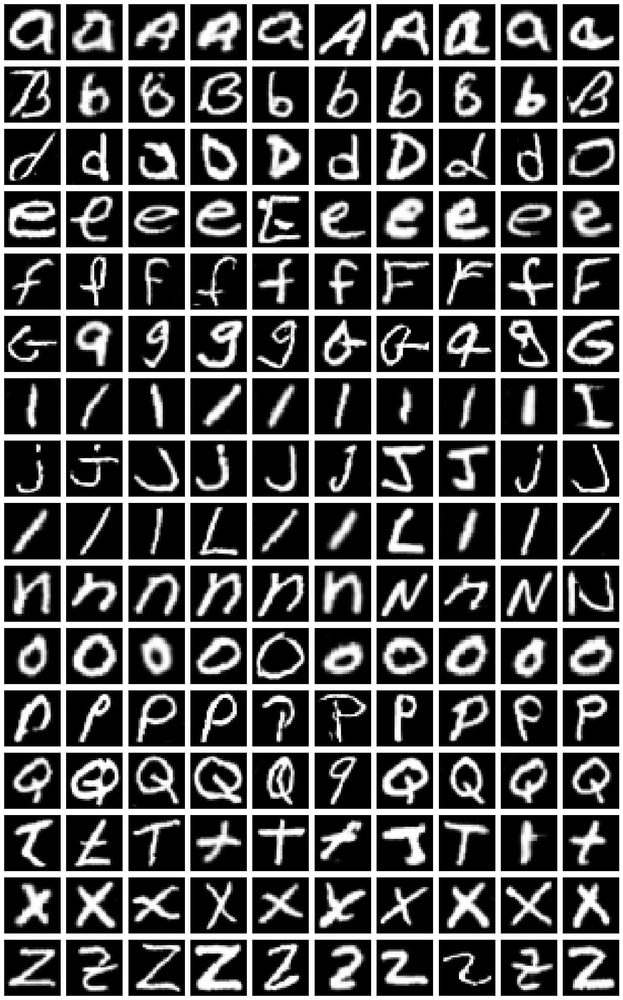

Model 7 Final weights saved.


In [274]:
@tf.function
def train_step(real_imgs, real_labels):
    batch_size = tf.shape(real_imgs)[0]
    valid = tf.ones((batch_size, 1))
    fake = tf.zeros((batch_size, 1))

    # Generate fake images
    noise = tf.random.normal((batch_size, latent_dim))
    gen_labels = tf.random.uniform((batch_size, 1), 0, num_classes, dtype=tf.int32)
    fake_imgs = generator([noise, gen_labels], training=True)

    # --- Discriminator training ---
    with tf.GradientTape() as tape:
        d_real = discriminator([real_imgs, tf.expand_dims(real_labels, 1)], training=True)
        d_fake = discriminator([fake_imgs, gen_labels], training=True)
        d_loss = 0.5 * (bce(valid, d_real) + bce(fake, d_fake))
    d_grads = tape.gradient(d_loss, discriminator.trainable_variables)
    d_opt.apply_gradients(zip(d_grads, discriminator.trainable_variables))

    # Calculate accuracy
    real_acc = tf.reduce_mean(tf.cast(d_real > 0.5, tf.float32))
    fake_acc = tf.reduce_mean(tf.cast(d_fake < 0.5, tf.float32))
    d_acc = 0.5 * (real_acc + fake_acc)

    # --- Generator training ---
    noise = tf.random.normal((batch_size, latent_dim))
    gen_labels = tf.random.uniform((batch_size, 1), 0, num_classes, dtype=tf.int32)
    with tf.GradientTape() as tape:
        gen_imgs = generator([noise, gen_labels], training=True)
        validity = discriminator([gen_imgs, gen_labels], training=True)
        g_loss = bce(valid, validity)
    g_grads = tape.gradient(g_loss, generator.trainable_variables)
    g_opt.apply_gradients(zip(g_grads, generator.trainable_variables))

    return d_loss, g_loss, d_acc


def generate_and_show_images(model, num_per_class=10):
    all_images = []
    for label in range(num_classes):
        noise = tf.random.normal((num_per_class, latent_dim))
        labels = tf.constant([label]*num_per_class, shape=(num_per_class,1), dtype=tf.int32)
        gen_imgs = model([noise, labels], training=False)
        gen_imgs = 0.5 * gen_imgs + 0.5
        all_images.append(gen_imgs.numpy())
    all_images = np.concatenate(all_images, axis=0)
    fig, axes = plt.subplots(num_classes, num_per_class, figsize=(num_per_class*1.5, num_classes*1.5))
    for i in range(num_classes*num_per_class):
        row = i // num_per_class
        col = i % num_per_class
        ax = axes[row, col] if num_classes > 1 else axes[col]
        ax.imshow(all_images[i, :, :, 0], cmap='gray')
        ax.axis('off')
        if col == 0:
            ax.set_ylabel(chr(ord('A') + row), fontsize=12)
    plt.tight_layout()
    plt.show()


d_losses = []
g_losses = []
d_accuracies = []  # <-- NEW
best_g_loss = float('inf')

for epoch in range(1, epochs + 1):
    for real_imgs, real_labels in dataset:
        d_loss, g_loss, d_acc = train_step(real_imgs, real_labels)

    d_losses.append(d_loss.numpy())
    g_losses.append(g_loss.numpy())
    d_accuracies.append(d_acc.numpy())  # <-- store accuracy

    print(f"Epoch {epoch} | D Loss: {d_loss:.4f} | G Loss: {g_loss:.4f} | D Acc: {d_acc:.4f}")

    if g_loss < best_g_loss:
        best_g_loss = g_loss
        generator.save_weights("Model7_best_generator.h5")
        print(f"Best generator saved at epoch {epoch}")

    if epoch % 10 == 0:
        print(f"Preview images at epoch {epoch}:")
        generate_and_show_images(generator)

# Save final models
generator.save_weights("Model7_final_generator.h5")
discriminator.save_weights("Model7_final_discriminator.h5")
print("Model 7 Final weights saved.")


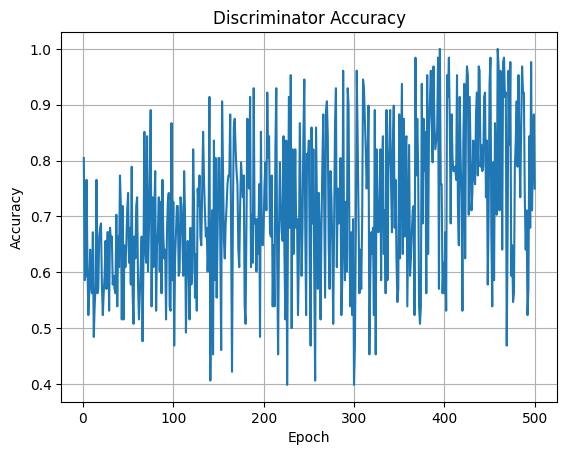

In [275]:
import matplotlib.pyplot as plt

plt.plot(range(1, epochs+1), d_accuracies)
plt.title("Discriminator Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.grid(True)
plt.show()


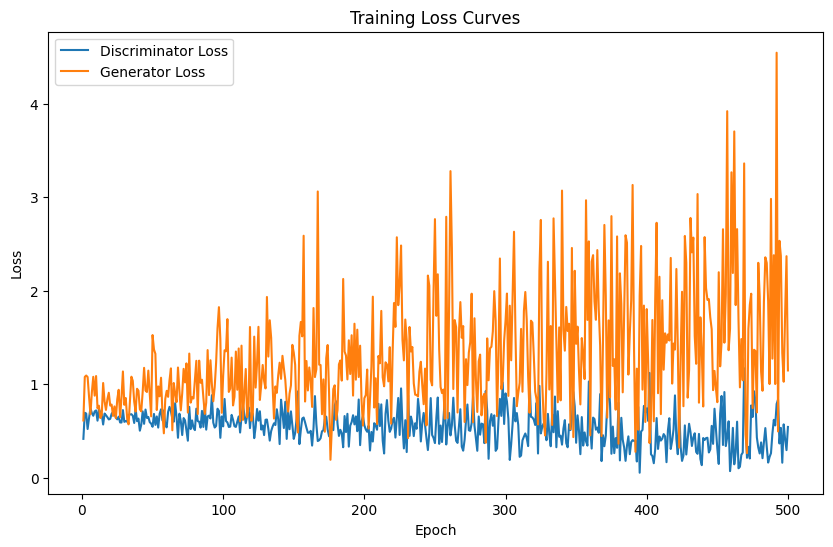

In [314]:

plt.figure(figsize=(10,6))
plt.plot(range(1, epochs+1), d_losses, label='Discriminator Loss')
plt.plot(range(1, epochs+1), g_losses, label='Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Curves')
plt.legend()
plt.show()


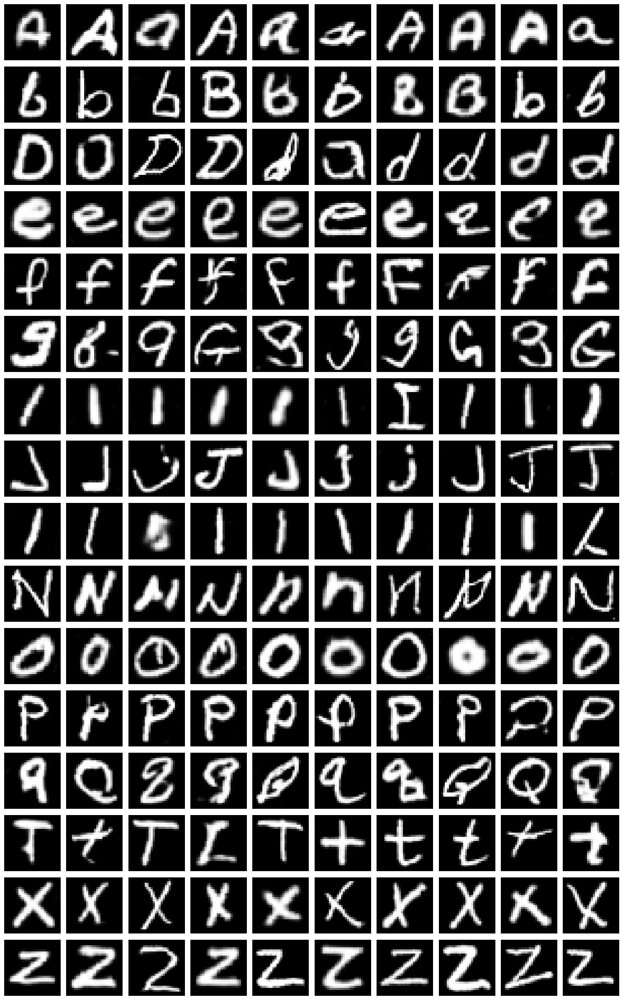

Saved image grid to Model6_improved_generated_images\Model7_160_bestweights_improved_grid.png


In [276]:
generate_and_save_images(generator,  filename_prefix="Model7_160_bestweights_improved")


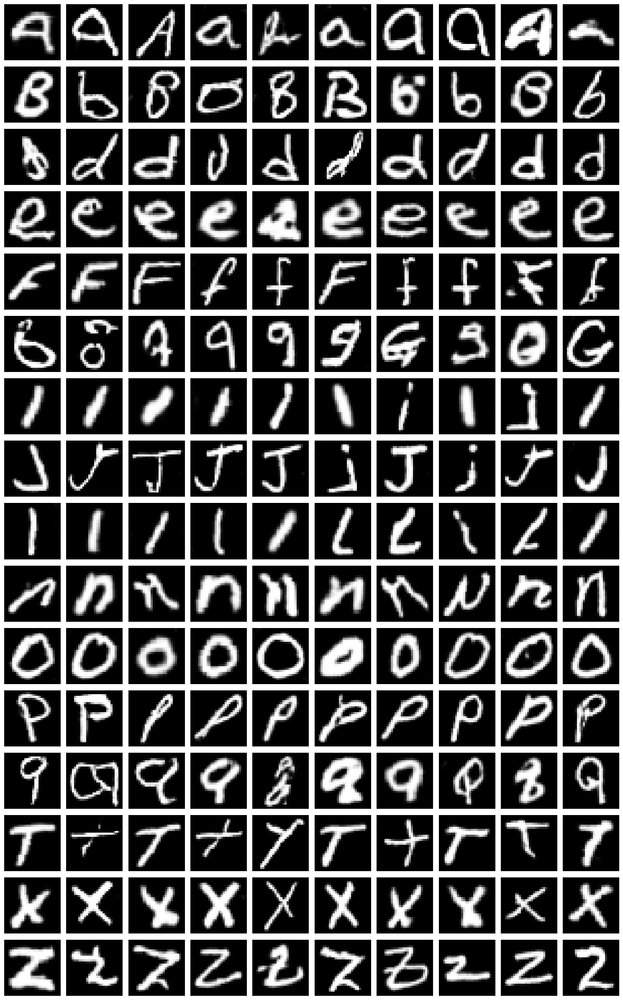

Saved image grid to Model6_improved_generated_images\(2)Model7_160_bestweights_improved_grid.png


In [320]:
generator.load_weights("Model7_best_generator.h5")


generate_and_save_images(generator,  filename_prefix="(2)Model7_160_bestweights_improved")


Word 'DEEP LEANING' from best weights:


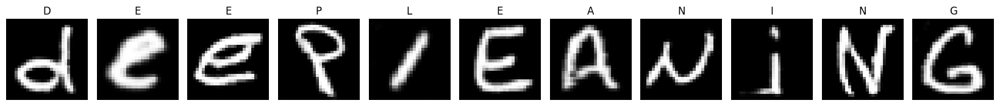

In [291]:
generator.load_weights("Model7_best_generator.h5")

print("Word 'DEEP LEANING' from best weights:")
generate_word(generator, "DEEP LEANING")



Preview from final weights:


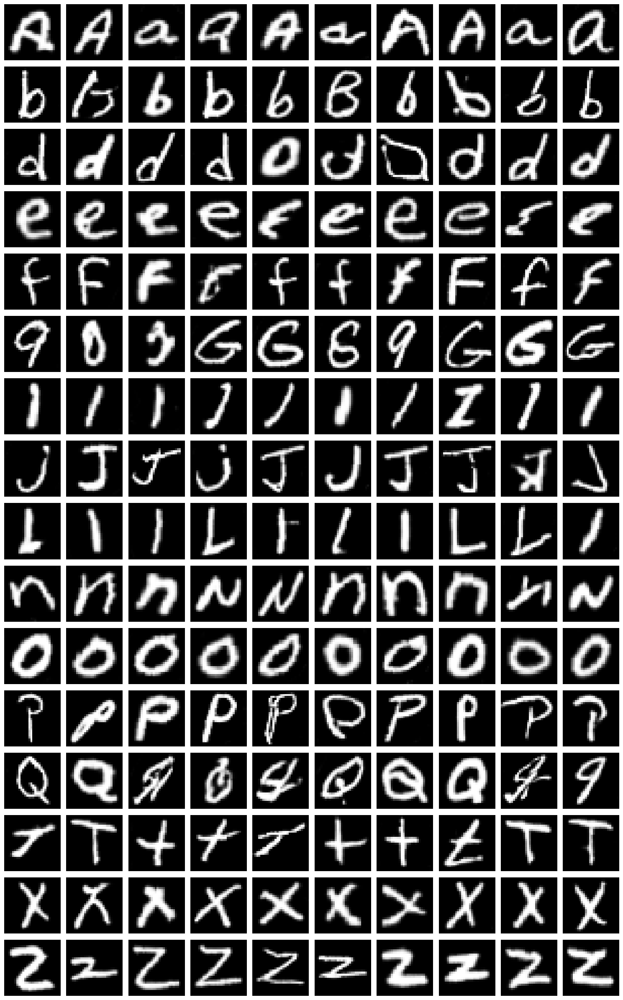

Saved image grid to Model6_improved_generated_images\Model7_160_finalweights_improved_grid.png


In [277]:

# Preview from best weights
print("Preview from final weights:")
generator.load_weights("Model7_final_generator.h5")
generate_and_save_images(generator,  filename_prefix="Model7_160_finalweights_improved")


Preview from final weights:


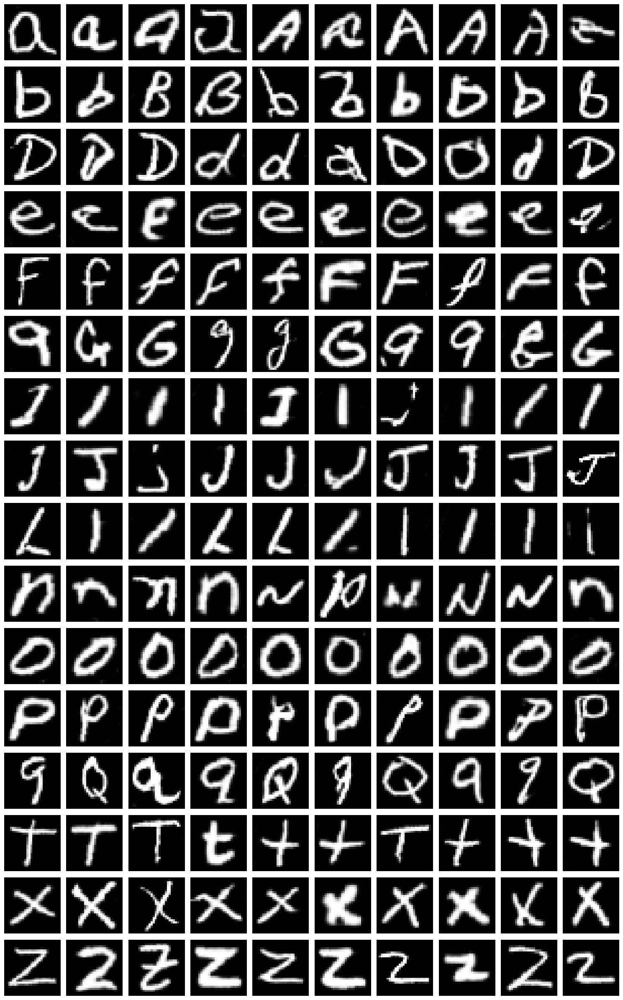

Saved image grid to Model6_improved_generated_images\(2)Model7_160_finalweights_improved_grid.png


In [316]:

# Preview from best weights
print("Preview from final weights:")
generator.load_weights("Model7_final_generator.h5")
generate_and_save_images(generator,  filename_prefix="(2)Model7_160_finalweights_improved")


Word 'DEEP LEANING' from finals weights:


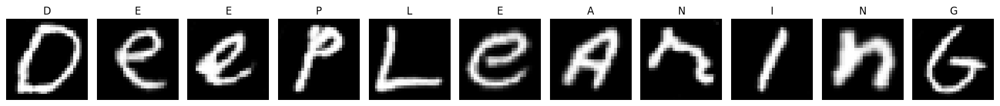

In [282]:
generator.load_weights("Model7_final_generator.h5")

print("Word 'DEEP LEANING' from finals weights:")
generate_word(generator, "DEEP LEANING")



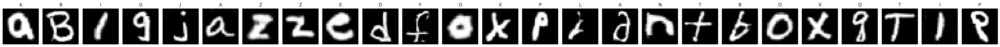

In [294]:
generator.load_weights("Model7_best_generator.h5")

generate_word(generator, "A BIG JAZZED FOX PLANT BOX QTIP")     # Best weights


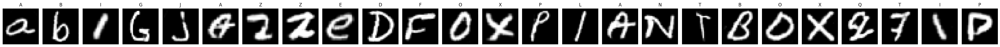

In [295]:

generator.load_weights("Model7_final_generator.h5")

generate_word(generator, "A BIG JAZZED FOX PLANT BOX QTIP")     # Final weights



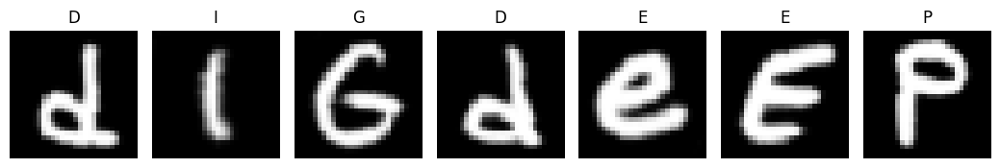

In [309]:
generator.load_weights("Model7_best_generator.h5")


generate_word(generator, "Dig Deep")     # Best weights


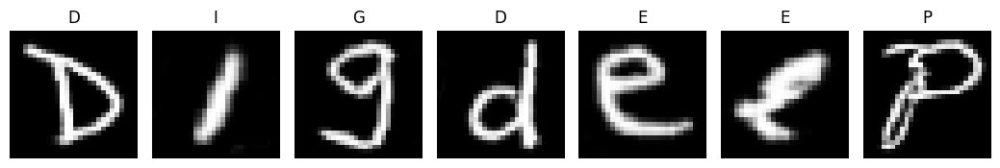

In [297]:
generator.load_weights("Model7_final_generator.h5")

generate_word(generator, "Dig Deep")     



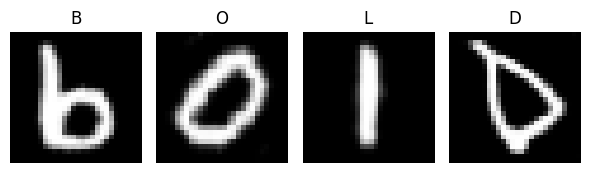

In [310]:
generator.load_weights("Model7_best_generator.h5")

generate_word(generator, "Bold")     # Best weights



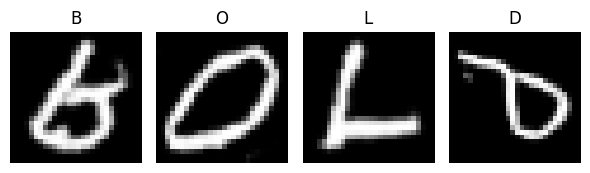

In [313]:
generator.load_weights("Model7_final_generator.h5")

generate_word(generator, "Bold")     # Final weights

### What the Curves Show 

**Observation from the plots**
- **Discriminator accuracy** drifts upward and spends long stretches **>0.8–1.0** in late epochs.
- **Generator loss** (orange) **explodes over time**, while **D loss** (blue) stays **low and flat**.

**Interpretation**
- It made the discriminator **too strong**.
- D quickly learns to separate real vs. fake, so it produces **confident predictions** (high accuracy, low loss).


**Actionable fixes**
- **Weaken D**: remove **Conv Block 3** or reduce it (e.g., 256→128), and/or drop BN in D.
- **Optimizer balance**: use a **lower D LR** (e.g., `d_lr = 1e-4` vs. `g_lr = 2e-4`)




<a id="imp2"></a>
# Model Improvement 2


## CDCGAN Architecture Comparison

### **Generator Differences**

| Aspect | `improv_build_cdcgan_generator` | `improved_cdcgan_generator` |
|--------|---------------------------------|------------------------------|
| **Initial flow** | Noise ⊙ label embedding → Dense (7×7×256) → BN + LeakyReLU → Reshape (7×7×256) | Same start |
| **Extra refine layer** | No refine layer before upsampling |  Adds `Conv2DTranspose(256, stride=1)` at 7×7 before first upsample |
| **Upsampling stack** | 128 filters (↑14×14) → 64 filters (↑28×28) | 256 (stride=1 refine) → 128 (↑14×14) → 64 (↑28×28) |
| **Impact** | Lighter, faster training, less GPU memory usage | Higher capacity for feature refinement → potentially sharper images, but heavier computation |

---

### **Discriminator Differences**

| Aspect | First Version (with Conv block 3) | Second Version (no Conv block 3) |
|--------|-----------------------------------|----------------------------------|
| **Input handling** | Image + label embedding → concat along channels | Same |
| **Conv blocks** | Conv(64) → Conv(128) → **Conv(256)** (stride=1) → Flatten → Dense(1, sigmoid) | Conv(64) → Conv(128) → Flatten → Dense(1, sigmoid) |
| **Effect of block 3** | Stronger discriminator → better at spotting fine artifacts, but risk of overpowering generator | Weaker discriminator → easier gradient flow to generator, faster convergence, less overfitting risk |




In [186]:
from tensorflow.keras.layers import Input, Dense, Reshape, Flatten, Embedding, Multiply, LeakyReLU, BatchNormalization, Conv2DTranspose

def improved_cdcgan_generator(latent_dim=150, num_classes=16):
    noise = Input(shape=(latent_dim,))
    label = Input(shape=(1,), dtype='int32')

    # Embed label and multiply with noise
    label_embedding = Embedding(num_classes, latent_dim)(label)
    label_embedding = Flatten()(label_embedding)
    combined = Multiply()([noise, label_embedding])

    # Project and reshape
    x = Dense(7 * 7 * 256, use_bias=False)(combined)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)
    x = Reshape((7, 7, 256))(x)

    # Extra upsampling layer (14x14)
    x = Conv2DTranspose(256, 4, strides=1, padding='same', use_bias=False)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)

    # Upsample to 14x14
    x = Conv2DTranspose(128, 4, strides=2, padding='same', use_bias=False)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)

    # Upsample to 28x28
    x = Conv2DTranspose(64, 4, strides=2, padding='same', use_bias=False)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)

    # Output layer
    output_img = tf.keras.layers.Conv2D(1, kernel_size=3, padding='same', activation='tanh')(x)

    return tf.keras.Model([noise, label], output_img)

In [185]:
def improv_build_cdcgan_discriminator():
    img = tf.keras.Input(shape=image_shape)
    label = tf.keras.Input(shape=(1,), dtype='int32')

    # Embed and reshape label
    label_embedding = tf.keras.layers.Embedding(num_classes, np.prod(image_shape))(label)
    label_embedding = tf.keras.layers.Flatten()(label_embedding)
    label_embedding = tf.keras.layers.Reshape(image_shape)(label_embedding)

    # Concatenate image and label
    combined = tf.keras.layers.Concatenate(axis=-1)([img, label_embedding])  # (28, 28, 2)

    # Conv block 1
    x = tf.keras.layers.Conv2D(64, 4, strides=2, padding='same')(combined)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    # Conv block 2
    x = tf.keras.layers.Conv2D(128, 4, strides=2, padding='same')(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)
    x = tf.keras.layers.Dropout(0.3)(x)

    # Final classification (removed Conv block 3)
    x = tf.keras.layers.Flatten()(x)
    output = tf.keras.layers.Dense(1, activation='sigmoid')(x)

    return tf.keras.Model([img, label], output)


In [187]:
image_shape = (28,28,1)
latent_dim = 150
generator = improved_cdcgan_generator()
discriminator = improv_build_cdcgan_discriminator()
bce = tf.keras.losses.BinaryCrossentropy()
g_opt = tf.keras.optimizers.Adam(0.0002, 0.5)
d_opt = tf.keras.optimizers.Adam(0.0002, 0.5)

generator.summary()
discriminator.summary()


Model: "model_21"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_66 (InputLayer)          [(None, 1)]          0           []                               
                                                                                                  
 embedding_32 (Embedding)       (None, 1, 150)       2400        ['input_66[0][0]']               
                                                                                                  
 input_65 (InputLayer)          [(None, 150)]        0           []                               
                                                                                                  
 flatten_36 (Flatten)           (None, 150)          0           ['embedding_32[0][0]']           
                                                                                           

Epoch 1 | D Loss: 0.4961 | G Loss: 1.4190 | D Acc: 0.7500
Best generator saved at epoch 1
Epoch 2 | D Loss: 0.5666 | G Loss: 1.1728 | D Acc: 0.7109
Best generator saved at epoch 2
Epoch 3 | D Loss: 0.6412 | G Loss: 1.0246 | D Acc: 0.5938
Best generator saved at epoch 3
Epoch 4 | D Loss: 0.7107 | G Loss: 0.7546 | D Acc: 0.5469
Best generator saved at epoch 4
Epoch 5 | D Loss: 0.6786 | G Loss: 0.6811 | D Acc: 0.5547
Best generator saved at epoch 5
Epoch 6 | D Loss: 0.6944 | G Loss: 0.7046 | D Acc: 0.5234
Epoch 7 | D Loss: 0.6824 | G Loss: 0.8438 | D Acc: 0.5547
Epoch 8 | D Loss: 0.6917 | G Loss: 0.6621 | D Acc: 0.5469
Best generator saved at epoch 8
Epoch 9 | D Loss: 0.6994 | G Loss: 0.8822 | D Acc: 0.5469
Epoch 10 | D Loss: 0.7194 | G Loss: 0.7163 | D Acc: 0.4609
Preview images at epoch 10:


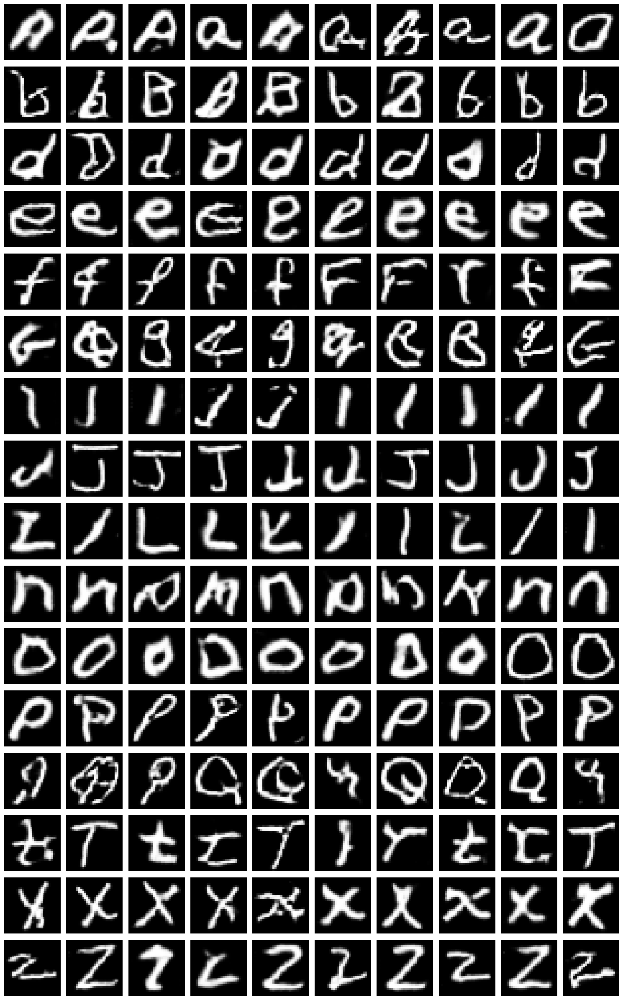

Epoch 11 | D Loss: 0.7036 | G Loss: 0.7001 | D Acc: 0.5391
Epoch 12 | D Loss: 0.7209 | G Loss: 0.6702 | D Acc: 0.5078
Epoch 13 | D Loss: 0.6907 | G Loss: 0.6608 | D Acc: 0.5625
Best generator saved at epoch 13
Epoch 14 | D Loss: 0.7073 | G Loss: 0.6975 | D Acc: 0.5234
Epoch 15 | D Loss: 0.6615 | G Loss: 0.6619 | D Acc: 0.5859
Epoch 16 | D Loss: 0.7107 | G Loss: 0.7269 | D Acc: 0.5156
Epoch 17 | D Loss: 0.7026 | G Loss: 0.8034 | D Acc: 0.4844
Epoch 18 | D Loss: 0.6930 | G Loss: 0.7441 | D Acc: 0.5547
Epoch 19 | D Loss: 0.7066 | G Loss: 0.7029 | D Acc: 0.4766
Epoch 20 | D Loss: 0.6950 | G Loss: 0.7563 | D Acc: 0.5078
Preview images at epoch 20:


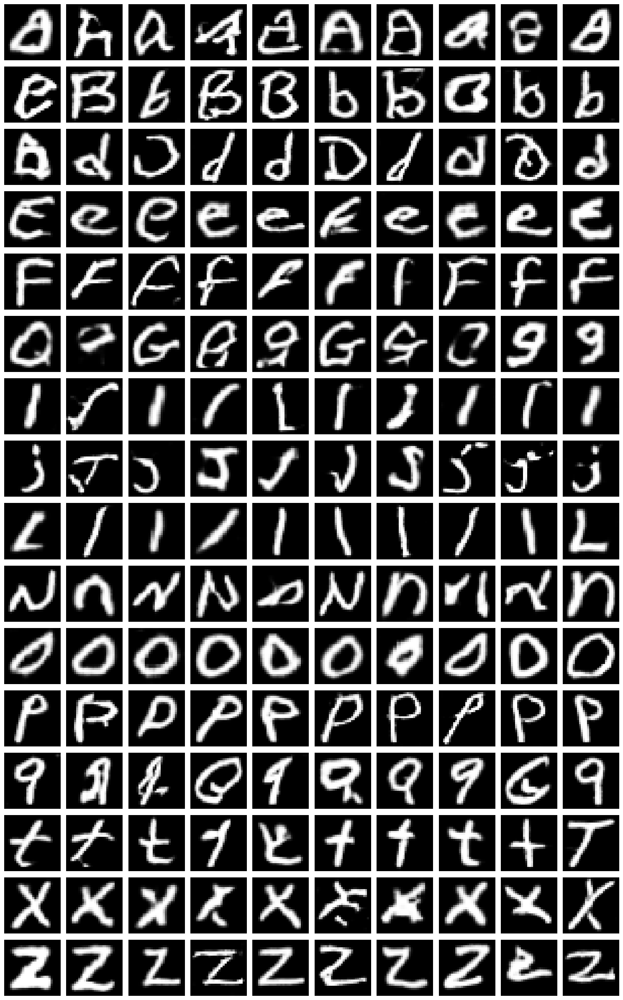

Epoch 21 | D Loss: 0.6966 | G Loss: 0.7494 | D Acc: 0.5625
Epoch 22 | D Loss: 0.6890 | G Loss: 0.6413 | D Acc: 0.6172
Best generator saved at epoch 22
Epoch 23 | D Loss: 0.6837 | G Loss: 0.7097 | D Acc: 0.5469
Epoch 24 | D Loss: 0.6665 | G Loss: 0.6697 | D Acc: 0.6172
Epoch 25 | D Loss: 0.6768 | G Loss: 0.6619 | D Acc: 0.5469
Epoch 26 | D Loss: 0.6963 | G Loss: 0.7726 | D Acc: 0.5391
Epoch 27 | D Loss: 0.7121 | G Loss: 0.7279 | D Acc: 0.4609
Epoch 28 | D Loss: 0.6914 | G Loss: 0.7422 | D Acc: 0.5547
Epoch 29 | D Loss: 0.6936 | G Loss: 0.7841 | D Acc: 0.5234
Epoch 30 | D Loss: 0.6951 | G Loss: 0.7960 | D Acc: 0.5312
Preview images at epoch 30:


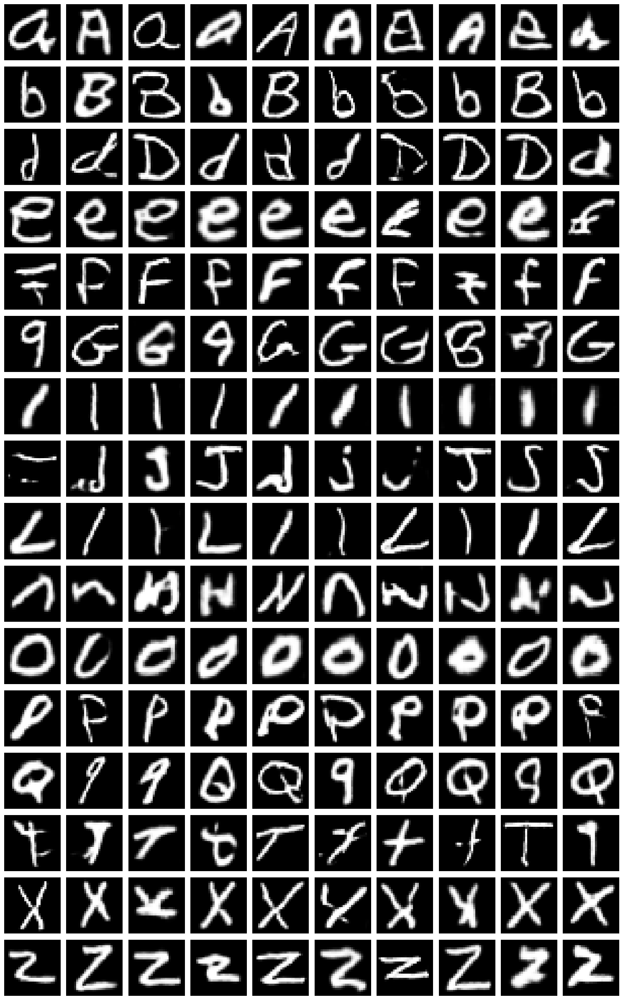

Epoch 31 | D Loss: 0.7353 | G Loss: 0.7317 | D Acc: 0.3984
Epoch 32 | D Loss: 0.6922 | G Loss: 0.7037 | D Acc: 0.5234
Epoch 33 | D Loss: 0.6872 | G Loss: 0.7380 | D Acc: 0.5781
Epoch 34 | D Loss: 0.6843 | G Loss: 0.7695 | D Acc: 0.5469
Epoch 35 | D Loss: 0.6902 | G Loss: 0.7130 | D Acc: 0.5625
Epoch 36 | D Loss: 0.6744 | G Loss: 0.7501 | D Acc: 0.5625
Epoch 37 | D Loss: 0.7158 | G Loss: 0.7984 | D Acc: 0.4609
Epoch 38 | D Loss: 0.6626 | G Loss: 0.7885 | D Acc: 0.6016
Epoch 39 | D Loss: 0.6863 | G Loss: 0.6881 | D Acc: 0.5625
Epoch 40 | D Loss: 0.6824 | G Loss: 0.7775 | D Acc: 0.5703
Preview images at epoch 40:


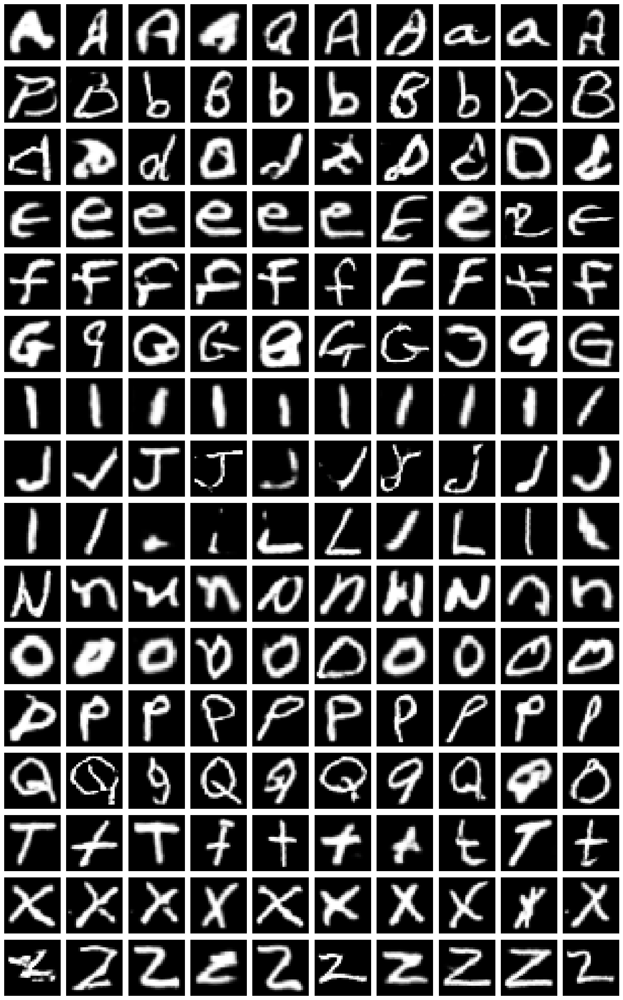

Epoch 41 | D Loss: 0.7053 | G Loss: 0.7019 | D Acc: 0.5078
Epoch 42 | D Loss: 0.6886 | G Loss: 0.7242 | D Acc: 0.5391
Epoch 43 | D Loss: 0.6900 | G Loss: 0.7323 | D Acc: 0.5312
Epoch 44 | D Loss: 0.6962 | G Loss: 0.7624 | D Acc: 0.5156
Epoch 45 | D Loss: 0.6882 | G Loss: 0.8146 | D Acc: 0.5391
Epoch 46 | D Loss: 0.6944 | G Loss: 0.7237 | D Acc: 0.4922
Epoch 47 | D Loss: 0.7069 | G Loss: 0.6897 | D Acc: 0.5547
Epoch 48 | D Loss: 0.6519 | G Loss: 0.7645 | D Acc: 0.6484
Epoch 49 | D Loss: 0.6663 | G Loss: 0.7476 | D Acc: 0.5703
Epoch 50 | D Loss: 0.7088 | G Loss: 0.7071 | D Acc: 0.4844
Preview images at epoch 50:


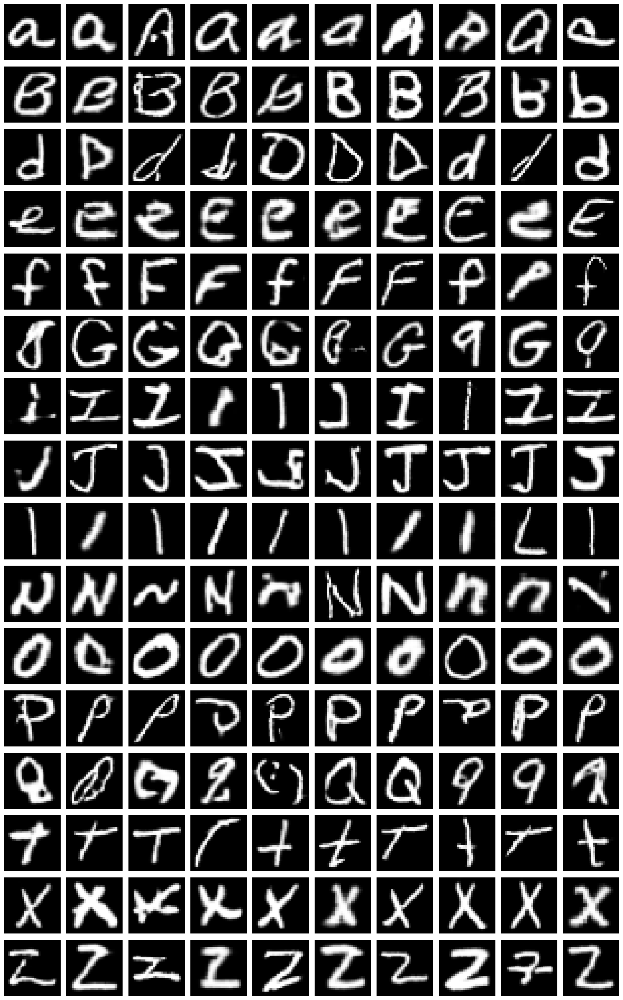

Epoch 51 | D Loss: 0.6679 | G Loss: 0.8110 | D Acc: 0.5781
Epoch 52 | D Loss: 0.6776 | G Loss: 0.6342 | D Acc: 0.5781
Best generator saved at epoch 52
Epoch 53 | D Loss: 0.6876 | G Loss: 0.7010 | D Acc: 0.5469
Epoch 54 | D Loss: 0.6863 | G Loss: 0.7783 | D Acc: 0.5781
Epoch 55 | D Loss: 0.6741 | G Loss: 0.7502 | D Acc: 0.5312
Epoch 56 | D Loss: 0.6955 | G Loss: 0.6520 | D Acc: 0.5469
Epoch 57 | D Loss: 0.6990 | G Loss: 0.7055 | D Acc: 0.5234
Epoch 58 | D Loss: 0.6538 | G Loss: 0.7430 | D Acc: 0.6406
Epoch 59 | D Loss: 0.7065 | G Loss: 0.6989 | D Acc: 0.4688
Epoch 60 | D Loss: 0.6245 | G Loss: 0.7159 | D Acc: 0.7266
Preview images at epoch 60:


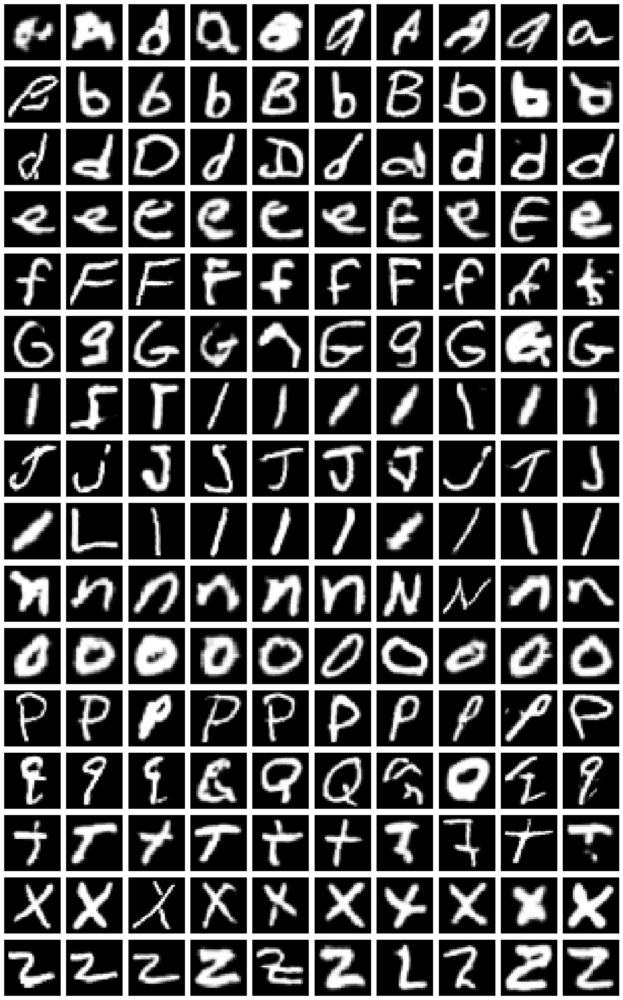

Epoch 61 | D Loss: 0.6592 | G Loss: 0.8028 | D Acc: 0.5859
Epoch 62 | D Loss: 0.6441 | G Loss: 0.6935 | D Acc: 0.6094
Epoch 63 | D Loss: 0.6657 | G Loss: 0.7510 | D Acc: 0.6172
Epoch 64 | D Loss: 0.6933 | G Loss: 0.6964 | D Acc: 0.5234
Epoch 65 | D Loss: 0.7319 | G Loss: 0.7086 | D Acc: 0.4141
Epoch 66 | D Loss: 0.6621 | G Loss: 0.7095 | D Acc: 0.6250
Epoch 67 | D Loss: 0.7129 | G Loss: 0.7843 | D Acc: 0.4453
Epoch 68 | D Loss: 0.6889 | G Loss: 0.7622 | D Acc: 0.5703
Epoch 69 | D Loss: 0.6916 | G Loss: 0.6486 | D Acc: 0.5391
Epoch 70 | D Loss: 0.6707 | G Loss: 0.7647 | D Acc: 0.5859
Preview images at epoch 70:


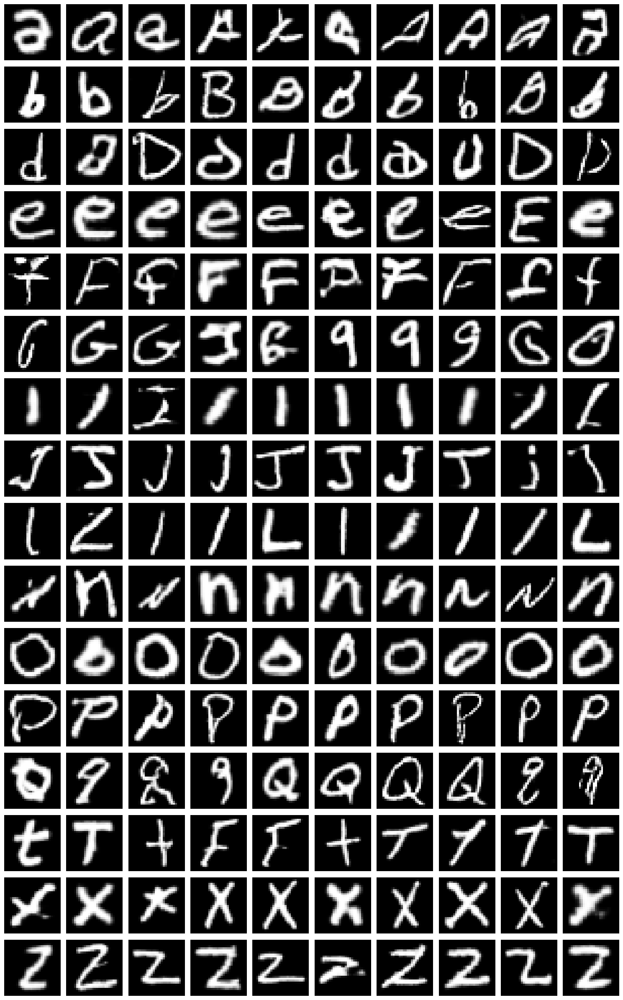

Epoch 71 | D Loss: 0.6996 | G Loss: 0.7691 | D Acc: 0.5156
Epoch 72 | D Loss: 0.6342 | G Loss: 0.7047 | D Acc: 0.6641
Epoch 73 | D Loss: 0.6557 | G Loss: 0.7331 | D Acc: 0.6172
Epoch 74 | D Loss: 0.6995 | G Loss: 0.7467 | D Acc: 0.5156
Epoch 75 | D Loss: 0.6961 | G Loss: 0.7529 | D Acc: 0.5000
Epoch 76 | D Loss: 0.6905 | G Loss: 0.7367 | D Acc: 0.5625
Epoch 77 | D Loss: 0.6564 | G Loss: 0.7310 | D Acc: 0.6172
Epoch 78 | D Loss: 0.7182 | G Loss: 0.7508 | D Acc: 0.4688
Epoch 79 | D Loss: 0.6933 | G Loss: 0.8144 | D Acc: 0.5391
Epoch 80 | D Loss: 0.7224 | G Loss: 0.7199 | D Acc: 0.5156
Preview images at epoch 80:


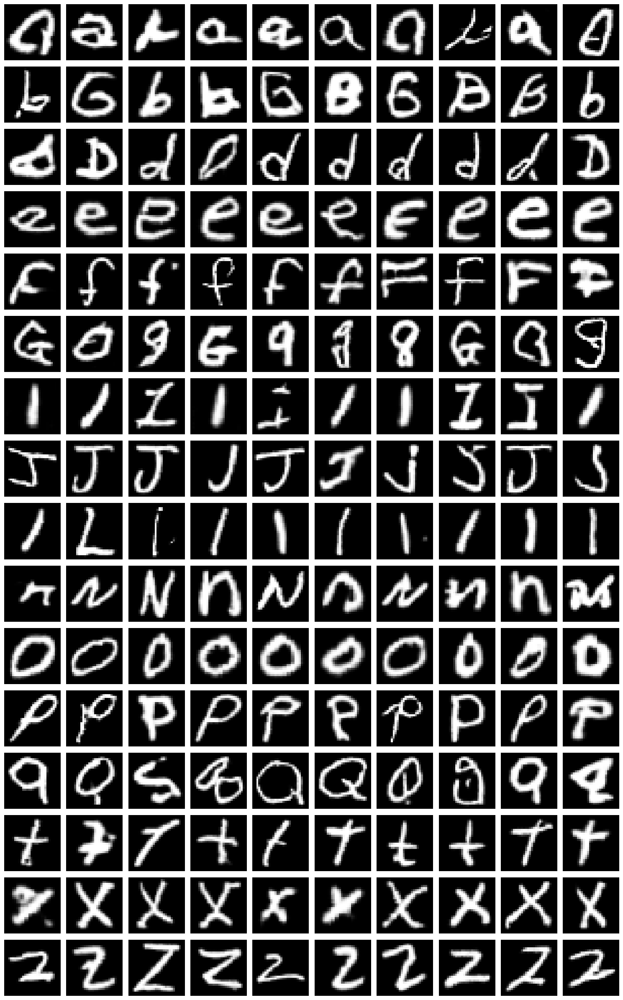

Epoch 81 | D Loss: 0.6875 | G Loss: 0.7130 | D Acc: 0.5391
Epoch 82 | D Loss: 0.6984 | G Loss: 0.7371 | D Acc: 0.5156
Epoch 83 | D Loss: 0.7156 | G Loss: 0.7578 | D Acc: 0.4766
Epoch 84 | D Loss: 0.7424 | G Loss: 0.6833 | D Acc: 0.3906
Epoch 85 | D Loss: 0.6461 | G Loss: 0.6756 | D Acc: 0.6406
Epoch 86 | D Loss: 0.6572 | G Loss: 0.8128 | D Acc: 0.6172
Epoch 87 | D Loss: 0.6517 | G Loss: 0.7509 | D Acc: 0.6250
Epoch 88 | D Loss: 0.6612 | G Loss: 0.6764 | D Acc: 0.6172
Epoch 89 | D Loss: 0.7323 | G Loss: 0.7862 | D Acc: 0.4609
Epoch 90 | D Loss: 0.6514 | G Loss: 0.7610 | D Acc: 0.6562
Preview images at epoch 90:


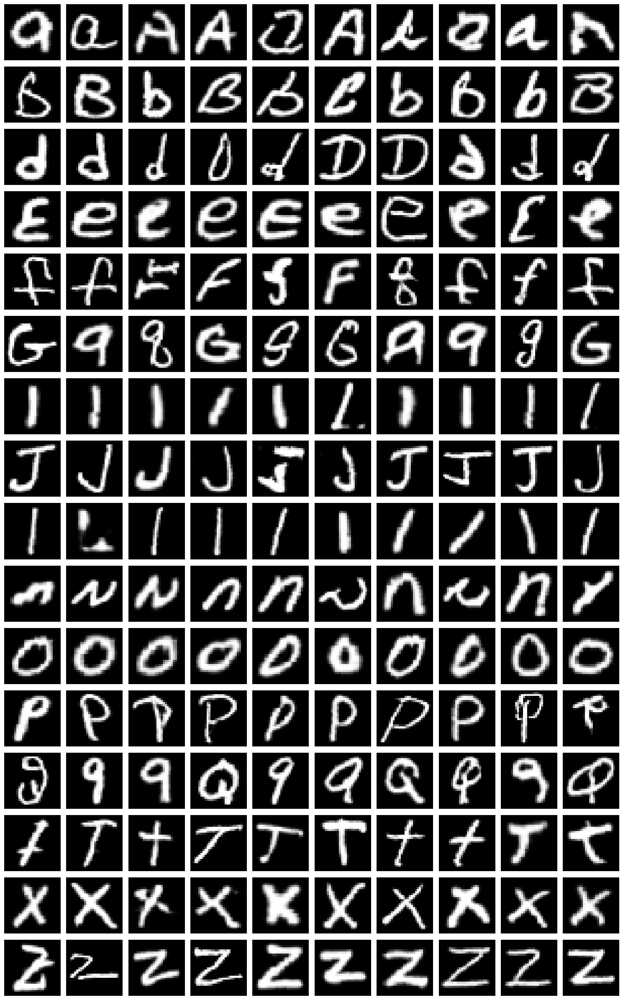

Epoch 91 | D Loss: 0.6928 | G Loss: 0.8077 | D Acc: 0.5312
Epoch 92 | D Loss: 0.6808 | G Loss: 0.7325 | D Acc: 0.5078
Epoch 93 | D Loss: 0.6673 | G Loss: 0.8390 | D Acc: 0.5156
Epoch 94 | D Loss: 0.6542 | G Loss: 0.7802 | D Acc: 0.5859
Epoch 95 | D Loss: 0.6962 | G Loss: 0.7244 | D Acc: 0.5391
Epoch 96 | D Loss: 0.6069 | G Loss: 0.7848 | D Acc: 0.6641
Epoch 97 | D Loss: 0.6193 | G Loss: 0.7452 | D Acc: 0.7031
Epoch 98 | D Loss: 0.6714 | G Loss: 0.7494 | D Acc: 0.6094
Epoch 99 | D Loss: 0.6595 | G Loss: 0.7701 | D Acc: 0.5859
Epoch 100 | D Loss: 0.6981 | G Loss: 0.7971 | D Acc: 0.5078
Preview images at epoch 100:


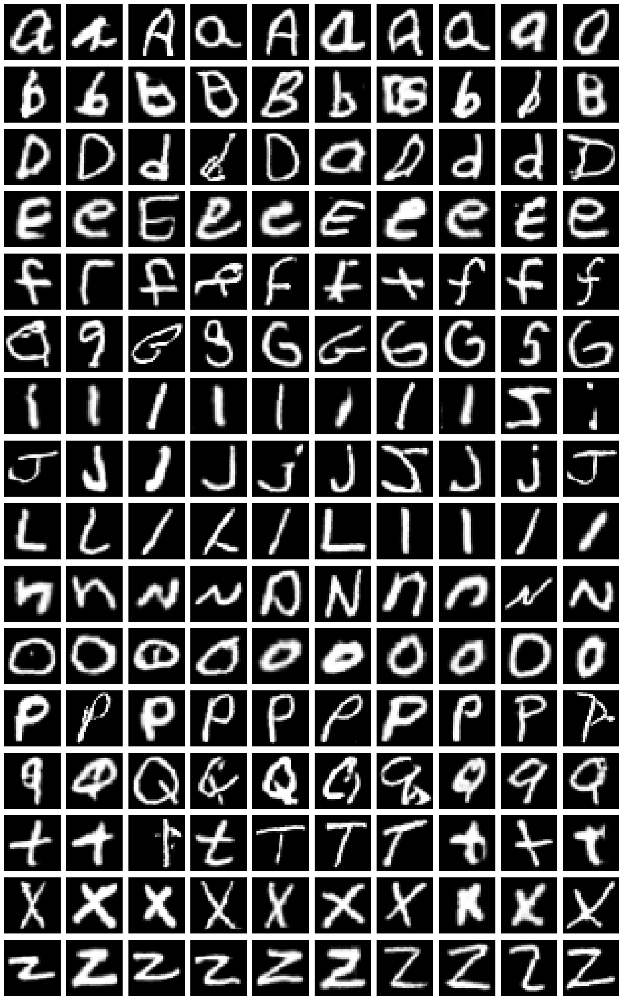

Epoch 101 | D Loss: 0.6619 | G Loss: 0.7915 | D Acc: 0.5547
Epoch 102 | D Loss: 0.6874 | G Loss: 0.7813 | D Acc: 0.5859
Epoch 103 | D Loss: 0.6276 | G Loss: 0.6508 | D Acc: 0.6641
Epoch 104 | D Loss: 0.6957 | G Loss: 0.9382 | D Acc: 0.5391
Epoch 105 | D Loss: 0.6619 | G Loss: 0.6796 | D Acc: 0.5859
Epoch 106 | D Loss: 0.6720 | G Loss: 0.7033 | D Acc: 0.5938
Epoch 107 | D Loss: 0.6584 | G Loss: 0.7443 | D Acc: 0.6094
Epoch 108 | D Loss: 0.6965 | G Loss: 0.7053 | D Acc: 0.5156
Epoch 109 | D Loss: 0.5807 | G Loss: 0.7430 | D Acc: 0.8203
Epoch 110 | D Loss: 0.6939 | G Loss: 0.8786 | D Acc: 0.5000
Preview images at epoch 110:


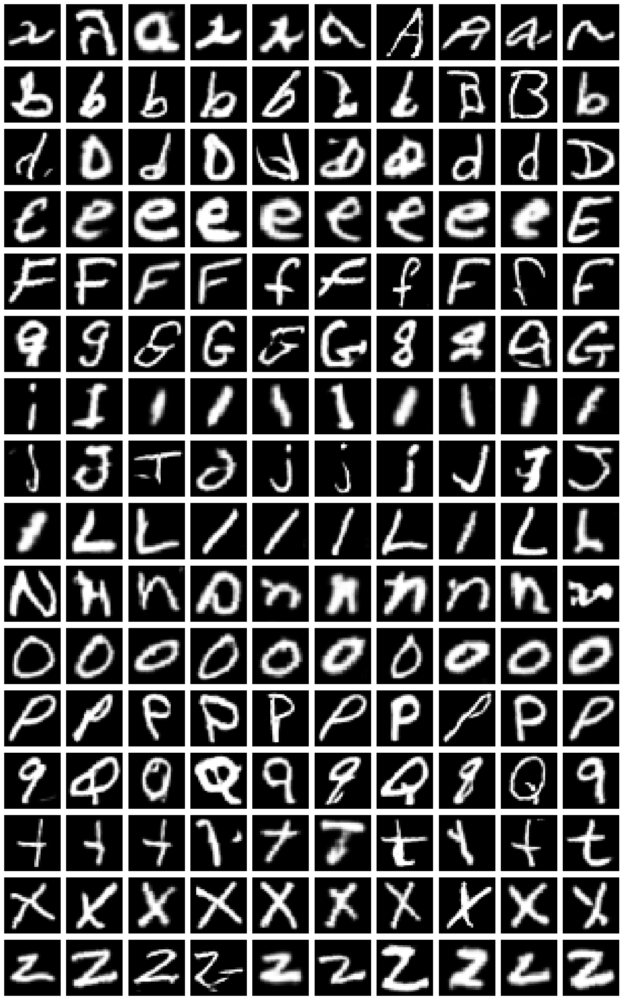

Epoch 111 | D Loss: 0.7070 | G Loss: 0.7179 | D Acc: 0.5312
Epoch 112 | D Loss: 0.6786 | G Loss: 0.6951 | D Acc: 0.5625
Epoch 113 | D Loss: 0.6369 | G Loss: 0.6855 | D Acc: 0.6406
Epoch 114 | D Loss: 0.6265 | G Loss: 0.6639 | D Acc: 0.6641
Epoch 115 | D Loss: 0.6694 | G Loss: 0.6870 | D Acc: 0.5625
Epoch 116 | D Loss: 0.6663 | G Loss: 0.8357 | D Acc: 0.6016
Epoch 117 | D Loss: 0.6881 | G Loss: 0.8658 | D Acc: 0.6094
Epoch 118 | D Loss: 0.6892 | G Loss: 0.8418 | D Acc: 0.5625
Epoch 119 | D Loss: 0.6872 | G Loss: 0.7675 | D Acc: 0.5938
Epoch 120 | D Loss: 0.6908 | G Loss: 0.8363 | D Acc: 0.4922
Preview images at epoch 120:


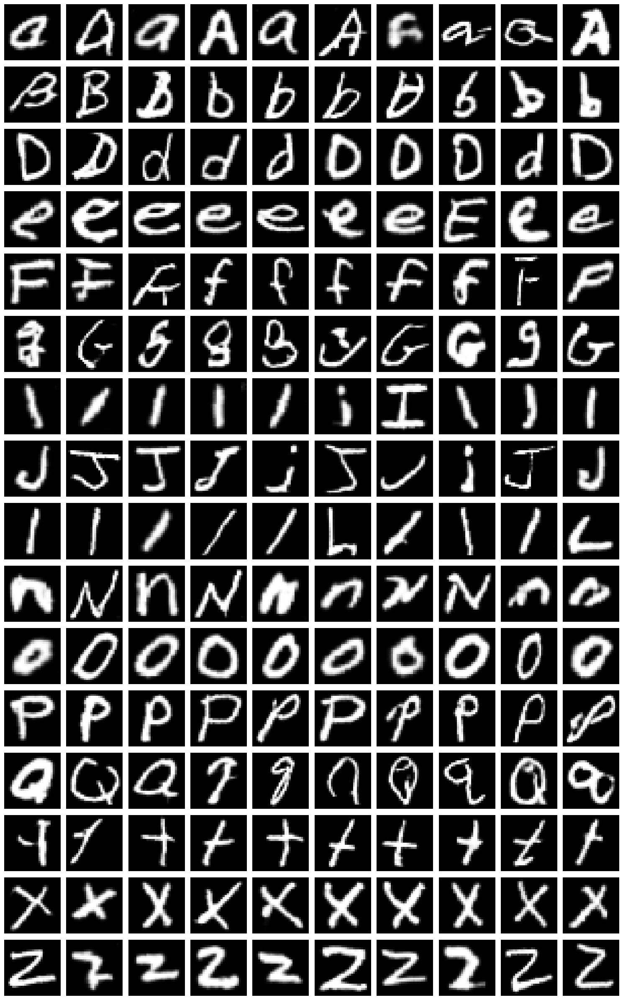

Epoch 121 | D Loss: 0.6911 | G Loss: 0.6604 | D Acc: 0.6406
Epoch 122 | D Loss: 0.6823 | G Loss: 0.8668 | D Acc: 0.5781
Epoch 123 | D Loss: 0.6005 | G Loss: 0.6667 | D Acc: 0.6953
Epoch 124 | D Loss: 0.6370 | G Loss: 0.9788 | D Acc: 0.6328
Epoch 125 | D Loss: 0.7130 | G Loss: 0.7878 | D Acc: 0.5312
Epoch 126 | D Loss: 0.6973 | G Loss: 0.8991 | D Acc: 0.5625
Epoch 127 | D Loss: 0.6696 | G Loss: 0.8843 | D Acc: 0.5859
Epoch 128 | D Loss: 0.7399 | G Loss: 0.9394 | D Acc: 0.5156
Epoch 129 | D Loss: 0.6857 | G Loss: 0.8060 | D Acc: 0.5391
Epoch 130 | D Loss: 0.6698 | G Loss: 0.8590 | D Acc: 0.5781
Preview images at epoch 130:


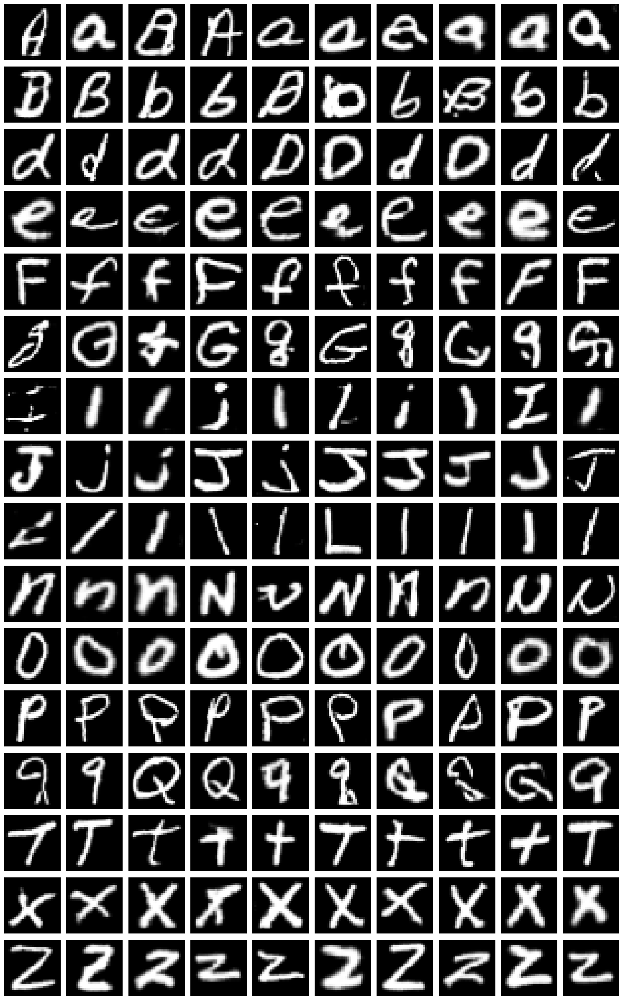

Epoch 131 | D Loss: 0.7058 | G Loss: 0.6453 | D Acc: 0.5234
Epoch 132 | D Loss: 0.6786 | G Loss: 0.7254 | D Acc: 0.5703
Epoch 133 | D Loss: 0.6359 | G Loss: 0.7903 | D Acc: 0.6641
Epoch 134 | D Loss: 0.7705 | G Loss: 0.6290 | D Acc: 0.4297
Best generator saved at epoch 134
Epoch 135 | D Loss: 0.6758 | G Loss: 0.7870 | D Acc: 0.5469
Epoch 136 | D Loss: 0.6208 | G Loss: 0.8319 | D Acc: 0.6562
Epoch 137 | D Loss: 0.6353 | G Loss: 0.7262 | D Acc: 0.6172
Epoch 138 | D Loss: 0.6641 | G Loss: 0.7888 | D Acc: 0.6016
Epoch 139 | D Loss: 0.5641 | G Loss: 1.0686 | D Acc: 0.7969
Epoch 140 | D Loss: 0.6483 | G Loss: 0.5956 | D Acc: 0.6562
Best generator saved at epoch 140
Preview images at epoch 140:


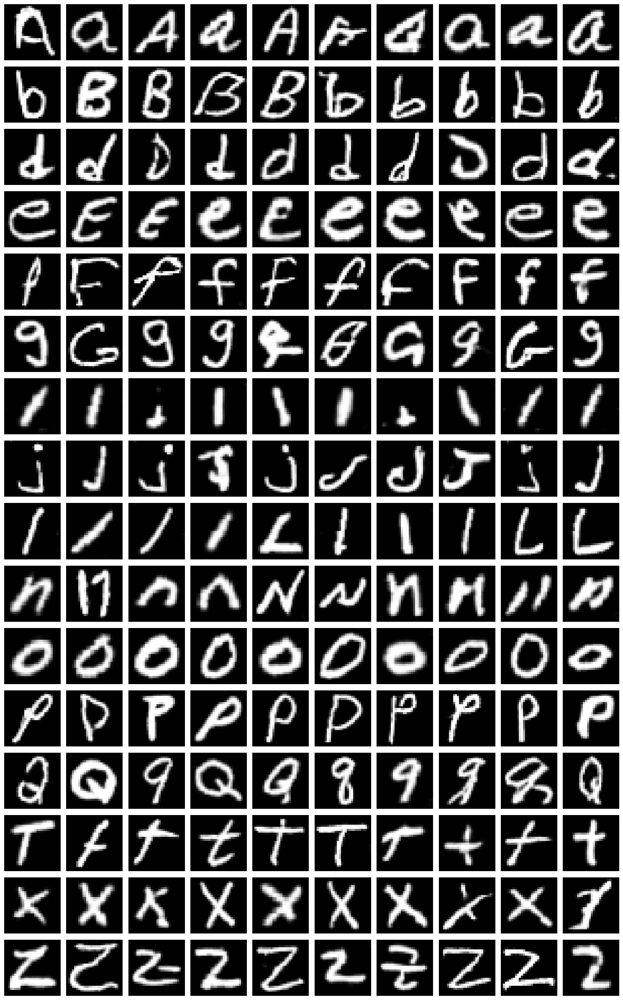

Epoch 141 | D Loss: 0.7408 | G Loss: 0.9435 | D Acc: 0.5078
Epoch 142 | D Loss: 0.6870 | G Loss: 0.7502 | D Acc: 0.5391
Epoch 143 | D Loss: 0.5805 | G Loss: 0.9174 | D Acc: 0.7031
Epoch 144 | D Loss: 0.6927 | G Loss: 0.8404 | D Acc: 0.5703
Epoch 145 | D Loss: 0.7170 | G Loss: 0.8653 | D Acc: 0.4922
Epoch 146 | D Loss: 0.7560 | G Loss: 0.9810 | D Acc: 0.4297
Epoch 147 | D Loss: 0.6014 | G Loss: 0.8632 | D Acc: 0.7266
Epoch 148 | D Loss: 0.6869 | G Loss: 0.5809 | D Acc: 0.5391
Best generator saved at epoch 148
Epoch 149 | D Loss: 0.6514 | G Loss: 0.8996 | D Acc: 0.5703
Epoch 150 | D Loss: 0.5469 | G Loss: 0.5588 | D Acc: 0.7500
Best generator saved at epoch 150
Preview images at epoch 150:


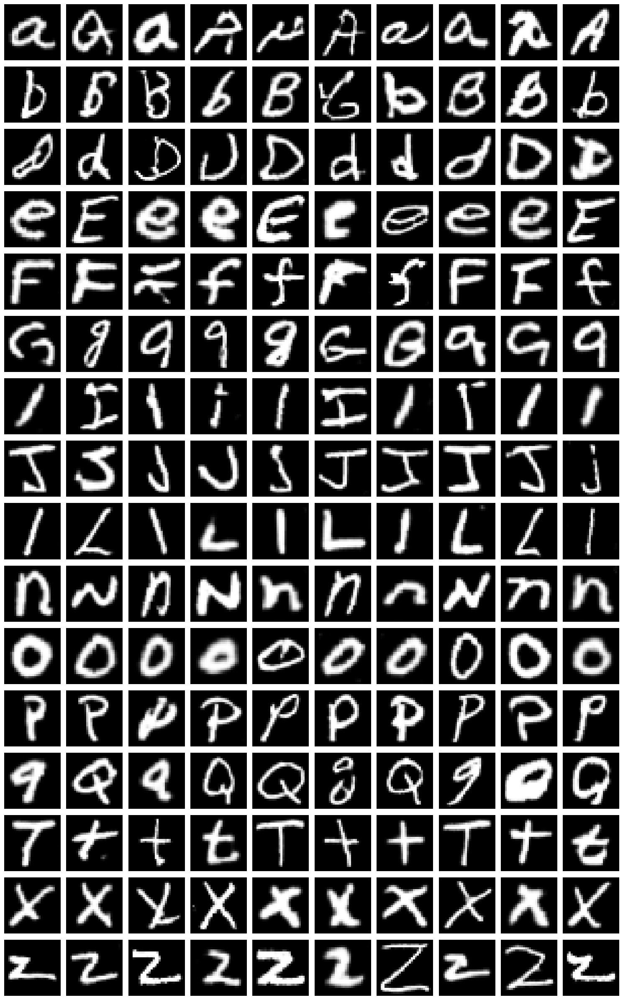

Epoch 151 | D Loss: 0.6546 | G Loss: 0.8319 | D Acc: 0.6016
Epoch 152 | D Loss: 0.6497 | G Loss: 0.7278 | D Acc: 0.6484
Epoch 153 | D Loss: 0.6114 | G Loss: 1.0099 | D Acc: 0.6641
Epoch 154 | D Loss: 0.6793 | G Loss: 1.0458 | D Acc: 0.5547
Epoch 155 | D Loss: 0.6970 | G Loss: 0.7352 | D Acc: 0.5000
Epoch 156 | D Loss: 0.7338 | G Loss: 0.8869 | D Acc: 0.5156
Epoch 157 | D Loss: 0.6872 | G Loss: 1.4366 | D Acc: 0.6172
Epoch 158 | D Loss: 0.5379 | G Loss: 0.9354 | D Acc: 0.7969
Epoch 159 | D Loss: 0.6019 | G Loss: 0.8797 | D Acc: 0.6953
Epoch 160 | D Loss: 0.5102 | G Loss: 1.1233 | D Acc: 0.8203
Preview images at epoch 160:


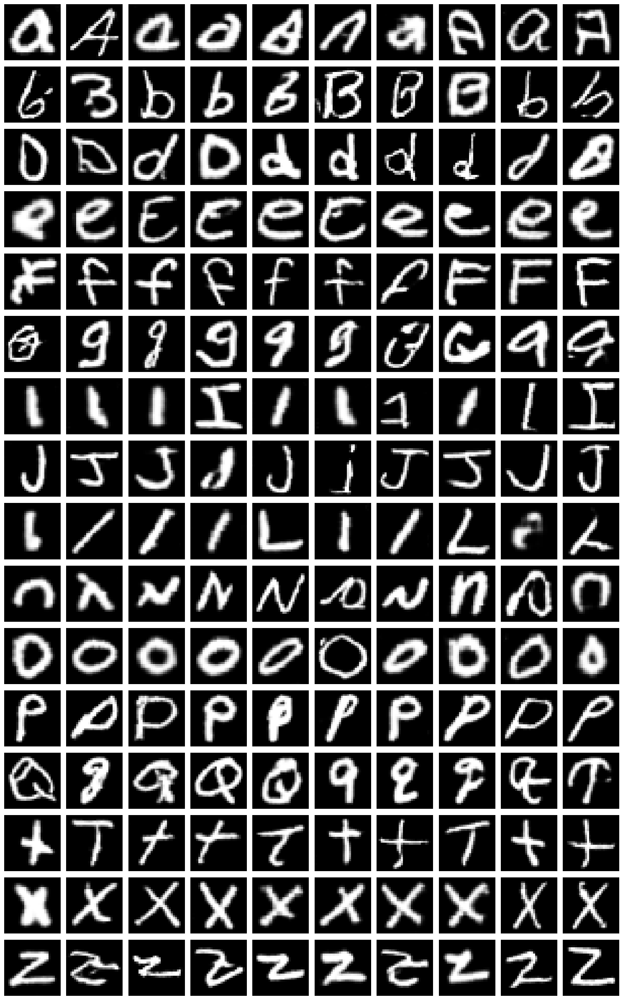

Epoch 161 | D Loss: 0.5641 | G Loss: 0.8290 | D Acc: 0.7578
Epoch 162 | D Loss: 0.7540 | G Loss: 0.5581 | D Acc: 0.5625
Best generator saved at epoch 162
Epoch 163 | D Loss: 0.6283 | G Loss: 0.8896 | D Acc: 0.6641
Epoch 164 | D Loss: 0.6874 | G Loss: 0.9109 | D Acc: 0.6094
Epoch 165 | D Loss: 0.7891 | G Loss: 0.9340 | D Acc: 0.4375
Epoch 166 | D Loss: 0.6326 | G Loss: 0.7048 | D Acc: 0.6250
Epoch 167 | D Loss: 0.5901 | G Loss: 1.1789 | D Acc: 0.7344
Epoch 168 | D Loss: 0.6164 | G Loss: 0.7960 | D Acc: 0.6094
Epoch 169 | D Loss: 0.5763 | G Loss: 1.1024 | D Acc: 0.7344
Epoch 170 | D Loss: 0.5492 | G Loss: 1.0769 | D Acc: 0.7422
Preview images at epoch 170:


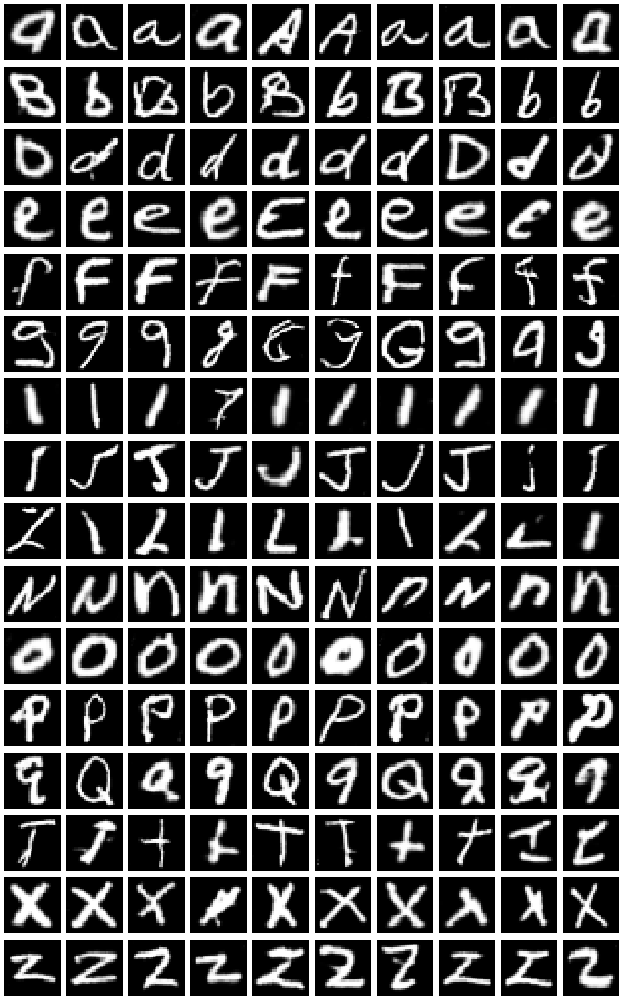

Epoch 171 | D Loss: 0.6992 | G Loss: 1.0136 | D Acc: 0.5469
Epoch 172 | D Loss: 0.6582 | G Loss: 1.0836 | D Acc: 0.6016
Epoch 173 | D Loss: 0.3775 | G Loss: 1.1944 | D Acc: 0.9453
Epoch 174 | D Loss: 0.6269 | G Loss: 0.8141 | D Acc: 0.6719
Epoch 175 | D Loss: 0.6027 | G Loss: 0.7613 | D Acc: 0.7266
Epoch 176 | D Loss: 0.7093 | G Loss: 0.6958 | D Acc: 0.5156
Epoch 177 | D Loss: 0.6163 | G Loss: 0.8016 | D Acc: 0.6484
Epoch 178 | D Loss: 0.7554 | G Loss: 0.8973 | D Acc: 0.4219
Epoch 179 | D Loss: 0.5224 | G Loss: 0.9665 | D Acc: 0.7422
Epoch 180 | D Loss: 0.5987 | G Loss: 1.1316 | D Acc: 0.7031
Preview images at epoch 180:


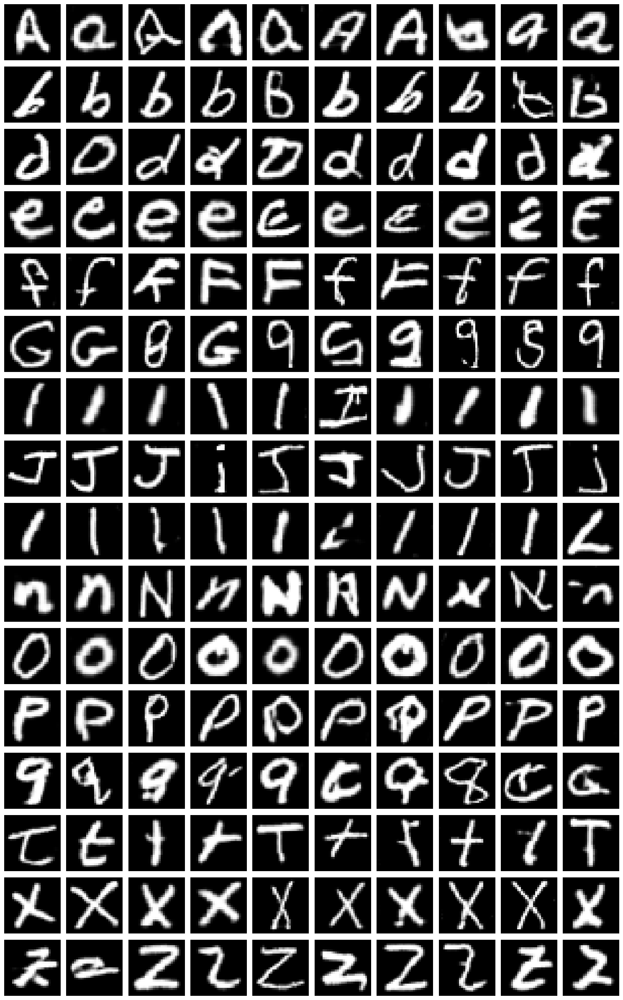

Epoch 181 | D Loss: 0.5905 | G Loss: 0.9060 | D Acc: 0.6641
Epoch 182 | D Loss: 0.6431 | G Loss: 1.2656 | D Acc: 0.6641
Epoch 183 | D Loss: 0.6538 | G Loss: 1.3687 | D Acc: 0.5469
Epoch 184 | D Loss: 0.7474 | G Loss: 1.6043 | D Acc: 0.5547
Epoch 185 | D Loss: 0.6585 | G Loss: 1.2386 | D Acc: 0.6250
Epoch 186 | D Loss: 0.5533 | G Loss: 0.8362 | D Acc: 0.7500
Epoch 187 | D Loss: 0.5254 | G Loss: 0.9156 | D Acc: 0.7812
Epoch 188 | D Loss: 0.7018 | G Loss: 0.8285 | D Acc: 0.5547
Epoch 189 | D Loss: 0.5227 | G Loss: 1.5454 | D Acc: 0.7734
Epoch 190 | D Loss: 0.6611 | G Loss: 0.7713 | D Acc: 0.6094
Preview images at epoch 190:


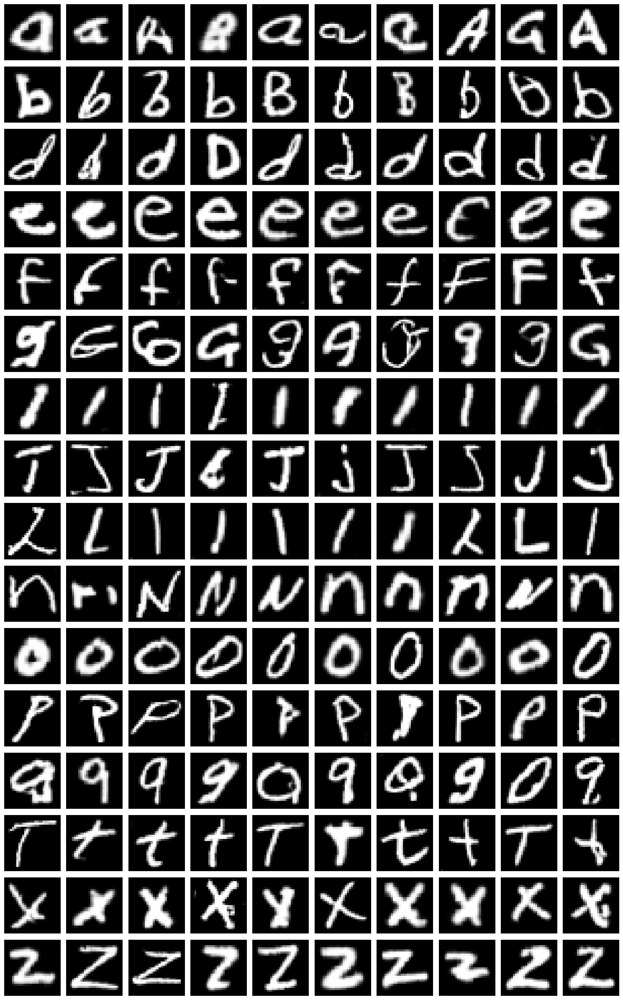

Epoch 191 | D Loss: 0.5811 | G Loss: 1.2009 | D Acc: 0.6719
Epoch 192 | D Loss: 0.4459 | G Loss: 0.6651 | D Acc: 0.8359
Epoch 193 | D Loss: 0.5984 | G Loss: 1.0664 | D Acc: 0.6641
Epoch 194 | D Loss: 0.3902 | G Loss: 0.9567 | D Acc: 0.8984
Epoch 195 | D Loss: 0.4831 | G Loss: 1.4841 | D Acc: 0.7969
Epoch 196 | D Loss: 0.4856 | G Loss: 0.8376 | D Acc: 0.8281
Epoch 197 | D Loss: 0.6828 | G Loss: 0.7123 | D Acc: 0.5703
Epoch 198 | D Loss: 0.4324 | G Loss: 1.6665 | D Acc: 0.8594
Epoch 199 | D Loss: 0.7231 | G Loss: 0.9833 | D Acc: 0.5156
Epoch 200 | D Loss: 0.6941 | G Loss: 0.5833 | D Acc: 0.5859
Preview images at epoch 200:


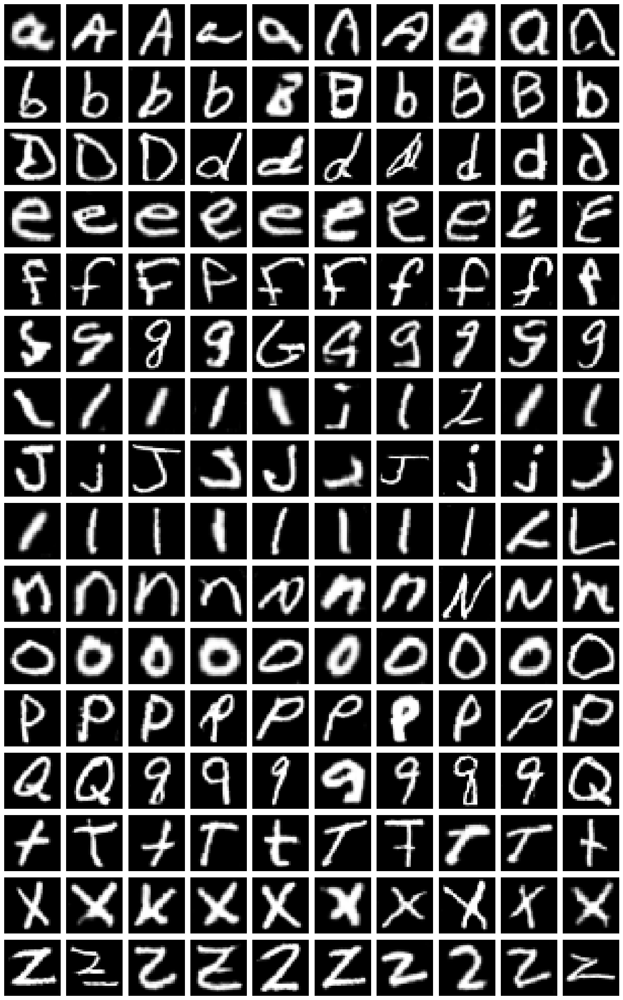

Epoch 201 | D Loss: 0.6631 | G Loss: 2.1215 | D Acc: 0.5703
Epoch 202 | D Loss: 0.4878 | G Loss: 1.0821 | D Acc: 0.7734
Epoch 203 | D Loss: 0.5749 | G Loss: 1.0939 | D Acc: 0.6875
Epoch 204 | D Loss: 0.4443 | G Loss: 1.1908 | D Acc: 0.8828
Epoch 205 | D Loss: 0.4734 | G Loss: 1.5834 | D Acc: 0.7969
Epoch 206 | D Loss: 0.7115 | G Loss: 1.3225 | D Acc: 0.5391
Epoch 207 | D Loss: 0.5259 | G Loss: 0.8488 | D Acc: 0.7656
Epoch 208 | D Loss: 0.4330 | G Loss: 0.6999 | D Acc: 0.8516
Epoch 209 | D Loss: 0.5436 | G Loss: 0.8529 | D Acc: 0.7344
Epoch 210 | D Loss: 0.4509 | G Loss: 1.0990 | D Acc: 0.8516
Preview images at epoch 210:


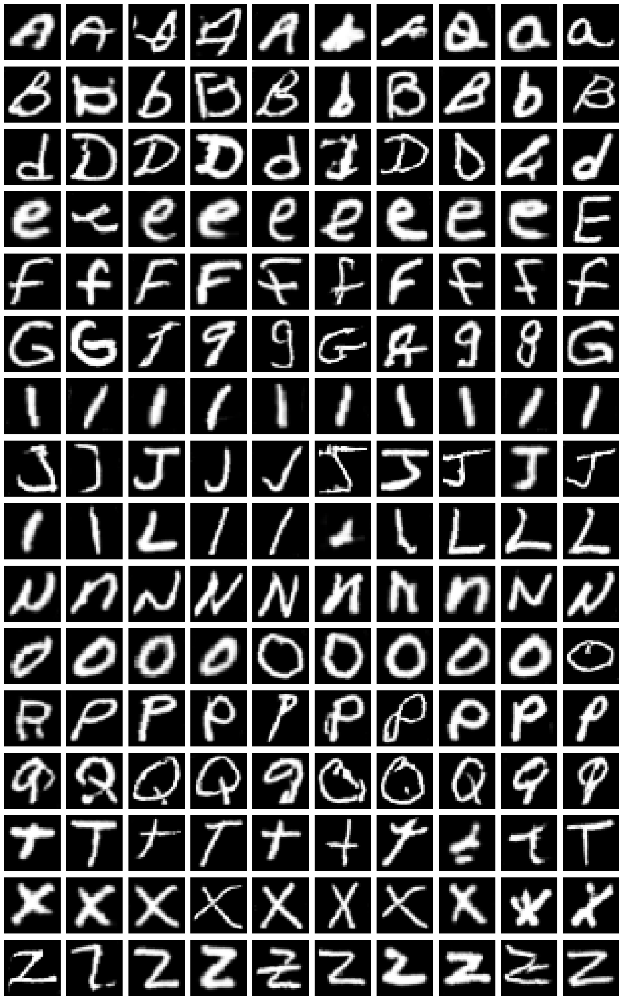

Epoch 211 | D Loss: 0.6315 | G Loss: 0.7625 | D Acc: 0.6172
Epoch 212 | D Loss: 0.4817 | G Loss: 0.7303 | D Acc: 0.7891
Epoch 213 | D Loss: 0.4240 | G Loss: 1.1062 | D Acc: 0.7891
Epoch 214 | D Loss: 0.4177 | G Loss: 1.4197 | D Acc: 0.8516
Epoch 215 | D Loss: 0.6833 | G Loss: 1.0206 | D Acc: 0.5625
Epoch 216 | D Loss: 0.3023 | G Loss: 1.2235 | D Acc: 0.9453
Epoch 217 | D Loss: 0.6625 | G Loss: 0.8662 | D Acc: 0.5469
Epoch 218 | D Loss: 0.7338 | G Loss: 1.0704 | D Acc: 0.5859
Epoch 219 | D Loss: 0.5404 | G Loss: 0.9438 | D Acc: 0.7188
Epoch 220 | D Loss: 0.5462 | G Loss: 1.2606 | D Acc: 0.7266
Preview images at epoch 220:


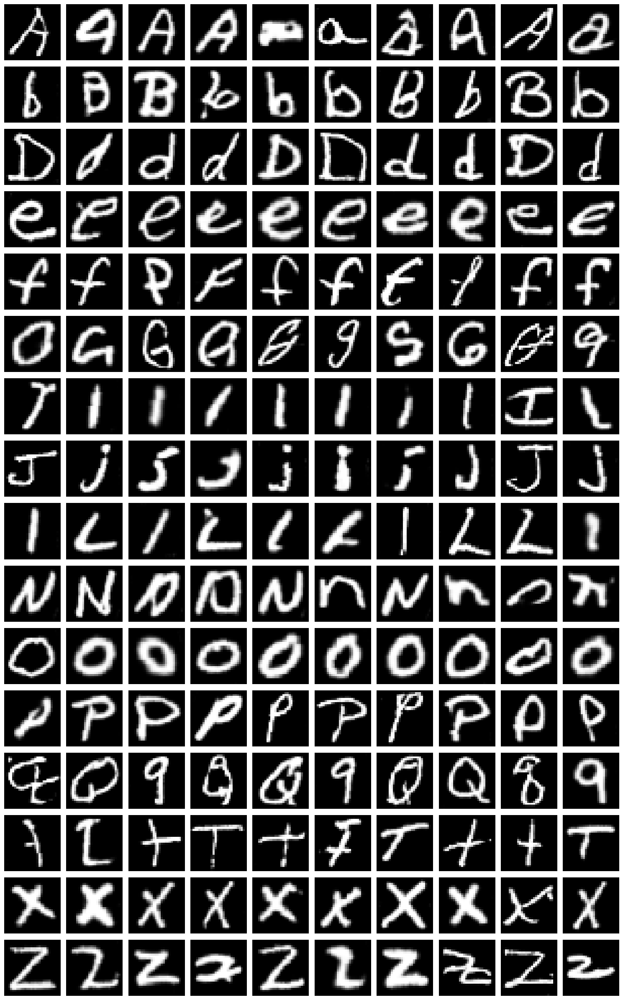

Epoch 221 | D Loss: 0.6740 | G Loss: 0.8164 | D Acc: 0.6250
Epoch 222 | D Loss: 0.7402 | G Loss: 1.0874 | D Acc: 0.5078
Epoch 223 | D Loss: 0.7918 | G Loss: 0.9713 | D Acc: 0.5000
Epoch 224 | D Loss: 0.5838 | G Loss: 1.0216 | D Acc: 0.6719
Epoch 225 | D Loss: 0.7430 | G Loss: 1.6057 | D Acc: 0.5234
Epoch 226 | D Loss: 0.6348 | G Loss: 1.4977 | D Acc: 0.5859
Epoch 227 | D Loss: 0.5414 | G Loss: 1.6814 | D Acc: 0.7031
Epoch 228 | D Loss: 0.3393 | G Loss: 0.7725 | D Acc: 0.9375
Epoch 229 | D Loss: 0.7185 | G Loss: 1.3118 | D Acc: 0.5469
Epoch 230 | D Loss: 0.9744 | G Loss: 0.4974 | D Acc: 0.4141
Best generator saved at epoch 230
Preview images at epoch 230:


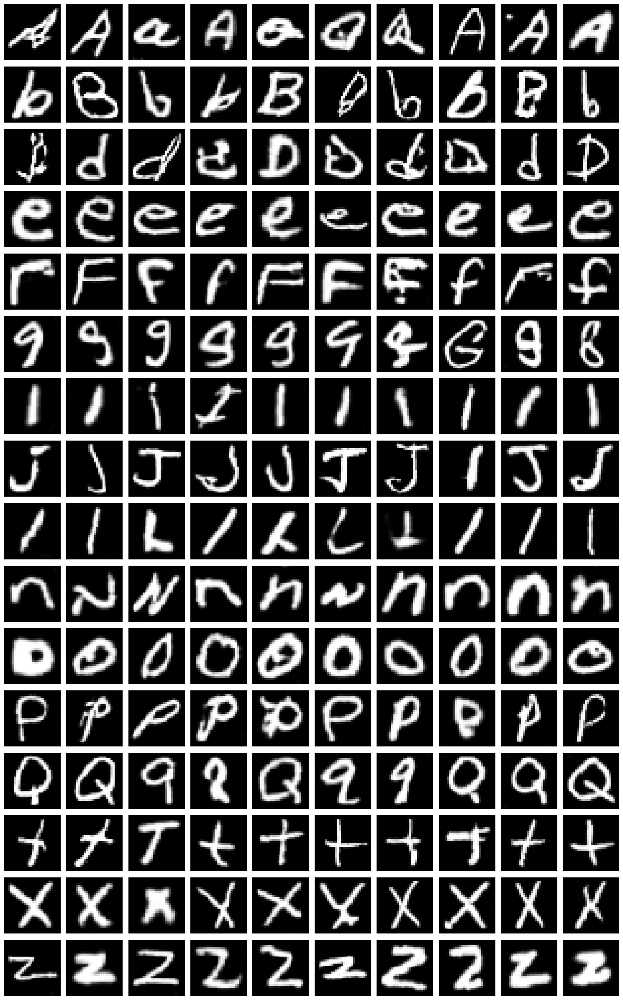

Epoch 231 | D Loss: 0.6753 | G Loss: 0.3133 | D Acc: 0.6250
Best generator saved at epoch 231
Epoch 232 | D Loss: 0.5672 | G Loss: 0.7231 | D Acc: 0.7422
Epoch 233 | D Loss: 0.5195 | G Loss: 0.5173 | D Acc: 0.7734
Epoch 234 | D Loss: 0.3727 | G Loss: 0.9852 | D Acc: 0.8359
Epoch 235 | D Loss: 0.6656 | G Loss: 1.5183 | D Acc: 0.5938
Epoch 236 | D Loss: 0.6240 | G Loss: 0.3481 | D Acc: 0.6172
Epoch 237 | D Loss: 0.7901 | G Loss: 1.4589 | D Acc: 0.5469
Epoch 238 | D Loss: 0.5066 | G Loss: 0.6878 | D Acc: 0.7891
Epoch 239 | D Loss: 0.4662 | G Loss: 1.1786 | D Acc: 0.8203
Epoch 240 | D Loss: 0.8317 | G Loss: 1.7011 | D Acc: 0.5312
Preview images at epoch 240:


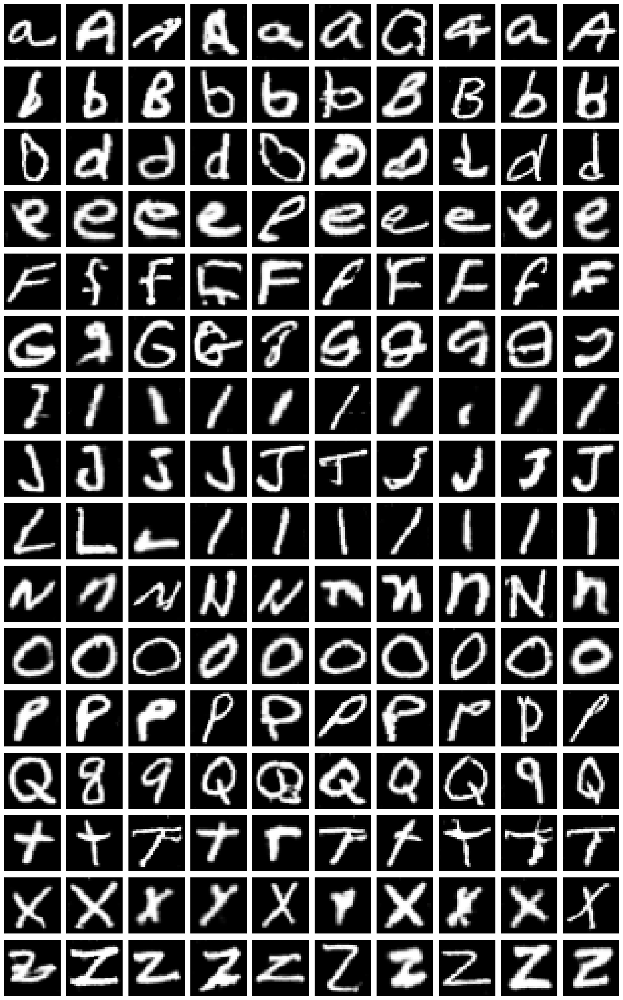

Epoch 241 | D Loss: 0.4655 | G Loss: 1.4227 | D Acc: 0.8281
Epoch 242 | D Loss: 0.7620 | G Loss: 1.9931 | D Acc: 0.5312
Epoch 243 | D Loss: 0.3223 | G Loss: 0.6799 | D Acc: 0.9375
Epoch 244 | D Loss: 0.4185 | G Loss: 1.9282 | D Acc: 0.8125
Epoch 245 | D Loss: 0.5263 | G Loss: 1.8539 | D Acc: 0.7109
Epoch 246 | D Loss: 0.5070 | G Loss: 1.0927 | D Acc: 0.6797
Epoch 247 | D Loss: 0.6967 | G Loss: 1.6624 | D Acc: 0.5938
Epoch 248 | D Loss: 0.3506 | G Loss: 2.0542 | D Acc: 0.9062
Epoch 249 | D Loss: 0.5875 | G Loss: 0.8819 | D Acc: 0.6406
Epoch 250 | D Loss: 0.6781 | G Loss: 1.0885 | D Acc: 0.6328
Preview images at epoch 250:


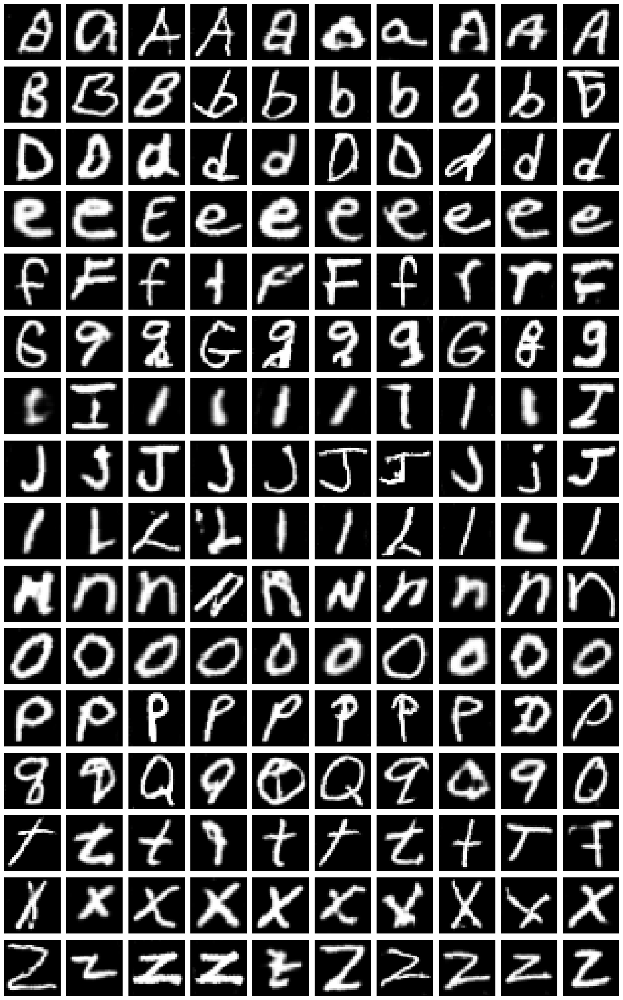

Epoch 251 | D Loss: 0.4529 | G Loss: 1.1300 | D Acc: 0.7891
Epoch 252 | D Loss: 0.4127 | G Loss: 1.6647 | D Acc: 0.8516
Epoch 253 | D Loss: 0.3920 | G Loss: 1.6433 | D Acc: 0.8438
Epoch 254 | D Loss: 0.4948 | G Loss: 1.9581 | D Acc: 0.7109
Epoch 255 | D Loss: 0.3175 | G Loss: 1.2723 | D Acc: 0.8984
Epoch 256 | D Loss: 0.2314 | G Loss: 1.9929 | D Acc: 0.9531
Epoch 257 | D Loss: 0.5395 | G Loss: 2.5450 | D Acc: 0.6719
Epoch 258 | D Loss: 0.5869 | G Loss: 1.8676 | D Acc: 0.6953
Epoch 259 | D Loss: 0.3022 | G Loss: 3.0154 | D Acc: 0.9375
Epoch 260 | D Loss: 0.4597 | G Loss: 1.9204 | D Acc: 0.8125
Preview images at epoch 260:


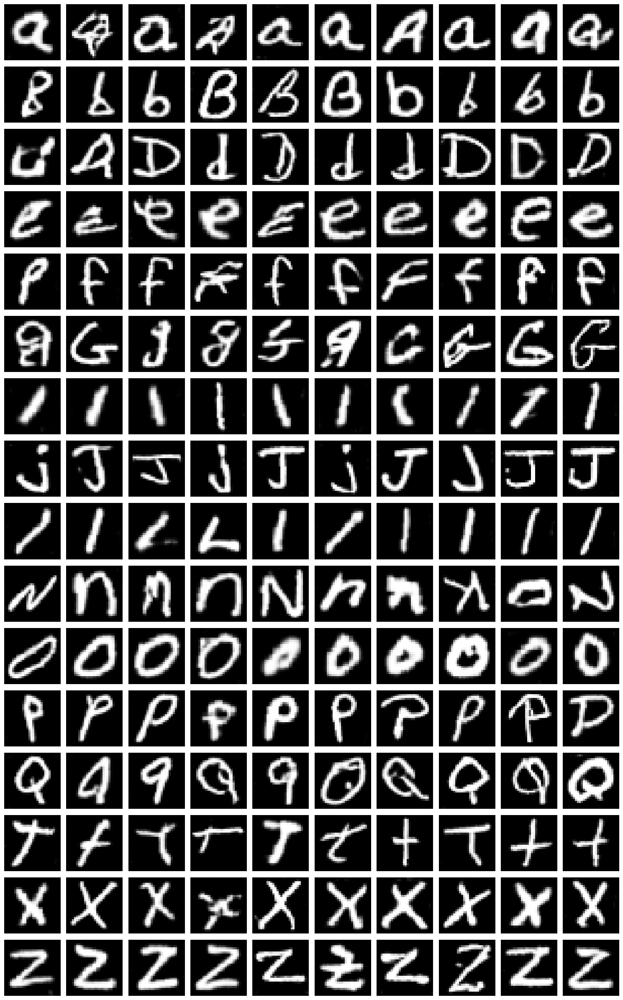

Epoch 261 | D Loss: 0.3133 | G Loss: 1.0695 | D Acc: 0.9062
Epoch 262 | D Loss: 0.6593 | G Loss: 0.7412 | D Acc: 0.6094
Epoch 263 | D Loss: 0.2921 | G Loss: 1.1667 | D Acc: 0.9062
Epoch 264 | D Loss: 0.4299 | G Loss: 1.1492 | D Acc: 0.8438
Epoch 265 | D Loss: 0.5297 | G Loss: 1.4749 | D Acc: 0.7812
Epoch 266 | D Loss: 0.2791 | G Loss: 2.0067 | D Acc: 0.9297
Epoch 267 | D Loss: 0.5125 | G Loss: 1.3251 | D Acc: 0.7500
Epoch 268 | D Loss: 0.4504 | G Loss: 1.1038 | D Acc: 0.7891
Epoch 269 | D Loss: 0.5858 | G Loss: 2.1147 | D Acc: 0.6875
Epoch 270 | D Loss: 0.3846 | G Loss: 0.5905 | D Acc: 0.8438
Preview images at epoch 270:


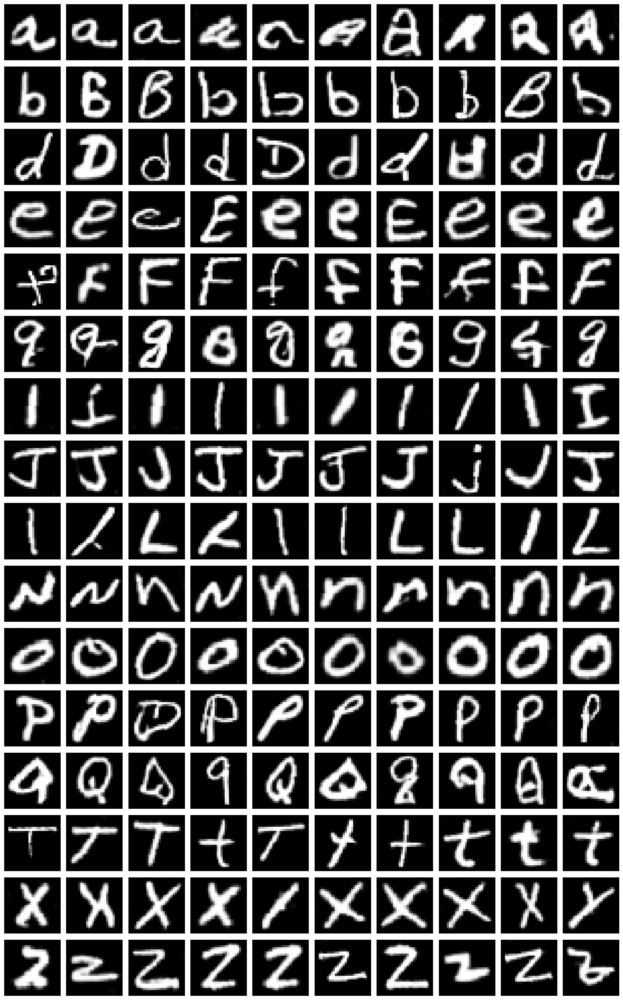

Epoch 271 | D Loss: 0.5746 | G Loss: 1.9874 | D Acc: 0.6719
Epoch 272 | D Loss: 0.6040 | G Loss: 1.1857 | D Acc: 0.7031
Epoch 273 | D Loss: 0.4706 | G Loss: 1.0206 | D Acc: 0.8047
Epoch 274 | D Loss: 0.5391 | G Loss: 0.6184 | D Acc: 0.7422
Epoch 275 | D Loss: 0.5514 | G Loss: 0.8360 | D Acc: 0.7422
Epoch 276 | D Loss: 0.6017 | G Loss: 1.5565 | D Acc: 0.7109
Epoch 277 | D Loss: 0.7210 | G Loss: 1.0284 | D Acc: 0.6016
Epoch 278 | D Loss: 0.4434 | G Loss: 0.8954 | D Acc: 0.8203
Epoch 279 | D Loss: 0.4817 | G Loss: 3.1047 | D Acc: 0.7891
Epoch 280 | D Loss: 0.2262 | G Loss: 1.2152 | D Acc: 0.9531
Preview images at epoch 280:


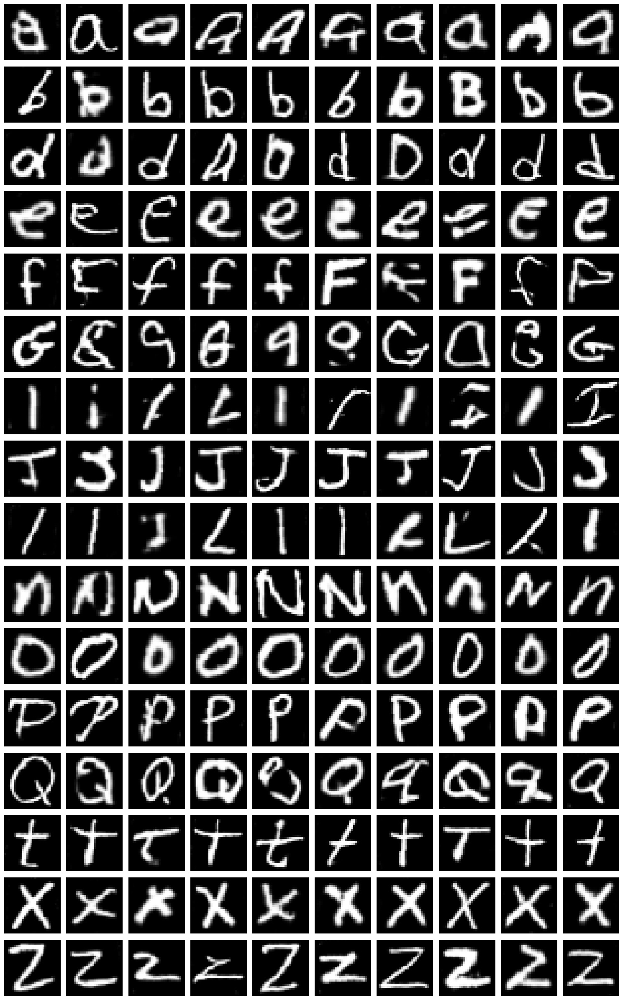

Epoch 281 | D Loss: 0.7112 | G Loss: 2.0936 | D Acc: 0.5781
Epoch 282 | D Loss: 0.2502 | G Loss: 2.4541 | D Acc: 0.9609
Epoch 283 | D Loss: 0.2999 | G Loss: 1.3555 | D Acc: 0.9062
Epoch 284 | D Loss: 0.5687 | G Loss: 1.2315 | D Acc: 0.6953
Epoch 285 | D Loss: 0.3137 | G Loss: 1.0678 | D Acc: 0.9219
Epoch 286 | D Loss: 0.6334 | G Loss: 1.8318 | D Acc: 0.7031
Epoch 287 | D Loss: 0.5557 | G Loss: 2.2212 | D Acc: 0.6328
Epoch 288 | D Loss: 0.5694 | G Loss: 1.1955 | D Acc: 0.7188
Epoch 289 | D Loss: 0.2599 | G Loss: 0.9704 | D Acc: 0.9375
Epoch 290 | D Loss: 0.4409 | G Loss: 1.2173 | D Acc: 0.7656
Preview images at epoch 290:


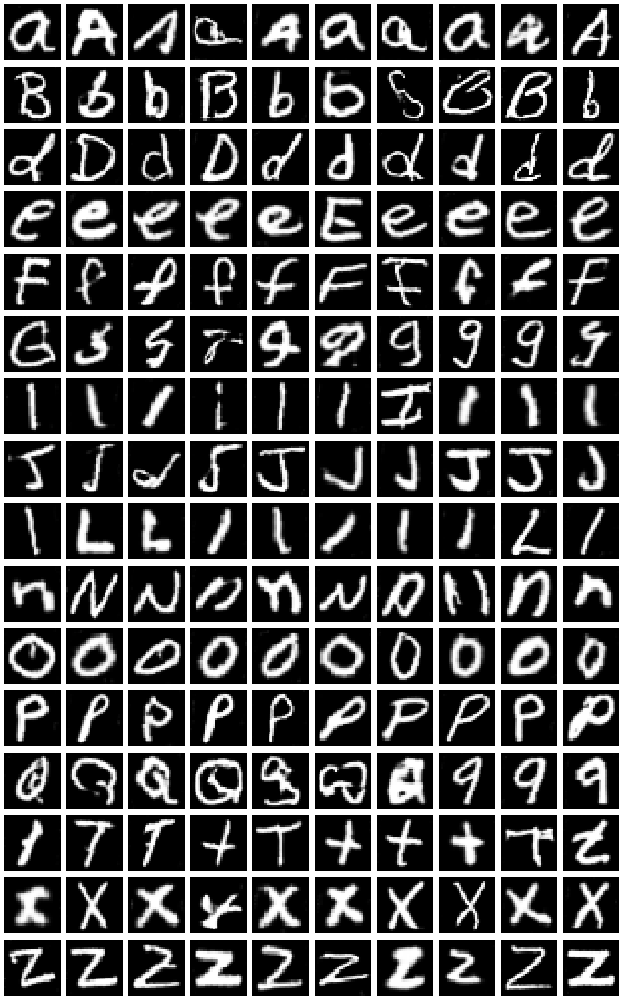

Epoch 291 | D Loss: 0.5941 | G Loss: 2.8178 | D Acc: 0.6172
Epoch 292 | D Loss: 0.2529 | G Loss: 0.7102 | D Acc: 0.9453
Epoch 293 | D Loss: 0.8815 | G Loss: 1.4210 | D Acc: 0.5547
Epoch 294 | D Loss: 0.3213 | G Loss: 0.2470 | D Acc: 0.9297
Best generator saved at epoch 294
Epoch 295 | D Loss: 0.6178 | G Loss: 1.7438 | D Acc: 0.6406
Epoch 296 | D Loss: 0.4395 | G Loss: 2.5552 | D Acc: 0.8359
Epoch 297 | D Loss: 0.2433 | G Loss: 2.6905 | D Acc: 0.9141
Epoch 298 | D Loss: 0.3265 | G Loss: 2.7301 | D Acc: 0.8750
Epoch 299 | D Loss: 0.3262 | G Loss: 0.9883 | D Acc: 0.8672
Epoch 300 | D Loss: 0.2142 | G Loss: 1.2618 | D Acc: 0.9375
Preview images at epoch 300:


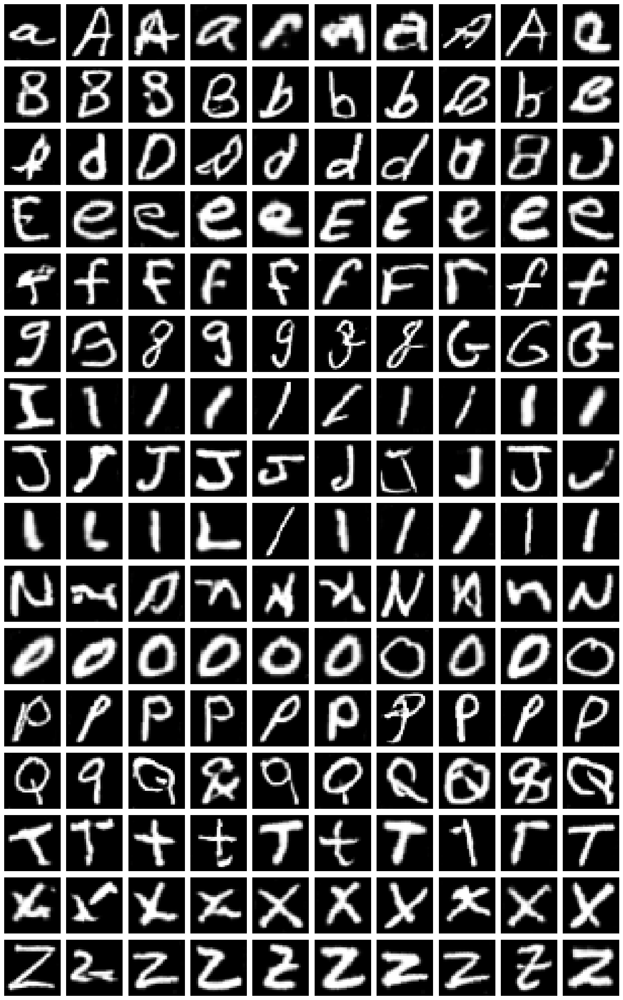

Epoch 301 | D Loss: 1.0575 | G Loss: 1.8707 | D Acc: 0.4844
Epoch 302 | D Loss: 0.5040 | G Loss: 1.2790 | D Acc: 0.7344
Epoch 303 | D Loss: 0.3089 | G Loss: 1.7244 | D Acc: 0.8828
Epoch 304 | D Loss: 0.3133 | G Loss: 0.8675 | D Acc: 0.8438
Epoch 305 | D Loss: 0.3937 | G Loss: 2.7974 | D Acc: 0.8281
Epoch 306 | D Loss: 0.7691 | G Loss: 1.0410 | D Acc: 0.6016
Epoch 307 | D Loss: 0.4584 | G Loss: 1.9567 | D Acc: 0.7969
Epoch 308 | D Loss: 0.3309 | G Loss: 2.2978 | D Acc: 0.8984
Epoch 309 | D Loss: 0.5208 | G Loss: 0.8222 | D Acc: 0.7812
Epoch 310 | D Loss: 0.2896 | G Loss: 3.1895 | D Acc: 0.9141
Preview images at epoch 310:


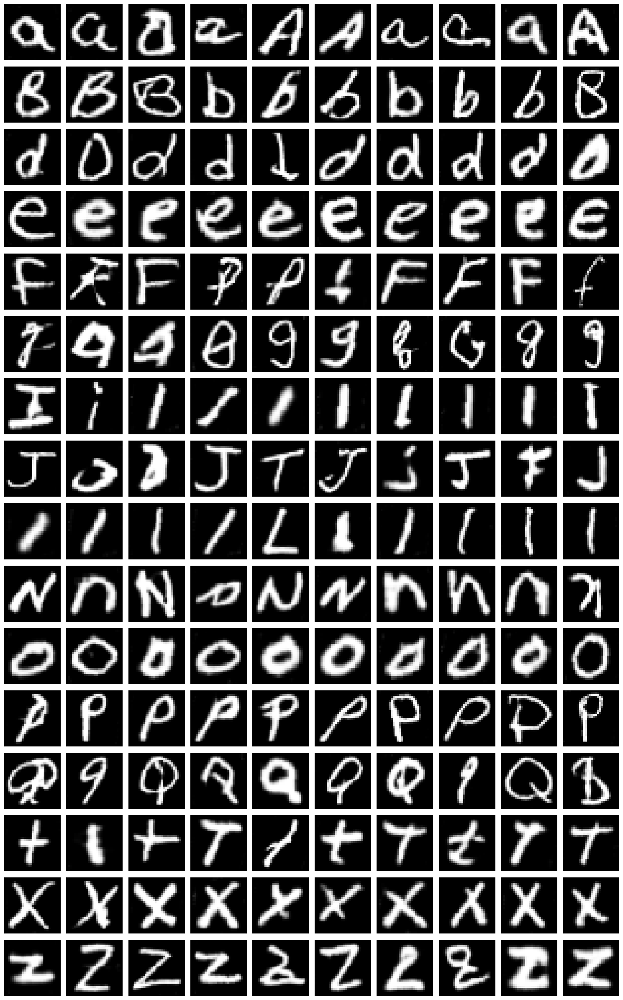

Epoch 311 | D Loss: 0.8385 | G Loss: 2.0166 | D Acc: 0.5312
Epoch 312 | D Loss: 0.5980 | G Loss: 1.2149 | D Acc: 0.6641
Epoch 313 | D Loss: 0.1534 | G Loss: 0.2279 | D Acc: 0.9766
Best generator saved at epoch 313
Epoch 314 | D Loss: 0.4143 | G Loss: 1.5521 | D Acc: 0.7734
Epoch 315 | D Loss: 0.1927 | G Loss: 1.3271 | D Acc: 0.9688
Epoch 316 | D Loss: 0.1646 | G Loss: 1.5366 | D Acc: 0.9922
Epoch 317 | D Loss: 0.2612 | G Loss: 2.2304 | D Acc: 0.9453
Epoch 318 | D Loss: 0.2970 | G Loss: 2.6145 | D Acc: 0.9297
Epoch 319 | D Loss: 0.6543 | G Loss: 3.1175 | D Acc: 0.6172
Epoch 320 | D Loss: 0.3035 | G Loss: 3.3594 | D Acc: 0.9297
Preview images at epoch 320:


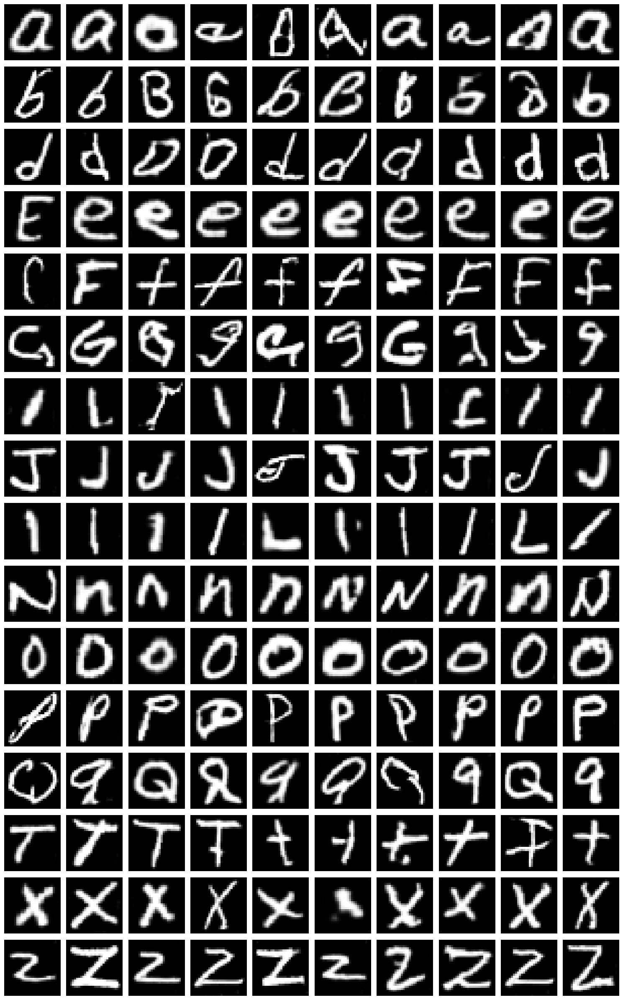

Epoch 321 | D Loss: 0.4003 | G Loss: 3.0012 | D Acc: 0.8516
Epoch 322 | D Loss: 0.6746 | G Loss: 1.0667 | D Acc: 0.5938
Epoch 323 | D Loss: 0.4346 | G Loss: 1.2115 | D Acc: 0.7266
Epoch 324 | D Loss: 0.8898 | G Loss: 2.1318 | D Acc: 0.5547
Epoch 325 | D Loss: 0.3139 | G Loss: 0.5039 | D Acc: 0.8906
Epoch 326 | D Loss: 0.3100 | G Loss: 2.8046 | D Acc: 0.8906
Epoch 327 | D Loss: 0.6348 | G Loss: 1.4693 | D Acc: 0.6641
Epoch 328 | D Loss: 0.5451 | G Loss: 1.5237 | D Acc: 0.6953
Epoch 329 | D Loss: 0.4592 | G Loss: 1.2087 | D Acc: 0.7812
Epoch 330 | D Loss: 0.3968 | G Loss: 3.1777 | D Acc: 0.8203
Preview images at epoch 330:


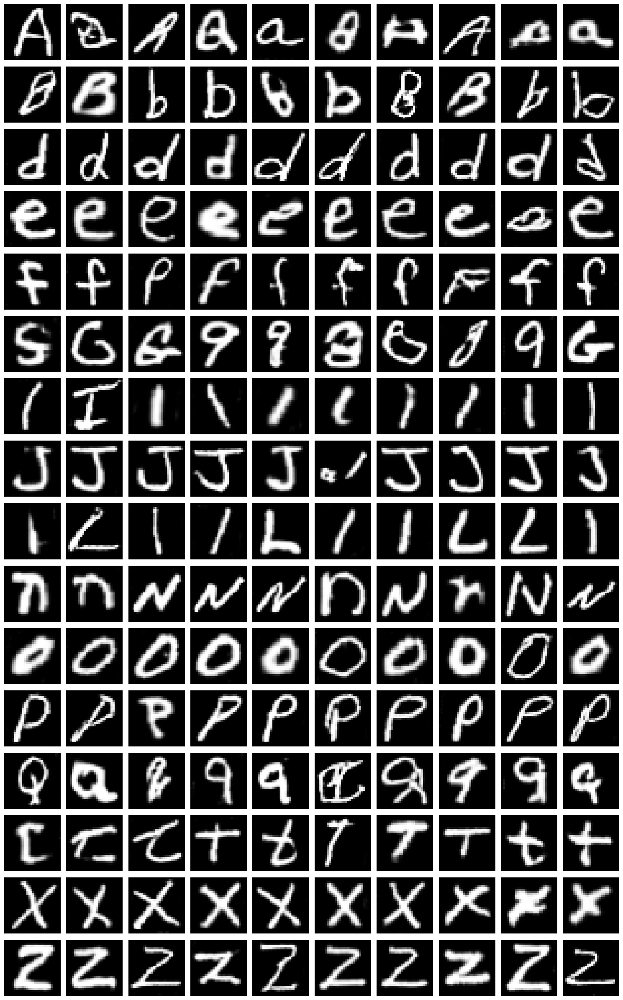

Epoch 331 | D Loss: 0.1590 | G Loss: 0.9763 | D Acc: 0.9844
Epoch 332 | D Loss: 0.1889 | G Loss: 0.5877 | D Acc: 0.9688
Epoch 333 | D Loss: 0.2400 | G Loss: 1.0113 | D Acc: 0.9219
Epoch 334 | D Loss: 0.3844 | G Loss: 4.1856 | D Acc: 0.8438
Epoch 335 | D Loss: 0.2301 | G Loss: 1.4192 | D Acc: 0.9453
Epoch 336 | D Loss: 0.3517 | G Loss: 0.5140 | D Acc: 0.8906
Epoch 337 | D Loss: 0.2390 | G Loss: 1.8967 | D Acc: 0.8984
Epoch 338 | D Loss: 0.6938 | G Loss: 1.2370 | D Acc: 0.5703
Epoch 339 | D Loss: 0.4102 | G Loss: 0.7689 | D Acc: 0.8438
Epoch 340 | D Loss: 0.4878 | G Loss: 0.6501 | D Acc: 0.7578
Preview images at epoch 340:


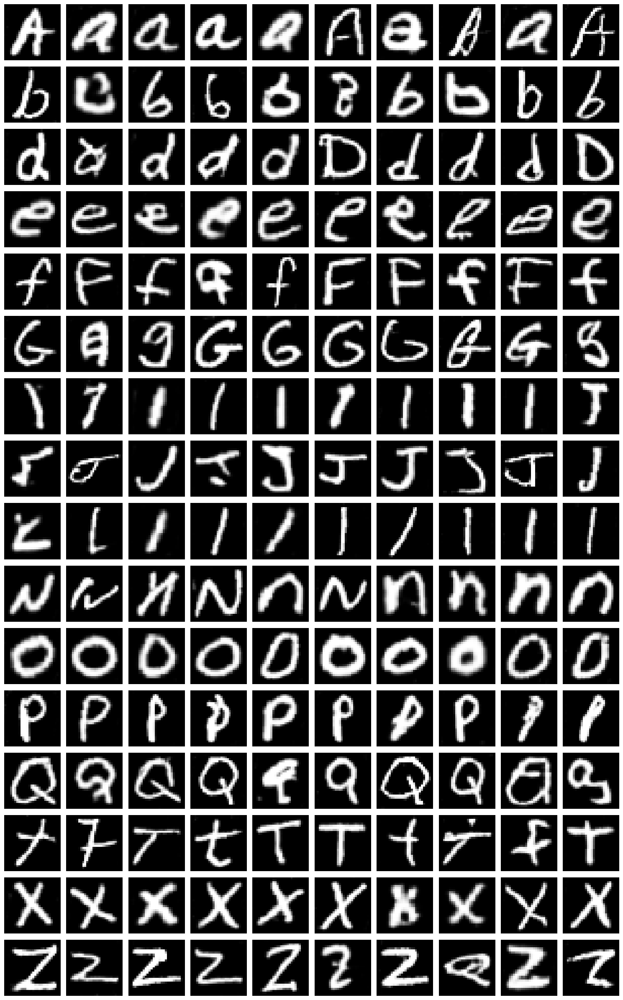

Epoch 341 | D Loss: 0.8934 | G Loss: 2.4543 | D Acc: 0.5156
Epoch 342 | D Loss: 0.4766 | G Loss: 1.8408 | D Acc: 0.7500
Epoch 343 | D Loss: 0.5603 | G Loss: 1.7527 | D Acc: 0.6797
Epoch 344 | D Loss: 0.1863 | G Loss: 1.0834 | D Acc: 0.9531
Epoch 345 | D Loss: 0.4329 | G Loss: 0.9003 | D Acc: 0.7891
Epoch 346 | D Loss: 0.3677 | G Loss: 1.9172 | D Acc: 0.7891
Epoch 347 | D Loss: 0.9269 | G Loss: 1.9173 | D Acc: 0.4375
Epoch 348 | D Loss: 0.7353 | G Loss: 0.6156 | D Acc: 0.5781
Epoch 349 | D Loss: 0.3347 | G Loss: 2.1505 | D Acc: 0.8281
Epoch 350 | D Loss: 0.1993 | G Loss: 0.9874 | D Acc: 0.9609
Preview images at epoch 350:


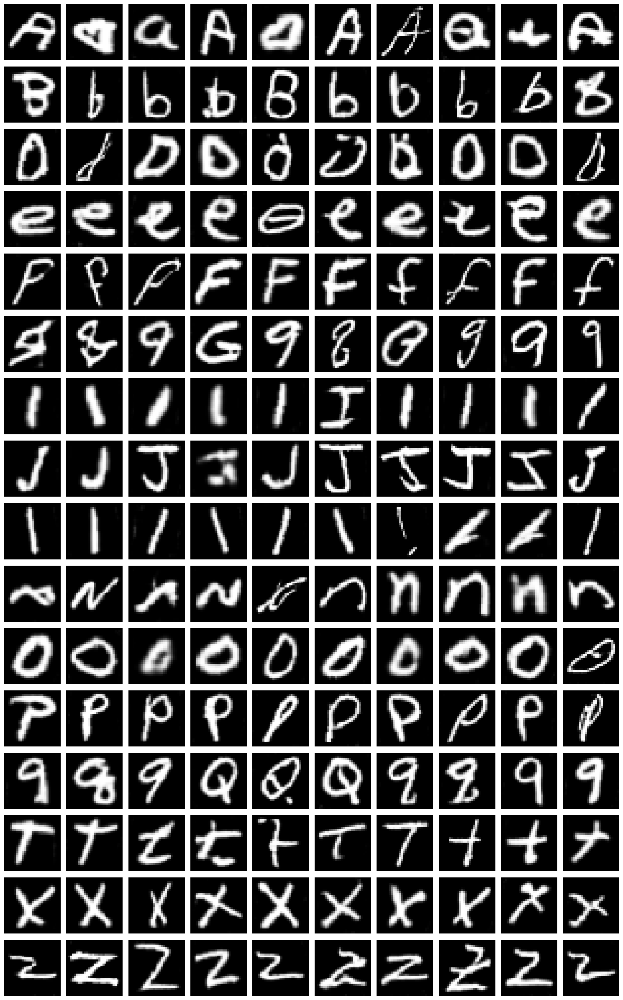

Epoch 351 | D Loss: 0.3902 | G Loss: 1.5749 | D Acc: 0.8359
Epoch 352 | D Loss: 0.3006 | G Loss: 1.2480 | D Acc: 0.8828
Epoch 353 | D Loss: 0.4889 | G Loss: 2.4555 | D Acc: 0.6719
Epoch 354 | D Loss: 0.1000 | G Loss: 2.2132 | D Acc: 1.0000
Epoch 355 | D Loss: 0.3919 | G Loss: 1.1931 | D Acc: 0.8203
Epoch 356 | D Loss: 0.0852 | G Loss: 2.0431 | D Acc: 1.0000
Epoch 357 | D Loss: 0.4606 | G Loss: 0.9109 | D Acc: 0.7812
Epoch 358 | D Loss: 0.8217 | G Loss: 0.6293 | D Acc: 0.5078
Epoch 359 | D Loss: 0.2766 | G Loss: 0.7955 | D Acc: 0.9297
Epoch 360 | D Loss: 0.5147 | G Loss: 0.4552 | D Acc: 0.7344
Preview images at epoch 360:


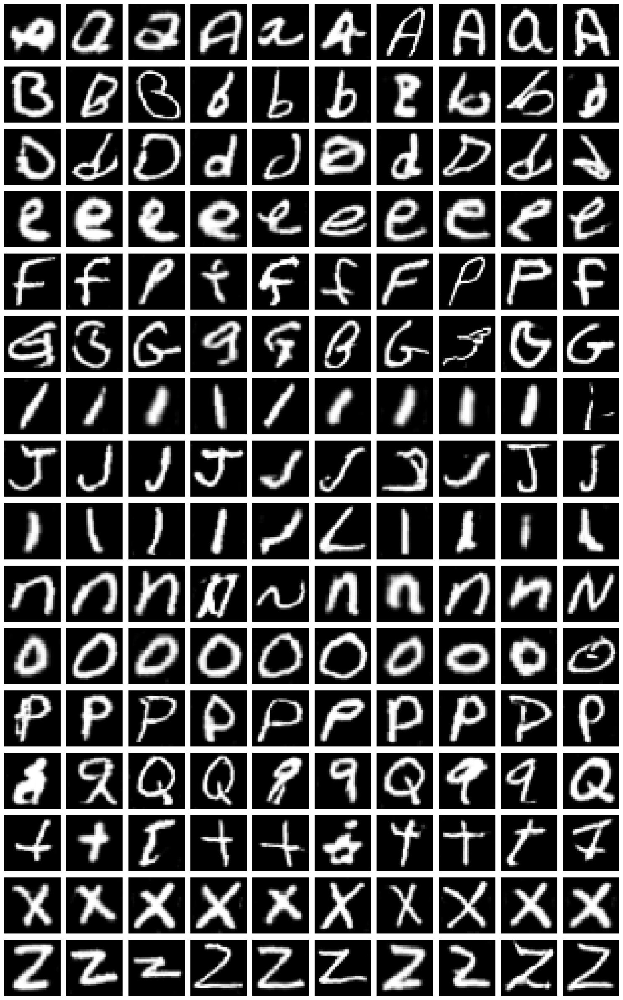

Epoch 361 | D Loss: 0.1186 | G Loss: 1.0905 | D Acc: 0.9922
Epoch 362 | D Loss: 0.8340 | G Loss: 3.9440 | D Acc: 0.5469
Epoch 363 | D Loss: 0.6309 | G Loss: 1.6203 | D Acc: 0.6328
Epoch 364 | D Loss: 0.2682 | G Loss: 0.2558 | D Acc: 0.9297
Epoch 365 | D Loss: 0.7061 | G Loss: 1.2152 | D Acc: 0.6406
Epoch 366 | D Loss: 0.1718 | G Loss: 2.6730 | D Acc: 0.9375
Epoch 367 | D Loss: 0.8459 | G Loss: 0.7752 | D Acc: 0.5469
Epoch 368 | D Loss: 0.6775 | G Loss: 1.1936 | D Acc: 0.6797
Epoch 369 | D Loss: 0.2163 | G Loss: 2.0662 | D Acc: 0.9375
Epoch 370 | D Loss: 0.6310 | G Loss: 2.1389 | D Acc: 0.6562
Preview images at epoch 370:


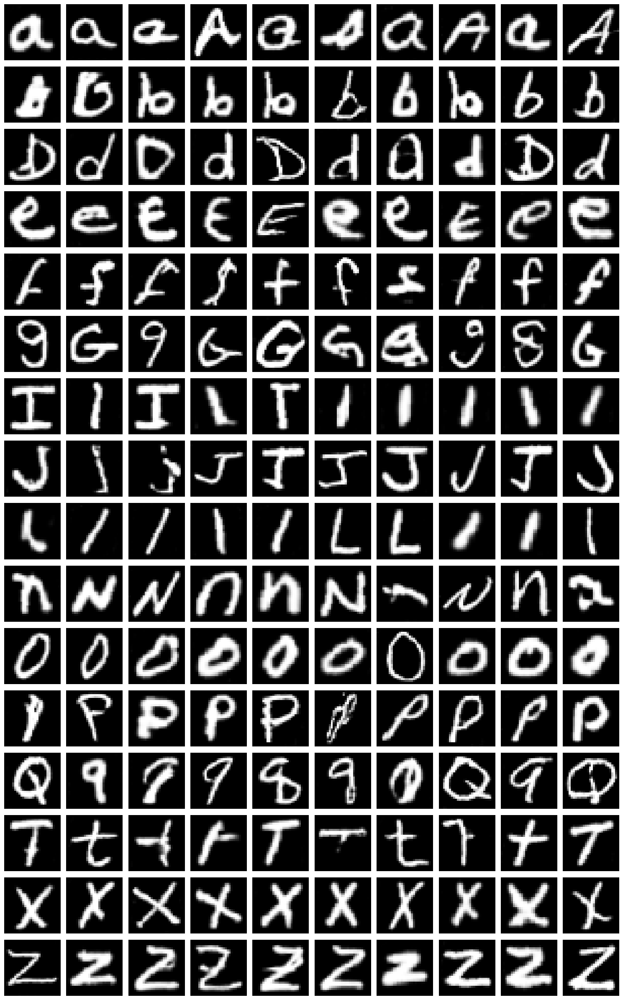

Epoch 371 | D Loss: 0.2980 | G Loss: 1.5985 | D Acc: 0.8516
Epoch 372 | D Loss: 0.1820 | G Loss: 0.8777 | D Acc: 0.9844
Epoch 373 | D Loss: 0.1658 | G Loss: 0.4706 | D Acc: 0.9766
Epoch 374 | D Loss: 0.4366 | G Loss: 3.4603 | D Acc: 0.8203
Epoch 375 | D Loss: 0.1915 | G Loss: 1.2587 | D Acc: 0.9531
Epoch 376 | D Loss: 0.1960 | G Loss: 1.7003 | D Acc: 0.9531
Epoch 377 | D Loss: 0.0655 | G Loss: 4.2379 | D Acc: 0.9922
Epoch 378 | D Loss: 0.2455 | G Loss: 1.4898 | D Acc: 0.8594
Epoch 379 | D Loss: 0.6445 | G Loss: 3.6904 | D Acc: 0.5938
Epoch 380 | D Loss: 0.8238 | G Loss: 1.9230 | D Acc: 0.5547
Preview images at epoch 380:


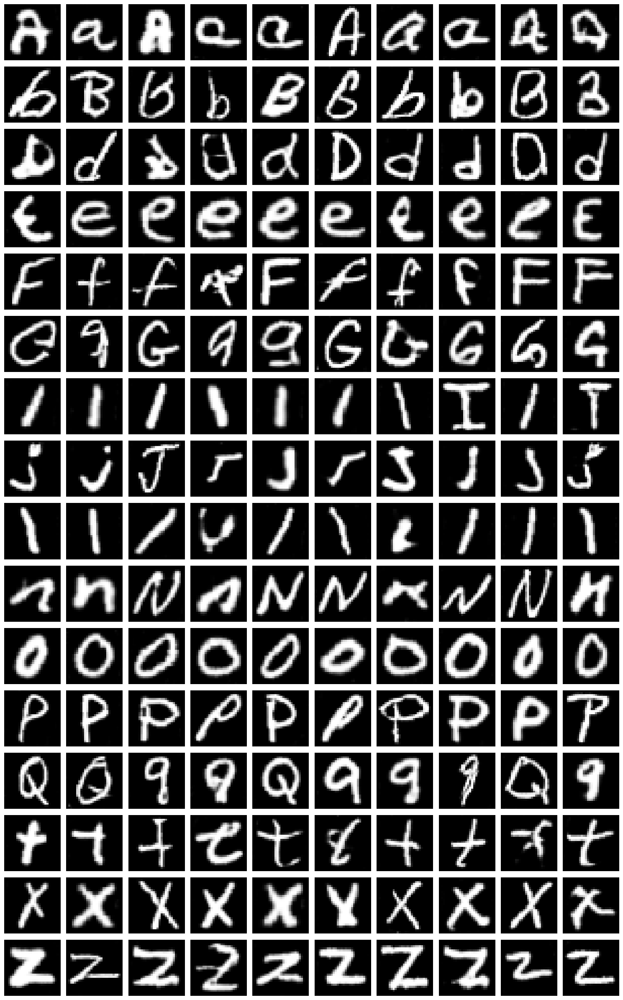

Epoch 381 | D Loss: 0.7198 | G Loss: 0.6424 | D Acc: 0.6250
Epoch 382 | D Loss: 0.6416 | G Loss: 3.6986 | D Acc: 0.5938
Epoch 383 | D Loss: 0.6933 | G Loss: 0.8841 | D Acc: 0.5859
Epoch 384 | D Loss: 0.3547 | G Loss: 2.3714 | D Acc: 0.8906
Epoch 385 | D Loss: 0.2376 | G Loss: 3.6836 | D Acc: 0.9219
Epoch 386 | D Loss: 0.3541 | G Loss: 1.5379 | D Acc: 0.8906
Epoch 387 | D Loss: 0.3116 | G Loss: 3.0217 | D Acc: 0.8906
Epoch 388 | D Loss: 0.1575 | G Loss: 2.4259 | D Acc: 0.9922
Epoch 389 | D Loss: 0.5210 | G Loss: 2.4469 | D Acc: 0.7734
Epoch 390 | D Loss: 0.3874 | G Loss: 3.2698 | D Acc: 0.7969
Preview images at epoch 390:


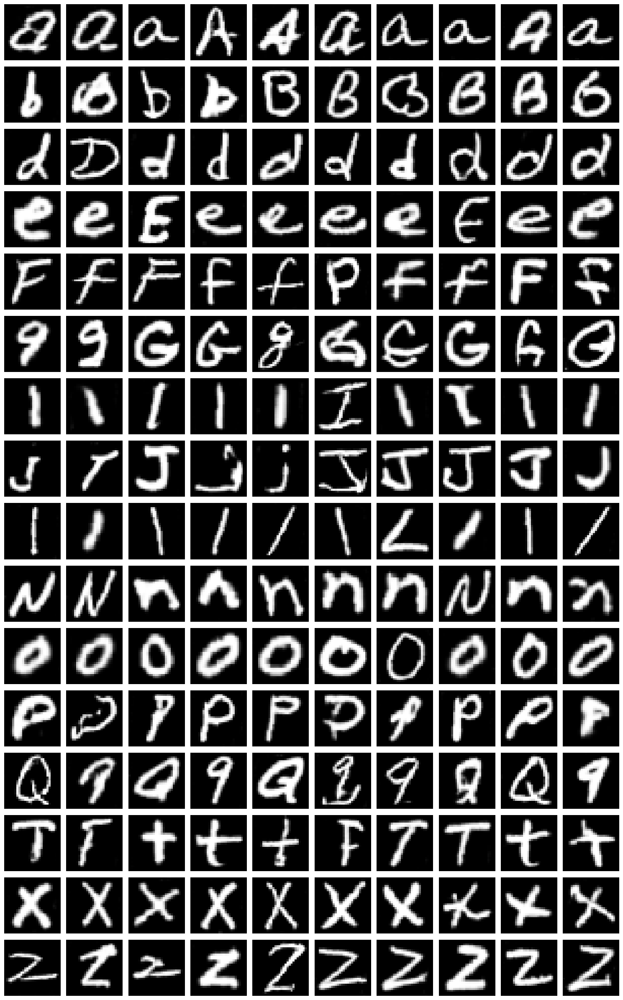

Epoch 391 | D Loss: 0.3685 | G Loss: 0.9011 | D Acc: 0.8828
Epoch 392 | D Loss: 0.5673 | G Loss: 1.5510 | D Acc: 0.7031
Epoch 393 | D Loss: 0.3229 | G Loss: 2.9170 | D Acc: 0.8906
Epoch 394 | D Loss: 0.1832 | G Loss: 2.0223 | D Acc: 0.9766
Epoch 395 | D Loss: 0.5023 | G Loss: 0.7717 | D Acc: 0.7344
Epoch 396 | D Loss: 0.5235 | G Loss: 2.2887 | D Acc: 0.7188
Epoch 397 | D Loss: 0.1103 | G Loss: 2.8736 | D Acc: 1.0000
Epoch 398 | D Loss: 0.1056 | G Loss: 1.8171 | D Acc: 0.9766
Epoch 399 | D Loss: 0.1664 | G Loss: 3.6831 | D Acc: 0.9766
Epoch 400 | D Loss: 0.2242 | G Loss: 1.8943 | D Acc: 0.9453
Preview images at epoch 400:


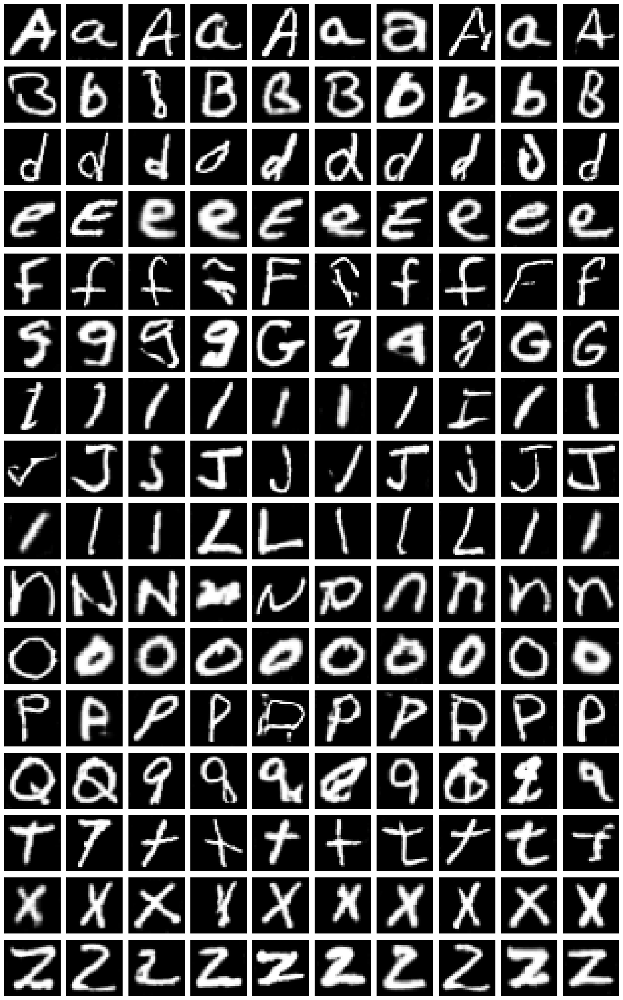

Epoch 401 | D Loss: 0.3759 | G Loss: 4.1005 | D Acc: 0.7812
Epoch 402 | D Loss: 0.7990 | G Loss: 1.3486 | D Acc: 0.5859
Epoch 403 | D Loss: 0.3808 | G Loss: 1.6275 | D Acc: 0.7891
Epoch 404 | D Loss: 0.1179 | G Loss: 1.5993 | D Acc: 1.0000
Epoch 405 | D Loss: 0.3310 | G Loss: 4.2012 | D Acc: 0.8828
Epoch 406 | D Loss: 0.8471 | G Loss: 0.2671 | D Acc: 0.4062
Epoch 407 | D Loss: 0.1544 | G Loss: 0.5644 | D Acc: 0.9766
Epoch 408 | D Loss: 0.6143 | G Loss: 1.9770 | D Acc: 0.6328
Epoch 409 | D Loss: 1.1967 | G Loss: 2.3482 | D Acc: 0.3203
Epoch 410 | D Loss: 0.2276 | G Loss: 2.1839 | D Acc: 0.9062
Preview images at epoch 410:


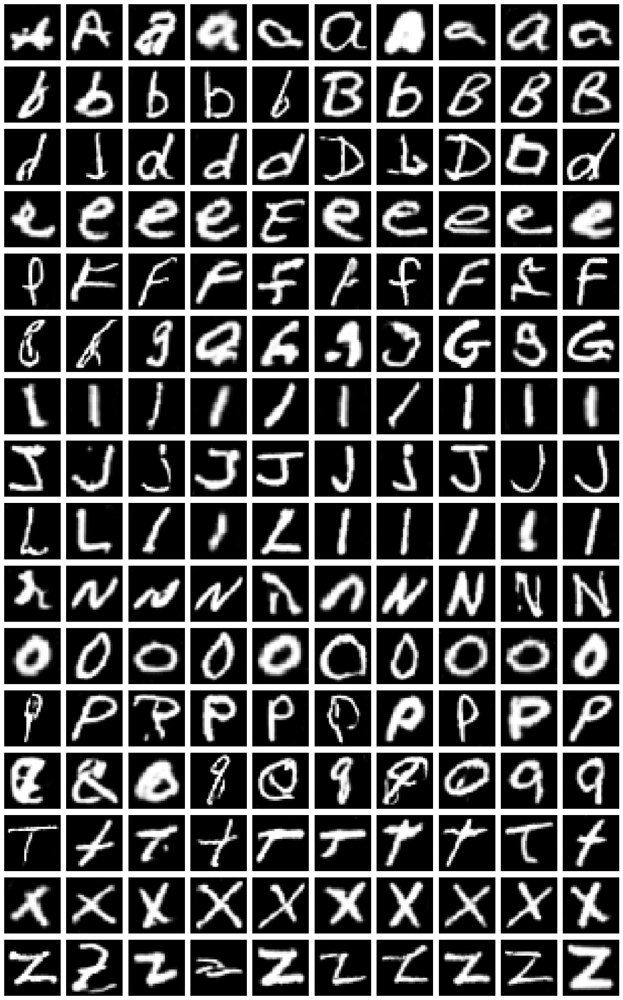

Epoch 411 | D Loss: 0.2973 | G Loss: 0.9601 | D Acc: 0.8984
Epoch 412 | D Loss: 0.0986 | G Loss: 1.9715 | D Acc: 0.9922
Epoch 413 | D Loss: 0.7663 | G Loss: 1.4445 | D Acc: 0.5625
Epoch 414 | D Loss: 0.3946 | G Loss: 2.1378 | D Acc: 0.8203
Epoch 415 | D Loss: 0.8789 | G Loss: 1.6586 | D Acc: 0.5625
Epoch 416 | D Loss: 0.4131 | G Loss: 1.7790 | D Acc: 0.8203
Epoch 417 | D Loss: 0.2900 | G Loss: 2.3600 | D Acc: 0.8750
Epoch 418 | D Loss: 0.9494 | G Loss: 2.2141 | D Acc: 0.3594
Epoch 419 | D Loss: 0.3456 | G Loss: 0.6439 | D Acc: 0.8438
Epoch 420 | D Loss: 0.6842 | G Loss: 1.4224 | D Acc: 0.5938
Preview images at epoch 420:


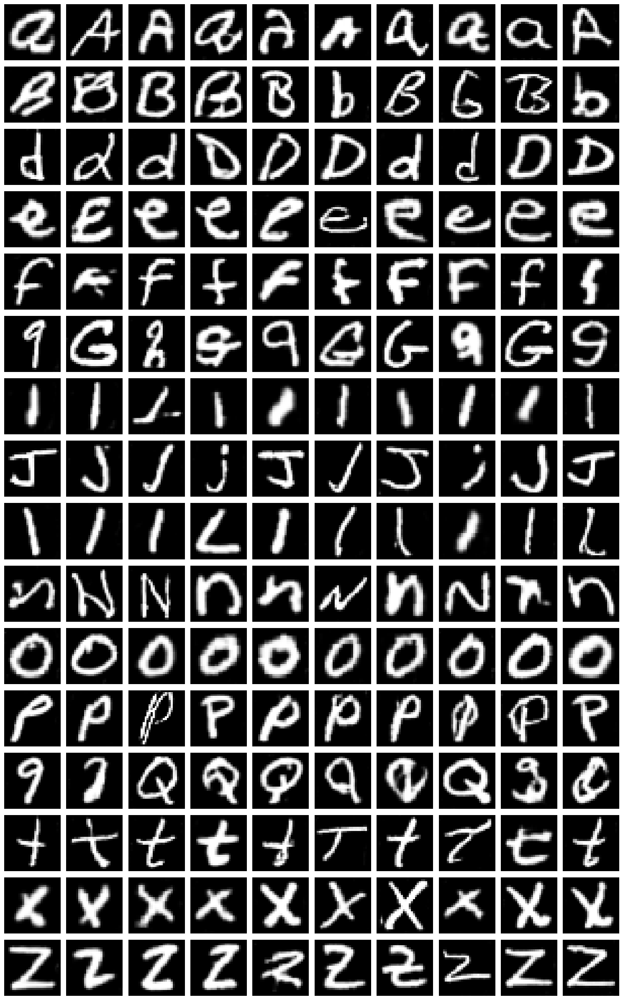

Epoch 421 | D Loss: 0.2356 | G Loss: 1.2510 | D Acc: 0.9141
Epoch 422 | D Loss: 0.1484 | G Loss: 2.4415 | D Acc: 0.9766
Epoch 423 | D Loss: 0.3243 | G Loss: 1.6975 | D Acc: 0.8359
Epoch 424 | D Loss: 0.1486 | G Loss: 2.4239 | D Acc: 0.9844
Epoch 425 | D Loss: 0.2629 | G Loss: 3.6490 | D Acc: 0.9297
Epoch 426 | D Loss: 0.4251 | G Loss: 0.2709 | D Acc: 0.7812
Epoch 427 | D Loss: 0.6929 | G Loss: 2.4966 | D Acc: 0.6484
Epoch 428 | D Loss: 0.2276 | G Loss: 2.4789 | D Acc: 0.9141
Epoch 429 | D Loss: 0.2964 | G Loss: 0.4909 | D Acc: 0.9141
Epoch 430 | D Loss: 0.1929 | G Loss: 3.1925 | D Acc: 0.9297
Preview images at epoch 430:


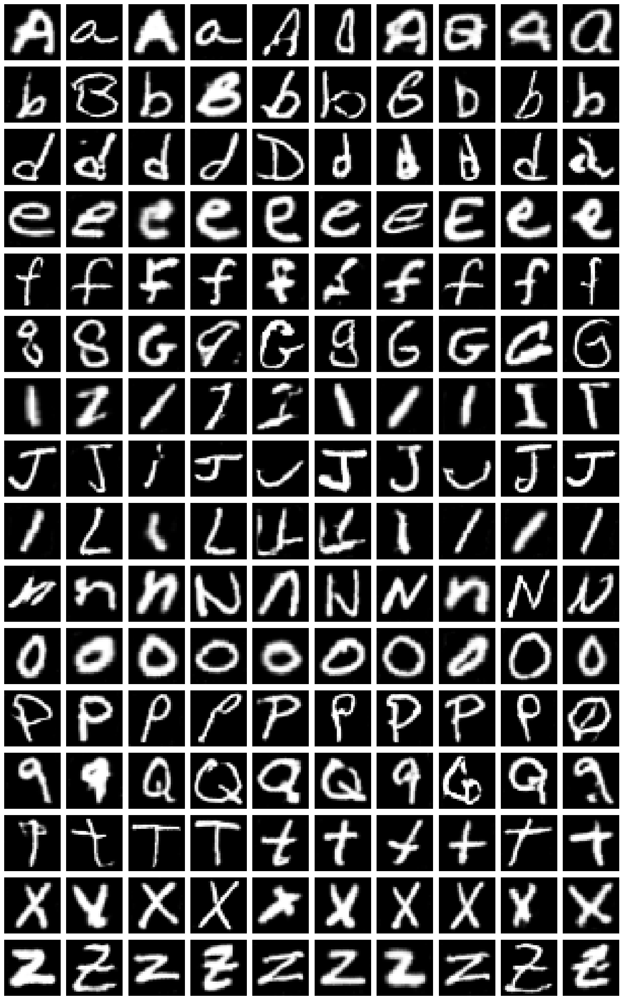

Epoch 431 | D Loss: 0.2026 | G Loss: 1.3225 | D Acc: 0.9531
Epoch 432 | D Loss: 0.5467 | G Loss: 2.5275 | D Acc: 0.6641
Epoch 433 | D Loss: 0.2584 | G Loss: 4.1190 | D Acc: 0.8984
Epoch 434 | D Loss: 0.4184 | G Loss: 2.5501 | D Acc: 0.7969
Epoch 435 | D Loss: 0.4254 | G Loss: 2.6895 | D Acc: 0.7969
Epoch 436 | D Loss: 0.1010 | G Loss: 2.8955 | D Acc: 1.0000
Epoch 437 | D Loss: 0.5576 | G Loss: 2.0170 | D Acc: 0.6562
Epoch 438 | D Loss: 0.5352 | G Loss: 1.4962 | D Acc: 0.7109
Epoch 439 | D Loss: 0.1710 | G Loss: 0.9479 | D Acc: 0.9766
Epoch 440 | D Loss: 1.1676 | G Loss: 0.5886 | D Acc: 0.4688
Preview images at epoch 440:


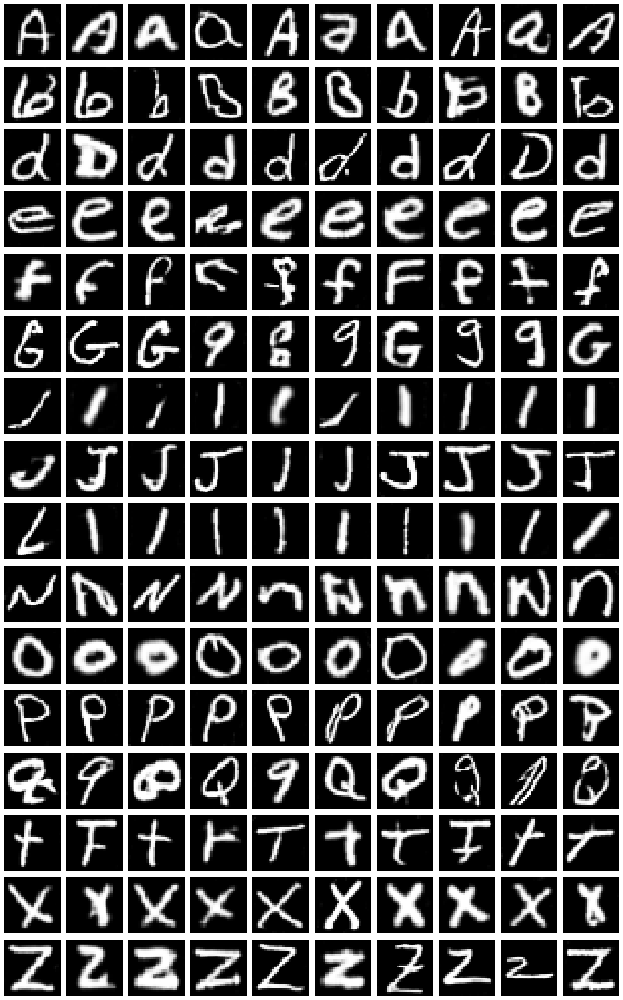

Epoch 441 | D Loss: 0.1865 | G Loss: 1.5173 | D Acc: 0.9609
Epoch 442 | D Loss: 0.3278 | G Loss: 1.6276 | D Acc: 0.8750
Epoch 443 | D Loss: 0.3888 | G Loss: 3.4789 | D Acc: 0.8438
Epoch 444 | D Loss: 0.6541 | G Loss: 2.5289 | D Acc: 0.6016
Epoch 445 | D Loss: 0.5755 | G Loss: 5.6930 | D Acc: 0.6641
Epoch 446 | D Loss: 0.1779 | G Loss: 2.2210 | D Acc: 0.9609
Epoch 447 | D Loss: 0.1060 | G Loss: 3.1326 | D Acc: 0.9922
Epoch 448 | D Loss: 0.0627 | G Loss: 2.1541 | D Acc: 1.0000
Epoch 449 | D Loss: 0.4590 | G Loss: 3.6292 | D Acc: 0.7578
Epoch 450 | D Loss: 0.1552 | G Loss: 3.6069 | D Acc: 0.9766
Preview images at epoch 450:


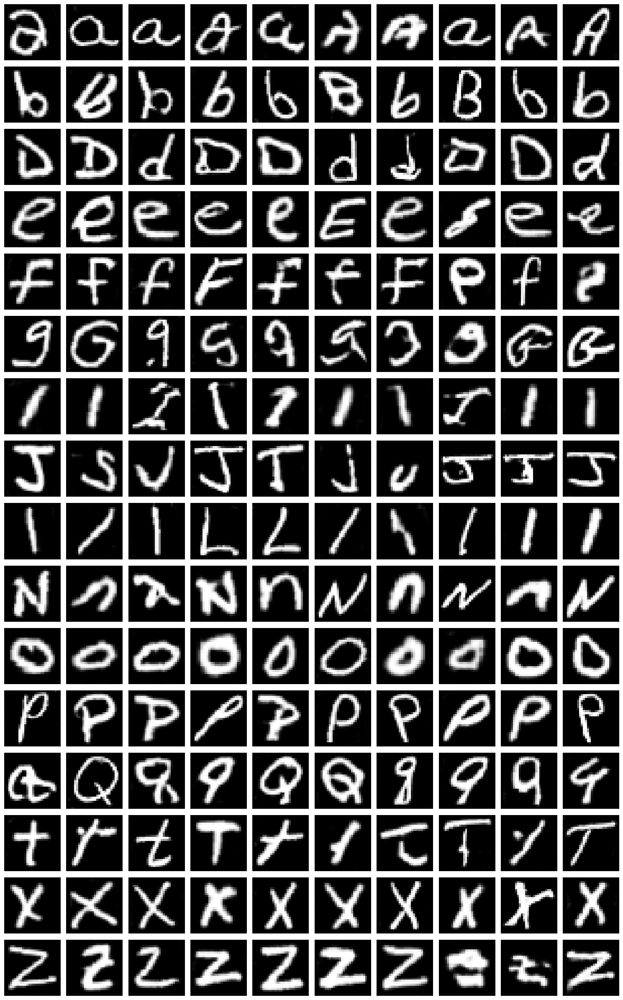

Epoch 451 | D Loss: 0.3953 | G Loss: 2.3016 | D Acc: 0.8125
Epoch 452 | D Loss: 0.0687 | G Loss: 1.6693 | D Acc: 0.9922
Epoch 453 | D Loss: 0.4641 | G Loss: 0.5856 | D Acc: 0.7344
Epoch 454 | D Loss: 0.4912 | G Loss: 1.4781 | D Acc: 0.7734
Epoch 455 | D Loss: 1.0617 | G Loss: 0.5893 | D Acc: 0.3125
Epoch 456 | D Loss: 0.1993 | G Loss: 1.8887 | D Acc: 0.9375
Epoch 457 | D Loss: 0.4638 | G Loss: 1.1830 | D Acc: 0.7109
Epoch 458 | D Loss: 0.4133 | G Loss: 0.3628 | D Acc: 0.8594
Epoch 459 | D Loss: 0.7046 | G Loss: 0.3920 | D Acc: 0.5859
Epoch 460 | D Loss: 0.4178 | G Loss: 1.4271 | D Acc: 0.7188
Preview images at epoch 460:


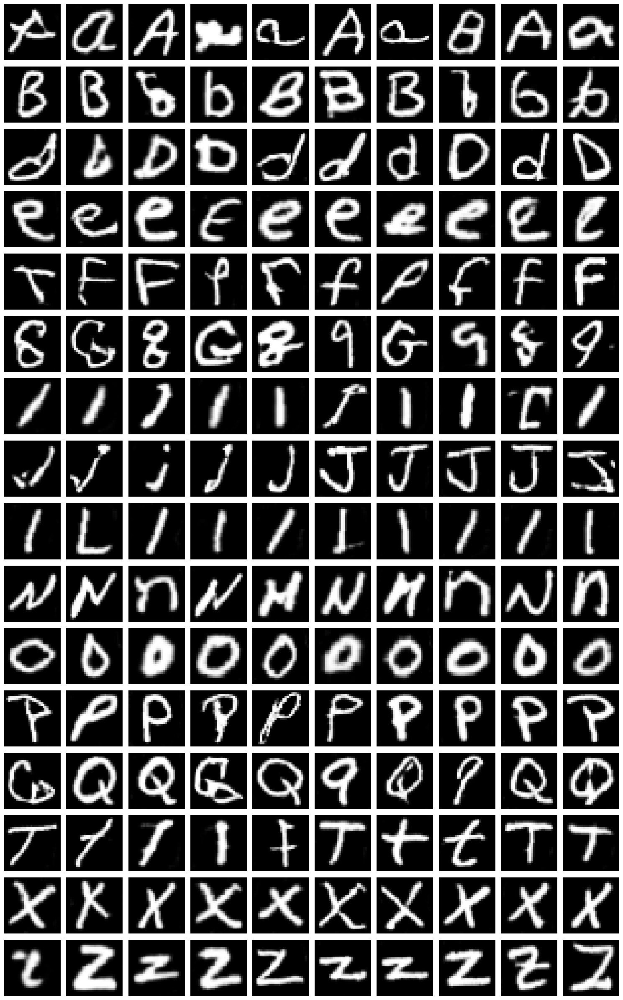

Epoch 461 | D Loss: 0.1554 | G Loss: 1.7857 | D Acc: 0.9531
Epoch 462 | D Loss: 0.1682 | G Loss: 2.2650 | D Acc: 0.9531
Epoch 463 | D Loss: 0.7474 | G Loss: 1.6565 | D Acc: 0.5469
Epoch 464 | D Loss: 1.0442 | G Loss: 1.6647 | D Acc: 0.5156
Epoch 465 | D Loss: 0.2359 | G Loss: 2.6261 | D Acc: 0.9141
Epoch 466 | D Loss: 0.3605 | G Loss: 1.4528 | D Acc: 0.8516
Epoch 467 | D Loss: 0.1938 | G Loss: 2.1135 | D Acc: 1.0000
Epoch 468 | D Loss: 0.4106 | G Loss: 4.0283 | D Acc: 0.7656
Epoch 469 | D Loss: 0.0928 | G Loss: 1.4147 | D Acc: 0.9922
Epoch 470 | D Loss: 0.3188 | G Loss: 3.3866 | D Acc: 0.8906
Preview images at epoch 470:


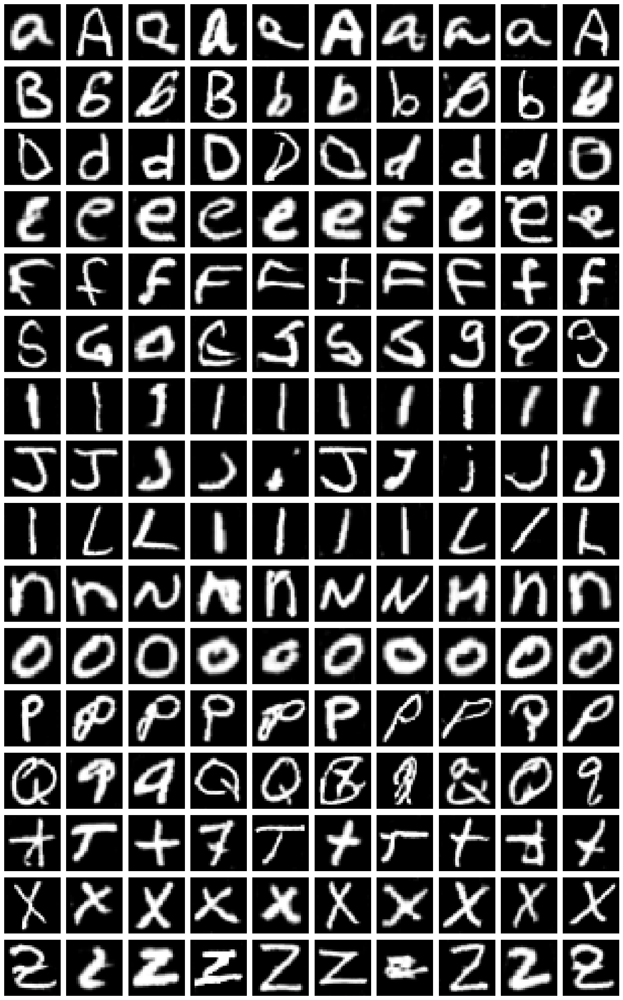

Epoch 471 | D Loss: 0.2193 | G Loss: 2.2365 | D Acc: 0.9297
Epoch 472 | D Loss: 0.6603 | G Loss: 0.4331 | D Acc: 0.5781
Epoch 473 | D Loss: 0.1518 | G Loss: 3.1422 | D Acc: 0.9609
Epoch 474 | D Loss: 0.2057 | G Loss: 2.8783 | D Acc: 0.9531
Epoch 475 | D Loss: 0.4064 | G Loss: 1.0377 | D Acc: 0.8047
Epoch 476 | D Loss: 0.1624 | G Loss: 2.1315 | D Acc: 0.9688
Epoch 477 | D Loss: 0.1523 | G Loss: 1.3535 | D Acc: 0.9844
Epoch 478 | D Loss: 0.2199 | G Loss: 2.3380 | D Acc: 0.9297
Epoch 479 | D Loss: 0.5890 | G Loss: 0.6649 | D Acc: 0.6562
Epoch 480 | D Loss: 0.3883 | G Loss: 1.6447 | D Acc: 0.8125
Preview images at epoch 480:


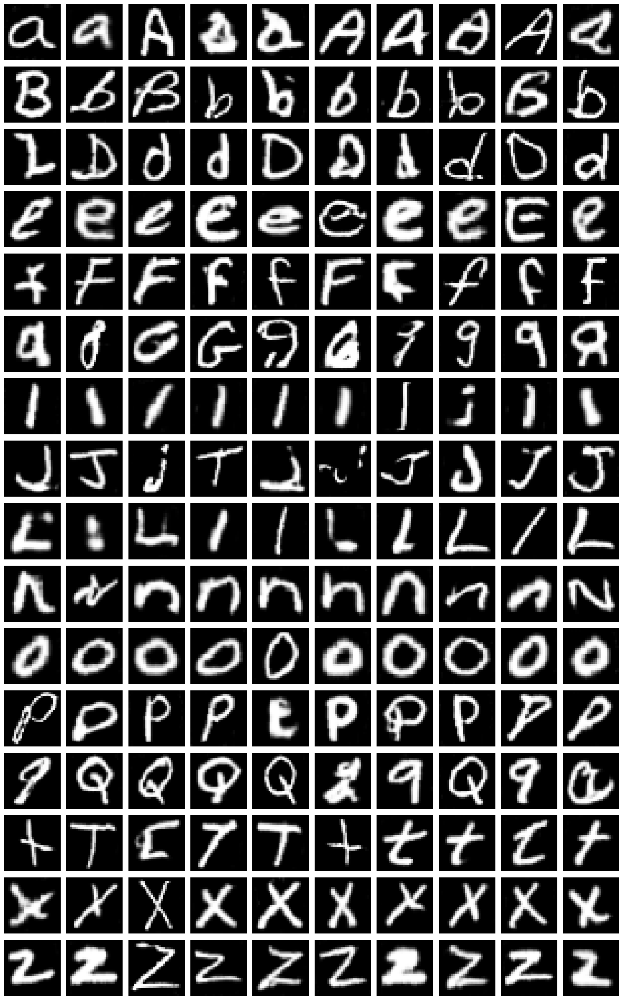

Epoch 481 | D Loss: 0.2833 | G Loss: 0.9355 | D Acc: 0.9141
Epoch 482 | D Loss: 0.1212 | G Loss: 3.4810 | D Acc: 0.9922
Epoch 483 | D Loss: 0.2627 | G Loss: 4.2639 | D Acc: 0.8672
Epoch 484 | D Loss: 0.3034 | G Loss: 3.5624 | D Acc: 0.9062
Epoch 485 | D Loss: 0.1746 | G Loss: 1.6171 | D Acc: 0.9766
Epoch 486 | D Loss: 1.3294 | G Loss: 0.8979 | D Acc: 0.5312
Epoch 487 | D Loss: 0.4112 | G Loss: 3.0791 | D Acc: 0.7812
Epoch 488 | D Loss: 0.4504 | G Loss: 4.4643 | D Acc: 0.7422
Epoch 489 | D Loss: 0.7129 | G Loss: 0.7266 | D Acc: 0.6250
Epoch 490 | D Loss: 0.4580 | G Loss: 1.8993 | D Acc: 0.7031
Preview images at epoch 490:


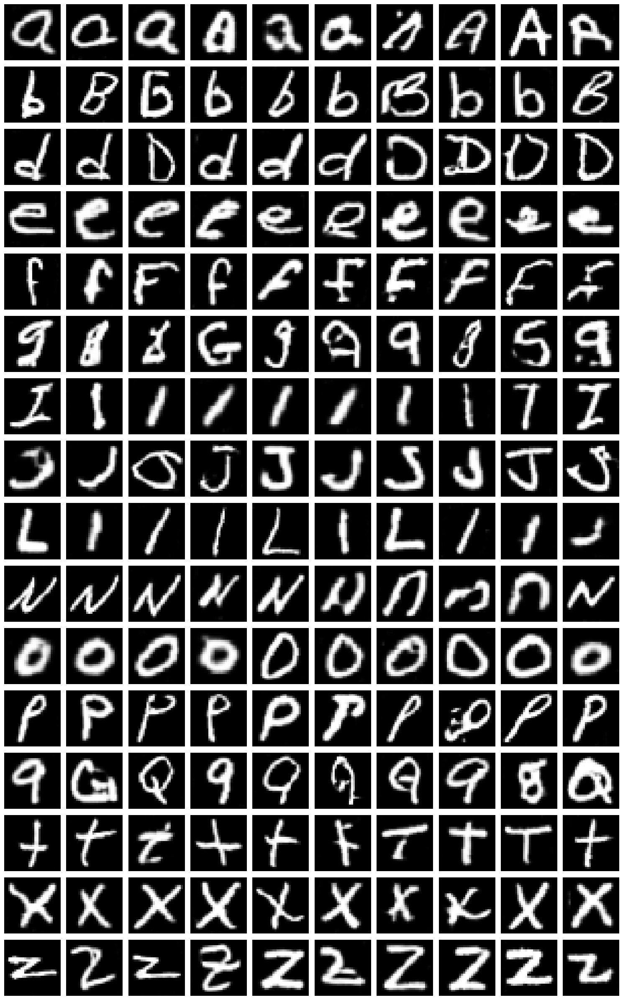

Epoch 491 | D Loss: 0.3375 | G Loss: 3.4040 | D Acc: 0.8516
Epoch 492 | D Loss: 0.2308 | G Loss: 1.6916 | D Acc: 0.9297
Epoch 493 | D Loss: 0.7692 | G Loss: 1.3384 | D Acc: 0.5859
Epoch 494 | D Loss: 0.2272 | G Loss: 2.1714 | D Acc: 0.9297
Epoch 495 | D Loss: 0.2558 | G Loss: 3.8188 | D Acc: 0.9141
Epoch 496 | D Loss: 0.3164 | G Loss: 2.0556 | D Acc: 0.8906
Epoch 497 | D Loss: 0.6917 | G Loss: 1.5961 | D Acc: 0.6250
Epoch 498 | D Loss: 0.4610 | G Loss: 2.5116 | D Acc: 0.7891
Epoch 499 | D Loss: 0.0850 | G Loss: 3.0530 | D Acc: 1.0000
Epoch 500 | D Loss: 0.2860 | G Loss: 2.0658 | D Acc: 0.9375
Preview images at epoch 500:


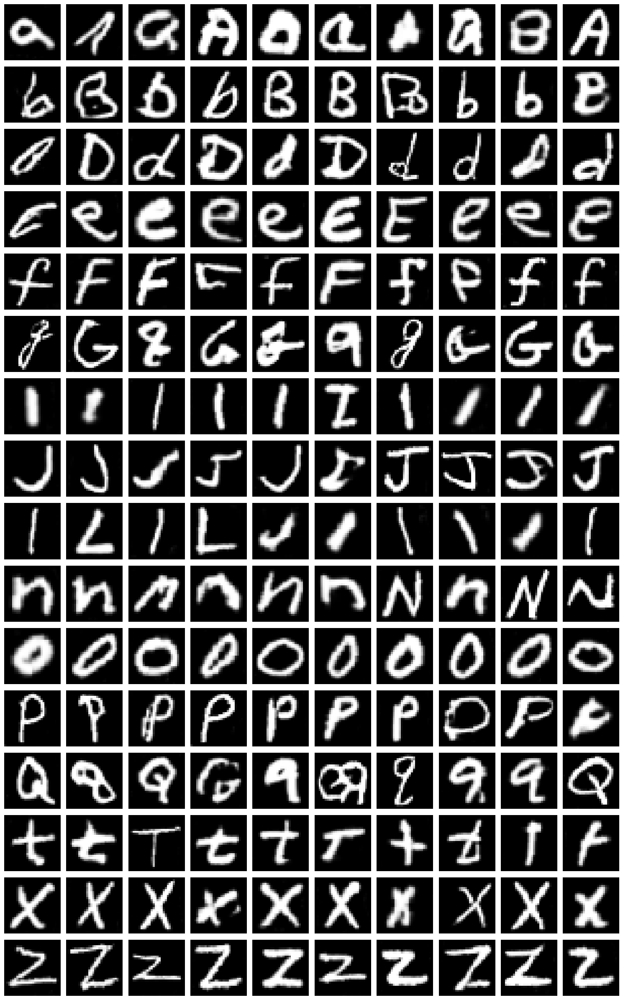

Model8 Final weights saved.


In [82]:
@tf.function
def train_step(real_imgs, real_labels):
    batch_size = tf.shape(real_imgs)[0]
    valid = tf.ones((batch_size, 1))
    fake = tf.zeros((batch_size, 1))

    # Generate fake images
    noise = tf.random.normal((batch_size, latent_dim))
    gen_labels = tf.random.uniform((batch_size, 1), 0, num_classes, dtype=tf.int32)
    fake_imgs = generator([noise, gen_labels], training=True)

    # --- Discriminator training ---
    with tf.GradientTape() as tape:
        d_real = discriminator([real_imgs, tf.expand_dims(real_labels, 1)], training=True)
        d_fake = discriminator([fake_imgs, gen_labels], training=True)
        d_loss = 0.5 * (bce(valid, d_real) + bce(fake, d_fake))
    d_grads = tape.gradient(d_loss, discriminator.trainable_variables)
    d_opt.apply_gradients(zip(d_grads, discriminator.trainable_variables))

    # Calculate accuracy
    real_acc = tf.reduce_mean(tf.cast(d_real > 0.5, tf.float32))
    fake_acc = tf.reduce_mean(tf.cast(d_fake < 0.5, tf.float32))
    d_acc = 0.5 * (real_acc + fake_acc)

    # --- Generator training ---
    noise = tf.random.normal((batch_size, latent_dim))
    gen_labels = tf.random.uniform((batch_size, 1), 0, num_classes, dtype=tf.int32)
    with tf.GradientTape() as tape:
        gen_imgs = generator([noise, gen_labels], training=True)
        validity = discriminator([gen_imgs, gen_labels], training=True)
        g_loss = bce(valid, validity)
    g_grads = tape.gradient(g_loss, generator.trainable_variables)
    g_opt.apply_gradients(zip(g_grads, generator.trainable_variables))

    return d_loss, g_loss, d_acc


def generate_and_show_images(model, num_per_class=10):
    all_images = []
    for label in range(num_classes):
        noise = tf.random.normal((num_per_class, latent_dim))
        labels = tf.constant([label]*num_per_class, shape=(num_per_class,1), dtype=tf.int32)
        gen_imgs = model([noise, labels], training=False)
        gen_imgs = 0.5 * gen_imgs + 0.5
        all_images.append(gen_imgs.numpy())
    all_images = np.concatenate(all_images, axis=0)
    fig, axes = plt.subplots(num_classes, num_per_class, figsize=(num_per_class*1.5, num_classes*1.5))
    for i in range(num_classes*num_per_class):
        row = i // num_per_class
        col = i % num_per_class
        ax = axes[row, col] if num_classes > 1 else axes[col]
        ax.imshow(all_images[i, :, :, 0], cmap='gray')
        ax.axis('off')
        if col == 0:
            ax.set_ylabel(chr(ord('A') + row), fontsize=12)
    plt.tight_layout()
    plt.show()


d_losses = []
g_losses = []
d_accuracies = []  # <-- NEW
best_g_loss = float('inf')

for epoch in range(1, epochs + 1):
    for real_imgs, real_labels in dataset:
        d_loss, g_loss, d_acc = train_step(real_imgs, real_labels)

    d_losses.append(d_loss.numpy())
    g_losses.append(g_loss.numpy())
    d_accuracies.append(d_acc.numpy())  # <-- store accuracy

    print(f"Epoch {epoch} | D Loss: {d_loss:.4f} | G Loss: {g_loss:.4f} | D Acc: {d_acc:.4f}")

    if g_loss < best_g_loss:
        best_g_loss = g_loss
        generator.save_weights("Model8_best_generator.h5")
        print(f"Best generator saved at epoch {epoch}")

    if epoch % 10 == 0:
        print(f"Preview images at epoch {epoch}:")
        generate_and_show_images(generator)

# Save final models
generator.save_weights("Model8_final_generator.h5")
discriminator.save_weights("Model8_final_discriminator.h5")
print("Model8 Final weights saved.")


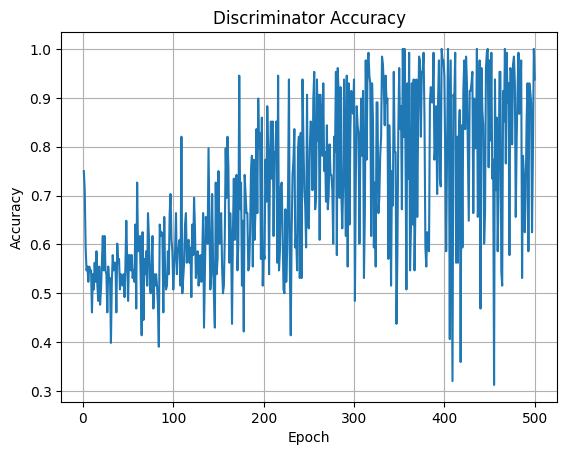

In [83]:
import matplotlib.pyplot as plt

plt.plot(range(1, epochs+1), d_accuracies)
plt.title("Discriminator Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.grid(True)
plt.show()


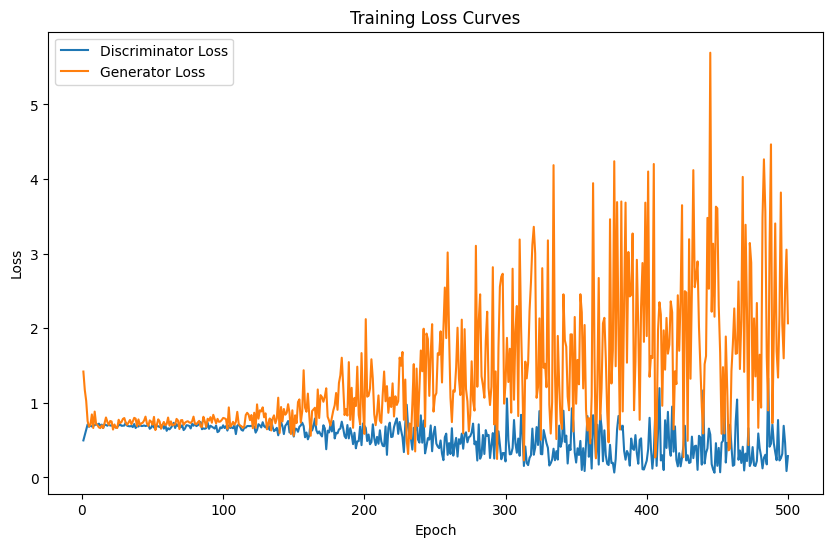

In [84]:

plt.figure(figsize=(10,6))
plt.plot(range(1, epochs+1), d_losses, label='Discriminator Loss')
plt.plot(range(1, epochs+1), g_losses, label='Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Curves')
plt.legend()
plt.show()


In [88]:


def generate_and_save_images(model, filename_prefix, num_per_class=10):
    save_dir = "Model8_improved_generated_images"
    os.makedirs(save_dir, exist_ok=True)  # create directory if not exists
    
    all_images = []
    for label in range(num_classes):
        noise = tf.random.normal((num_per_class, latent_dim))
        labels = tf.constant([label] * num_per_class, shape=(num_per_class, 1), dtype=tf.int32)
        gen_imgs = model([noise, labels], training=False)
        gen_imgs = 0.5 * gen_imgs + 0.5  # scale to [0,1]
        all_images.append(gen_imgs.numpy())
        
        # Save individual images per label
        label_dir = os.path.join(save_dir, f"class_{label_to_char[label]}")
        os.makedirs(label_dir, exist_ok=True)
        for i, img in enumerate(gen_imgs.numpy()):
            img_path = os.path.join(label_dir, f"{filename_prefix}_img_{i}.png")
            plt.imsave(img_path, img[:, :, 0], cmap='gray')
    
    all_images = np.concatenate(all_images, axis=0)
    
    # Save grid image
    fig, axes = plt.subplots(num_classes, num_per_class, figsize=(num_per_class*1.5, num_classes*1.5))
    for i in range(num_classes * num_per_class):
        row = i // num_per_class
        col = i % num_per_class
        ax = axes[row, col] if num_classes > 1 else axes[col]
        ax.imshow(all_images[i, :, :, 0], cmap='gray')
        ax.axis('off')
        if col == 0:
            ax.set_ylabel(chr(ord('A') + row), fontsize=12)
    plt.tight_layout()
    
    grid_path = os.path.join(save_dir, f"{filename_prefix}_grid.png")
    plt.savefig(grid_path)
    plt.show()
    plt.close(fig)
    
    print(f"Saved image grid to {grid_path}")



Preview from best weights:


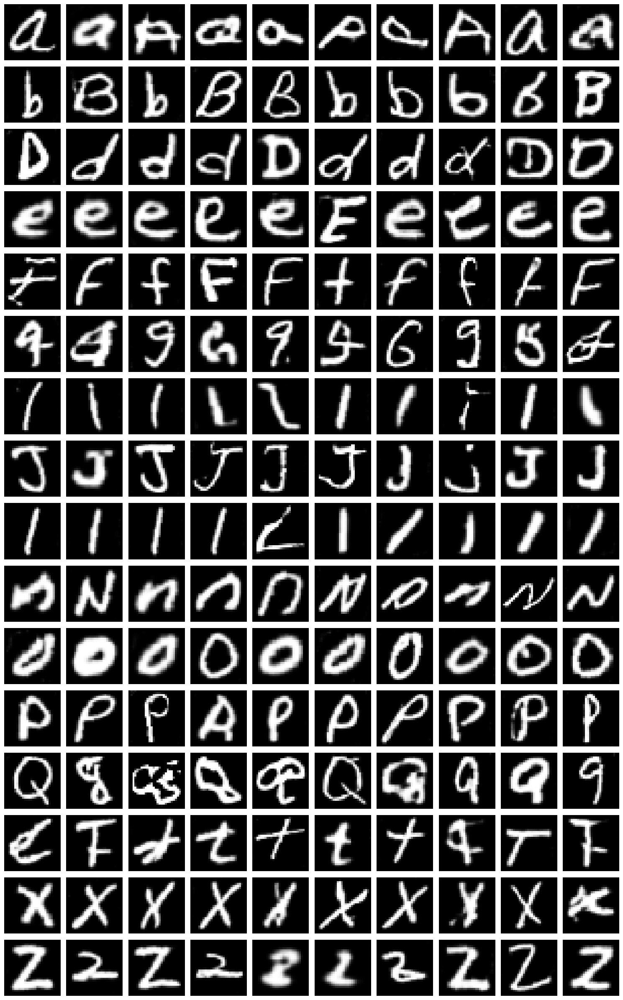

Saved image grid to Model8_improved_generated_images\Model8_160_BESTweights_improved_after_grid.png


In [90]:
# Preview from best weights
print("Preview from best weights:")
generator.load_weights("Model8_best_generator.h5")
generate_and_save_images(generator,  filename_prefix="Model8_160_BESTweights_improved_after")


Preview from final weights:


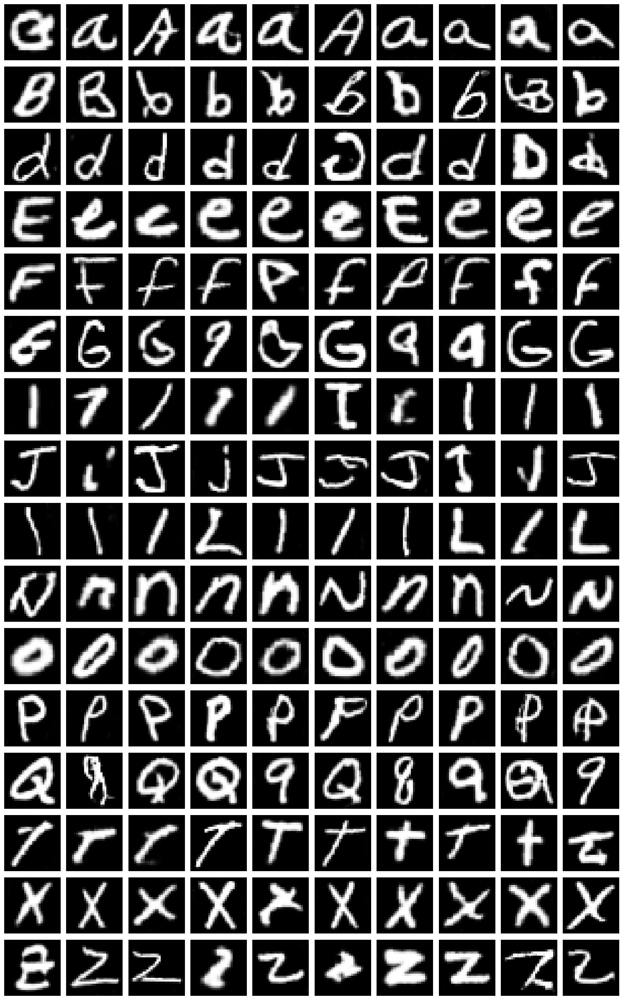

Saved image grid to Model8_improved_generated_images\Model8_160_finalweights_improved_after_grid.png


In [91]:

print("Preview from final weights:")
generator.load_weights("Model8_final_generator.h5")
generate_and_save_images(generator,  filename_prefix="Model8_160_finalweights_improved_after")


In [ ]:
##########################################33

Word 'DEEP LEANING' from weights:


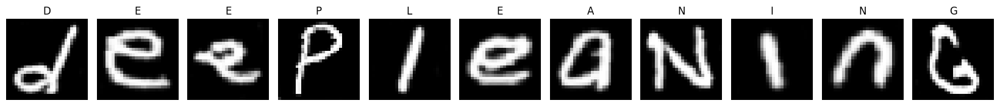

In [97]:
generator.load_weights("Model8_final_generator.h5")
print("Word 'DEEP LEANING' from weights:")
generate_word(generator, "DEEP LEANING")



Word 'DEEP LEANING' from final weights:


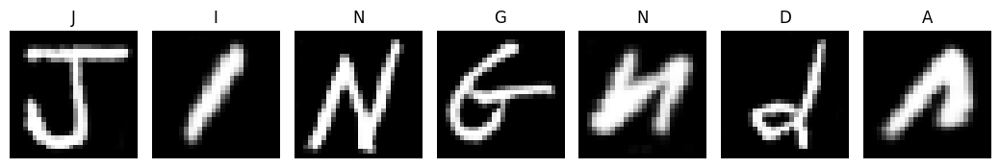

In [98]:
generator.load_weights("Model8_final_generator.h5")
print("Word 'DEEP LEANING' from final weights:")
generate_word(generator, "JING N DA")



<a id="imp3"></a>
# Model Improvement 3

## cDCGAN: V2 → V3 (What Changed & Why)

**Generator (G)**
- **V2:** After Dense→Reshape(7×7×256), adds a **refine layer**  
  `Conv2DTranspose(256, k=4, stride=1, same)` **before** upsampling.  
  Then upsample: 128 (→14×14) → 64 (→28×28).  
  Output: `Conv2D(k=3, tanh)`.

- **V3:** **Removed refine layer** at 7×7.  
  Direct upsample: 128 (→14×14) → 64 (→28×28).  
  Output: **larger kernel** `Conv2D(k=7, tanh)`.

**Discriminator (D)**
- Both V2 & V3 use **2 conv blocks**:  
  `Conv(64, s=2) → Conv(128, s=2, BN) → Flatten → Dense(1, sigmoid)`  
  (Both keep label-embedding concatenation and Dropout(0.3).)



#### **Optimizers**
- Both models still use Adam optimizer with `beta_1 = 0.5`.
- Generator learning rate kept at `0.0002` while discriminator learning rate lowered to `0.0001` for stability.

**Expected effect:**  
These changes aim to make training more stable by reducing discriminator dominance, giving the generator a better chance to improve image quality over training epochs.


In [45]:

latent_dim = 150
num_classes = 16
image_shape = (28, 28, 1)
batch_size = 64
epochs = 500

def improv_build_cdcgan_generator():
    noise = tf.keras.Input(shape=(latent_dim,))
    label = tf.keras.Input(shape=(1,), dtype='int32')
    label_embedding = tf.keras.layers.Embedding(num_classes, latent_dim)(label)
    label_embedding = tf.keras.layers.Flatten()(label_embedding)
    combined = tf.keras.layers.Multiply()([noise, label_embedding])
    x = tf.keras.layers.Dense(7*7*256, use_bias=False)(combined)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)
    x = tf.keras.layers.Reshape((7, 7, 256))(x)
    x = tf.keras.layers.Conv2DTranspose(128, 4, strides=2, padding='same', use_bias=False)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)
    x = tf.keras.layers.Conv2DTranspose(64, 4, strides=2, padding='same', use_bias=False)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)
    output_img = tf.keras.layers.Conv2D(1, 7, padding='same', activation='tanh')(x)
    return tf.keras.Model([noise, label], output_img)

def improv_build_cdcgan_discriminator():
    img = tf.keras.Input(shape=image_shape)
    label = tf.keras.Input(shape=(1,), dtype='int32')
    label_embedding = tf.keras.layers.Embedding(num_classes, np.prod(image_shape))(label)
    label_embedding = tf.keras.layers.Flatten()(label_embedding)
    label_embedding = tf.keras.layers.Reshape(image_shape)(label_embedding)
    combined = tf.keras.layers.Concatenate(axis=-1)([img, label_embedding])
    x = tf.keras.layers.Conv2D(64, 4, strides=2, padding='same')(combined)
    x = LeakyReLU(0.2)(x)
    x = Dropout(0.3)(x)
    x = tf.keras.layers.Conv2D(128, 4, strides=2, padding='same')(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(0.2)(x)
    x = Dropout(0.3)(x)
    x = tf.keras.layers.Flatten()(x)
    output = tf.keras.layers.Dense(1, activation='sigmoid')(x)
    return tf.keras.Model([img, label], output)

dataset = tf.data.Dataset.from_tensor_slices((images, mapped_labels))
dataset = dataset.shuffle(10000).batch(batch_size, drop_remainder=True)



In [46]:
generator = improv_build_cdcgan_generator()
discriminator = improv_build_cdcgan_discriminator()
bce = tf.keras.losses.BinaryCrossentropy()
g_opt = tf.keras.optimizers.Adam(0.0002, 0.5)
d_opt = tf.keras.optimizers.Adam(0.0001, 0.5)

generator.summary()
discriminator.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 1)]          0           []                               
                                                                                                  
 embedding (Embedding)          (None, 1, 150)       2400        ['input_2[0][0]']                
                                                                                                  
 input_1 (InputLayer)           [(None, 150)]        0           []                               
                                                                                                  
 flatten (Flatten)              (None, 150)          0           ['embedding[0][0]']              
                                                                                              

Epoch 1 | D Loss: 0.5992 | G Loss: 0.9364 | D Acc: 0.6719
Best generator saved at epoch 1
Epoch 2 | D Loss: 0.6541 | G Loss: 0.8020 | D Acc: 0.6641
Best generator saved at epoch 2
Epoch 3 | D Loss: 0.6511 | G Loss: 0.8981 | D Acc: 0.6016
Epoch 4 | D Loss: 0.7218 | G Loss: 0.7260 | D Acc: 0.4844
Best generator saved at epoch 4
Epoch 5 | D Loss: 0.6724 | G Loss: 0.7646 | D Acc: 0.5703
Epoch 6 | D Loss: 0.7255 | G Loss: 0.7428 | D Acc: 0.4766
Epoch 7 | D Loss: 0.7146 | G Loss: 0.7264 | D Acc: 0.5078
Epoch 8 | D Loss: 0.6883 | G Loss: 0.7089 | D Acc: 0.5391
Best generator saved at epoch 8
Epoch 9 | D Loss: 0.7045 | G Loss: 0.6978 | D Acc: 0.5156
Best generator saved at epoch 9
Epoch 10 | D Loss: 0.7038 | G Loss: 0.6900 | D Acc: 0.5078
Best generator saved at epoch 10
Preview images at epoch 10:


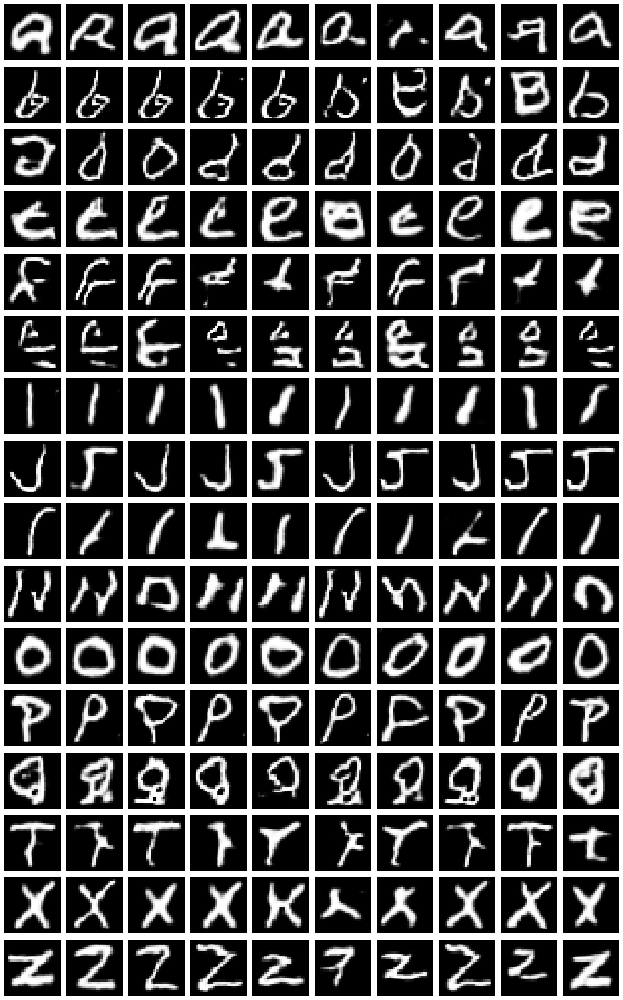

Epoch 11 | D Loss: 0.7171 | G Loss: 0.6954 | D Acc: 0.4844
Epoch 12 | D Loss: 0.6637 | G Loss: 0.7361 | D Acc: 0.6172
Epoch 13 | D Loss: 0.6922 | G Loss: 0.7140 | D Acc: 0.5156
Epoch 14 | D Loss: 0.6967 | G Loss: 0.7207 | D Acc: 0.5156
Epoch 15 | D Loss: 0.7030 | G Loss: 0.6825 | D Acc: 0.5000
Best generator saved at epoch 15
Epoch 16 | D Loss: 0.7002 | G Loss: 0.6848 | D Acc: 0.4531
Epoch 17 | D Loss: 0.6974 | G Loss: 0.6922 | D Acc: 0.5000
Epoch 18 | D Loss: 0.6933 | G Loss: 0.7067 | D Acc: 0.4922
Epoch 19 | D Loss: 0.6835 | G Loss: 0.7154 | D Acc: 0.5547
Epoch 20 | D Loss: 0.7078 | G Loss: 0.6876 | D Acc: 0.4688
Preview images at epoch 20:


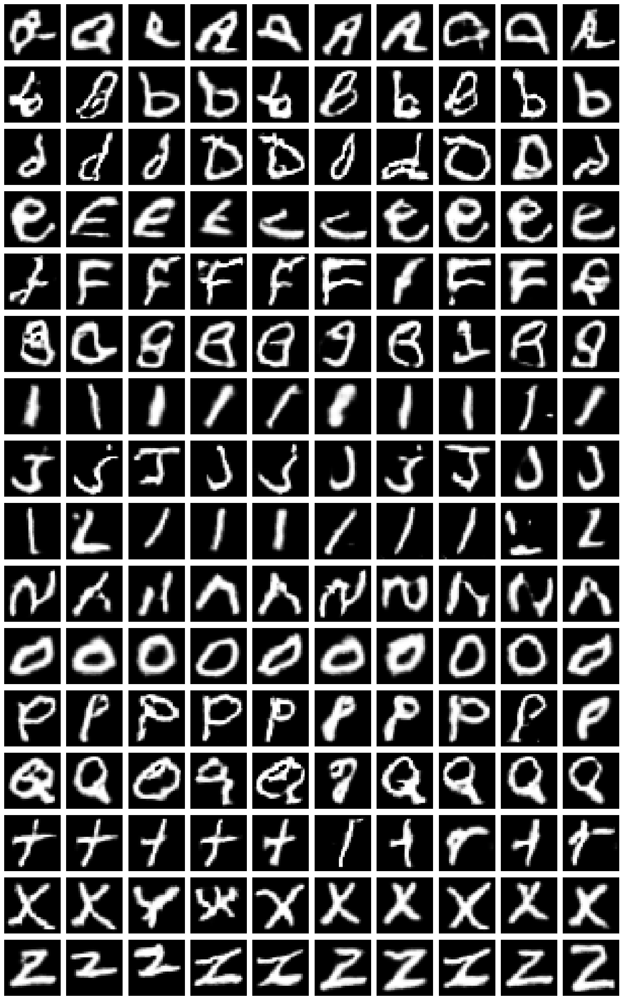

Epoch 21 | D Loss: 0.6754 | G Loss: 0.6610 | D Acc: 0.6172
Best generator saved at epoch 21
Epoch 22 | D Loss: 0.6943 | G Loss: 0.7062 | D Acc: 0.5234
Epoch 23 | D Loss: 0.6880 | G Loss: 0.6924 | D Acc: 0.5781
Epoch 24 | D Loss: 0.6950 | G Loss: 0.6956 | D Acc: 0.5547
Epoch 25 | D Loss: 0.6970 | G Loss: 0.6898 | D Acc: 0.4844
Epoch 26 | D Loss: 0.6793 | G Loss: 0.6792 | D Acc: 0.5469
Epoch 27 | D Loss: 0.7066 | G Loss: 0.6725 | D Acc: 0.4375
Epoch 28 | D Loss: 0.6799 | G Loss: 0.6934 | D Acc: 0.5625
Epoch 29 | D Loss: 0.7025 | G Loss: 0.6993 | D Acc: 0.4766
Epoch 30 | D Loss: 0.6867 | G Loss: 0.7050 | D Acc: 0.5391
Preview images at epoch 30:


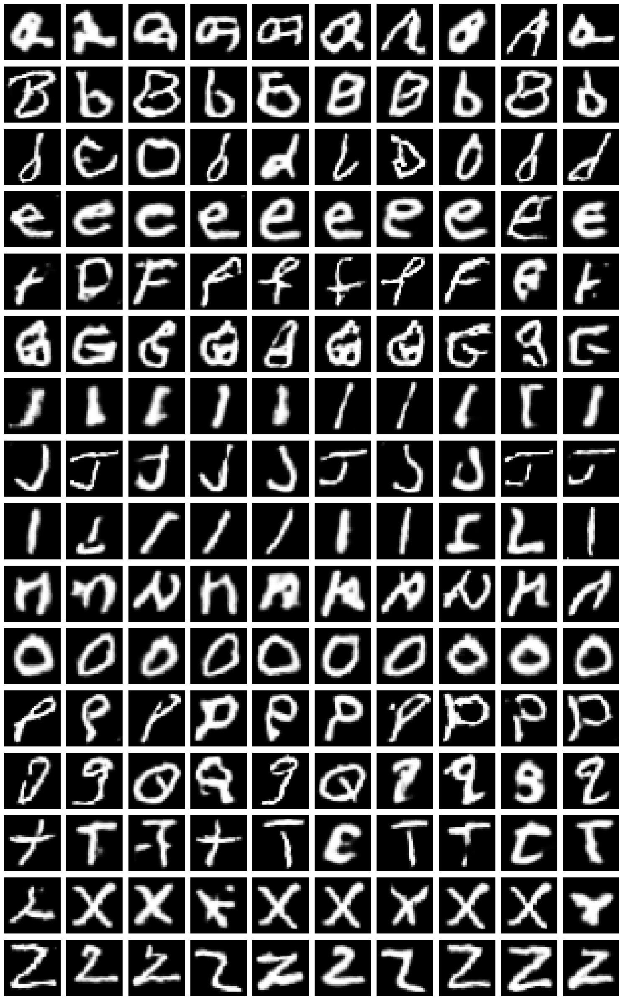

Epoch 31 | D Loss: 0.6876 | G Loss: 0.7359 | D Acc: 0.5625
Epoch 32 | D Loss: 0.6904 | G Loss: 0.7335 | D Acc: 0.5469
Epoch 33 | D Loss: 0.6920 | G Loss: 0.7022 | D Acc: 0.5703
Epoch 34 | D Loss: 0.7041 | G Loss: 0.7376 | D Acc: 0.4297
Epoch 35 | D Loss: 0.6686 | G Loss: 0.7046 | D Acc: 0.6250
Epoch 36 | D Loss: 0.7065 | G Loss: 0.7022 | D Acc: 0.4375
Epoch 37 | D Loss: 0.6936 | G Loss: 0.6732 | D Acc: 0.5156
Epoch 38 | D Loss: 0.6902 | G Loss: 0.6825 | D Acc: 0.4922
Epoch 39 | D Loss: 0.7116 | G Loss: 0.7177 | D Acc: 0.5312
Epoch 40 | D Loss: 0.6839 | G Loss: 0.7508 | D Acc: 0.5703
Preview images at epoch 40:


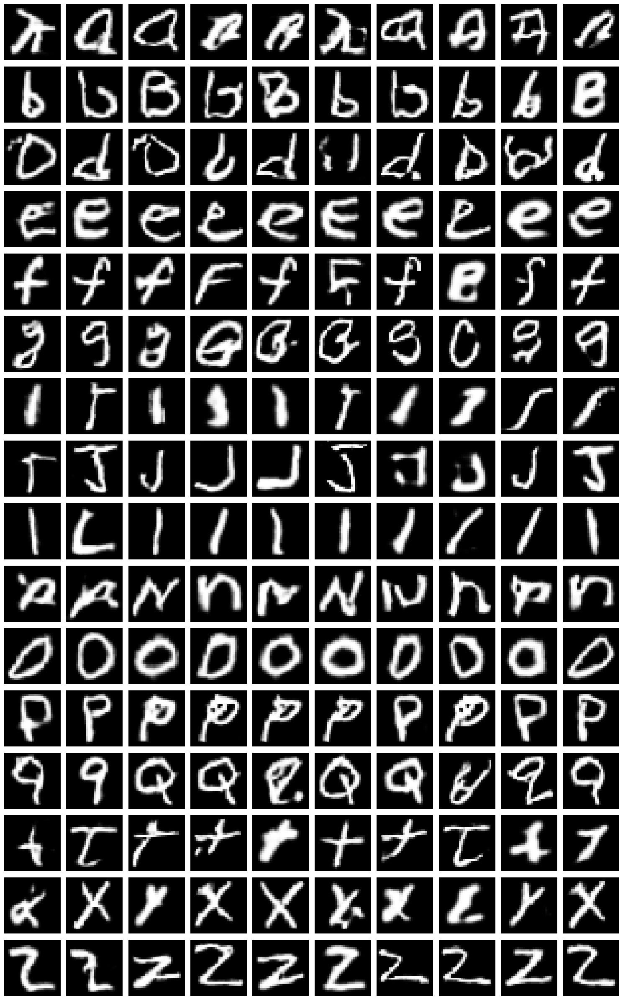

Epoch 41 | D Loss: 0.6856 | G Loss: 0.6900 | D Acc: 0.5781
Epoch 42 | D Loss: 0.6694 | G Loss: 0.7263 | D Acc: 0.6406
Epoch 43 | D Loss: 0.6990 | G Loss: 0.6992 | D Acc: 0.5156
Epoch 44 | D Loss: 0.6959 | G Loss: 0.7392 | D Acc: 0.5391
Epoch 45 | D Loss: 0.7011 | G Loss: 0.7491 | D Acc: 0.5078
Epoch 46 | D Loss: 0.6907 | G Loss: 0.7387 | D Acc: 0.5078
Epoch 47 | D Loss: 0.6966 | G Loss: 0.6765 | D Acc: 0.4922
Epoch 48 | D Loss: 0.6739 | G Loss: 0.7107 | D Acc: 0.6562
Epoch 49 | D Loss: 0.6922 | G Loss: 0.6983 | D Acc: 0.5234
Epoch 50 | D Loss: 0.6960 | G Loss: 0.7062 | D Acc: 0.5312
Preview images at epoch 50:


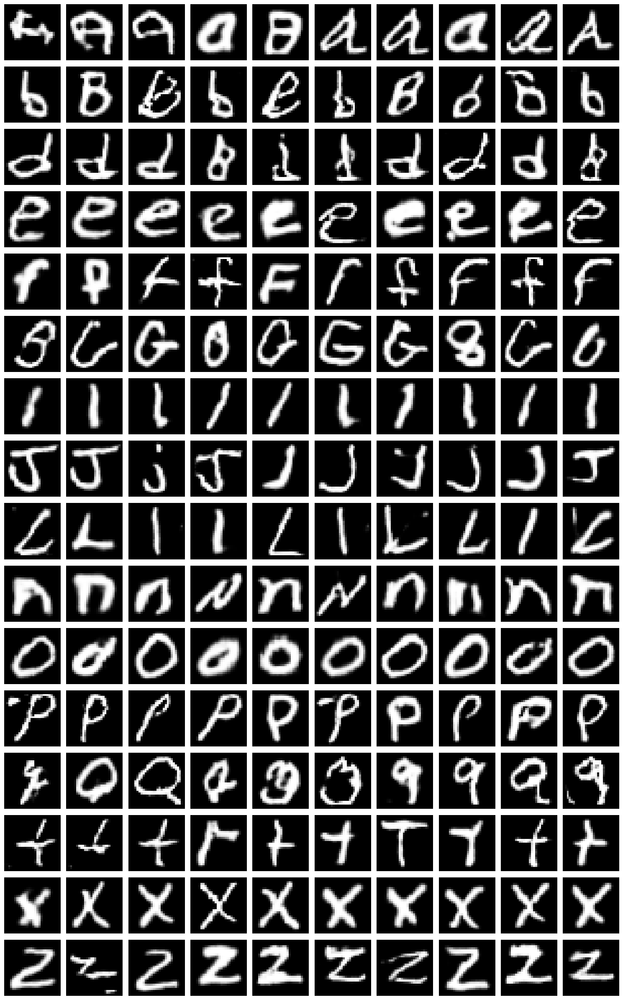

Epoch 51 | D Loss: 0.6848 | G Loss: 0.7329 | D Acc: 0.5547
Epoch 52 | D Loss: 0.6846 | G Loss: 0.6950 | D Acc: 0.5938
Epoch 53 | D Loss: 0.7137 | G Loss: 0.6889 | D Acc: 0.4141
Epoch 54 | D Loss: 0.6930 | G Loss: 0.7085 | D Acc: 0.4922
Epoch 55 | D Loss: 0.7329 | G Loss: 0.6799 | D Acc: 0.4062
Epoch 56 | D Loss: 0.7078 | G Loss: 0.7200 | D Acc: 0.5000
Epoch 57 | D Loss: 0.6914 | G Loss: 0.7131 | D Acc: 0.5078
Epoch 58 | D Loss: 0.6776 | G Loss: 0.6803 | D Acc: 0.6094
Epoch 59 | D Loss: 0.7087 | G Loss: 0.6898 | D Acc: 0.4375
Epoch 60 | D Loss: 0.6983 | G Loss: 0.7164 | D Acc: 0.5000
Preview images at epoch 60:


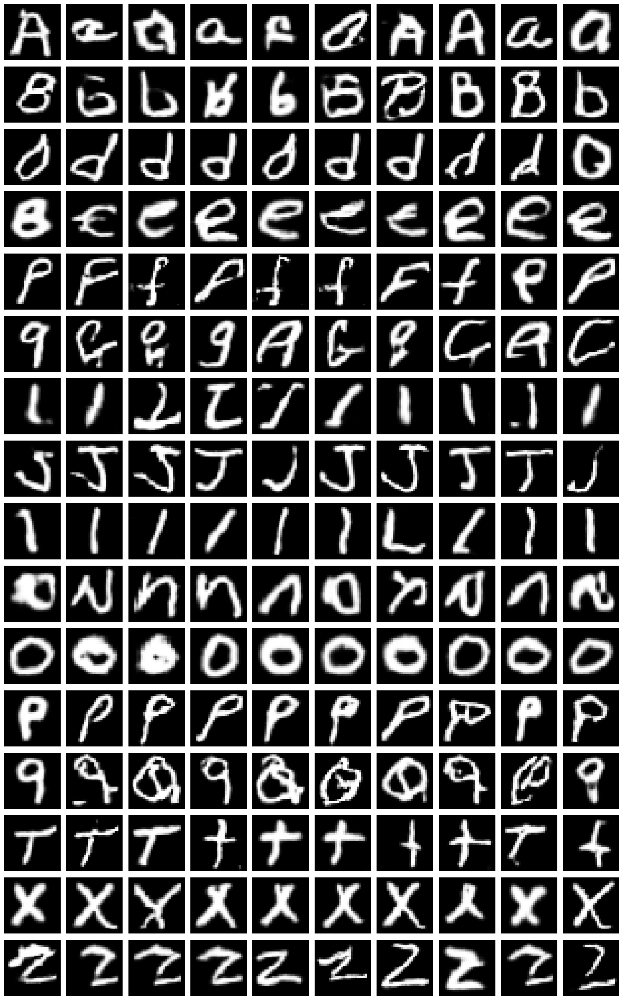

Epoch 61 | D Loss: 0.7090 | G Loss: 0.6784 | D Acc: 0.4297
Epoch 62 | D Loss: 0.6893 | G Loss: 0.6938 | D Acc: 0.5625
Epoch 63 | D Loss: 0.6927 | G Loss: 0.7048 | D Acc: 0.4844
Epoch 64 | D Loss: 0.6863 | G Loss: 0.7196 | D Acc: 0.5078
Epoch 65 | D Loss: 0.7003 | G Loss: 0.6961 | D Acc: 0.4609
Epoch 66 | D Loss: 0.6726 | G Loss: 0.6890 | D Acc: 0.6172
Epoch 67 | D Loss: 0.7019 | G Loss: 0.6861 | D Acc: 0.4922
Epoch 68 | D Loss: 0.7020 | G Loss: 0.6819 | D Acc: 0.5156
Epoch 69 | D Loss: 0.6985 | G Loss: 0.6759 | D Acc: 0.5000
Epoch 70 | D Loss: 0.7024 | G Loss: 0.7295 | D Acc: 0.4766
Preview images at epoch 70:


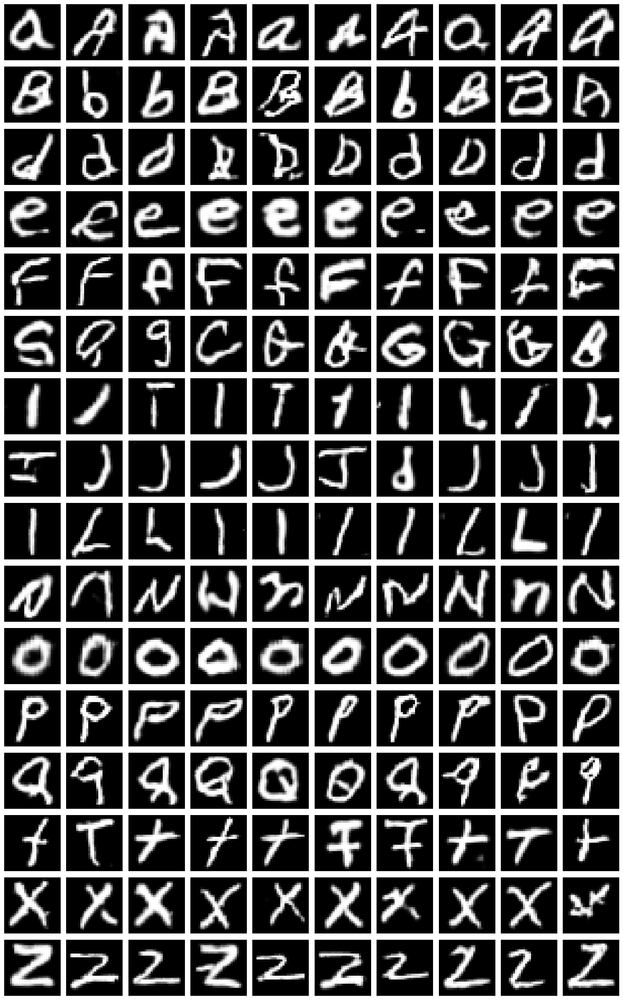

Epoch 71 | D Loss: 0.6807 | G Loss: 0.7099 | D Acc: 0.5859
Epoch 72 | D Loss: 0.7159 | G Loss: 0.6955 | D Acc: 0.3984
Epoch 73 | D Loss: 0.6935 | G Loss: 0.7045 | D Acc: 0.4922
Epoch 74 | D Loss: 0.7085 | G Loss: 0.6735 | D Acc: 0.4219
Epoch 75 | D Loss: 0.6907 | G Loss: 0.7082 | D Acc: 0.5000
Epoch 76 | D Loss: 0.7129 | G Loss: 0.7090 | D Acc: 0.4062
Epoch 77 | D Loss: 0.6932 | G Loss: 0.6941 | D Acc: 0.5078
Epoch 78 | D Loss: 0.6771 | G Loss: 0.7081 | D Acc: 0.6484
Epoch 79 | D Loss: 0.6894 | G Loss: 0.7019 | D Acc: 0.6172
Epoch 80 | D Loss: 0.7027 | G Loss: 0.6986 | D Acc: 0.4688
Preview images at epoch 80:


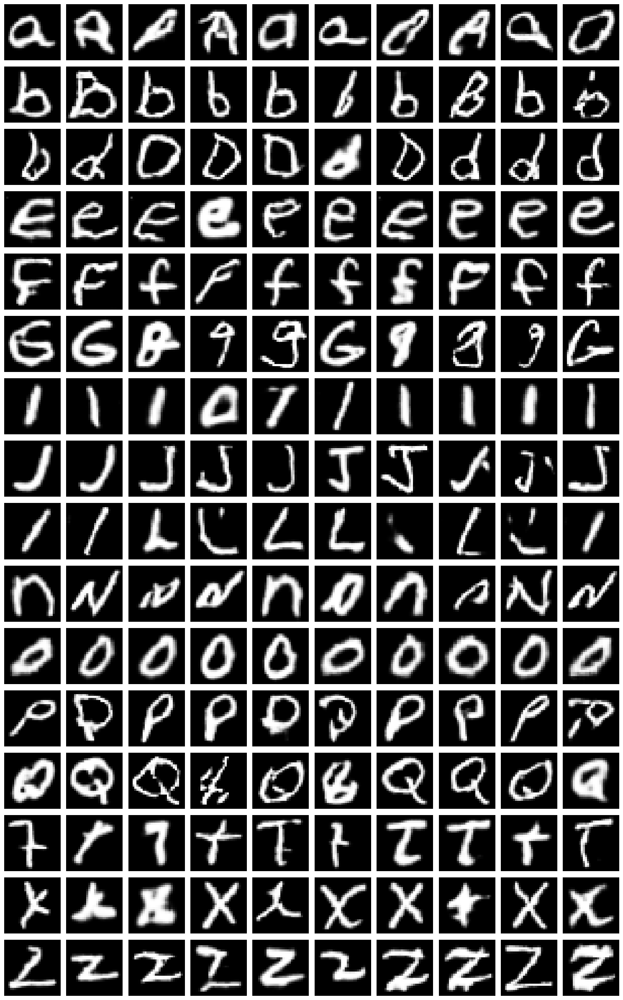

Epoch 81 | D Loss: 0.6678 | G Loss: 0.6777 | D Acc: 0.6016
Epoch 82 | D Loss: 0.6973 | G Loss: 0.7035 | D Acc: 0.5156
Epoch 83 | D Loss: 0.7010 | G Loss: 0.7198 | D Acc: 0.4844
Epoch 84 | D Loss: 0.6967 | G Loss: 0.7180 | D Acc: 0.4766
Epoch 85 | D Loss: 0.6929 | G Loss: 0.6434 | D Acc: 0.4609
Best generator saved at epoch 85
Epoch 86 | D Loss: 0.7093 | G Loss: 0.6990 | D Acc: 0.4375
Epoch 87 | D Loss: 0.7002 | G Loss: 0.6896 | D Acc: 0.5703
Epoch 88 | D Loss: 0.6885 | G Loss: 0.7407 | D Acc: 0.5781
Epoch 89 | D Loss: 0.7009 | G Loss: 0.6800 | D Acc: 0.4531
Epoch 90 | D Loss: 0.7145 | G Loss: 0.6696 | D Acc: 0.4062
Preview images at epoch 90:


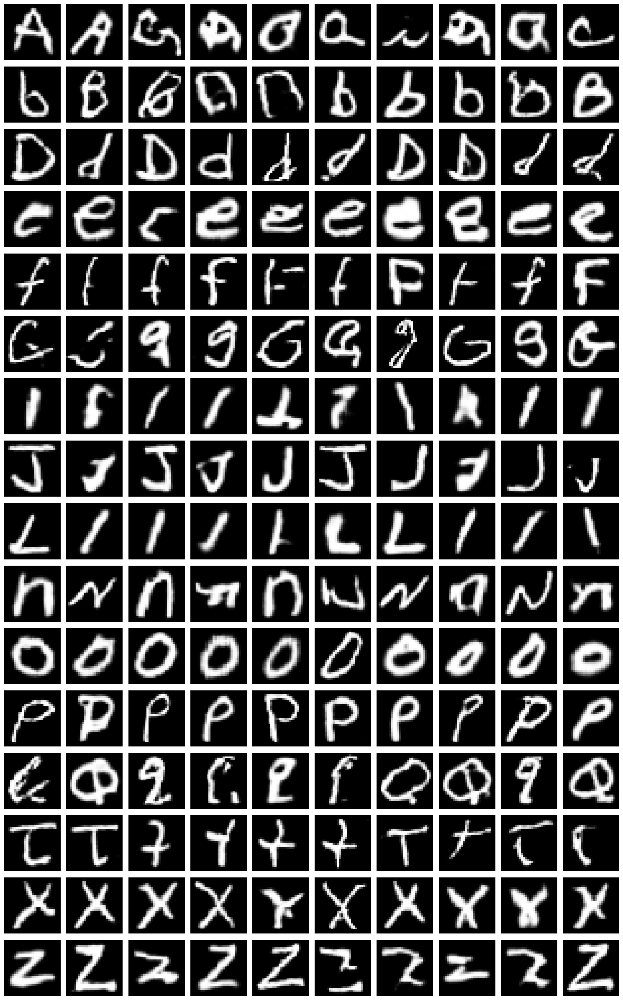

Epoch 91 | D Loss: 0.7087 | G Loss: 0.6987 | D Acc: 0.4375
Epoch 92 | D Loss: 0.7207 | G Loss: 0.7217 | D Acc: 0.3750
Epoch 93 | D Loss: 0.6953 | G Loss: 0.6933 | D Acc: 0.5234
Epoch 94 | D Loss: 0.6857 | G Loss: 0.7330 | D Acc: 0.5547
Epoch 95 | D Loss: 0.6717 | G Loss: 0.6861 | D Acc: 0.6172
Epoch 96 | D Loss: 0.6931 | G Loss: 0.6789 | D Acc: 0.5000
Epoch 97 | D Loss: 0.6800 | G Loss: 0.6869 | D Acc: 0.6250
Epoch 98 | D Loss: 0.6859 | G Loss: 0.6901 | D Acc: 0.5391
Epoch 99 | D Loss: 0.7006 | G Loss: 0.6981 | D Acc: 0.4609
Epoch 100 | D Loss: 0.6897 | G Loss: 0.6871 | D Acc: 0.5859
Preview images at epoch 100:


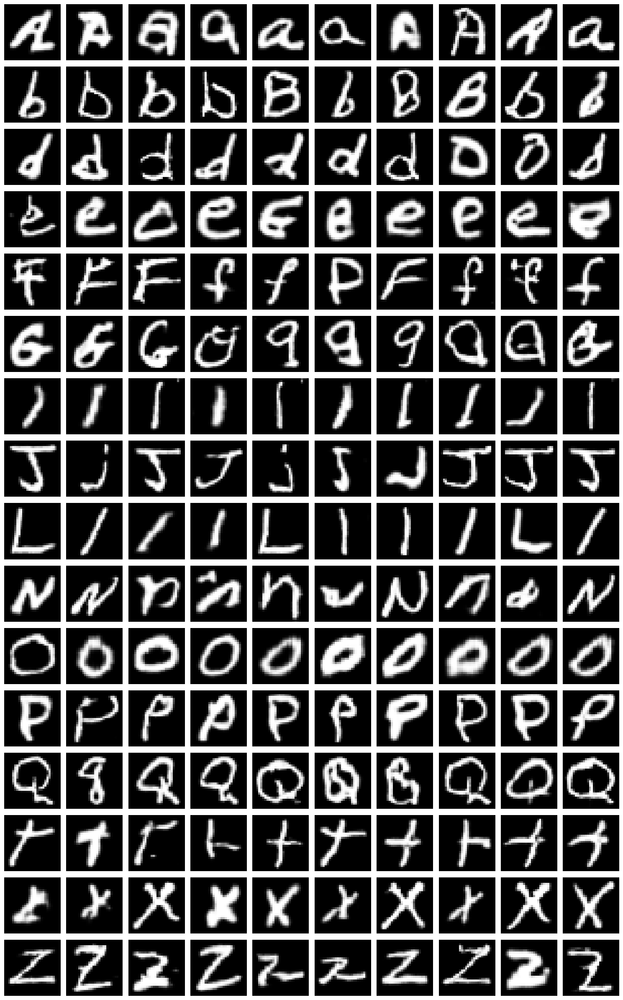

Epoch 101 | D Loss: 0.7025 | G Loss: 0.7065 | D Acc: 0.5000
Epoch 102 | D Loss: 0.6743 | G Loss: 0.7043 | D Acc: 0.5703
Epoch 103 | D Loss: 0.7049 | G Loss: 0.7090 | D Acc: 0.4531
Epoch 104 | D Loss: 0.6719 | G Loss: 0.7072 | D Acc: 0.6094
Epoch 105 | D Loss: 0.6992 | G Loss: 0.6930 | D Acc: 0.4766
Epoch 106 | D Loss: 0.6896 | G Loss: 0.7094 | D Acc: 0.5391
Epoch 107 | D Loss: 0.6973 | G Loss: 0.6932 | D Acc: 0.4922
Epoch 108 | D Loss: 0.6791 | G Loss: 0.7352 | D Acc: 0.5938
Epoch 109 | D Loss: 0.6923 | G Loss: 0.6693 | D Acc: 0.5469
Epoch 110 | D Loss: 0.6860 | G Loss: 0.6755 | D Acc: 0.5391
Preview images at epoch 110:


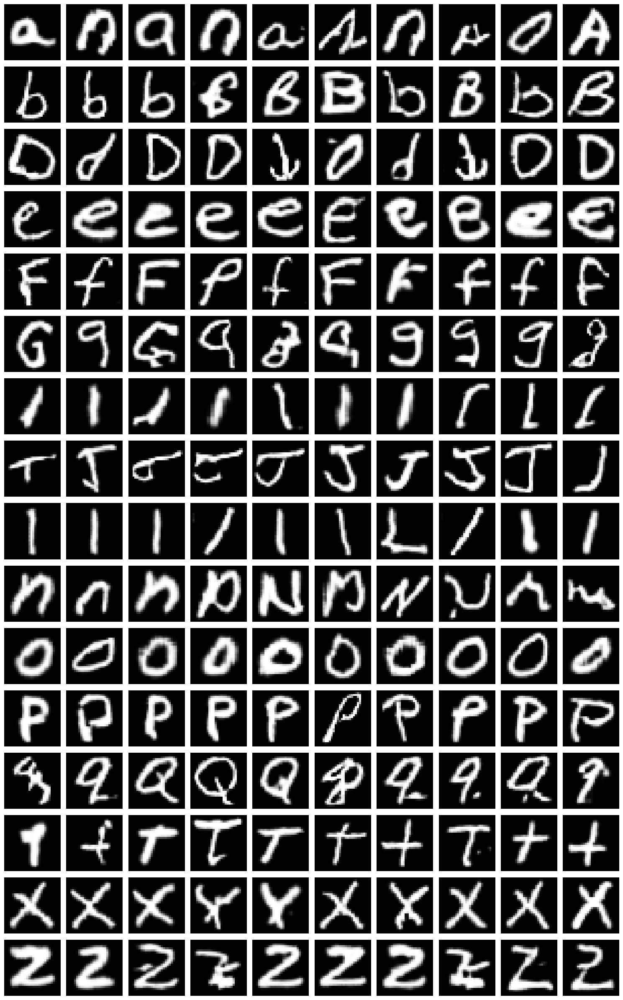

Epoch 111 | D Loss: 0.6799 | G Loss: 0.6485 | D Acc: 0.5625
Epoch 112 | D Loss: 0.6686 | G Loss: 0.6958 | D Acc: 0.6406
Epoch 113 | D Loss: 0.7119 | G Loss: 0.6729 | D Acc: 0.4141
Epoch 114 | D Loss: 0.6875 | G Loss: 0.7023 | D Acc: 0.5234
Epoch 115 | D Loss: 0.6937 | G Loss: 0.6742 | D Acc: 0.5234
Epoch 116 | D Loss: 0.6934 | G Loss: 0.7124 | D Acc: 0.5156
Epoch 117 | D Loss: 0.6888 | G Loss: 0.6420 | D Acc: 0.5547
Best generator saved at epoch 117
Epoch 118 | D Loss: 0.6900 | G Loss: 0.6929 | D Acc: 0.5234
Epoch 119 | D Loss: 0.6890 | G Loss: 0.6959 | D Acc: 0.5391
Epoch 120 | D Loss: 0.6951 | G Loss: 0.6861 | D Acc: 0.5078
Preview images at epoch 120:


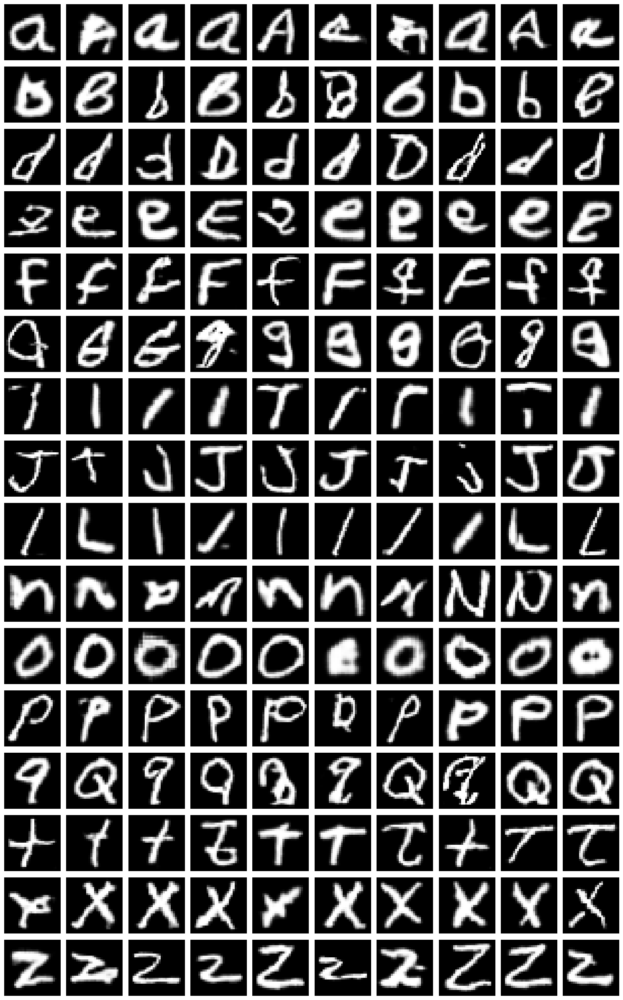

Epoch 121 | D Loss: 0.7117 | G Loss: 0.6986 | D Acc: 0.3984
Epoch 122 | D Loss: 0.6946 | G Loss: 0.6977 | D Acc: 0.5000
Epoch 123 | D Loss: 0.6992 | G Loss: 0.6887 | D Acc: 0.5312
Epoch 124 | D Loss: 0.6760 | G Loss: 0.7029 | D Acc: 0.5859
Epoch 125 | D Loss: 0.6928 | G Loss: 0.6831 | D Acc: 0.5625
Epoch 126 | D Loss: 0.6963 | G Loss: 0.6710 | D Acc: 0.5000
Epoch 127 | D Loss: 0.6951 | G Loss: 0.6942 | D Acc: 0.5469
Epoch 128 | D Loss: 0.6659 | G Loss: 0.6903 | D Acc: 0.6641
Epoch 129 | D Loss: 0.6889 | G Loss: 0.7286 | D Acc: 0.5391
Epoch 130 | D Loss: 0.6830 | G Loss: 0.7152 | D Acc: 0.5391
Preview images at epoch 130:


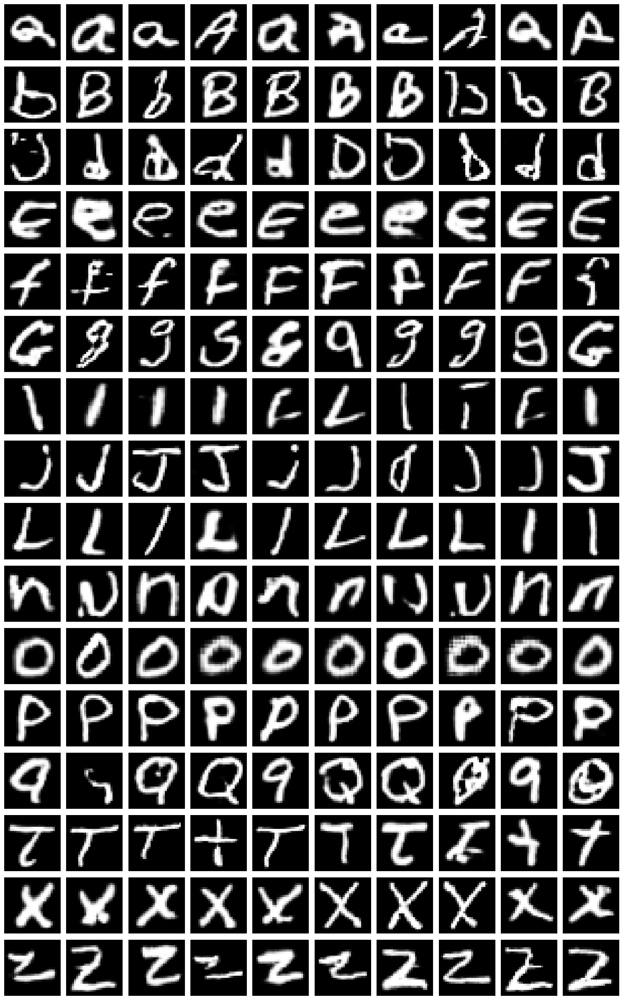

Epoch 131 | D Loss: 0.7045 | G Loss: 0.6980 | D Acc: 0.4375
Epoch 132 | D Loss: 0.6778 | G Loss: 0.7146 | D Acc: 0.5938
Epoch 133 | D Loss: 0.6819 | G Loss: 0.6672 | D Acc: 0.6094
Epoch 134 | D Loss: 0.6866 | G Loss: 0.6702 | D Acc: 0.5547
Epoch 135 | D Loss: 0.6747 | G Loss: 0.7597 | D Acc: 0.6172
Epoch 136 | D Loss: 0.6856 | G Loss: 0.6907 | D Acc: 0.5547
Epoch 137 | D Loss: 0.7018 | G Loss: 0.6604 | D Acc: 0.4375
Epoch 138 | D Loss: 0.6998 | G Loss: 0.7187 | D Acc: 0.4766
Epoch 139 | D Loss: 0.6899 | G Loss: 0.6881 | D Acc: 0.5000
Epoch 140 | D Loss: 0.7026 | G Loss: 0.7074 | D Acc: 0.4609
Preview images at epoch 140:


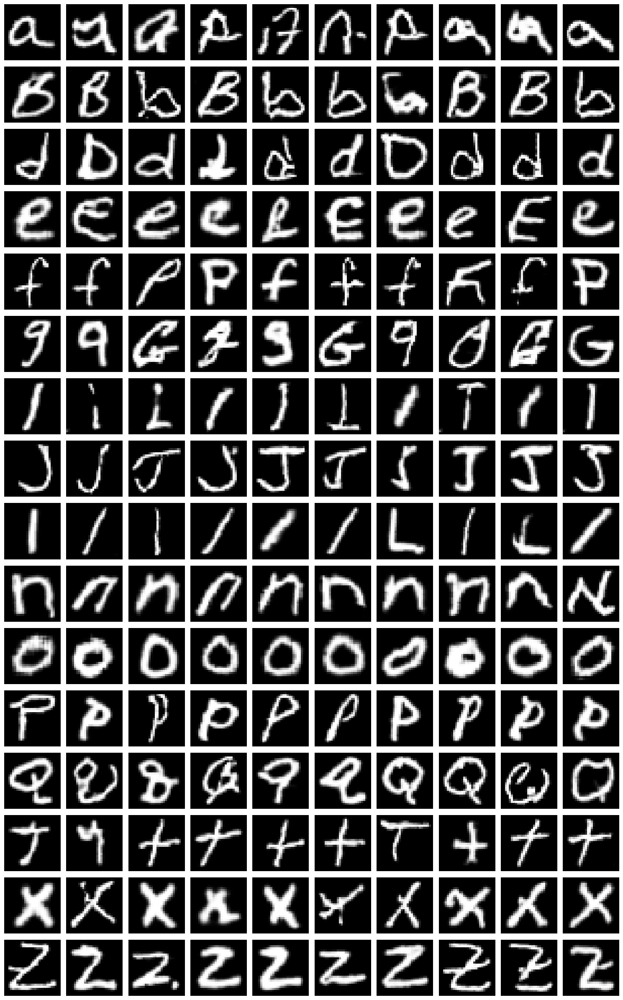

Epoch 141 | D Loss: 0.6884 | G Loss: 0.6977 | D Acc: 0.5703
Epoch 142 | D Loss: 0.7000 | G Loss: 0.7173 | D Acc: 0.4453
Epoch 143 | D Loss: 0.6960 | G Loss: 0.7170 | D Acc: 0.5156
Epoch 144 | D Loss: 0.6977 | G Loss: 0.6928 | D Acc: 0.4844
Epoch 145 | D Loss: 0.6773 | G Loss: 0.6837 | D Acc: 0.6172
Epoch 146 | D Loss: 0.7019 | G Loss: 0.6951 | D Acc: 0.4219
Epoch 147 | D Loss: 0.6831 | G Loss: 0.6533 | D Acc: 0.5859
Epoch 148 | D Loss: 0.7087 | G Loss: 0.6908 | D Acc: 0.4453
Epoch 149 | D Loss: 0.6997 | G Loss: 0.7158 | D Acc: 0.4141
Epoch 150 | D Loss: 0.6917 | G Loss: 0.6735 | D Acc: 0.5156
Preview images at epoch 150:


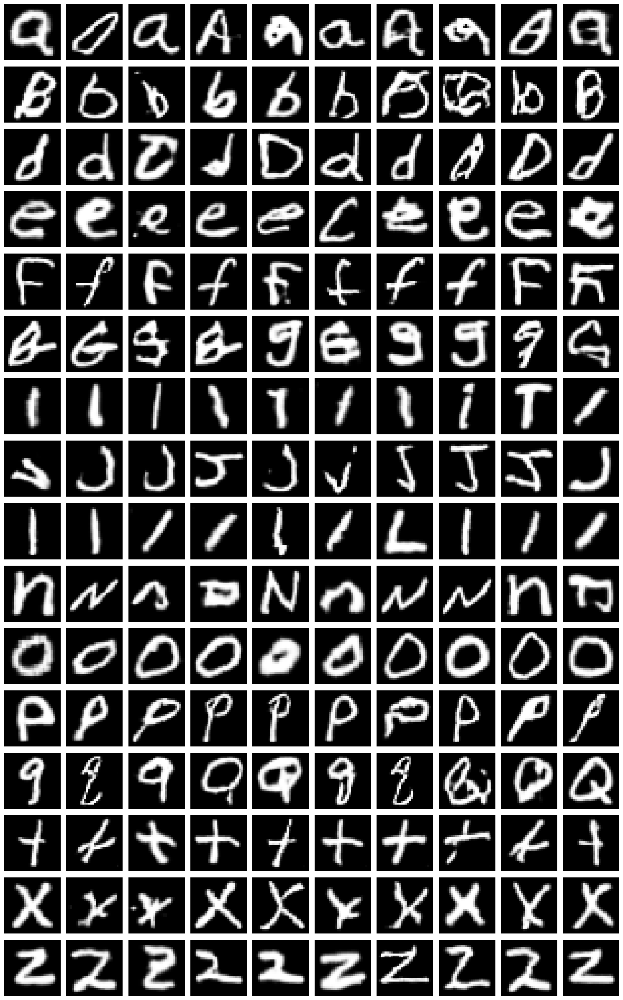

Epoch 151 | D Loss: 0.6944 | G Loss: 0.6895 | D Acc: 0.5391
Epoch 152 | D Loss: 0.6962 | G Loss: 0.7286 | D Acc: 0.5391
Epoch 153 | D Loss: 0.7012 | G Loss: 0.7147 | D Acc: 0.4844
Epoch 154 | D Loss: 0.7027 | G Loss: 0.6993 | D Acc: 0.4766
Epoch 155 | D Loss: 0.7030 | G Loss: 0.6883 | D Acc: 0.4531
Epoch 156 | D Loss: 0.6941 | G Loss: 0.7068 | D Acc: 0.5312
Epoch 157 | D Loss: 0.7018 | G Loss: 0.6725 | D Acc: 0.4922
Epoch 158 | D Loss: 0.7012 | G Loss: 0.7258 | D Acc: 0.5000
Epoch 159 | D Loss: 0.7014 | G Loss: 0.7061 | D Acc: 0.4844
Epoch 160 | D Loss: 0.7000 | G Loss: 0.7160 | D Acc: 0.4531
Preview images at epoch 160:


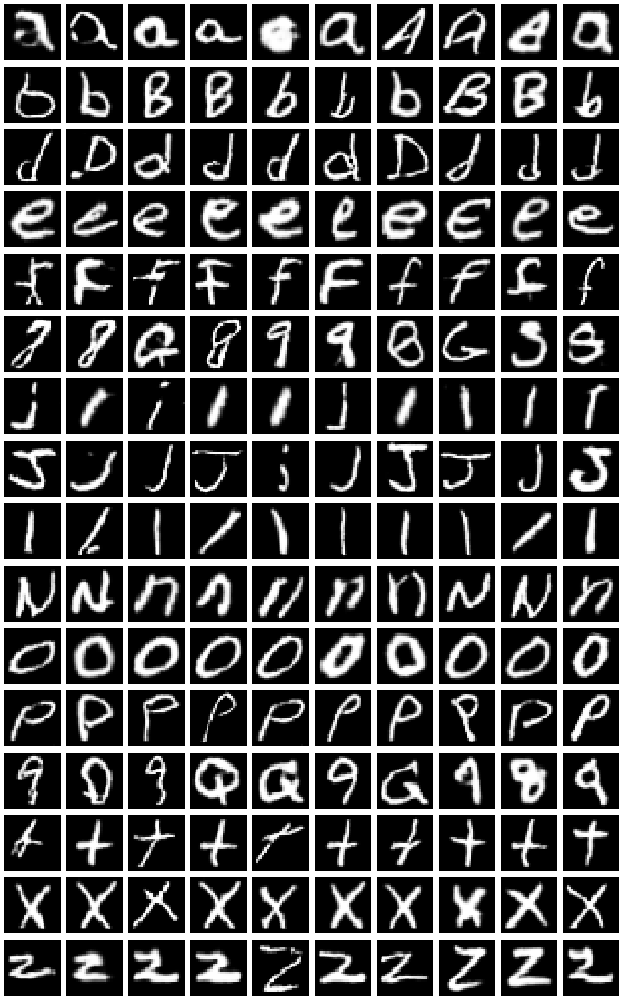

Epoch 161 | D Loss: 0.6752 | G Loss: 0.6893 | D Acc: 0.6250
Epoch 162 | D Loss: 0.6697 | G Loss: 0.6817 | D Acc: 0.6172
Epoch 163 | D Loss: 0.7044 | G Loss: 0.6960 | D Acc: 0.4531
Epoch 164 | D Loss: 0.6919 | G Loss: 0.7119 | D Acc: 0.5000
Epoch 165 | D Loss: 0.6814 | G Loss: 0.7276 | D Acc: 0.5859
Epoch 166 | D Loss: 0.7038 | G Loss: 0.7145 | D Acc: 0.4844
Epoch 167 | D Loss: 0.6851 | G Loss: 0.6877 | D Acc: 0.5547
Epoch 168 | D Loss: 0.6904 | G Loss: 0.7027 | D Acc: 0.5547
Epoch 169 | D Loss: 0.7022 | G Loss: 0.6963 | D Acc: 0.4375
Epoch 170 | D Loss: 0.6783 | G Loss: 0.6996 | D Acc: 0.6016
Preview images at epoch 170:


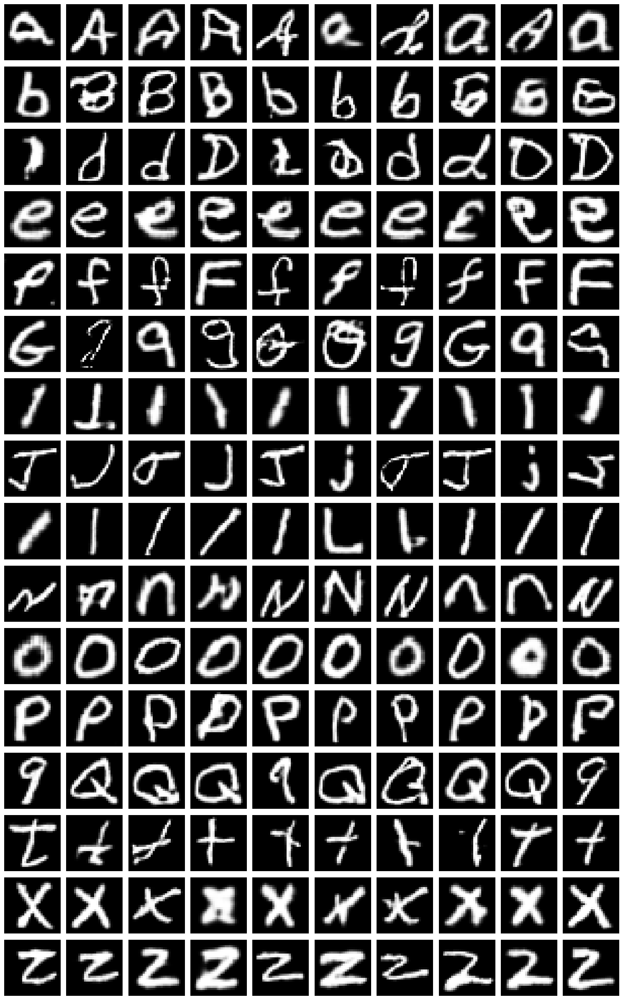

Epoch 171 | D Loss: 0.6854 | G Loss: 0.6728 | D Acc: 0.5703
Epoch 172 | D Loss: 0.6979 | G Loss: 0.6903 | D Acc: 0.4844
Epoch 173 | D Loss: 0.6775 | G Loss: 0.6893 | D Acc: 0.5938
Epoch 174 | D Loss: 0.6743 | G Loss: 0.7224 | D Acc: 0.6328
Epoch 175 | D Loss: 0.6961 | G Loss: 0.6711 | D Acc: 0.5391
Epoch 176 | D Loss: 0.6929 | G Loss: 0.7193 | D Acc: 0.5000
Epoch 177 | D Loss: 0.6792 | G Loss: 0.6832 | D Acc: 0.5703
Epoch 178 | D Loss: 0.7010 | G Loss: 0.6931 | D Acc: 0.5078
Epoch 179 | D Loss: 0.6925 | G Loss: 0.6958 | D Acc: 0.5078
Epoch 180 | D Loss: 0.6781 | G Loss: 0.6893 | D Acc: 0.6328
Preview images at epoch 180:


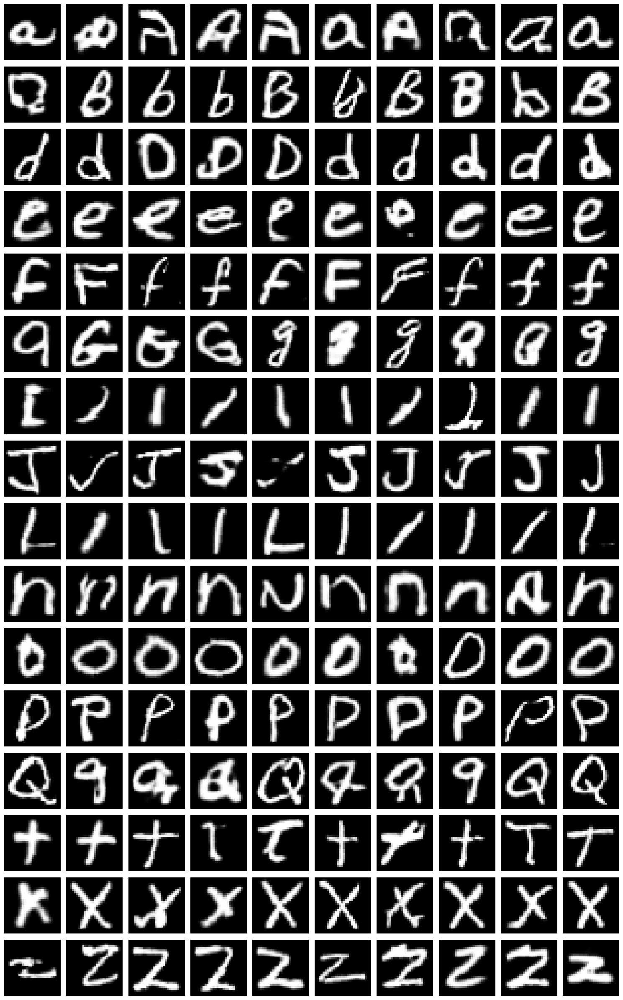

Epoch 181 | D Loss: 0.6834 | G Loss: 0.6927 | D Acc: 0.5312
Epoch 182 | D Loss: 0.7046 | G Loss: 0.6796 | D Acc: 0.4453
Epoch 183 | D Loss: 0.6703 | G Loss: 0.7103 | D Acc: 0.6797
Epoch 184 | D Loss: 0.6919 | G Loss: 0.6981 | D Acc: 0.5000
Epoch 185 | D Loss: 0.6934 | G Loss: 0.7204 | D Acc: 0.5469
Epoch 186 | D Loss: 0.6870 | G Loss: 0.7359 | D Acc: 0.5156
Epoch 187 | D Loss: 0.6755 | G Loss: 0.7043 | D Acc: 0.5938
Epoch 188 | D Loss: 0.6783 | G Loss: 0.6552 | D Acc: 0.5781
Epoch 189 | D Loss: 0.6605 | G Loss: 0.7092 | D Acc: 0.6484
Epoch 190 | D Loss: 0.7189 | G Loss: 0.7093 | D Acc: 0.4219
Preview images at epoch 190:


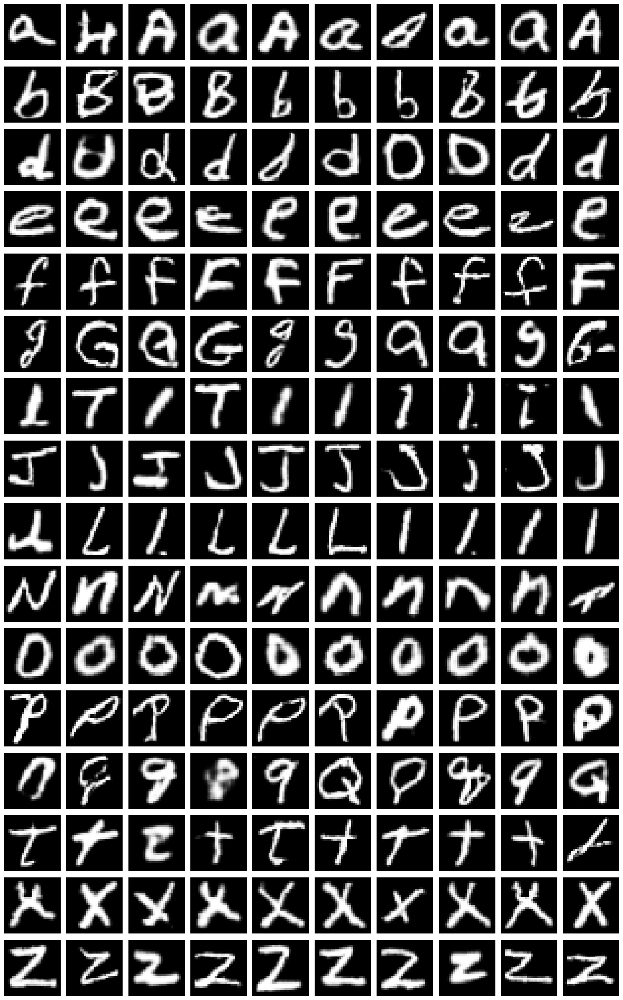

Epoch 191 | D Loss: 0.6968 | G Loss: 0.6993 | D Acc: 0.4922
Epoch 192 | D Loss: 0.7118 | G Loss: 0.6964 | D Acc: 0.3672
Epoch 193 | D Loss: 0.6923 | G Loss: 0.6634 | D Acc: 0.5547
Epoch 194 | D Loss: 0.6781 | G Loss: 0.6762 | D Acc: 0.6406
Epoch 195 | D Loss: 0.7004 | G Loss: 0.6818 | D Acc: 0.4844
Epoch 196 | D Loss: 0.6802 | G Loss: 0.6856 | D Acc: 0.6250
Epoch 197 | D Loss: 0.6948 | G Loss: 0.7111 | D Acc: 0.5312
Epoch 198 | D Loss: 0.6588 | G Loss: 0.6624 | D Acc: 0.7344
Epoch 199 | D Loss: 0.6821 | G Loss: 0.6930 | D Acc: 0.5625
Epoch 200 | D Loss: 0.6922 | G Loss: 0.6874 | D Acc: 0.5234
Preview images at epoch 200:


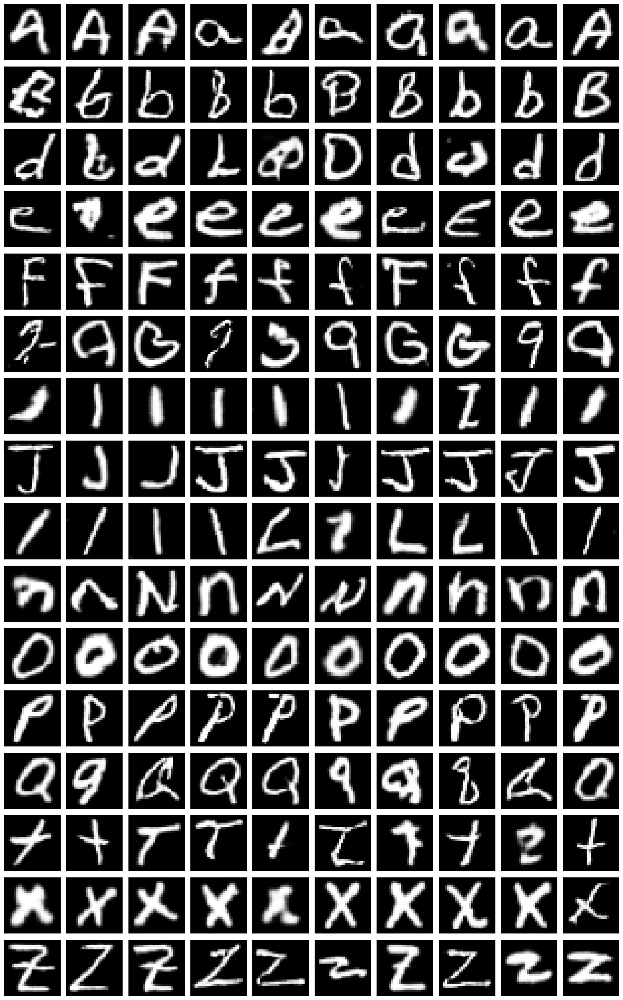

Epoch 201 | D Loss: 0.6865 | G Loss: 0.6964 | D Acc: 0.5625
Epoch 202 | D Loss: 0.6911 | G Loss: 0.7153 | D Acc: 0.4922
Epoch 203 | D Loss: 0.6883 | G Loss: 0.7193 | D Acc: 0.5234
Epoch 204 | D Loss: 0.7241 | G Loss: 0.7271 | D Acc: 0.3516
Epoch 205 | D Loss: 0.6983 | G Loss: 0.7161 | D Acc: 0.5078
Epoch 206 | D Loss: 0.6734 | G Loss: 0.7337 | D Acc: 0.6562
Epoch 207 | D Loss: 0.6819 | G Loss: 0.7080 | D Acc: 0.5625
Epoch 208 | D Loss: 0.7001 | G Loss: 0.7054 | D Acc: 0.4531
Epoch 209 | D Loss: 0.7092 | G Loss: 0.6858 | D Acc: 0.3984
Epoch 210 | D Loss: 0.6858 | G Loss: 0.7263 | D Acc: 0.5234
Preview images at epoch 210:


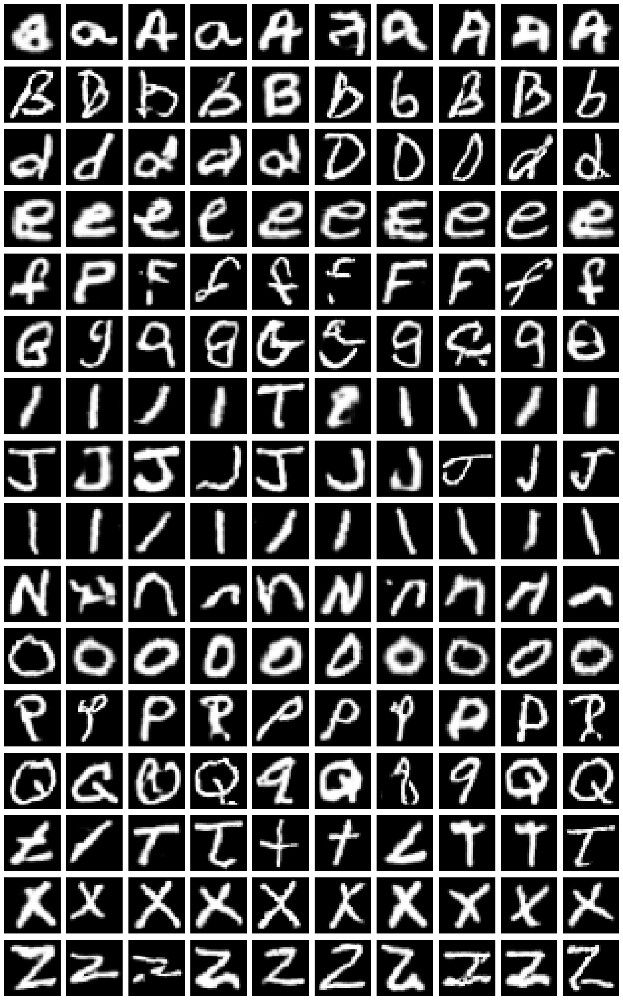

Epoch 211 | D Loss: 0.7152 | G Loss: 0.6902 | D Acc: 0.4609
Epoch 212 | D Loss: 0.6855 | G Loss: 0.6780 | D Acc: 0.5234
Epoch 213 | D Loss: 0.6836 | G Loss: 0.7114 | D Acc: 0.5781
Epoch 214 | D Loss: 0.6869 | G Loss: 0.6951 | D Acc: 0.5078
Epoch 215 | D Loss: 0.6876 | G Loss: 0.6864 | D Acc: 0.5234
Epoch 216 | D Loss: 0.6810 | G Loss: 0.7193 | D Acc: 0.5469
Epoch 217 | D Loss: 0.7253 | G Loss: 0.7050 | D Acc: 0.3438
Epoch 218 | D Loss: 0.6828 | G Loss: 0.7334 | D Acc: 0.5781
Epoch 219 | D Loss: 0.6716 | G Loss: 0.6858 | D Acc: 0.6641
Epoch 220 | D Loss: 0.7094 | G Loss: 0.6794 | D Acc: 0.4219
Preview images at epoch 220:


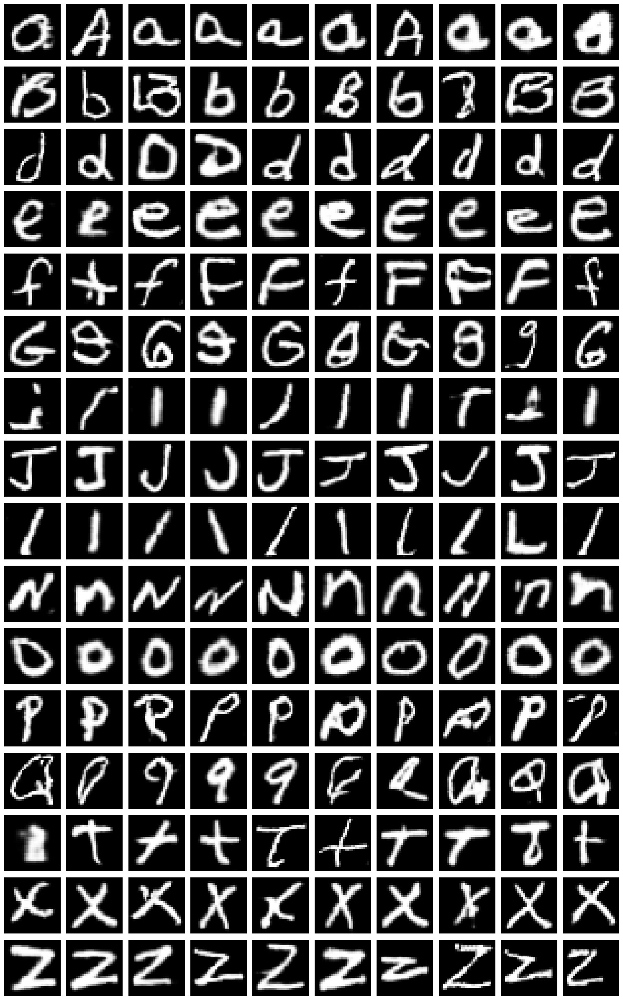

Epoch 221 | D Loss: 0.6928 | G Loss: 0.7072 | D Acc: 0.4688
Epoch 222 | D Loss: 0.6808 | G Loss: 0.7091 | D Acc: 0.5312
Epoch 223 | D Loss: 0.6853 | G Loss: 0.6927 | D Acc: 0.5312
Epoch 224 | D Loss: 0.6819 | G Loss: 0.7065 | D Acc: 0.5625
Epoch 225 | D Loss: 0.7169 | G Loss: 0.6664 | D Acc: 0.3984
Epoch 226 | D Loss: 0.7058 | G Loss: 0.6826 | D Acc: 0.4453
Epoch 227 | D Loss: 0.6869 | G Loss: 0.6977 | D Acc: 0.4844
Epoch 228 | D Loss: 0.6894 | G Loss: 0.7433 | D Acc: 0.5234
Epoch 229 | D Loss: 0.6940 | G Loss: 0.6919 | D Acc: 0.4766
Epoch 230 | D Loss: 0.6909 | G Loss: 0.6425 | D Acc: 0.4922
Preview images at epoch 230:


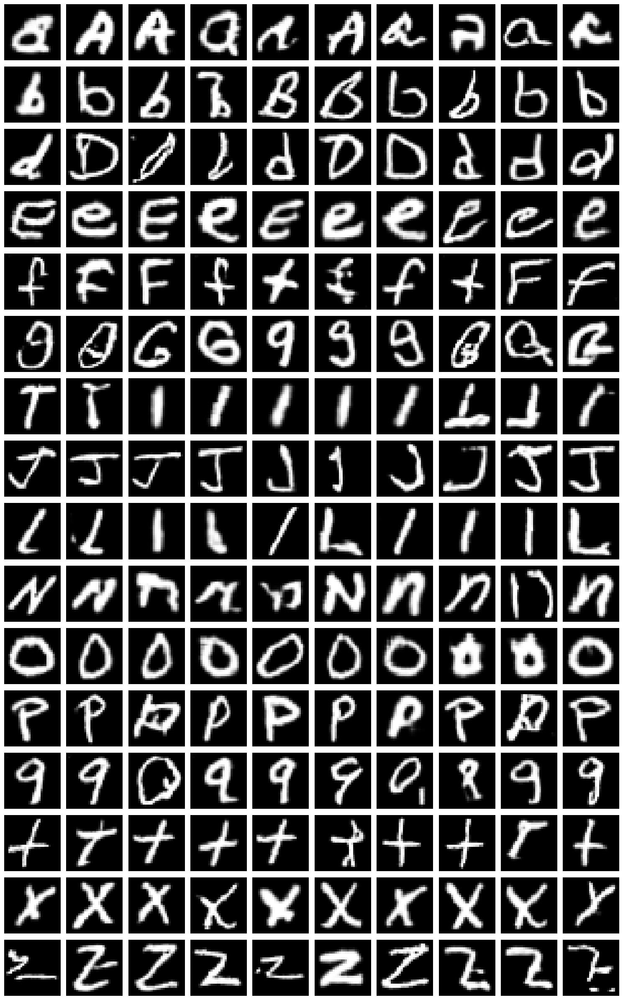

Epoch 231 | D Loss: 0.6892 | G Loss: 0.6978 | D Acc: 0.5000
Epoch 232 | D Loss: 0.6840 | G Loss: 0.6636 | D Acc: 0.5234
Epoch 233 | D Loss: 0.6777 | G Loss: 0.6906 | D Acc: 0.5938
Epoch 234 | D Loss: 0.6785 | G Loss: 0.6793 | D Acc: 0.6094
Epoch 235 | D Loss: 0.7070 | G Loss: 0.6919 | D Acc: 0.4453
Epoch 236 | D Loss: 0.6909 | G Loss: 0.7086 | D Acc: 0.4688
Epoch 237 | D Loss: 0.6792 | G Loss: 0.6730 | D Acc: 0.5938
Epoch 238 | D Loss: 0.6875 | G Loss: 0.6641 | D Acc: 0.5078
Epoch 239 | D Loss: 0.6573 | G Loss: 0.7340 | D Acc: 0.6641
Epoch 240 | D Loss: 0.6895 | G Loss: 0.6762 | D Acc: 0.5234
Preview images at epoch 240:


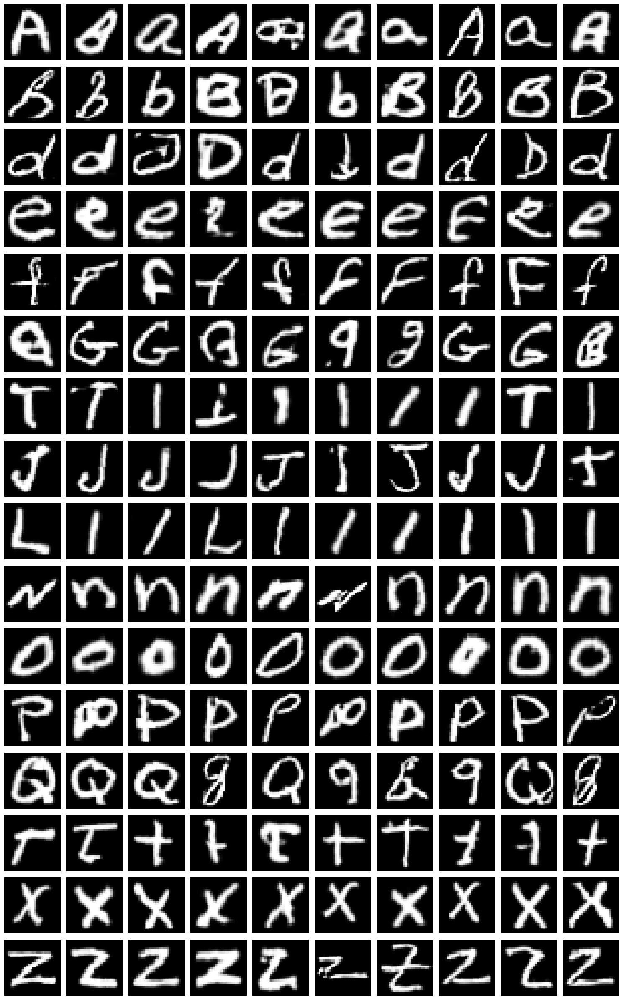

Epoch 241 | D Loss: 0.7074 | G Loss: 0.7084 | D Acc: 0.4531
Epoch 242 | D Loss: 0.6948 | G Loss: 0.7080 | D Acc: 0.5703
Epoch 243 | D Loss: 0.6860 | G Loss: 0.7017 | D Acc: 0.5312
Epoch 244 | D Loss: 0.7010 | G Loss: 0.6942 | D Acc: 0.4922
Epoch 245 | D Loss: 0.6894 | G Loss: 0.6818 | D Acc: 0.5469
Epoch 246 | D Loss: 0.6922 | G Loss: 0.7377 | D Acc: 0.5078
Epoch 247 | D Loss: 0.6821 | G Loss: 0.7326 | D Acc: 0.5703
Epoch 248 | D Loss: 0.7110 | G Loss: 0.6953 | D Acc: 0.4609
Epoch 249 | D Loss: 0.6801 | G Loss: 0.6366 | D Acc: 0.5312
Best generator saved at epoch 249
Epoch 250 | D Loss: 0.6838 | G Loss: 0.6720 | D Acc: 0.5234
Preview images at epoch 250:


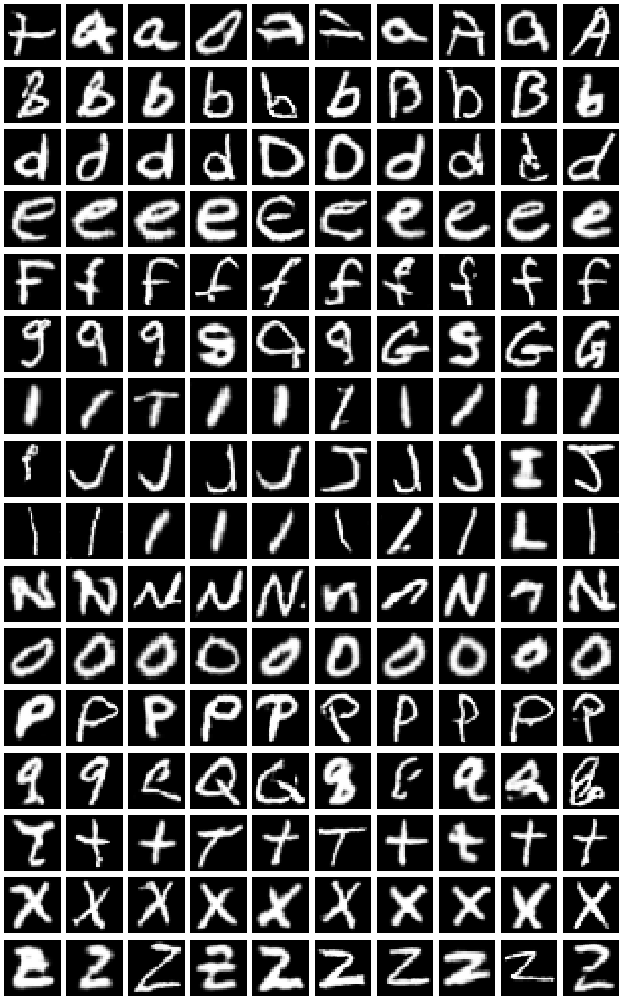

Epoch 251 | D Loss: 0.6839 | G Loss: 0.7170 | D Acc: 0.5781
Epoch 252 | D Loss: 0.6998 | G Loss: 0.7315 | D Acc: 0.4922
Epoch 253 | D Loss: 0.6824 | G Loss: 0.6776 | D Acc: 0.5781
Epoch 254 | D Loss: 0.6672 | G Loss: 0.6944 | D Acc: 0.6016
Epoch 255 | D Loss: 0.7049 | G Loss: 0.6812 | D Acc: 0.4688
Epoch 256 | D Loss: 0.6894 | G Loss: 0.7021 | D Acc: 0.5312
Epoch 257 | D Loss: 0.6889 | G Loss: 0.7040 | D Acc: 0.5547
Epoch 258 | D Loss: 0.6919 | G Loss: 0.6685 | D Acc: 0.4922
Epoch 259 | D Loss: 0.6831 | G Loss: 0.6778 | D Acc: 0.5859
Epoch 260 | D Loss: 0.6774 | G Loss: 0.6999 | D Acc: 0.5859
Preview images at epoch 260:


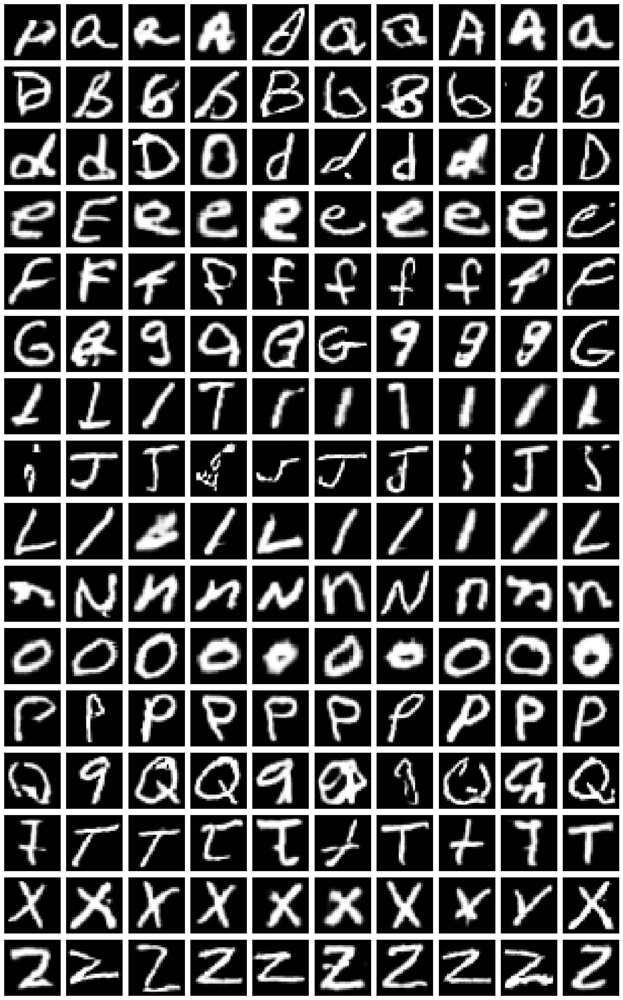

Epoch 261 | D Loss: 0.6700 | G Loss: 0.6605 | D Acc: 0.6406
Epoch 262 | D Loss: 0.6967 | G Loss: 0.7017 | D Acc: 0.4922
Epoch 263 | D Loss: 0.6830 | G Loss: 0.7382 | D Acc: 0.5703
Epoch 264 | D Loss: 0.6902 | G Loss: 0.7061 | D Acc: 0.5234
Epoch 265 | D Loss: 0.6714 | G Loss: 0.6556 | D Acc: 0.5938
Epoch 266 | D Loss: 0.6926 | G Loss: 0.6796 | D Acc: 0.4922
Epoch 267 | D Loss: 0.6786 | G Loss: 0.7544 | D Acc: 0.5781
Epoch 268 | D Loss: 0.6972 | G Loss: 0.7483 | D Acc: 0.4922
Epoch 269 | D Loss: 0.6799 | G Loss: 0.7004 | D Acc: 0.5938
Epoch 270 | D Loss: 0.6886 | G Loss: 0.6944 | D Acc: 0.5703
Preview images at epoch 270:


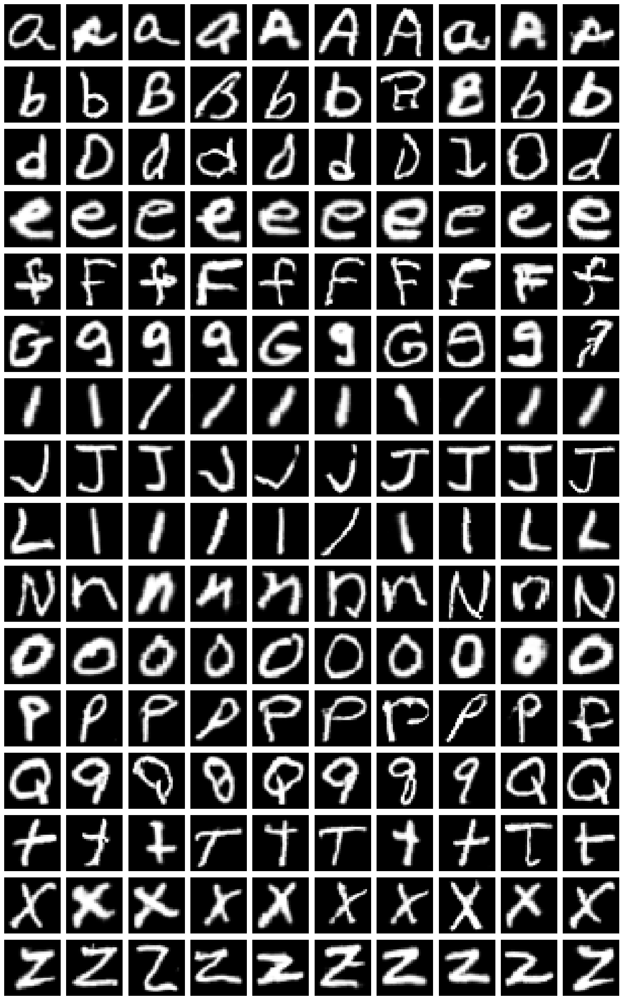

Epoch 271 | D Loss: 0.7003 | G Loss: 0.7076 | D Acc: 0.4766
Epoch 272 | D Loss: 0.6899 | G Loss: 0.6786 | D Acc: 0.5156
Epoch 273 | D Loss: 0.6894 | G Loss: 0.6966 | D Acc: 0.5547
Epoch 274 | D Loss: 0.6789 | G Loss: 0.7045 | D Acc: 0.5391
Epoch 275 | D Loss: 0.6944 | G Loss: 0.7178 | D Acc: 0.4922
Epoch 276 | D Loss: 0.6633 | G Loss: 0.7207 | D Acc: 0.6719
Epoch 277 | D Loss: 0.6742 | G Loss: 0.7219 | D Acc: 0.5938
Epoch 278 | D Loss: 0.6841 | G Loss: 0.7267 | D Acc: 0.5469
Epoch 279 | D Loss: 0.6793 | G Loss: 0.7323 | D Acc: 0.5859
Epoch 280 | D Loss: 0.6945 | G Loss: 0.6735 | D Acc: 0.4922
Preview images at epoch 280:


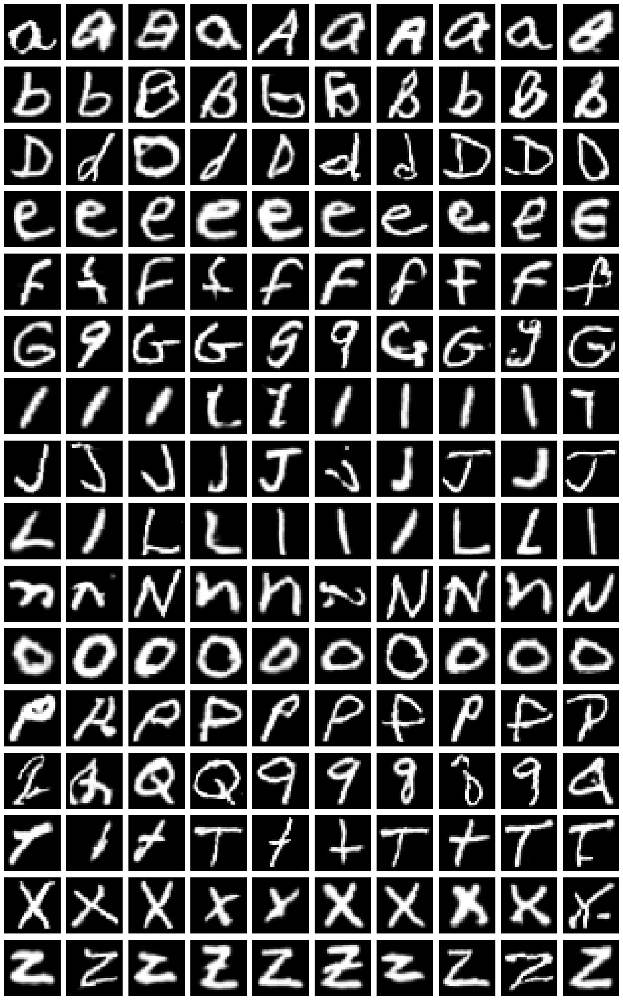

Epoch 281 | D Loss: 0.6883 | G Loss: 0.7081 | D Acc: 0.5391
Epoch 282 | D Loss: 0.6849 | G Loss: 0.7429 | D Acc: 0.5547
Epoch 283 | D Loss: 0.6902 | G Loss: 0.7264 | D Acc: 0.5234
Epoch 284 | D Loss: 0.7080 | G Loss: 0.7110 | D Acc: 0.4453
Epoch 285 | D Loss: 0.7040 | G Loss: 0.7357 | D Acc: 0.4453
Epoch 286 | D Loss: 0.6729 | G Loss: 0.7312 | D Acc: 0.6016
Epoch 287 | D Loss: 0.7098 | G Loss: 0.6673 | D Acc: 0.4219
Epoch 288 | D Loss: 0.6934 | G Loss: 0.7321 | D Acc: 0.5156
Epoch 289 | D Loss: 0.7069 | G Loss: 0.6945 | D Acc: 0.4766
Epoch 290 | D Loss: 0.6838 | G Loss: 0.6776 | D Acc: 0.5156
Preview images at epoch 290:


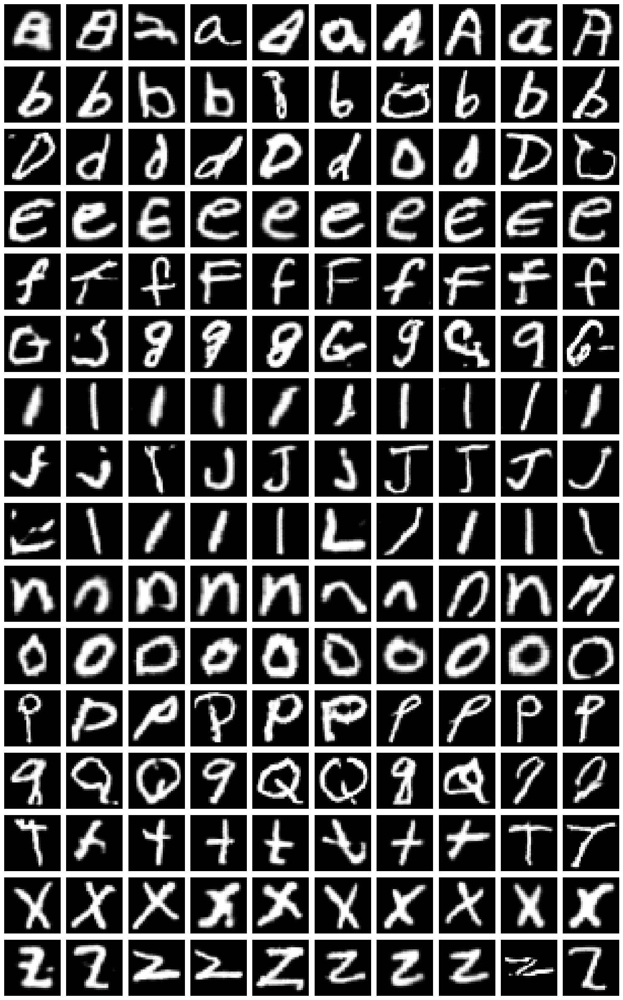

Epoch 291 | D Loss: 0.6958 | G Loss: 0.6690 | D Acc: 0.4844
Epoch 292 | D Loss: 0.6884 | G Loss: 0.6624 | D Acc: 0.5469
Epoch 293 | D Loss: 0.6820 | G Loss: 0.7197 | D Acc: 0.5781
Epoch 294 | D Loss: 0.6783 | G Loss: 0.7367 | D Acc: 0.5859
Epoch 295 | D Loss: 0.6749 | G Loss: 0.7265 | D Acc: 0.6406
Epoch 296 | D Loss: 0.6749 | G Loss: 0.6823 | D Acc: 0.6172
Epoch 297 | D Loss: 0.6869 | G Loss: 0.7090 | D Acc: 0.5703
Epoch 298 | D Loss: 0.7070 | G Loss: 0.7421 | D Acc: 0.4688
Epoch 299 | D Loss: 0.6965 | G Loss: 0.6919 | D Acc: 0.5391
Epoch 300 | D Loss: 0.6896 | G Loss: 0.7378 | D Acc: 0.5156
Preview images at epoch 300:


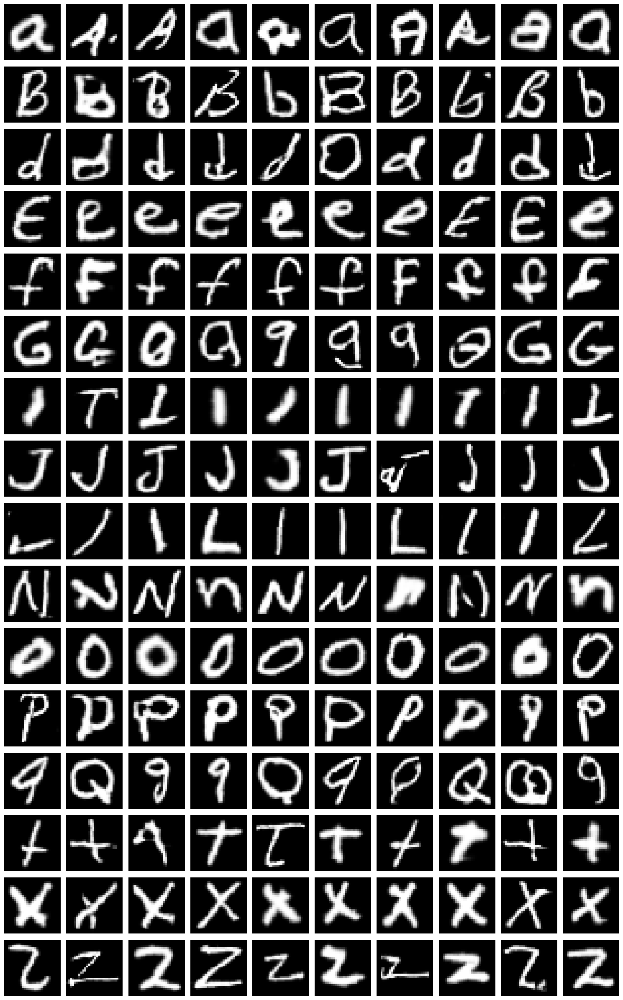

Epoch 301 | D Loss: 0.6758 | G Loss: 0.6847 | D Acc: 0.5938
Epoch 302 | D Loss: 0.6737 | G Loss: 0.6958 | D Acc: 0.5781
Epoch 303 | D Loss: 0.7118 | G Loss: 0.7316 | D Acc: 0.4609
Epoch 304 | D Loss: 0.6933 | G Loss: 0.7197 | D Acc: 0.5234
Epoch 305 | D Loss: 0.6788 | G Loss: 0.7361 | D Acc: 0.5859
Epoch 306 | D Loss: 0.6899 | G Loss: 0.6843 | D Acc: 0.5469
Epoch 307 | D Loss: 0.6928 | G Loss: 0.7163 | D Acc: 0.4531
Epoch 308 | D Loss: 0.6841 | G Loss: 0.6900 | D Acc: 0.5625
Epoch 309 | D Loss: 0.6948 | G Loss: 0.6911 | D Acc: 0.5156
Epoch 310 | D Loss: 0.6707 | G Loss: 0.7271 | D Acc: 0.5312
Preview images at epoch 310:


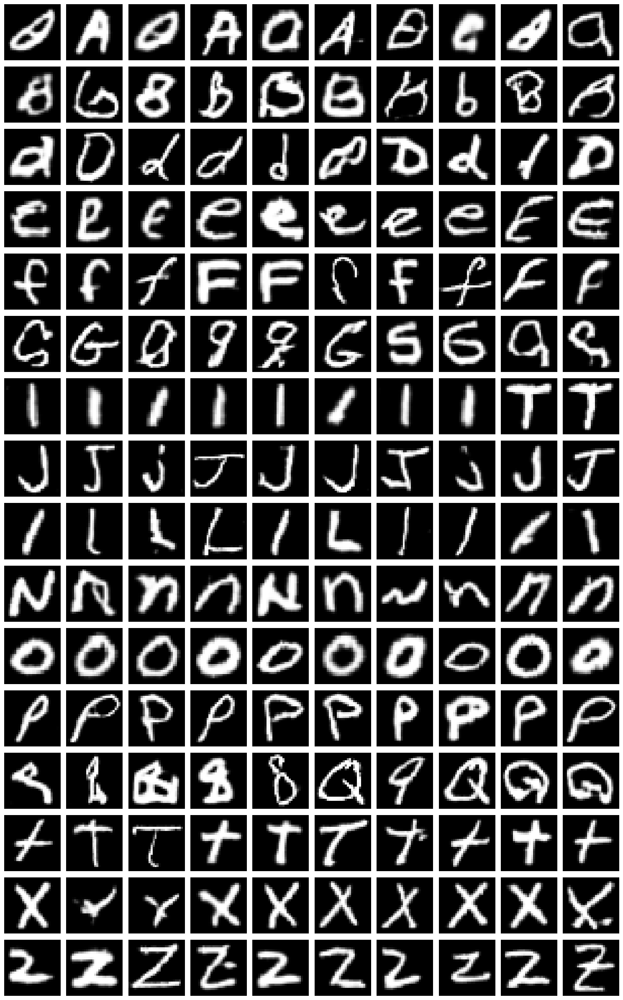

Epoch 311 | D Loss: 0.7025 | G Loss: 0.6632 | D Acc: 0.4297
Epoch 312 | D Loss: 0.7173 | G Loss: 0.6920 | D Acc: 0.3906
Epoch 313 | D Loss: 0.7273 | G Loss: 0.7065 | D Acc: 0.3984
Epoch 314 | D Loss: 0.6932 | G Loss: 0.7406 | D Acc: 0.5078
Epoch 315 | D Loss: 0.6904 | G Loss: 0.6996 | D Acc: 0.5391
Epoch 316 | D Loss: 0.6951 | G Loss: 0.7081 | D Acc: 0.5312
Epoch 317 | D Loss: 0.6828 | G Loss: 0.7079 | D Acc: 0.5625
Epoch 318 | D Loss: 0.7104 | G Loss: 0.6789 | D Acc: 0.4297
Epoch 319 | D Loss: 0.6906 | G Loss: 0.7047 | D Acc: 0.5781
Epoch 320 | D Loss: 0.6747 | G Loss: 0.7127 | D Acc: 0.6484
Preview images at epoch 320:


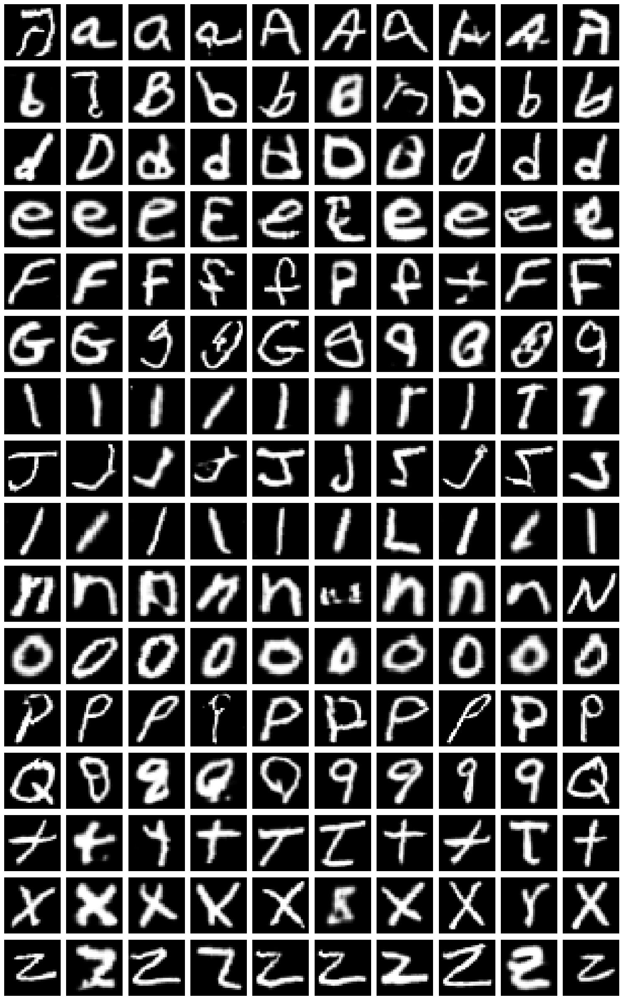

Epoch 321 | D Loss: 0.6704 | G Loss: 0.6863 | D Acc: 0.6094
Epoch 322 | D Loss: 0.7177 | G Loss: 0.7153 | D Acc: 0.4844
Epoch 323 | D Loss: 0.6726 | G Loss: 0.7126 | D Acc: 0.5859
Epoch 324 | D Loss: 0.6632 | G Loss: 0.6849 | D Acc: 0.6250
Epoch 325 | D Loss: 0.7237 | G Loss: 0.6813 | D Acc: 0.4688
Epoch 326 | D Loss: 0.6598 | G Loss: 0.7181 | D Acc: 0.6562
Epoch 327 | D Loss: 0.6686 | G Loss: 0.7442 | D Acc: 0.6172
Epoch 328 | D Loss: 0.6732 | G Loss: 0.7543 | D Acc: 0.5938
Epoch 329 | D Loss: 0.6743 | G Loss: 0.6721 | D Acc: 0.6016
Epoch 330 | D Loss: 0.7160 | G Loss: 0.7675 | D Acc: 0.4375
Preview images at epoch 330:


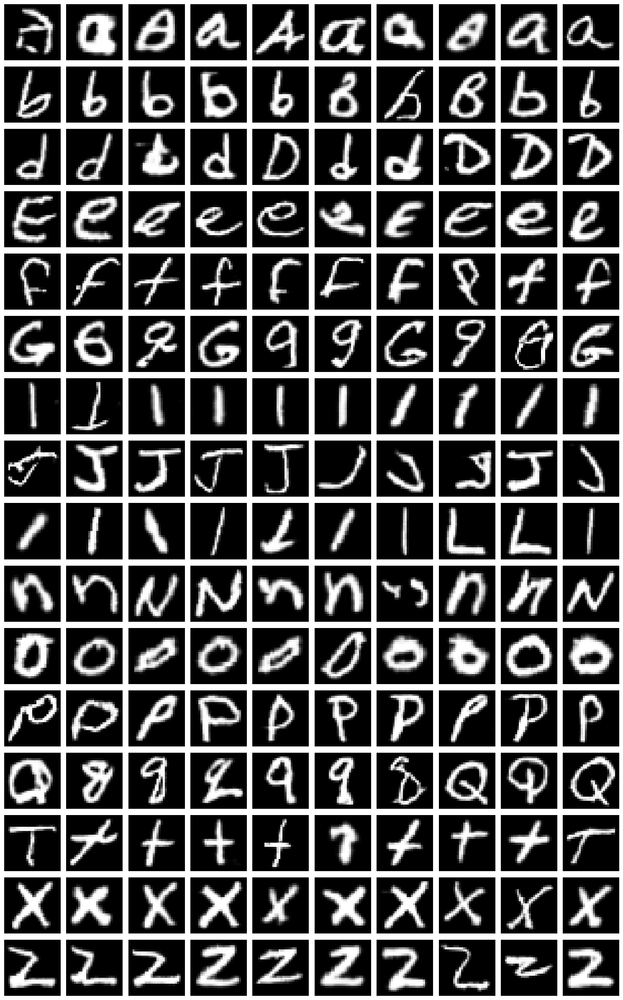

Epoch 331 | D Loss: 0.6670 | G Loss: 0.7042 | D Acc: 0.6094
Epoch 332 | D Loss: 0.6606 | G Loss: 0.7627 | D Acc: 0.6328
Epoch 333 | D Loss: 0.6635 | G Loss: 0.7344 | D Acc: 0.5938
Epoch 334 | D Loss: 0.7074 | G Loss: 0.6522 | D Acc: 0.4531
Epoch 335 | D Loss: 0.6907 | G Loss: 0.6631 | D Acc: 0.5312
Epoch 336 | D Loss: 0.6812 | G Loss: 0.7037 | D Acc: 0.5703
Epoch 337 | D Loss: 0.6884 | G Loss: 0.7281 | D Acc: 0.5703
Epoch 338 | D Loss: 0.6706 | G Loss: 0.6633 | D Acc: 0.6406
Epoch 339 | D Loss: 0.6841 | G Loss: 0.7090 | D Acc: 0.5781
Epoch 340 | D Loss: 0.7163 | G Loss: 0.7004 | D Acc: 0.4375
Preview images at epoch 340:


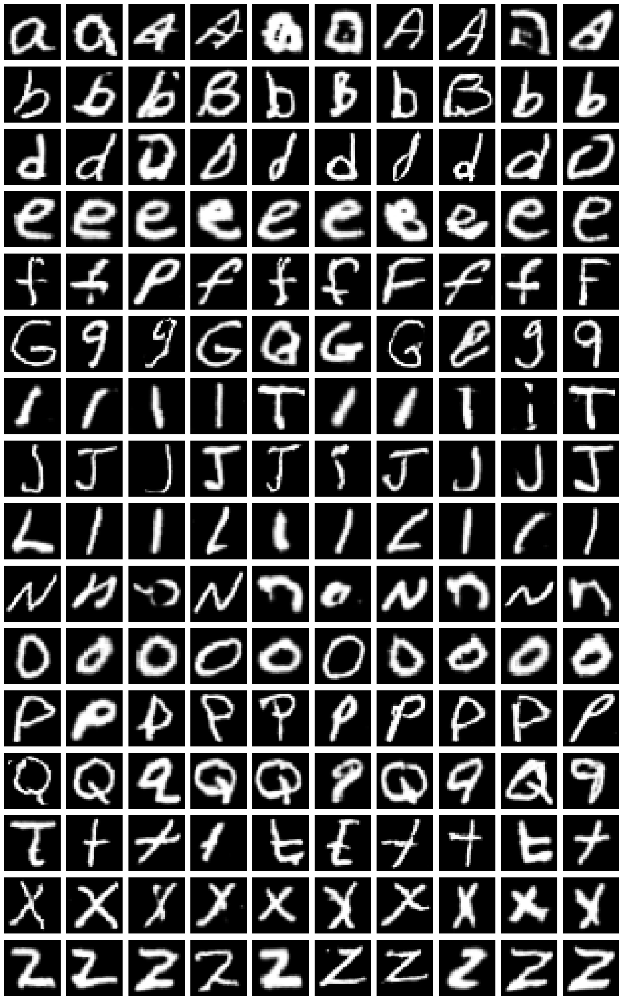

Epoch 341 | D Loss: 0.6807 | G Loss: 0.6385 | D Acc: 0.5938
Epoch 342 | D Loss: 0.6924 | G Loss: 0.6736 | D Acc: 0.5000
Epoch 343 | D Loss: 0.6861 | G Loss: 0.7066 | D Acc: 0.5156
Epoch 344 | D Loss: 0.7034 | G Loss: 0.6914 | D Acc: 0.4297
Epoch 345 | D Loss: 0.6886 | G Loss: 0.6946 | D Acc: 0.5156
Epoch 346 | D Loss: 0.7131 | G Loss: 0.6125 | D Acc: 0.4219
Best generator saved at epoch 346
Epoch 347 | D Loss: 0.6921 | G Loss: 0.6732 | D Acc: 0.5469
Epoch 348 | D Loss: 0.6840 | G Loss: 0.7297 | D Acc: 0.5234
Epoch 349 | D Loss: 0.7245 | G Loss: 0.7254 | D Acc: 0.3438
Epoch 350 | D Loss: 0.6861 | G Loss: 0.6844 | D Acc: 0.5391
Preview images at epoch 350:


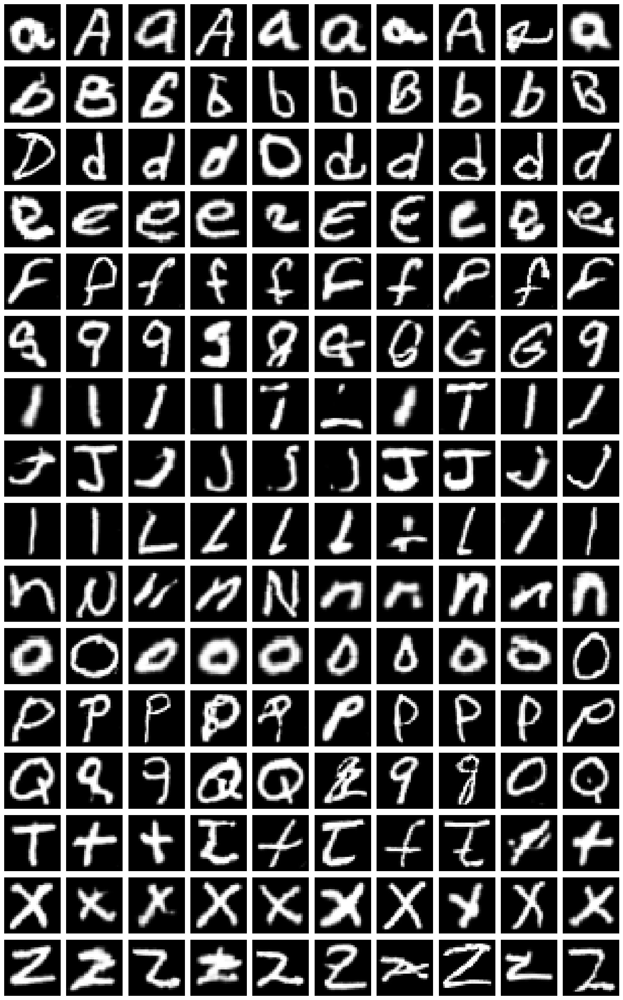

Epoch 351 | D Loss: 0.6898 | G Loss: 0.7494 | D Acc: 0.5391
Epoch 352 | D Loss: 0.6941 | G Loss: 0.6878 | D Acc: 0.5234
Epoch 353 | D Loss: 0.7082 | G Loss: 0.7163 | D Acc: 0.4375
Epoch 354 | D Loss: 0.6854 | G Loss: 0.6988 | D Acc: 0.5625
Epoch 355 | D Loss: 0.6895 | G Loss: 0.6871 | D Acc: 0.5391
Epoch 356 | D Loss: 0.7202 | G Loss: 0.7014 | D Acc: 0.4141
Epoch 357 | D Loss: 0.6844 | G Loss: 0.7676 | D Acc: 0.5547
Epoch 358 | D Loss: 0.6819 | G Loss: 0.7653 | D Acc: 0.5234
Epoch 359 | D Loss: 0.7137 | G Loss: 0.7416 | D Acc: 0.4297
Epoch 360 | D Loss: 0.6775 | G Loss: 0.7238 | D Acc: 0.6016
Preview images at epoch 360:


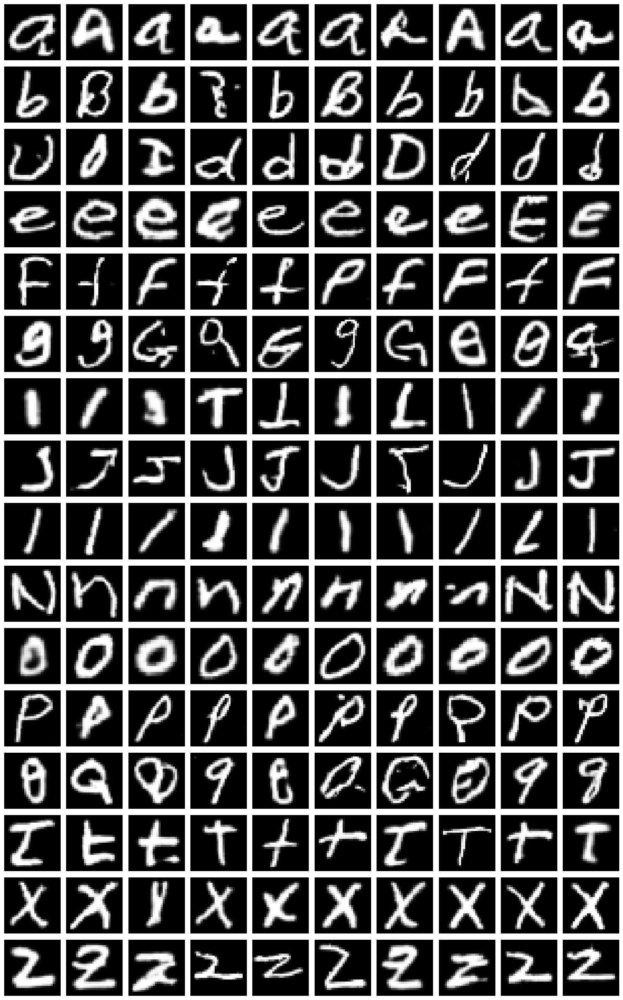

Epoch 361 | D Loss: 0.7146 | G Loss: 0.7274 | D Acc: 0.4297
Epoch 362 | D Loss: 0.7015 | G Loss: 0.7456 | D Acc: 0.4844
Epoch 363 | D Loss: 0.7021 | G Loss: 0.7047 | D Acc: 0.4922
Epoch 364 | D Loss: 0.6866 | G Loss: 0.7010 | D Acc: 0.5391
Epoch 365 | D Loss: 0.7067 | G Loss: 0.6915 | D Acc: 0.4297
Epoch 366 | D Loss: 0.6976 | G Loss: 0.7105 | D Acc: 0.4688
Epoch 367 | D Loss: 0.7006 | G Loss: 0.7012 | D Acc: 0.4922
Epoch 368 | D Loss: 0.6801 | G Loss: 0.7465 | D Acc: 0.6094
Epoch 369 | D Loss: 0.7097 | G Loss: 0.6605 | D Acc: 0.4531
Epoch 370 | D Loss: 0.7046 | G Loss: 0.6869 | D Acc: 0.4453
Preview images at epoch 370:


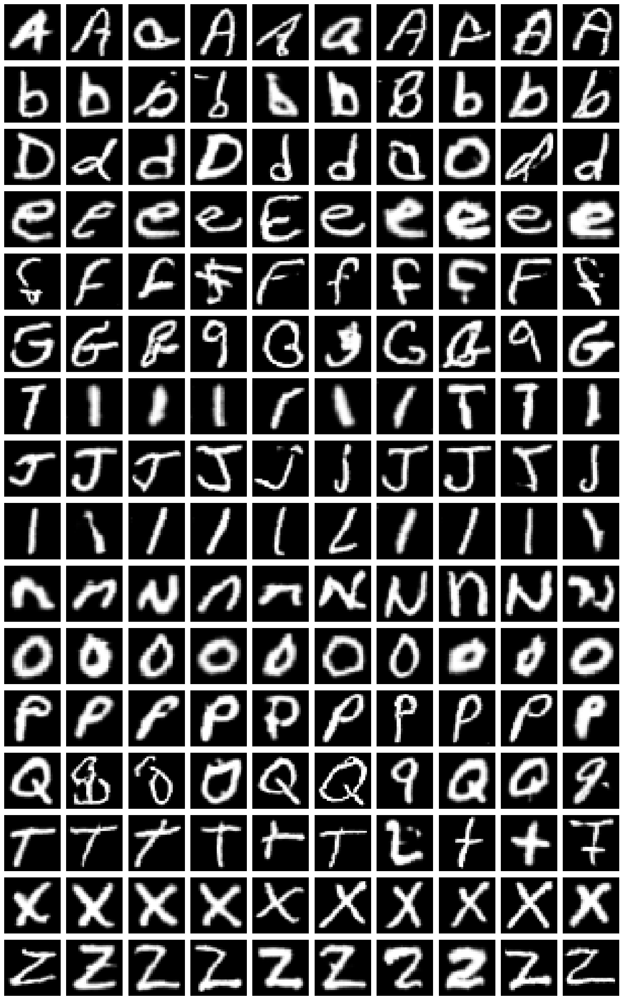

Epoch 371 | D Loss: 0.6658 | G Loss: 0.6684 | D Acc: 0.6562
Epoch 372 | D Loss: 0.6799 | G Loss: 0.6830 | D Acc: 0.5938
Epoch 373 | D Loss: 0.6709 | G Loss: 0.6699 | D Acc: 0.6328
Epoch 374 | D Loss: 0.7110 | G Loss: 0.6942 | D Acc: 0.4766
Epoch 375 | D Loss: 0.7073 | G Loss: 0.6683 | D Acc: 0.4766
Epoch 376 | D Loss: 0.6693 | G Loss: 0.7001 | D Acc: 0.6016
Epoch 377 | D Loss: 0.6738 | G Loss: 0.7280 | D Acc: 0.5859
Epoch 378 | D Loss: 0.6884 | G Loss: 0.7261 | D Acc: 0.5469
Epoch 379 | D Loss: 0.6845 | G Loss: 0.7379 | D Acc: 0.5391
Epoch 380 | D Loss: 0.7136 | G Loss: 0.7478 | D Acc: 0.4453
Preview images at epoch 380:


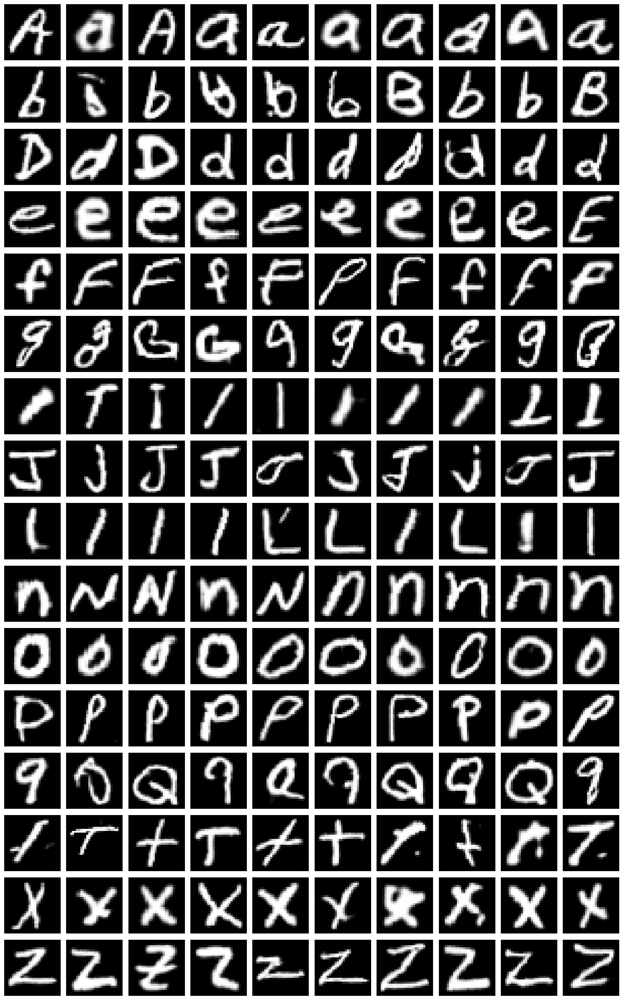

Epoch 381 | D Loss: 0.7007 | G Loss: 0.7281 | D Acc: 0.4609
Epoch 382 | D Loss: 0.6889 | G Loss: 0.7430 | D Acc: 0.5312
Epoch 383 | D Loss: 0.6949 | G Loss: 0.6986 | D Acc: 0.4453
Epoch 384 | D Loss: 0.7094 | G Loss: 0.6894 | D Acc: 0.4688
Epoch 385 | D Loss: 0.6903 | G Loss: 0.7318 | D Acc: 0.5469
Epoch 386 | D Loss: 0.6675 | G Loss: 0.6971 | D Acc: 0.6406
Epoch 387 | D Loss: 0.7001 | G Loss: 0.7090 | D Acc: 0.4766
Epoch 388 | D Loss: 0.6915 | G Loss: 0.7209 | D Acc: 0.5234
Epoch 389 | D Loss: 0.7044 | G Loss: 0.7569 | D Acc: 0.4531
Epoch 390 | D Loss: 0.6744 | G Loss: 0.7362 | D Acc: 0.5703
Preview images at epoch 390:


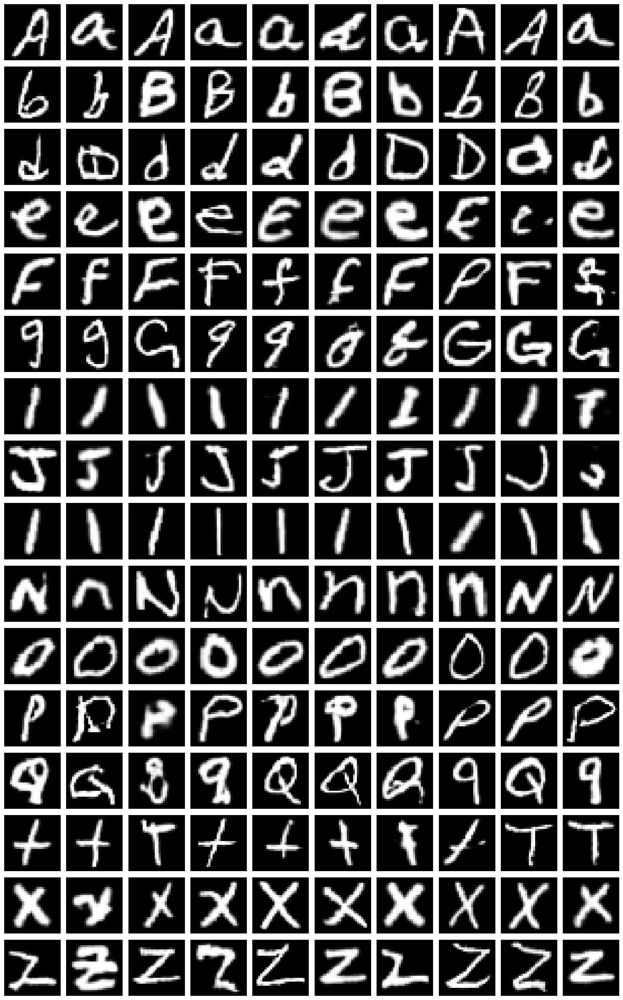

Epoch 391 | D Loss: 0.7076 | G Loss: 0.7555 | D Acc: 0.4375
Epoch 392 | D Loss: 0.7121 | G Loss: 0.7868 | D Acc: 0.4844
Epoch 393 | D Loss: 0.6971 | G Loss: 0.6892 | D Acc: 0.5000
Epoch 394 | D Loss: 0.6824 | G Loss: 0.6536 | D Acc: 0.5156
Epoch 395 | D Loss: 0.7102 | G Loss: 0.7200 | D Acc: 0.4844
Epoch 396 | D Loss: 0.7182 | G Loss: 0.6894 | D Acc: 0.4609
Epoch 397 | D Loss: 0.7239 | G Loss: 0.7040 | D Acc: 0.3438
Epoch 398 | D Loss: 0.6942 | G Loss: 0.6963 | D Acc: 0.4922
Epoch 399 | D Loss: 0.6974 | G Loss: 0.6959 | D Acc: 0.5312
Epoch 400 | D Loss: 0.6844 | G Loss: 0.7057 | D Acc: 0.5391
Preview images at epoch 400:


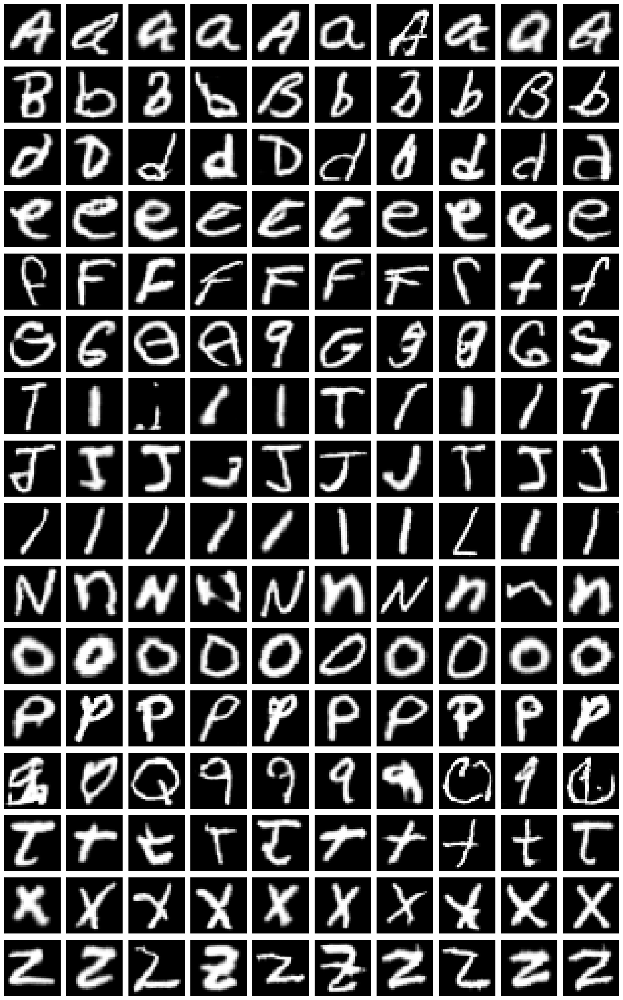

Epoch 401 | D Loss: 0.6815 | G Loss: 0.7021 | D Acc: 0.5781
Epoch 402 | D Loss: 0.6775 | G Loss: 0.7140 | D Acc: 0.5859
Epoch 403 | D Loss: 0.7074 | G Loss: 0.7309 | D Acc: 0.4375
Epoch 404 | D Loss: 0.6906 | G Loss: 0.6715 | D Acc: 0.6094
Epoch 405 | D Loss: 0.6692 | G Loss: 0.7651 | D Acc: 0.5938
Epoch 406 | D Loss: 0.6950 | G Loss: 0.7072 | D Acc: 0.5391
Epoch 407 | D Loss: 0.6708 | G Loss: 0.7048 | D Acc: 0.5781
Epoch 408 | D Loss: 0.7113 | G Loss: 0.6742 | D Acc: 0.4062
Epoch 409 | D Loss: 0.6902 | G Loss: 0.7077 | D Acc: 0.5312
Epoch 410 | D Loss: 0.6780 | G Loss: 0.7276 | D Acc: 0.6016
Preview images at epoch 410:


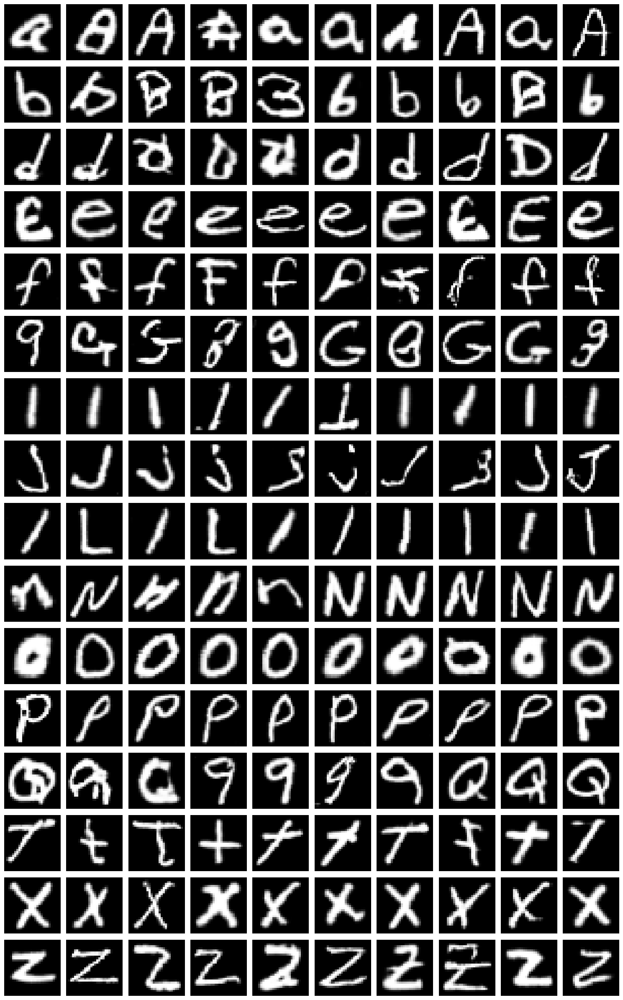

Epoch 411 | D Loss: 0.6904 | G Loss: 0.6696 | D Acc: 0.5234
Epoch 412 | D Loss: 0.6840 | G Loss: 0.7126 | D Acc: 0.5469
Epoch 413 | D Loss: 0.7120 | G Loss: 0.6993 | D Acc: 0.4141
Epoch 414 | D Loss: 0.7322 | G Loss: 0.7052 | D Acc: 0.4219
Epoch 415 | D Loss: 0.6733 | G Loss: 0.7503 | D Acc: 0.5547
Epoch 416 | D Loss: 0.6508 | G Loss: 0.6859 | D Acc: 0.7578
Epoch 417 | D Loss: 0.6879 | G Loss: 0.7127 | D Acc: 0.5312
Epoch 418 | D Loss: 0.7081 | G Loss: 0.7120 | D Acc: 0.4688
Epoch 419 | D Loss: 0.6781 | G Loss: 0.7117 | D Acc: 0.5703
Epoch 420 | D Loss: 0.6790 | G Loss: 0.7322 | D Acc: 0.5469
Preview images at epoch 420:


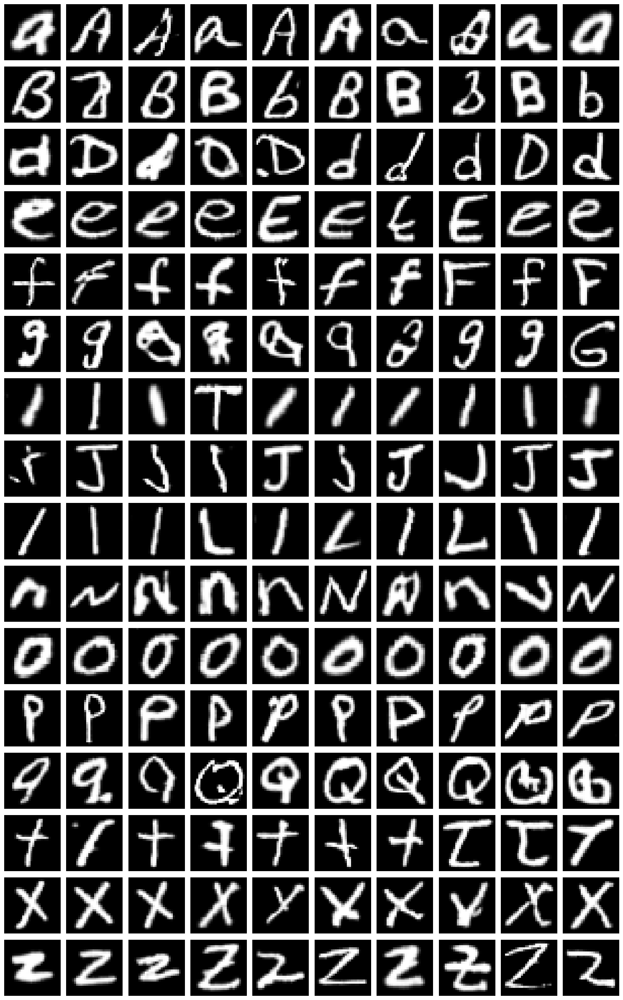

Epoch 421 | D Loss: 0.6877 | G Loss: 0.7295 | D Acc: 0.5391
Epoch 422 | D Loss: 0.6950 | G Loss: 0.7157 | D Acc: 0.4922
Epoch 423 | D Loss: 0.6952 | G Loss: 0.7504 | D Acc: 0.5156
Epoch 424 | D Loss: 0.6927 | G Loss: 0.6913 | D Acc: 0.5547
Epoch 425 | D Loss: 0.7207 | G Loss: 0.6757 | D Acc: 0.4609
Epoch 426 | D Loss: 0.6927 | G Loss: 0.6996 | D Acc: 0.4766
Epoch 427 | D Loss: 0.6612 | G Loss: 0.7684 | D Acc: 0.6250
Epoch 428 | D Loss: 0.6766 | G Loss: 0.7098 | D Acc: 0.5781
Epoch 429 | D Loss: 0.6874 | G Loss: 0.6851 | D Acc: 0.5312
Epoch 430 | D Loss: 0.6529 | G Loss: 0.7438 | D Acc: 0.6719
Preview images at epoch 430:


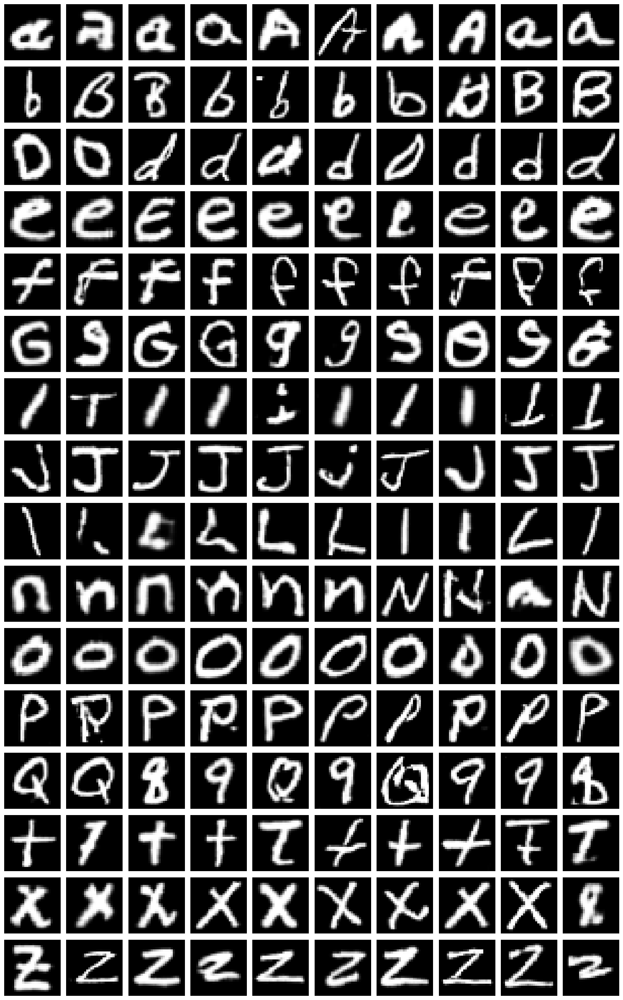

Epoch 431 | D Loss: 0.6836 | G Loss: 0.7193 | D Acc: 0.5781
Epoch 432 | D Loss: 0.6766 | G Loss: 0.6789 | D Acc: 0.5859
Epoch 433 | D Loss: 0.6986 | G Loss: 0.7391 | D Acc: 0.4609
Epoch 434 | D Loss: 0.7113 | G Loss: 0.7070 | D Acc: 0.4375
Epoch 435 | D Loss: 0.7181 | G Loss: 0.7495 | D Acc: 0.4453
Epoch 436 | D Loss: 0.6792 | G Loss: 0.7518 | D Acc: 0.5625
Epoch 437 | D Loss: 0.6645 | G Loss: 0.7446 | D Acc: 0.6094
Epoch 438 | D Loss: 0.7232 | G Loss: 0.7550 | D Acc: 0.4141
Epoch 439 | D Loss: 0.6716 | G Loss: 0.6744 | D Acc: 0.6094
Epoch 440 | D Loss: 0.6567 | G Loss: 0.6786 | D Acc: 0.6094
Preview images at epoch 440:


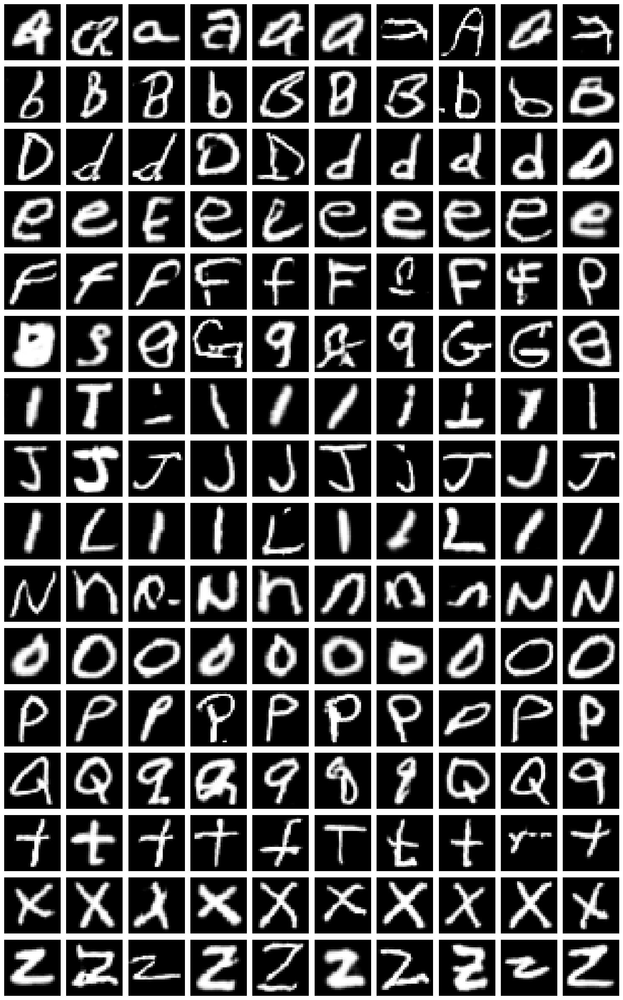

Epoch 441 | D Loss: 0.6859 | G Loss: 0.7279 | D Acc: 0.5391
Epoch 442 | D Loss: 0.6572 | G Loss: 0.7362 | D Acc: 0.6641
Epoch 443 | D Loss: 0.7065 | G Loss: 0.6575 | D Acc: 0.5156
Epoch 444 | D Loss: 0.6808 | G Loss: 0.6881 | D Acc: 0.5469
Epoch 445 | D Loss: 0.6907 | G Loss: 0.7131 | D Acc: 0.5312
Epoch 446 | D Loss: 0.7038 | G Loss: 0.7377 | D Acc: 0.5312
Epoch 447 | D Loss: 0.7120 | G Loss: 0.6706 | D Acc: 0.4609
Epoch 448 | D Loss: 0.7182 | G Loss: 0.7435 | D Acc: 0.4531
Epoch 449 | D Loss: 0.6878 | G Loss: 0.7105 | D Acc: 0.5234
Epoch 450 | D Loss: 0.6844 | G Loss: 0.6728 | D Acc: 0.5156
Preview images at epoch 450:


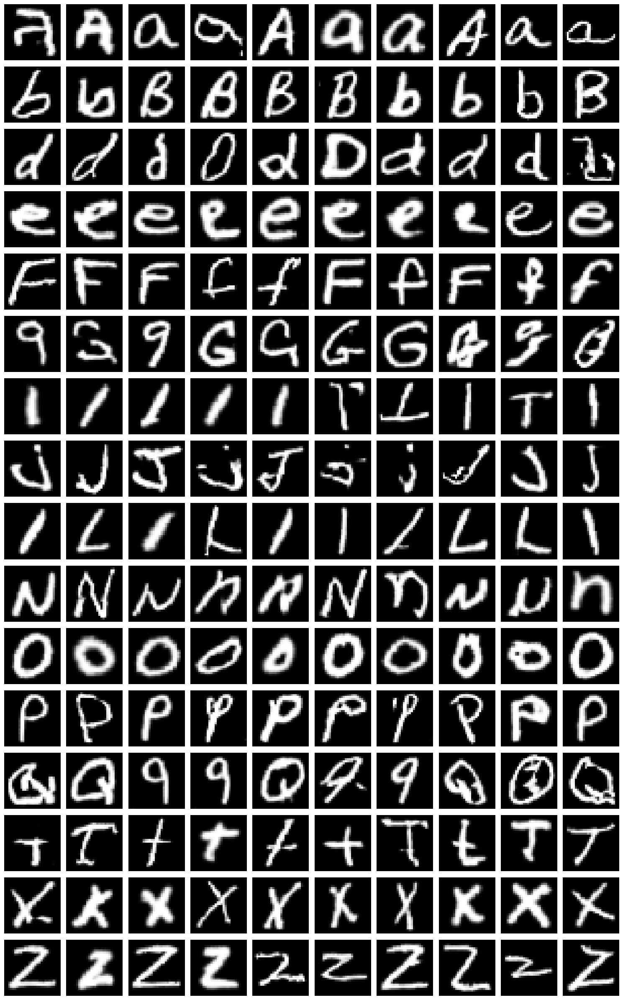

Epoch 451 | D Loss: 0.6955 | G Loss: 0.7041 | D Acc: 0.5234
Epoch 452 | D Loss: 0.6771 | G Loss: 0.6997 | D Acc: 0.5859
Epoch 453 | D Loss: 0.6745 | G Loss: 0.7125 | D Acc: 0.6094
Epoch 454 | D Loss: 0.7183 | G Loss: 0.6930 | D Acc: 0.4375
Epoch 455 | D Loss: 0.7126 | G Loss: 0.6826 | D Acc: 0.4688
Epoch 456 | D Loss: 0.7420 | G Loss: 0.6878 | D Acc: 0.3438
Epoch 457 | D Loss: 0.7146 | G Loss: 0.7553 | D Acc: 0.4531
Epoch 458 | D Loss: 0.6996 | G Loss: 0.6939 | D Acc: 0.5156
Epoch 459 | D Loss: 0.6517 | G Loss: 0.7180 | D Acc: 0.6328
Epoch 460 | D Loss: 0.6854 | G Loss: 0.7449 | D Acc: 0.5312
Preview images at epoch 460:


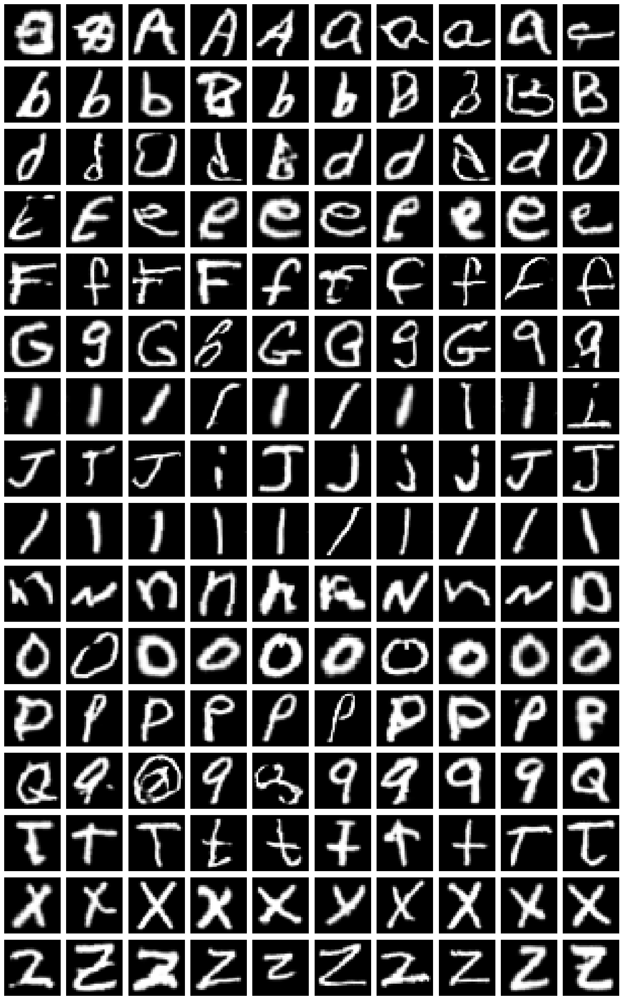

Epoch 461 | D Loss: 0.7235 | G Loss: 0.7364 | D Acc: 0.4141
Epoch 462 | D Loss: 0.7103 | G Loss: 0.7074 | D Acc: 0.4688
Epoch 463 | D Loss: 0.6940 | G Loss: 0.7671 | D Acc: 0.4609
Epoch 464 | D Loss: 0.6696 | G Loss: 0.7390 | D Acc: 0.6484
Epoch 465 | D Loss: 0.6878 | G Loss: 0.7515 | D Acc: 0.5469
Epoch 466 | D Loss: 0.6606 | G Loss: 0.6618 | D Acc: 0.6484
Epoch 467 | D Loss: 0.6882 | G Loss: 0.7335 | D Acc: 0.5234
Epoch 468 | D Loss: 0.6919 | G Loss: 0.6530 | D Acc: 0.5000
Epoch 469 | D Loss: 0.7312 | G Loss: 0.7056 | D Acc: 0.4375
Epoch 470 | D Loss: 0.6881 | G Loss: 0.6906 | D Acc: 0.5547
Preview images at epoch 470:


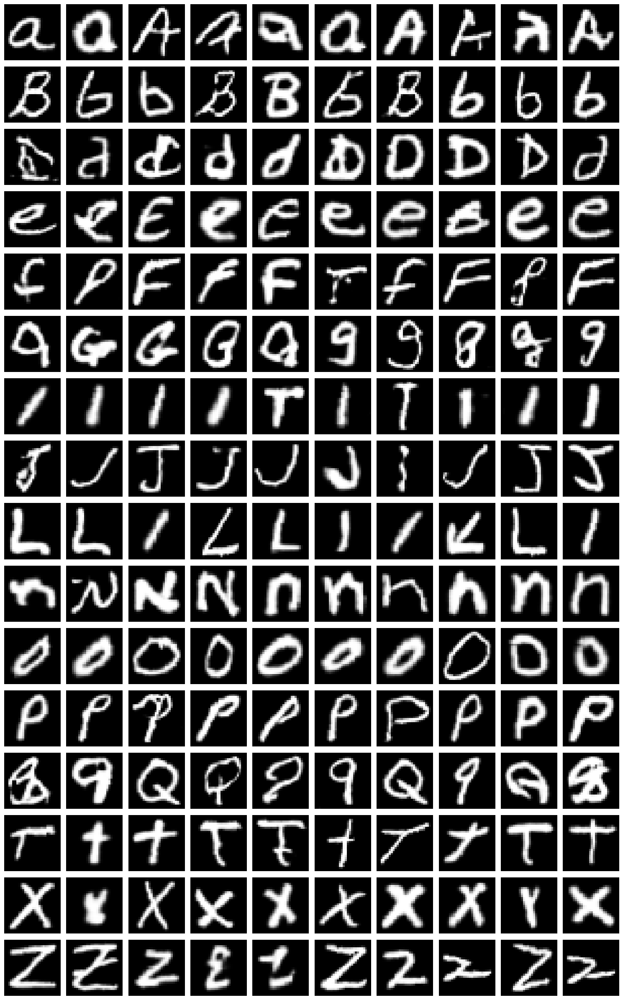

Epoch 471 | D Loss: 0.7064 | G Loss: 0.7878 | D Acc: 0.4453
Epoch 472 | D Loss: 0.6960 | G Loss: 0.7028 | D Acc: 0.5000
Epoch 473 | D Loss: 0.6850 | G Loss: 0.7503 | D Acc: 0.5391
Epoch 474 | D Loss: 0.7019 | G Loss: 0.6806 | D Acc: 0.4531
Epoch 475 | D Loss: 0.7118 | G Loss: 0.6888 | D Acc: 0.4609
Epoch 476 | D Loss: 0.6686 | G Loss: 0.7489 | D Acc: 0.5859
Epoch 477 | D Loss: 0.6938 | G Loss: 0.7232 | D Acc: 0.5781
Epoch 478 | D Loss: 0.6736 | G Loss: 0.7623 | D Acc: 0.5781
Epoch 479 | D Loss: 0.6894 | G Loss: 0.6518 | D Acc: 0.4688
Epoch 480 | D Loss: 0.6763 | G Loss: 0.7100 | D Acc: 0.5703
Preview images at epoch 480:


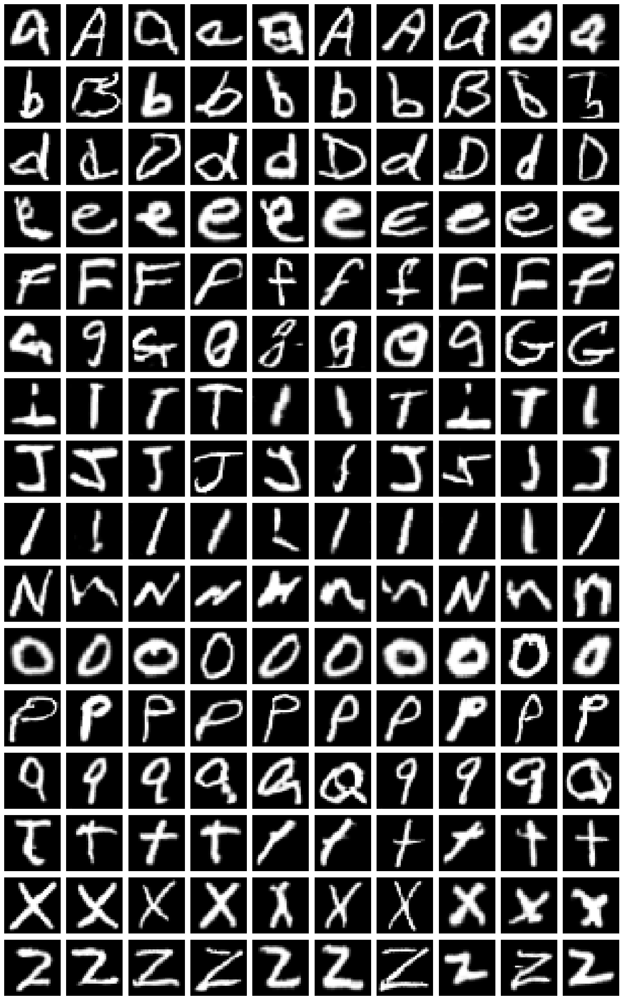

Epoch 481 | D Loss: 0.6440 | G Loss: 0.6834 | D Acc: 0.6797
Epoch 482 | D Loss: 0.7169 | G Loss: 0.7815 | D Acc: 0.4219
Epoch 483 | D Loss: 0.7111 | G Loss: 0.7517 | D Acc: 0.5000
Epoch 484 | D Loss: 0.6617 | G Loss: 0.7995 | D Acc: 0.6406
Epoch 485 | D Loss: 0.6469 | G Loss: 0.6982 | D Acc: 0.7109
Epoch 486 | D Loss: 0.6792 | G Loss: 0.7773 | D Acc: 0.6016
Epoch 487 | D Loss: 0.6556 | G Loss: 0.7862 | D Acc: 0.6406
Epoch 488 | D Loss: 0.6786 | G Loss: 0.7296 | D Acc: 0.6016
Epoch 489 | D Loss: 0.6778 | G Loss: 0.7136 | D Acc: 0.5156
Epoch 490 | D Loss: 0.7146 | G Loss: 0.6785 | D Acc: 0.4609
Preview images at epoch 490:


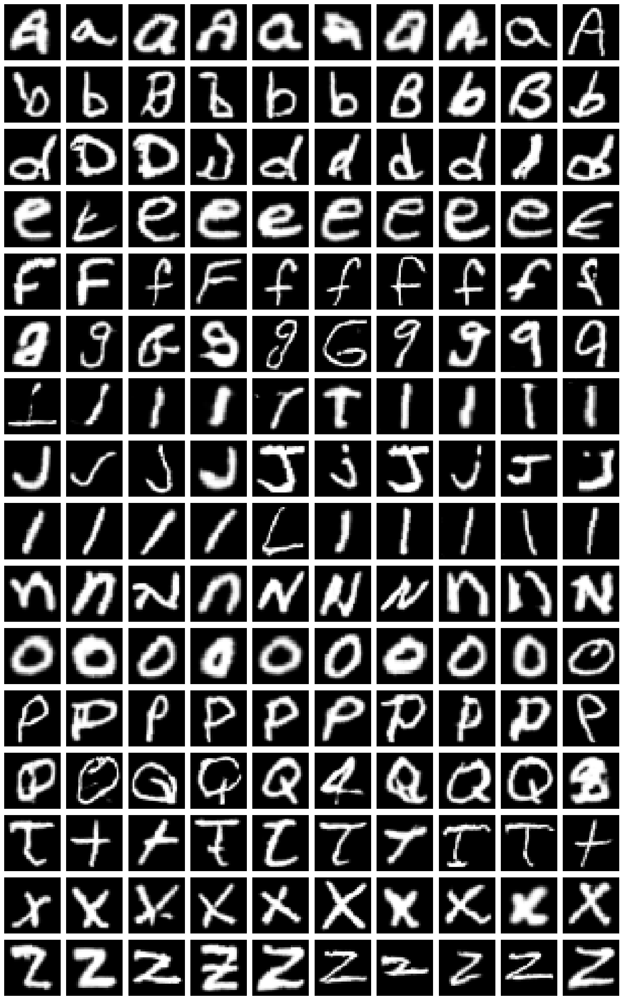

Epoch 491 | D Loss: 0.6889 | G Loss: 0.7190 | D Acc: 0.5547
Epoch 492 | D Loss: 0.7207 | G Loss: 0.7419 | D Acc: 0.4531
Epoch 493 | D Loss: 0.6863 | G Loss: 0.7240 | D Acc: 0.5469
Epoch 494 | D Loss: 0.6758 | G Loss: 0.7236 | D Acc: 0.6016
Epoch 495 | D Loss: 0.6717 | G Loss: 0.7058 | D Acc: 0.6328
Epoch 496 | D Loss: 0.6918 | G Loss: 0.7411 | D Acc: 0.5312
Epoch 497 | D Loss: 0.6555 | G Loss: 0.6964 | D Acc: 0.6719
Epoch 498 | D Loss: 0.6721 | G Loss: 0.7338 | D Acc: 0.6406
Epoch 499 | D Loss: 0.6714 | G Loss: 0.7364 | D Acc: 0.6250
Epoch 500 | D Loss: 0.7005 | G Loss: 0.7040 | D Acc: 0.4844
Preview images at epoch 500:


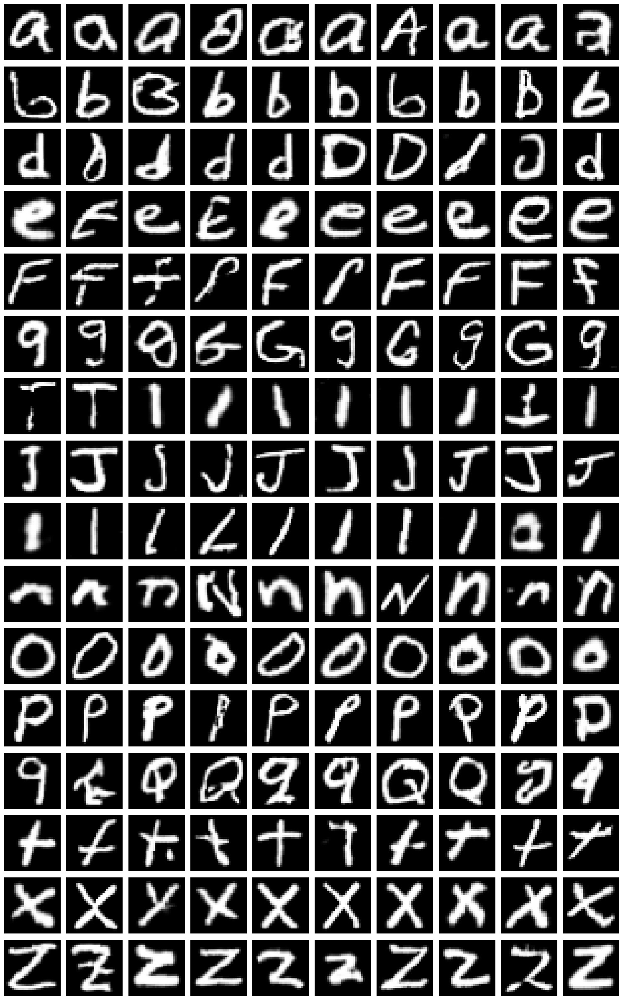

new inal weights saved.


In [149]:
@tf.function
def train_step(real_imgs, real_labels):
    batch_size = tf.shape(real_imgs)[0]
    valid = tf.ones((batch_size, 1))
    fake = tf.zeros((batch_size, 1))

    # Generate fake images
    noise = tf.random.normal((batch_size, latent_dim))
    gen_labels = tf.random.uniform((batch_size, 1), 0, num_classes, dtype=tf.int32)
    fake_imgs = generator([noise, gen_labels], training=True)

    # --- Discriminator training ---
    with tf.GradientTape() as tape:
        d_real = discriminator([real_imgs, tf.expand_dims(real_labels, 1)], training=True)
        d_fake = discriminator([fake_imgs, gen_labels], training=True)
        d_loss = 0.5 * (bce(valid, d_real) + bce(fake, d_fake))
    d_grads = tape.gradient(d_loss, discriminator.trainable_variables)
    d_opt.apply_gradients(zip(d_grads, discriminator.trainable_variables))

    # Calculate accuracy
    real_acc = tf.reduce_mean(tf.cast(d_real > 0.5, tf.float32))
    fake_acc = tf.reduce_mean(tf.cast(d_fake < 0.5, tf.float32))
    d_acc = 0.5 * (real_acc + fake_acc)

    # --- Generator training ---
    noise = tf.random.normal((batch_size, latent_dim))
    gen_labels = tf.random.uniform((batch_size, 1), 0, num_classes, dtype=tf.int32)
    with tf.GradientTape() as tape:
        gen_imgs = generator([noise, gen_labels], training=True)
        validity = discriminator([gen_imgs, gen_labels], training=True)
        g_loss = bce(valid, validity)
    g_grads = tape.gradient(g_loss, generator.trainable_variables)
    g_opt.apply_gradients(zip(g_grads, generator.trainable_variables))

    return d_loss, g_loss, d_acc


def generate_and_show_images(model, num_per_class=10):
    all_images = []
    for label in range(num_classes):
        noise = tf.random.normal((num_per_class, latent_dim))
        labels = tf.constant([label]*num_per_class, shape=(num_per_class,1), dtype=tf.int32)
        gen_imgs = model([noise, labels], training=False)
        gen_imgs = 0.5 * gen_imgs + 0.5
        all_images.append(gen_imgs.numpy())
    all_images = np.concatenate(all_images, axis=0)
    fig, axes = plt.subplots(num_classes, num_per_class, figsize=(num_per_class*1.5, num_classes*1.5))
    for i in range(num_classes*num_per_class):
        row = i // num_per_class
        col = i % num_per_class
        ax = axes[row, col] if num_classes > 1 else axes[col]
        ax.imshow(all_images[i, :, :, 0], cmap='gray')
        ax.axis('off')
        if col == 0:
            ax.set_ylabel(chr(ord('A') + row), fontsize=12)
    plt.tight_layout()
    plt.show()


d_losses = []
g_losses = []
d_accuracies = []  # <-- NEW
best_g_loss = float('inf')

for epoch in range(1, epochs + 1):
    for real_imgs, real_labels in dataset:
        d_loss, g_loss, d_acc = train_step(real_imgs, real_labels)

    d_losses.append(d_loss.numpy())
    g_losses.append(g_loss.numpy())
    d_accuracies.append(d_acc.numpy())  # <-- store accuracy

    print(f"Epoch {epoch} | D Loss: {d_loss:.4f} | G Loss: {g_loss:.4f} | D Acc: {d_acc:.4f}")

    if g_loss < best_g_loss:
        best_g_loss = g_loss
        generator.save_weights("Model6_best_generator.h5")
        print(f"Best generator saved at epoch {epoch}")

    if epoch % 10 == 0:
        print(f"Preview images at epoch {epoch}:")
        generate_and_show_images(generator)

# Save final models
generator.save_weights("Model6_final_generator.h5")
discriminator.save_weights("Model6_final_generator.h5")
print("new inal weights saved.")


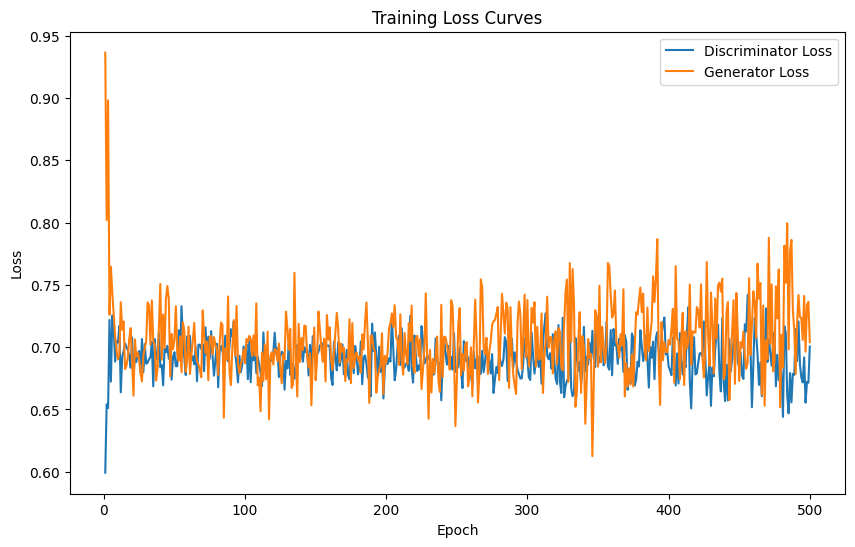

In [150]:

plt.figure(figsize=(10,6))
plt.plot(range(1, epochs+1), d_losses, label='Discriminator Loss')
plt.plot(range(1, epochs+1), g_losses, label='Generator Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Curves')
plt.legend()
plt.show()


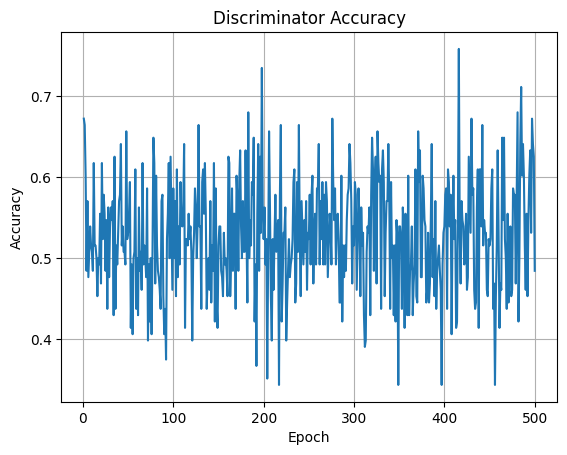

In [151]:
import matplotlib.pyplot as plt

plt.plot(range(1, epochs+1), d_accuracies)
plt.title("Discriminator Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.grid(True)
plt.show()


In [152]:


def generate_and_save_images(model, filename_prefix, num_per_class=10):
    save_dir = "Model6_improved_generated_images"
    os.makedirs(save_dir, exist_ok=True)  # create directory if not exists
    
    all_images = []
    for label in range(num_classes):
        noise = tf.random.normal((num_per_class, latent_dim))
        labels = tf.constant([label] * num_per_class, shape=(num_per_class, 1), dtype=tf.int32)
        gen_imgs = model([noise, labels], training=False)
        gen_imgs = 0.5 * gen_imgs + 0.5  # scale to [0,1]
        all_images.append(gen_imgs.numpy())
        
        # Save individual images per label
        label_dir = os.path.join(save_dir, f"class_{label_to_char[label]}")
        os.makedirs(label_dir, exist_ok=True)
        for i, img in enumerate(gen_imgs.numpy()):
            img_path = os.path.join(label_dir, f"{filename_prefix}_img_{i}.png")
            plt.imsave(img_path, img[:, :, 0], cmap='gray')
    
    all_images = np.concatenate(all_images, axis=0)
    
    # Save grid image
    fig, axes = plt.subplots(num_classes, num_per_class, figsize=(num_per_class*1.5, num_classes*1.5))
    for i in range(num_classes * num_per_class):
        row = i // num_per_class
        col = i % num_per_class
        ax = axes[row, col] if num_classes > 1 else axes[col]
        ax.imshow(all_images[i, :, :, 0], cmap='gray')
        ax.axis('off')
        if col == 0:
            ax.set_ylabel(chr(ord('A') + row), fontsize=12)
    plt.tight_layout()
    
    grid_path = os.path.join(save_dir, f"{filename_prefix}_grid.png")
    plt.savefig(grid_path)
    plt.show()
    plt.close(fig)
    
    print(f"Saved image grid to {grid_path}")


Word 'DEEP LEANING' from final weights:


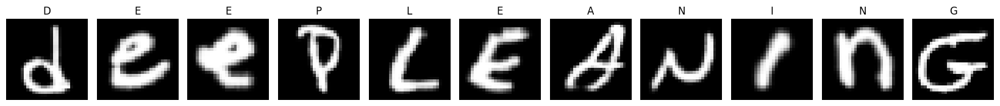

In [182]:
generator.load_weights("Model6_final_generator.h5")

print("Word 'DEEP LEANING' from final weights:")

generate_word(generator, "DEEP LEANING")

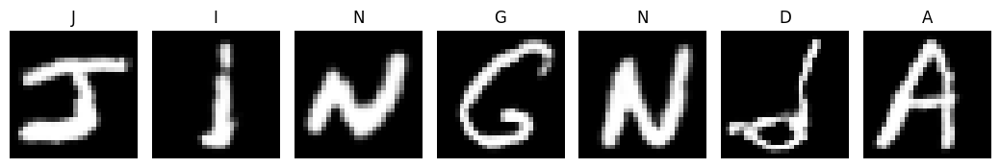

In [165]:


generate_word(generator, "JING N DA")

Word 'DEEP LEANING' from best weights:


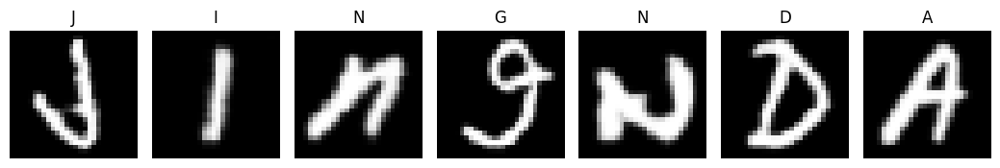

In [43]:
generator.load_weights("Model6_final_generator.h5")
print("Word 'DEEP LEANING' from best weights:")
generate_word(generator, "JING N DA")



Preview from final weights:


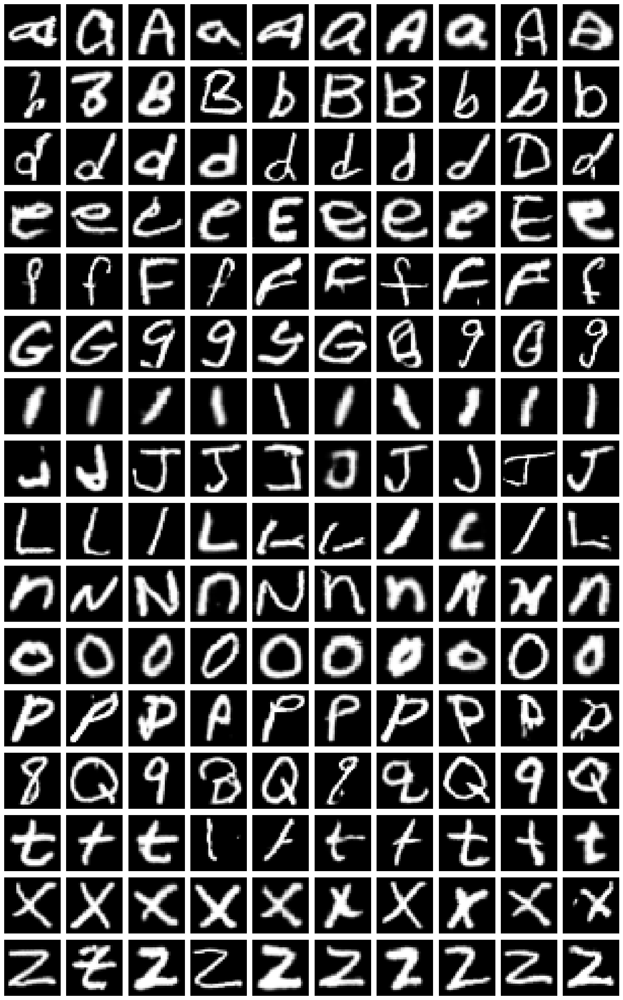

Saved image grid to Model8_improved_generated_images\Model6_160_finalweights_improved(2)_grid.png


In [107]:

# Preview from best weights
print("Preview from final weights:")
generator.load_weights("Model6_final_generator.h5")
generate_and_save_images(generator,  filename_prefix="Model6_160_finalweights_improved(2)")


Preview from final weights:


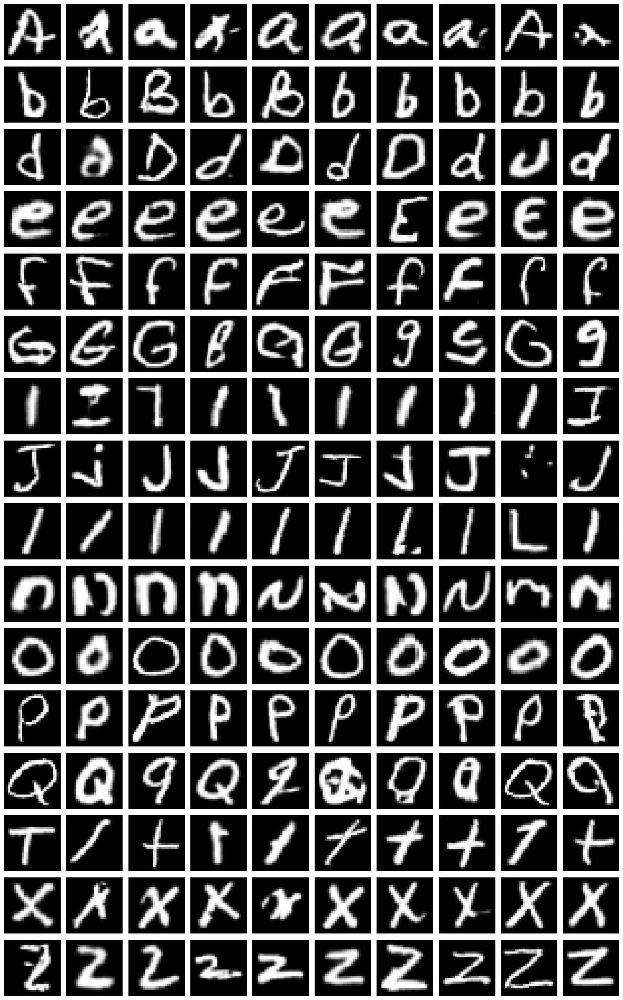

Saved image grid to Model8_improved_generated_images\Model6_160_finalweights_improved(3)_grid.png


In [114]:

# Preview from best weights
print("Preview from final weights:")
generator.load_weights("Model6_final_generator.h5")
generate_and_save_images(generator,  filename_prefix="Model6_160_finalweights_improved(3)")


Preview from final weights:


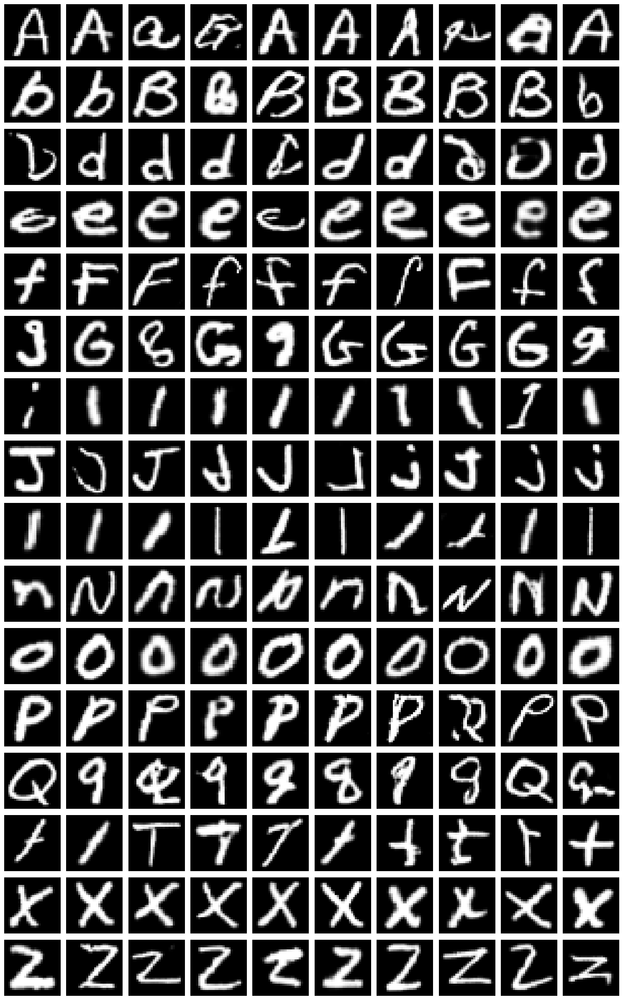

Saved image grid to NEWimproved_generated_images\Model6_160_finalweights_improved(6)_grid.png


In [184]:

# Preview from best weights
print("Preview from final weights:")
generator.load_weights("Model6_final_generator.h5")
generate_and_save_images(generator,  filename_prefix="Model6_160_finalweights_improved(6)")


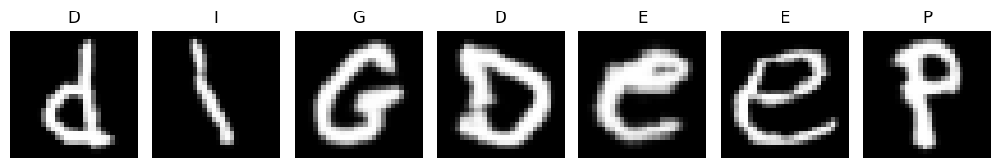

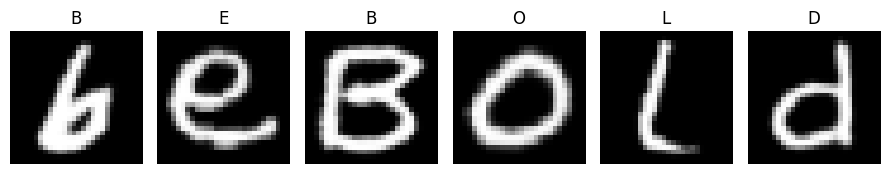

In [194]:
generator.load_weights("Model6_final_generator.h5")


generate_word(generator, "Dig Deep")     # Best weights
generator.load_weights("Model6_final_generator.h5")

generate_word(generator, "BE Bold")     # Best weights

